In [40]:
import nltk
from nltk import sent_tokenize, pos_tag
from nltk.tokenize import TreebankWordTokenizer
from nltk.stem import WordNetLemmatizer
from nltk.corpus import wordnet as wn
from nltk.corpus import sentiwordnet as swn
from nltk.sentiment.util import mark_negation

import re
import pandas as pd
from nltk.corpus import stopwords
from wordcloud import WordCloud, STOPWORDS
import spacy

from string import punctuation
from IPython.display import display
import pandas as pd
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt
pd.set_option('display.max_columns', None)
pd.set_option('display.max_colwidth', None)

In [20]:
nltk.download('punkt')
nltk.download('averaged_perceptron_tagger')
nltk.download('wordnet')
nltk.download('omw-1.4')
nltk.download('sentiwordnet')

[nltk_data] Downloading package punkt to /home/alifim/nltk_data...
[nltk_data]   Package punkt is already up-to-date!
[nltk_data] Downloading package averaged_perceptron_tagger to
[nltk_data]     /home/alifim/nltk_data...
[nltk_data]   Package averaged_perceptron_tagger is already up-to-
[nltk_data]       date!
[nltk_data] Downloading package wordnet to /home/alifim/nltk_data...
[nltk_data]   Package wordnet is already up-to-date!
[nltk_data] Downloading package omw-1.4 to /home/alifim/nltk_data...
[nltk_data]   Package omw-1.4 is already up-to-date!
[nltk_data] Downloading package sentiwordnet to
[nltk_data]     /home/alifim/nltk_data...
[nltk_data]   Unzipping corpora/sentiwordnet.zip.


True

In [44]:
reviews = pd.read_csv("../data/tiktok_playstore_reviews_last_100000_20220929.csv")
reviews = reviews.drop(columns=["Unnamed: 0"])

## Sentiment Scoring Using SentiWordNet

In [2]:
def penn_to_wn(tag):
    """
        Convert between the PennTreebank tags to simple Wordnet tags
    """
    if tag.startswith('J'):
        return wn.ADJ
    elif tag.startswith('N'):
        return wn.NOUN
    elif tag.startswith('R'):
        return wn.ADV
    elif tag.startswith('V'):
        return wn.VERB
    return None

In [3]:
def get_sentiment_score(text):
    
    """
        This method returns the sentiment score of a given text using SentiWordNet sentiment scores.
        input: text
        output: numeric (double) score, >0 means positive sentiment and <0 means negative sentiment.
    """    
    total_score = 0
    print(text)
    raw_sentences = sent_tokenize(text)
    print(raw_sentences)
    
    for sentence in raw_sentences:

        sent_score = 0     
        sentence = str(sentence)
        print(sentence)
        sentence = sentence.replace("<br />"," ").translate(str.maketrans('','',punctuation)).lower()
        tokens = TreebankWordTokenizer().tokenize(text)
        tags = pos_tag(tokens)
        for word, tag in tags:
            wn_tag = penn_to_wn(tag)
            if not wn_tag:
                continue
            lemma = WordNetLemmatizer().lemmatize(word, pos=wn_tag)
            if not lemma:
                continue
            synsets = wn.synsets(lemma, pos=wn_tag)
            if not synsets:
                continue
            synset = synsets[0]
            swn_synset = swn.senti_synset(synset.name())
            sent_score += swn_synset.pos_score() - swn_synset.neg_score()

        total_score = total_score + (sent_score / len(tokens))

    
    return (total_score / len(raw_sentences)) * 100

In [5]:
reviews.shape

(100000, 3)

In [8]:
reviews.head()

,content,score
0,Not viral my vedios dont like tik tok,1
1,mantap,5
2,The best,5
3,Tik Tok,5
4,Please fix this bug where my account randomly logs out even though I've made sure that I'm not being hacked. Makes me paranoid for some stupid reasons.,3


In [9]:
reviews.dropna(subset=["content"], inplace=True)

In [10]:
reviews.shape

(99999, 2)

In [21]:
reviews['swn_score'] = reviews['content'].apply(lambda text : get_sentiment_score(text))

Not viral my vedios dont like tik tok
['Not viral my vedios dont like tik tok']
Not viral my vedios dont like tik tok
mantap
['mantap']
mantap
The best
['The best']
The best
Tik Tok
['Tik Tok']
Tik Tok
Please fix this bug where my account randomly logs out even though I've made sure that I'm not being hacked. Makes me paranoid for some stupid reasons.
["Please fix this bug where my account randomly logs out even though I've made sure that I'm not being hacked.", 'Makes me paranoid for some stupid reasons.']
Please fix this bug where my account randomly logs out even though I've made sure that I'm not being hacked.
Makes me paranoid for some stupid reasons.
This nice and relaxing..application..and aim enjoying it .
['This nice and relaxing..application..and aim enjoying it .']
This nice and relaxing..application..and aim enjoying it .
I'm happy
["I'm happy"]
I'm happy
Why tiktok is not working in Realme C3😡 Fix it rn tysm
['Why tiktok is not working in Realme C3😡 Fix it rn tysm']
Why ti

Hh
['Hh']
Hh
It's great
["It's great"]
It's great
Best
['Best']
Best
Good
['Good']
Good
Hey can you pls help me?? I wanna download tiktok but it says that "tiktok can't be downloaded" and it sucks bc I want to make videos... I want to pls fix this problem on play store bc I'm seriously on the verge of exploding- :\
['Hey can you pls help me??', 'I wanna download tiktok but it says that "tiktok can\'t be downloaded" and it sucks bc I want to make videos...', "I want to pls fix this problem on play store bc I'm seriously on the verge of exploding- :\\"]
Hey can you pls help me??
I wanna download tiktok but it says that "tiktok can't be downloaded" and it sucks bc I want to make videos...
I want to pls fix this problem on play store bc I'm seriously on the verge of exploding- :\
Some feature cannot be used
['Some feature cannot be used']
Some feature cannot be used
Sobrang pangit
['Sobrang pangit']
Sobrang pangit
TikTok pls fix my account it's says suspend I can't watch a video pls fix it

Its so beutiful 😍😍😍😍😘😘😘😘
['Its so beutiful 😍😍😍😍😘😘😘😘']
Its so beutiful 😍😍😍😍😘😘😘😘
This application so good but please monitor or traced the sexual activity dance and an inappropriate videos o blog not only to base on what the reports of the user's,,,, hope you'll fix it and show the disagree of the malicious videos of the persons for the sake of the users in this app
["This application so good but please monitor or traced the sexual activity dance and an inappropriate videos o blog not only to base on what the reports of the user's,,,, hope you'll fix it and show the disagree of the malicious videos of the persons for the sake of the users in this app"]
This application so good but please monitor or traced the sexual activity dance and an inappropriate videos o blog not only to base on what the reports of the user's,,,, hope you'll fix it and show the disagree of the malicious videos of the persons for the sake of the users in this app
Fun times
['Fun times']
Fun times
LAKAS TALAGA TIKTOK

Step
['Step']
Step
nice
['nice']
nice
Okssss
['Okssss']
Okssss
Apasl kau ckp bukan ii psal pp + anak bongsu tiktok? Kau nk gaduh ker oiiiiii ?
['Apasl kau ckp bukan ii psal pp + anak bongsu tiktok?', 'Kau nk gaduh ker oiiiiii ?']
Apasl kau ckp bukan ii psal pp + anak bongsu tiktok?
Kau nk gaduh ker oiiiiii ?
BAt dkoe madownload
['BAt dkoe madownload']
BAt dkoe madownload
I love it
['I love it']
I love it
always lag
['always lag']
always lag
The best apps ever !!!!
['The best apps ever !!!', '!']
The best apps ever !!!
!
Good
['Good']
Good
android.permission.ACCESS_FINE_LOCATION；android.permission.ACCESS_COARSE_LOCATION
['android.permission.ACCESS_FINE_LOCATION；android.permission.ACCESS_COARSE_LOCATION']
android.permission.ACCESS_FINE_LOCATION；android.permission.ACCESS_COARSE_LOCATION
So pretty this app 😍
['So pretty this app 😍']
So pretty this app 😍
Damihan mo nmn views q jusq
['Damihan mo nmn views q jusq']
Damihan mo nmn views q jusq
Nice
['Nice']
Nice
For me t s night maire
['For me

Nice
['Nice']
Nice
It's good
["It's good"]
It's good
Good
['Good']
Good
omg
['omg']
omg
its good
['its good']
its good
👍🏿👍🏿👎
['👍🏿👍🏿👎']
👍🏿👍🏿👎
my love tokiktok
['my love tokiktok']
my love tokiktok
update is need 2 times in a week. Software is always auto downdate.
['update is need 2 times in a week.', 'Software is always auto downdate.']
update is need 2 times in a week.
Software is always auto downdate.
The beat
['The beat']
The beat
I love this application 😍😍😍
['I love this application 😍😍😍']
I love this application 😍😍😍
as an editor, maybe try fixing the quality.
['as an editor, maybe try fixing the quality.']
as an editor, maybe try fixing the quality.
Perfect
['Perfect']
Perfect
How was your day
['How was your day']
How was your day
This app is great but when i edit in capcut and then post it in tiktok it so laggy wich sucks. So please please fix this
['This app is great but when i edit in capcut and then post it in tiktok it so laggy wich sucks.', 'So please please fix this']
This a

Good
['Good']
Good
solid tiktok pa fyp po😊
['solid tiktok pa fyp po😊']
solid tiktok pa fyp po😊
So fan
['So fan']
So fan
Totototototototot
['Totototototototot']
Totototototototot
So cool
['So cool']
So cool
Nice
['Nice']
Nice
Good not bad.. so many ads.
['Good not bad.. so many ads.']
Good not bad.. so many ads.
apk nya bagus tpii jgn disini sad saat gue lgii galau anj
['apk nya bagus tpii jgn disini sad saat gue lgii galau anj']
apk nya bagus tpii jgn disini sad saat gue lgii galau anj
Terbaik. Dapat digunakan untuk berkongsi ilmu secara kreatif dan bersifat semasa.
['Terbaik.', 'Dapat digunakan untuk berkongsi ilmu secara kreatif dan bersifat semasa.']
Terbaik.
Dapat digunakan untuk berkongsi ilmu secara kreatif dan bersifat semasa.
💜
['💜']
💜
Nice app
['Nice app']
Nice app
Ah aeh ahe eehhe Don't go Don't go To sleep Don't go Stay with me TELEFORLELAIKATRARDUMMATHEMMA TELEFORLELAIKARAPWHEREDEDELA TELEFORLELAIKMALIFEFORSAD
["Ah aeh ahe eehhe Don't go Don't go To sleep Don't go Stay with

I can't use the shopping feature of this app. 😔🥹😅 I think this app wants me to avoid buying things. 😅😂
["I can't use the shopping feature of this app.", '😔\U0001f979😅 I think this app wants me to avoid buying things.', '😅😂']
I can't use the shopping feature of this app.
😔🥹😅 I think this app wants me to avoid buying things.
😅😂
TIKTOK I LOVEEEEE THISSSS
['TIKTOK I LOVEEEEE THISSSS']
TIKTOK I LOVEEEEE THISSSS
Rigalo ko sayu
['Rigalo ko sayu']
Rigalo ko sayu
Nv
['Nv']
Nv
super happy
['super happy']
super happy
Jualan, pamer apapun itu show must go on
['Jualan, pamer apapun itu show must go on']
Jualan, pamer apapun itu show must go on
i realy love Tiktok😍
['i realy love Tiktok😍']
i realy love Tiktok😍
Update
['Update']
Update
i love it
['i love it']
i love it
Nicee
['Nicee']
Nicee
ဆော်ရှိလား
['ဆော်ရှိလား']
ဆော်ရှိလား
This app is so nice I enjoyed watching tiktok videos. Thank you for this application.
['This app is so nice I enjoyed watching tiktok videos.', 'Thank you for this application.

This is so unfair.
Please review accordingly when you banned someone from going live.
It's very unfair.
It alway ban for nothing
['It alway ban for nothing']
It alway ban for nothing
phoophoo@
['phoophoo@']
phoophoo@
the language settings suck. sometimes it changes to english, malay, thai idek. i also cant open the videos from my videos history.
['the language settings suck.', 'sometimes it changes to english, malay, thai idek.', 'i also cant open the videos from my videos history.']
the language settings suck.
sometimes it changes to english, malay, thai idek.
i also cant open the videos from my videos history.
ល្ៀភែិ្ើ
['ល្ៀភែិ្ើ']
ល្ៀភែិ្ើ
ss
['ss']
ss
Like this
['Like this']
Like this
Nice
['Nice']
Nice
Please separate the draft section to other place.
['Please separate the draft section to other place.']
Please separate the draft section to other place.
because watching tiktok is the way how to be happy
['because watching tiktok is the way how to be happy']
because watching tiktok

This app is the best for all people
['This app is the best for all people']
This app is the best for all people
Happy
['Happy']
Happy
It's fine
["It's fine"]
It's fine
Very impressive
['Very impressive']
Very impressive
I love this app
['I love this app']
I love this app
Its good
['Its good']
Its good
This is so nice
['This is so nice']
This is so nice
Very good
['Very good']
Very good
Very nice
['Very nice']
Very nice
Is awesome
['Is awesome']
Is awesome
I love it
['I love it']
I love it
What's wrong with TikTok I got banned for no reason and my friend too and my mom account also what's wrong with you? And you won't even let me watch anything did I do anything nah I hate this you won't fix the problem I've been waiting and nothing happened can you pls fix this you make my friend me and my mother and my other siblings banned to what did they do TikTok can you fix it?
["What's wrong with TikTok I got banned for no reason and my friend too and my mom account also what's wrong with you?",

My account was made on my old phone.
I got a new phone, then I transferred my account to this phone.
When I follow thefollowing count wont update.
I made another account, and that's when I realized what was wrong.
When I follow someone, it auto-unfollows them when I refresh the page.
I was very frustrated by this, I was following some accounts on I also followed on my main, and followed them in my 2nd (they were about 60-110).
Please fix this.
Lee TikTok
['Lee TikTok']
Lee TikTok
Good
['Good']
Good
I like Tik Tok
['I like Tik Tok']
I like Tik Tok
Goofyahhh
['Goofyahhh']
Goofyahhh
KEEPS BANNING ME FOR NO REASON I DIDNT DO ANYTHING
['KEEPS BANNING ME FOR NO REASON I DIDNT DO ANYTHING']
KEEPS BANNING ME FOR NO REASON I DIDNT DO ANYTHING
💯
['💯']
💯
1, Problem is that I don't have the latest update when everyone have it already. 2, is that I hate when the ads came up and it's all Malaysian I hate it. 3, I hate when MY videos that I loved watching is not on my fyp all the time. Please fix or 

Nav
['Nav']
Nav
Only able to download tiktok lite but not main application
['Only able to download tiktok lite but not main application']
Only able to download tiktok lite but not main application
Effect အသစ်တွေမရဘူလွယ်လွယ်နဲ့ရအောင်ပြန်လုပ်ပေးပါ
['Effect အသစ်တွေမရဘူလွယ်လွယ်နဲ့ရအောင်ပြန်လုပ်ပေးပါ']
Effect အသစ်တွေမရဘူလွယ်လွယ်နဲ့ရအောင်ပြန်လုပ်ပေးပါ
Nice
['Nice']
Nice
Nices
['Nices']
Nices
its very authentic
['its very authentic']
its very authentic
Its relly ni and the filter but it will ban you even
['Its relly ni and the filter but it will ban you even']
Its relly ni and the filter but it will ban you even
Nice
['Nice']
Nice
I love TikTok,ever since I was 12 y/o I'm watching TikTok, it's just eating my storage
["I love TikTok,ever since I was 12 y/o I'm watching TikTok, it's just eating my storage"]
I love TikTok,ever since I was 12 y/o I'm watching TikTok, it's just eating my storage
Really nice very good
['Really nice very good']
Really nice very good
Its very beautiful
['Its very bea

The contents are both educational yet entertaining.
It's a good source for light entertainment when needed.
it is makes me happy and funny
['it is makes me happy and funny']
it is makes me happy and funny
Nice 👍
['Nice 👍']
Nice 👍
Gd
['Gd']
Gd
This app so good but i do not like
['This app so good but i do not like']
This app so good but i do not like
Ok
['Ok']
Ok
Nice app
['Nice app']
Nice app
I'm having a problem with the app, I can't follow back to the person who follow me why is that?
["I'm having a problem with the app, I can't follow back to the person who follow me why is that?"]
I'm having a problem with the app, I can't follow back to the person who follow me why is that?
nice.
['nice.']
nice.
trash
['trash']
trash
Interesting
['Interesting']
Interesting
I don"t have problem using tiktok
['I don"t have problem using tiktok']
I don"t have problem using tiktok
I like TikTok very much When I look at it when I'm tired, when I'm tired, when I'm tired, those tired feelings disappear.


I reinstalled it and it's the same!
I was kinda down that i couldn't support my favourite Tiktokers, please fix this!
!
Jedcruz
['Jedcruz']
Jedcruz
I like but the update is very slow
['I like but the update is very slow']
I like but the update is very slow
😍
['😍']
😍
TikTok my fyp is full of curse sounds
['TikTok my fyp is full of curse sounds']
TikTok my fyp is full of curse sounds
Great app with rich of contents
['Great app with rich of contents']
Great app with rich of contents
Why my TikTok is not filter working if have no wifi or data
['Why my TikTok is not filter working if have no wifi or data']
Why my TikTok is not filter working if have no wifi or data
I love you princess Irish L Malasaga from gentle
['I love you princess Irish L Malasaga from gentle']
I love you princess Irish L Malasaga from gentle
Cool app 😊
['Cool app 😊']
Cool app 😊
Enak
['Enak']
Enak
I love tik tok
['I love tik tok']
I love tik tok
Love it ☺️
['Love it ☺️']
Love it ☺️
So nice
['So nice']
So nice
So cute no

Hi TikTok 😍 LOVE ME , I'LL LOVE YOU BACK ☺️
["Hi TikTok 😍 LOVE ME , I'LL LOVE YOU BACK ☺️"]
Hi TikTok 😍 LOVE ME , I'LL LOVE YOU BACK ☺️
Its good actually but i cant open the app sometime
['Its good actually but i cant open the app sometime']
Its good actually but i cant open the app sometime
I like this app
['I like this app']
I like this app
The app was amazing until this content creators start bringing in mamy controversial topics and propergandas which just sparks hate
['The app was amazing until this content creators start bringing in mamy controversial topics and propergandas which just sparks hate']
The app was amazing until this content creators start bringing in mamy controversial topics and propergandas which just sparks hate
Is really good app but sometime is lagging and sometime I can't put my profile but I suggest is good app good job 5 stars for u🥰
["Is really good app but sometime is lagging and sometime I can't put my profile but I suggest is good app good job 5 stars fo

🙂🙂🙂
['🙂🙂🙂']
🙂🙂🙂
Good
['Good']
Good
Best Social Experience.
['Best Social Experience.']
Best Social Experience.
Sayang Ngaun palagi Kong eh update ung TikTok dina mag gamit Ang Felter kasi kailangan na Ng internet 😴
['Sayang Ngaun palagi Kong eh update ung TikTok dina mag gamit Ang Felter kasi kailangan na Ng internet 😴']
Sayang Ngaun palagi Kong eh update ung TikTok dina mag gamit Ang Felter kasi kailangan na Ng internet 😴
Ok
['Ok']
Ok
May video is not ah gambling.. its a movie video not a gambling.. idiot!!!! Why you violate mt video!!!!!? Mga labas suso ayaw i violate nyo... Tanga nyo...
['May video is not ah gambling.. its a movie video not a gambling..', 'idiot!!!!', 'Why you violate mt video!!!!!?', 'Mga labas suso ayaw i violate nyo... Tanga nyo...']
May video is not ah gambling.. its a movie video not a gambling..
idiot!!!!
Why you violate mt video!!!!!?
Mga labas suso ayaw i violate nyo... Tanga nyo...
Ok
['Ok']
Ok
Good
['Good']
Good
Love this app 🫰
['Love this app \U0001faf0']

It's so amazing
["It's so amazing"]
It's so amazing
FYP mag ved I give 2 star 🗿🤫
['FYP mag ved I give 2 star 🗿🤫']
FYP mag ved I give 2 star 🗿🤫
Be a seriously good platform to reaching our Ustaz&Ustazah on a daily live session. Live using TikTok is really user friendly. I can open another apps while hearing Live from host without getting out from the Live session
['Be a seriously good platform to reaching our Ustaz&Ustazah on a daily live session.', 'Live using TikTok is really user friendly.', 'I can open another apps while hearing Live from host without getting out from the Live session']
Be a seriously good platform to reaching our Ustaz&Ustazah on a daily live session.
Live using TikTok is really user friendly.
I can open another apps while hearing Live from host without getting out from the Live session
I got but i delete it
['I got but i delete it']
I got but i delete it
bagi saya lah best lAh 😄😄😄
['bagi saya lah best lAh 😄😄😄']
bagi saya lah best lAh 😄😄😄
dahil napasaya nya ang buh

Bagi lah video sy fyp
['Bagi lah video sy fyp']
Bagi lah video sy fyp
Good
['Good']
Good
I give 5 stars👍
['I give 5 stars👍']
I give 5 stars👍
Darla Dimple? Something's screwy down there right in my Computer and Network Servers right on my nerves 34 Weeks ago, as desperate as ever(Even though I admitted to Anybody who use the internet by Warner Bros. Studio of course) At least Darleen Dimple gets confessed by Daniel Cat exposed her crime as a verdict to the Philippine Supreme Court. And yet, Getting neglected rounding numbers off to the nearest values right on my Calculator for details yet.....
['Darla Dimple?', "Something's screwy down there right in my Computer and Network Servers right on my nerves 34 Weeks ago, as desperate as ever(Even though I admitted to Anybody who use the internet by Warner Bros.", 'Studio of course) At least Darleen Dimple gets confessed by Daniel Cat exposed her crime as a verdict to the Philippine Supreme Court.', 'And yet, Getting neglected rounding numbers 

nice.sobra
['nice.sobra']
nice.sobra
I love this So much
['I love this So much']
I love this So much
This app is so cool!
['This app is so cool!']
This app is so cool!
My experience good for sharing you idol and career goals 😘👍
['My experience good for sharing you idol and career goals 😘👍']
My experience good for sharing you idol and career goals 😘👍
3 stars because i don't have views of my tiktok🥲
["3 stars because i don't have views of my tiktok\U0001f972"]
3 stars because i don't have views of my tiktok🥲
Bad
['Bad']
Bad
Enjoy
['Enjoy']
Enjoy
For me it's good
["For me it's good"]
For me it's good
Nice Apps
['Nice Apps']
Nice Apps
Kecewa dengan keputusan moderasi, cuma posting bersih-bersih lingkungan, tapi dianggap melanggar peraturan. Udah banding tapi tetep aja ada stempel account warning. Video ga ada kejadian yang membuat kematian malah dianggap melanggar? Hellooooooo, jangan pake bot dong ngereviewnya... pake MATAmu sendiri dong
['Kecewa dengan keputusan moderasi, cuma posting be

Uu
['Uu']
Uu
Ok
['Ok']
Ok
Great reels app ever
['Great reels app ever']
Great reels app ever
tiktok is so buggy for Android. please fix. i cannot see pinned comments, add pronouns and the tiktok slideshow images are so zoomed in its so hard to see the full image. tiktok updates are getting worse
['tiktok is so buggy for Android.', 'please fix.', 'i cannot see pinned comments, add pronouns and the tiktok slideshow images are so zoomed in its so hard to see the full image.', 'tiktok updates are getting worse']
tiktok is so buggy for Android.
please fix.
i cannot see pinned comments, add pronouns and the tiktok slideshow images are so zoomed in its so hard to see the full image.
tiktok updates are getting worse
Gooddddd
['Gooddddd']
Gooddddd
so the problem is there's alot of bad contents that is not allowed for kids like me so can you please fix it
["so the problem is there's alot of bad contents that is not allowed for kids like me so can you please fix it"]
so the problem is there's alo

Entertaining
['Entertaining']
Entertaining
Just make dark mood available for Android.
['Just make dark mood available for Android.']
Just make dark mood available for Android.
i like. this app
['i like.', 'this app']
i like.
this app
Good
['Good']
Good
Suck
['Suck']
Suck
Many learnings from this app..
['Many learnings from this app..']
Many learnings from this app..
I earn because of you.
['I earn because of you.']
I earn because of you.
Good
['Good']
Good
Thankyou, Tiktok for being my friend even when I have a hard time in live. U make day. Big love and support from me🖤❤
['Thankyou, Tiktok for being my friend even when I have a hard time in live.', 'U make day.', 'Big love and support from me🖤❤']
Thankyou, Tiktok for being my friend even when I have a hard time in live.
U make day.
Big love and support from me🖤❤
lame
['lame']
lame
Good app
['Good app']
Good app
500M+
['500M+']
500M+
Good
['Good']
Good
I deleted my tiktok acc because for some reason and when i install it again it can't

bobo na app HAHAHA
['bobo na app HAHAHA']
bobo na app HAHAHA
nice
['nice']
nice
When I make videos on tiktok, my camera and sound always lag behind, and I can't access my account using Facebook.
["When I make videos on tiktok, my camera and sound always lag behind, and I can't access my account using Facebook."]
When I make videos on tiktok, my camera and sound always lag behind, and I can't access my account using Facebook.
It's very useful app.
["It's very useful app."]
It's very useful app.
Unable to follow user.... always stuck....help
['Unable to follow user.... always stuck....help']
Unable to follow user.... always stuck....help
ကြုနက်
['ကြုနက်']
ကြုနက်
Super beautiful
['Super beautiful']
Super beautiful
Hi! A good app afterall, but i reccomend adding history, because whenever i'm watching something, i accidently refresh, and couldn't find the video anymore, tiktok please add history, and i will for sure rate it a 5/5!
['Hi!', "A good app afterall, but i reccomend adding history

Gpp gabut aja
['Gpp gabut aja']
Gpp gabut aja
i can't update it. edit: i still can't update it even though my phone storage is not full.
["i can't update it.", "edit: i still can't update it even though my phone storage is not full."]
i can't update it.
edit: i still can't update it even though my phone storage is not full.
tik tok mãi đỉnh, xuất sắc
['tik tok mãi đỉnh, xuất sắc']
tik tok mãi đỉnh, xuất sắc
Tiktok that's
["Tiktok that's"]
Tiktok that's
Good
['Good']
Good
I don't know why my tik tok cannot add location? Even already on the location icon but still didnt show im my profil. I hv report the problem, but still didn't get any feedback from tiktok team. Pls help me on this problem. Tq
["I don't know why my tik tok cannot add location?", 'Even already on the location icon but still didnt show im my profil.', "I hv report the problem, but still didn't get any feedback from tiktok team.", 'Pls help me on this problem.', 'Tq']
I don't know why my tik tok cannot add location?
Even 

So much fun
['So much fun']
So much fun
I give one star because still not appear for live streaming
['I give one star because still not appear for live streaming']
I give one star because still not appear for live streaming
why tf do videos randomly stop loading
['why tf do videos randomly stop loading']
why tf do videos randomly stop loading
Good
['Good']
Good
Excellent/very nice/good
['Excellent/very nice/good']
Excellent/very nice/good
Love you
['Love you']
Love you
Cute and so very buetyfull
['Cute and so very buetyfull']
Cute and so very buetyfull
very entertaining apps
['very entertaining apps']
very entertaining apps
GREY BOX??? IT KEEPS APPEARING AND I CANT EVEN DK ANYTHING BOUT IT
['GREY BOX???', 'IT KEEPS APPEARING AND I CANT EVEN DK ANYTHING BOUT IT']
GREY BOX???
IT KEEPS APPEARING AND I CANT EVEN DK ANYTHING BOUT IT
Great
['Great']
Great
It's good but if you got ban you can't get your account back so i'll give 1 star for that
["It's good but if you got ban you can't get you

I love you
['I love you']
I love you
love you TikTok
['love you TikTok']
love you TikTok
The update is sososososo bad
['The update is sososososo bad']
The update is sososososo bad
I can't watch 😡😡😡
["I can't watch 😡😡😡"]
I can't watch 😡😡😡
Sangat bagus tik tok ini
['Sangat bagus tik tok ini']
Sangat bagus tik tok ini
Super cute Oo
['Super cute Oo']
Super cute Oo
Best tiktok ever but no more likes
['Best tiktok ever but no more likes']
Best tiktok ever but no more likes
Bagus tiktok di
['Bagus tiktok di']
Bagus tiktok di
please upgrade tiktok shop and please upgrade 6 box guest for andriod user
['please upgrade tiktok shop and please upgrade 6 box guest for andriod user']
please upgrade tiktok shop and please upgrade 6 box guest for andriod user
Good
['Good']
Good
Good
['Good']
Good
imissyouuu
['imissyouuu']
imissyouuu
Not good because I did not more filter 😳🙄
['Not good because I did not more filter 😳🙄']
Not good because I did not more filter 😳🙄
Still undesputed app
['Still undesputed ap

also tiktok videos quality when i uploaded a videos is bad asff 😭😭
['also tiktok videos quality when i uploaded a videos is bad asff 😭😭']
also tiktok videos quality when i uploaded a videos is bad asff 😭😭
Stress reliever
['Stress reliever']
Stress reliever
Ilove the tiktok
['Ilove the tiktok']
Ilove the tiktok
my account is banned even though there are no videos that violate the rules😭
['my account is banned even though there are no videos that violate the rules😭']
my account is banned even though there are no videos that violate the rules😭
P.......
['P.......']
P.......
very nice
['very nice']
very nice
So good
['So good']
So good
Make me happy
['Make me happy']
Make me happy
Very good 👍😊
['Very good 👍😊']
Very good 👍😊
It's good
["It's good"]
It's good
Fantastic love it
['Fantastic love it']
Fantastic love it
GOOD APPP
['GOOD APPP']
GOOD APPP
this app is so cool
['this app is so cool']
this app is so cool
Good
['Good']
Good
Aplikasi sanhat membantu Untuk sy yang suka bikin sw sad😊
['Ap

i need a dark mode version for my Samsung a20s:((
['i need a dark mode version for my Samsung a20s:((']
i need a dark mode version for my Samsung a20s:((
Sebab lembap Lepas TU boleh jack lag
['Sebab lembap Lepas TU boleh jack lag']
Sebab lembap Lepas TU boleh jack lag
I was so happy 😁
['I was so happy 😁']
I was so happy 😁
Good 👍
['Good 👍']
Good 👍
Lovely
['Lovely']
Lovely
ងករ
['ងករ']
ងករ
When i upload a video my video from 60fps turn into 30fps please fix this ASAP.
['When i upload a video my video from 60fps turn into 30fps please fix this ASAP.']
When i upload a video my video from 60fps turn into 30fps please fix this ASAP.
Good
['Good']
Good
ดีครับ
['ดีครับ']
ดีครับ
I cant update my tiktok..but other app just fine..why?
['I cant update my tiktok..but other app just fine..why?']
I cant update my tiktok..but other app just fine..why?
Lừa đảo mời người dùng mới.
['Lừa đảo mời người dùng mới.']
Lừa đảo mời người dùng mới.
ទីតុកថ្មី
['ទីតុកថ្មី']
ទីតុកថ្មី
Sgt bgus
['Sgt bgus']
Sgt bgus


Hatdog
['Hatdog']
Hatdog
I like player tik tok
['I like player tik tok']
I like player tik tok
Ok
['Ok']
Ok
When trying to live stream, glitching everything. When Mobile Gaming. Too Heavy to live stream mobile gaming after update. Please fix this. Make it low like before and more easy to use.
['When trying to live stream, glitching everything.', 'When Mobile Gaming.', 'Too Heavy to live stream mobile gaming after update.', 'Please fix this.', 'Make it low like before and more easy to use.']
When trying to live stream, glitching everything.
When Mobile Gaming.
Too Heavy to live stream mobile gaming after update.
Please fix this.
Make it low like before and more easy to use.
Love it it's just the tiktok guide lines and moderation that's bad bud overall pretty good
["Love it it's just the tiktok guide lines and moderation that's bad bud overall pretty good"]
Love it it's just the tiktok guide lines and moderation that's bad bud overall pretty good
💖💖💖💖💖
['💖💖💖💖💖']
💖💖💖💖💖
I think your update

good
['good']
good
Cringy pose need to be deleted. Jk bro the best app ever
['Cringy pose need to be deleted.', 'Jk bro the best app ever']
Cringy pose need to be deleted.
Jk bro the best app ever
papasikatin ako neto
['papasikatin ako neto']
papasikatin ako neto
Create to be addictive.
['Create to be addictive.']
Create to be addictive.
Kudos
['Kudos']
Kudos
😝😝😝😝😝😝😝😝
['😝😝😝😝😝😝😝😝']
😝😝😝😝😝😝😝😝
Nice
['Nice']
Nice
Đây là ứng dụng tuyệt vời mỗi khi tôi rảnh rỗi
['Đây là ứng dụng tuyệt vời mỗi khi tôi rảnh rỗi']
Đây là ứng dụng tuyệt vời mỗi khi tôi rảnh rỗi
Nice
['Nice']
Nice
like it ig
['like it ig']
like it ig
Good
['Good']
Good
Good
['Good']
Good
Qq
['Qq']
Qq
Nice to find a new friend with a same interest
['Nice to find a new friend with a same interest']
Nice to find a new friend with a same interest
My happiness every day 🥰
['My happiness every day 🥰']
My happiness every day 🥰
╭╮╱╱╱╱╱╱╱╱╱╱╱╱╱╱╭╮╱ ┃┃╱╱╱╱╱╱╱╱╱╱╱╱╱╭╯╰╮ ┃┃╱╱╭━━┳╮╭┳━━╮╭╋╮╭╯ ┃┃╱╭┫╭╮┃╰╯┃┃━┫┣┫┃┃╱ ┃╰━╯┃╰╯┣╮╭┫┃━┫┃┃┃╰╮ ╰━━━┻━━╯╰╯╰━

Please appreciate them.
And make REAL Roles don't always change.
U take high tax but we are not complaining.
Entertaining app but when i watch live video always bug,please fixed this issue
['Entertaining app but when i watch live video always bug,please fixed this issue']
Entertaining app but when i watch live video always bug,please fixed this issue
Good
['Good']
Good
Great app a stress reliever for me i just wish the refund transaction of getting my money back was instant like other shop apps when the order is cancelled but its good so far no problems experience at all.
['Great app a stress reliever for me i just wish the refund transaction of getting my money back was instant like other shop apps when the order is cancelled but its good so far no problems experience at all.']
Great app a stress reliever for me i just wish the refund transaction of getting my money back was instant like other shop apps when the order is cancelled but its good so far no problems experience at all.
no 

👍
['👍']
👍
ok lng
['ok lng']
ok lng
Fun
['Fun']
Fun
Mas maganda yung new updates 😭
['Mas maganda yung new updates 😭']
Mas maganda yung new updates 😭
About dancing
['About dancing']
About dancing
Jn 2kknzzjjj wjhjaZ
['Jn 2kknzzjjj wjhjaZ']
Jn 2kknzzjjj wjhjaZ
valjommel22agravante macapobre valjommel22
['valjommel22agravante macapobre valjommel22']
valjommel22agravante macapobre valjommel22
Win thin
['Win thin']
Win thin
Early Hy
['Early Hy']
Early Hy
😍😘😊😚😍
['😍😘😊😚😍']
😍😘😊😚😍
It's good but sometimes it have some bugs and lags so can you fix it?
["It's good but sometimes it have some bugs and lags so can you fix it?"]
It's good but sometimes it have some bugs and lags so can you fix it?
Why I can't download tiktok?
["Why I can't download tiktok?"]
Why I can't download tiktok?
Maganda
['Maganda']
Maganda
Pls don't spam me
["Pls don't spam me"]
Pls don't spam me
Amazing
['Amazing']
Amazing
𝙶𝚘𝚘𝚍 𝚝𝚒𝚔𝚝𝚘𝚔 𝚊𝚙𝚙𝚜 𝚋𝚞𝚝 𝚒 𝚐𝚒𝚟𝚎 3𝚜𝚝𝚊𝚛
['𝙶𝚘𝚘𝚍 𝚝𝚒𝚔𝚝𝚘𝚔 𝚊𝚙𝚙𝚜 𝚋𝚞𝚝 𝚒 𝚐𝚒𝚟𝚎 3𝚜𝚝𝚊𝚛']
𝙶𝚘𝚘𝚍 𝚝𝚒𝚔𝚝𝚘𝚔 𝚊𝚙𝚙𝚜 𝚋𝚞𝚝 𝚒 𝚐𝚒𝚟𝚎 3𝚜𝚝𝚊𝚛


cool Good
['cool Good']
cool Good
Great
['Great']
Great
That is my forever app/favorite app
['That is my forever app/favorite app']
That is my forever app/favorite app
It's like very funny to use this TikTok apps.
["It's like very funny to use this TikTok apps."]
It's like very funny to use this TikTok apps.
Doet
['Doet']
Doet
to be continue my planing
['to be continue my planing']
to be continue my planing
🙏... 💨.. BOI!......
['🙏... 💨..', 'BOI!......']
🙏... 💨..
BOI!......
🤓👍👍
['🤓👍👍']
🤓👍👍
Gn
['Gn']
Gn
Is cool
['Is cool']
Is cool
Tiktok stop banning acc for no reason we were struggling to get followers and then you just banned us😒
['Tiktok stop banning acc for no reason we were struggling to get followers and then you just banned us😒']
Tiktok stop banning acc for no reason we were struggling to get followers and then you just banned us😒
Good
['Good']
Good
Cannot have the dark mode
['Cannot have the dark mode']
Cannot have the dark mode
Ok
['Ok']
Ok
Love this app 😍
['Love this app 😍']
Lo

Very satisfied
['Very satisfied']
Very satisfied
Okay
['Okay']
Okay
Tak best !!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!tapi BOHONG
['Tak best !!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!', '!tapi BOHONG']
Tak best !!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!
!tapi BOHONG
Wonderful
['Wonderful']
Wonderful
Nice and invigorating
['Nice and invigorating']
Nice and invigorating
👍
['👍']
👍
♡
['♡']
♡
We can dance and sing my name in tiktok is dolly_0573 ok bye
['We can dance and sing my name in tiktok is dolly_0573 ok bye']
We can dance and sing my name in tiktok is dolly_0573 ok bye
it so cool ilove dis app❤🖤🤍
['it so cool ilove dis app❤🖤🤍']
it so cool ilove dis app❤🖤🤍
Nice
['Nice']
Nice
Ang ganda ko
['Ang ganda ko']
Ang ganda ko
I like this bcs it help me laugh and explore new things
['I like this bcs it help me laugh and explore new things']
I like this b

It's so nice to watching a tiktok videos
["It's so nice to watching a tiktok videos"]
It's so nice to watching a tiktok videos
I like tik tok bikes can commet and dafta tik tok 😎
['I like tik tok bikes can commet and dafta tik tok 😎']
I like tik tok bikes can commet and dafta tik tok 😎
I love tik tok ☺ I just need something that interesting 🤔
['I love tik tok ☺ I just need something that interesting 🤔']
I love tik tok ☺ I just need something that interesting 🤔
Bagus saya suka sangat²
['Bagus saya suka sangat²']
Bagus saya suka sangat²
I love it
['I love it']
I love it
Mon
['Mon']
Mon
Perfect kase dito nakikita Ang talento bawat Tao dito sumasayaw
['Perfect kase dito nakikita Ang talento bawat Tao dito sumasayaw']
Perfect kase dito nakikita Ang talento bawat Tao dito sumasayaw
iii
['iii']
iii
I like it very much 😊
['I like it very much 😊']
I like it very much 😊
Hi i just want to share my experience in tiktok it so beautiful app and so many vid and they have a lot of filter and sound I r

I love this app
['I love this app']
I love this app
Ok
['Ok']
Ok
Everything is fine, but for some reason I am not able to see products in tiktok shop? Already have my account set up and everything but for some reason I cannot see products listed when clearly on another phone there are products. Till then, 3 stars.
['Everything is fine, but for some reason I am not able to see products in tiktok shop?', 'Already have my account set up and everything but for some reason I cannot see products listed when clearly on another phone there are products.', 'Till then, 3 stars.']
Everything is fine, but for some reason I am not able to see products in tiktok shop?
Already have my account set up and everything but for some reason I cannot see products listed when clearly on another phone there are products.
Till then, 3 stars.
open tiktok
['open tiktok']
open tiktok
Soo helpful and TikTok is more fun
['Soo helpful and TikTok is more fun']
Soo helpful and TikTok is more fun
New update about Videos

Very good 😊
['Very good 😊']
Very good 😊
Fun and enjoy
['Fun and enjoy']
Fun and enjoy
Just updated and now I can't open it anymore.
["Just updated and now I can't open it anymore."]
Just updated and now I can't open it anymore.
👍👍👍👍👍👍👍👍👍👍👍👍
['👍👍👍👍👍👍👍👍👍👍👍👍']
👍👍👍👍👍👍👍👍👍👍👍👍
Konten edukasi tentang hukum malah di blokir. Ngikutin penguasa konoha
['Konten edukasi tentang hukum malah di blokir.', 'Ngikutin penguasa konoha']
Konten edukasi tentang hukum malah di blokir.
Ngikutin penguasa konoha
Bad app for me
['Bad app for me']
Bad app for me
Most of my free time I used this app. Best app for relaxation.
['Most of my free time I used this app.', 'Best app for relaxation.']
Most of my free time I used this app.
Best app for relaxation.
ok
['ok']
ok
Add some dark mod
['Add some dark mod']
Add some dark mod
TikTok Terbaik
['TikTok Terbaik']
TikTok Terbaik
This is cool app
['This is cool app']
This is cool app
Very good
['Very good']
Very good
Bat Yung akin Wala set as wallpaper ayaw mag set as wal

Idk
['Idk']
Idk
Thanks alot of
['Thanks alot of']
Thanks alot of
Please put the Increase !!!!☹️HighGraphics Setting because you removed ittttttt
['Please put the Increase !!!', '!☹️HighGraphics Setting because you removed ittttttt']
Please put the Increase !!!
!☹️HighGraphics Setting because you removed ittttttt
Enjoy much 🥰🥰🥰
['Enjoy much 🥰🥰🥰']
Enjoy much 🥰🥰🥰
very good
['very good']
very good
Your dignity and virtue will disappear if you open this app
['Your dignity and virtue will disappear if you open this app']
Your dignity and virtue will disappear if you open this app
Great 🥰🥰
['Great 🥰🥰']
Great 🥰🥰
cool app
['cool app']
cool app
$Online
['$Online']
$Online
Naisu
['Naisu']
Naisu
So good
['So good']
So good
Yummy hotdog my tommy
['Yummy hotdog my tommy']
Yummy hotdog my tommy
Tiktok making me easy and setisfied.
['Tiktok making me easy and setisfied.']
Tiktok making me easy and setisfied.
Dance
['Dance']
Dance
nag gada 😁 nag TIKTKO 🦋❤️
['nag gada 😁 nag TIKTKO 🦋❤️']
nag gada 😁 nag T

Pasikatin moko tiktok
['Pasikatin moko tiktok']
Pasikatin moko tiktok
I enjoy
['I enjoy']
I enjoy
ᴍᴇʀʀʏᴄʀɪs
['ᴍᴇʀʀʏᴄʀɪs']
ᴍᴇʀʀʏᴄʀɪs
mwaaaa
['mwaaaa']
mwaaaa
Magnificent app.
['Magnificent app.']
Magnificent app.
Beautiful
['Beautiful']
Beautiful
Sana all
['Sana all']
Sana all
ោ ថាបងកិ
['ោ ថាបងកិ']
ោ ថាបងកិ
Fantastic
['Fantastic']
Fantastic
This app is so very good
['This app is so very good']
This app is so very good
This is so nice love you TikTok song mhuahh
['This is so nice love you TikTok song mhuahh']
This is so nice love you TikTok song mhuahh
It's so very fun to use this app and i discovered more
["It's so very fun to use this app and i discovered more"]
It's so very fun to use this app and i discovered more
I like it
['I like it']
I like it
Nice and easy to use
['Nice and easy to use']
Nice and easy to use
My experience it to learn dance
['My experience it to learn dance']
My experience it to learn dance
I actually like it but what's wrong with my tiktok account?
["I actually 

using this kimd of trick to get people download ur application is not good and it against religion .
promising something not based on u said i mean .
this is scammed guys .
thta why dont ever trust tiktok
Juii
['Juii']
Juii
I'm bottom Akon after updating 🥺😔
["I'm bottom Akon after updating 🥺😔"]
I'm bottom Akon after updating 🥺😔
Good
['Good']
Good
Welldone Response Global User Every Single Day Since Official Launch By 2018
['Welldone Response Global User Every Single Day Since Official Launch By 2018']
Welldone Response Global User Every Single Day Since Official Launch By 2018
Its good
['Its good']
Its good
Like it
['Like it']
Like it
Tang ina uupdate pa dimonyong tiktok
['Tang ina uupdate pa dimonyong tiktok']
Tang ina uupdate pa dimonyong tiktok
It's so fun
["It's so fun"]
It's so fun
THANK youuu ☺☺☺
['THANK youuu ☺☺☺']
THANK youuu ☺☺☺
Nice 😊👍🏻
['Nice 😊👍🏻']
Nice 😊👍🏻
Mapagmahal
['Mapagmahal']
Mapagmahal
Good its so very good, i dance and sing and act..like it much as you like me
['Goo

Is so good
['Is so good']
Is so good
I love ittttttt
['I love ittttttt']
I love ittttttt
Nice and good
['Nice and good']
Nice and good
Happy
['Happy']
Happy
Just happy Watching the clips
['Just happy Watching the clips']
Just happy Watching the clips
Excellent
['Excellent']
Excellent
Nice app
['Nice app']
Nice app
Good
['Good']
Good
Panget nya. Kapag di ka 13 biglang mabubura accc mo
['Panget nya.', 'Kapag di ka 13 biglang mabubura accc mo']
Panget nya.
Kapag di ka 13 biglang mabubura accc mo
ผมอ่ะอืมมันดีมากเลยผมเลยเล่นจนมีผู้300อ่ะอืมดีๆๆๆๆๆมากกกก
['ผมอ่ะอืมมันดีมากเลยผมเลยเล่นจนมีผู้300อ่ะอืมดีๆๆๆๆๆมากกกก']
ผมอ่ะอืมมันดีมากเลยผมเลยเล่นจนมีผู้300อ่ะอืมดีๆๆๆๆๆมากกกก
This app is very beutiful
['This app is very beutiful']
This app is very beutiful
Fyp udah ga kaya dulu yang dari semua negara bisa masuk di fyp kita, sekarang kalo buka fyp indonesia semua
['Fyp udah ga kaya dulu yang dari semua negara bisa masuk di fyp kita, sekarang kalo buka fyp indonesia semua']
Fyp udah ga kaya dulu 

5 cuz I like the app😃
['5 cuz I like the app😃']
5 cuz I like the app😃
Realy so nice app
['Realy so nice app']
Realy so nice app
❤️❤️❤️
['❤️❤️❤️']
❤️❤️❤️
I like tiktok 🥰🥰
['I like tiktok 🥰🥰']
I like tiktok 🥰🥰
the app is good good good ≧∇≦
['the app is good good good ≧∇≦']
the app is good good good ≧∇≦
Good
['Good']
Good
ok na ok naman siya, kami lang hindi.
['ok na ok naman siya, kami lang hindi.']
ok na ok naman siya, kami lang hindi.
It was fun. Stress reliever. I have that app too just want to sing even i am not good singer. Make a funny face.. I also watching for some users. Its cool. Actually I am a single mom working and adjusting the different cultures. And rising the two teenagers. Its my changing part. Any I am Arlene Feniza divorced with korean man. I work as Teacher. But Now I am not in good health because of my Diabetes and higher tension. But thanks anyway for the change Ellen to do this. God bless.
['It was fun.', 'Stress reliever.', 'I have that app too just want to sing 

have some fun
['have some fun']
have some fun
TIKTOK HELLO
['TIKTOK HELLO']
TIKTOK HELLO
This app is a 10/10
['This app is a 10/10']
This app is a 10/10
Good app
['Good app']
Good app
Like it
['Like it']
Like it
This app literally ruins your humor,mind,and your kid.
['This app literally ruins your humor,mind,and your kid.']
This app literally ruins your humor,mind,and your kid.
very good
['very good']
very good
I really like it new update
['I really like it new update']
I really like it new update
Very entertaining and interactive
['Very entertaining and interactive']
Very entertaining and interactive
Good
['Good']
Good
I love tiktok
['I love tiktok']
I love tiktok
Njoy much
['Njoy much']
Njoy much
Very niceeeeee, its so greattt!🤍
['Very niceeeeee, its so greattt!🤍']
Very niceeeeee, its so greattt!🤍
imissyou
['imissyou']
imissyou
Tiktok has been the new trend of today's generation. It has been an avenue and a venue for challenges, welcomes new opportunity for talents and diversity. I j

Napilitan lang nag 5 star
['Napilitan lang nag 5 star']
Napilitan lang nag 5 star
tiktok ban me 🥺🥺😭😭
['tiktok ban me 🥺🥺😭😭']
tiktok ban me 🥺🥺😭😭
Muhammad Naseier
['Muhammad Naseier']
Muhammad Naseier
This app is cool and i want to downlaod it back but it won't ay wait its downlaod now thankss .... its great,,!!!
["This app is cool and i want to downlaod it back but it won't ay wait its downlaod now thankss .... its great,,!!", '!']
This app is cool and i want to downlaod it back but it won't ay wait its downlaod now thankss .... its great,,!!
!
I like it tiktok is cool
['I like it tiktok is cool']
I like it tiktok is cool
𝘐 𝘬𝘯𝘰𝘸 𝘩𝘰𝘸 𝘵𝘰 𝘶𝘱𝘥𝘢𝘵𝘦 𝘣𝘶𝘵 𝘪𝘵 𝘸𝘢𝘴 𝘴𝘰 𝘢𝘮𝘢𝘻𝘪𝘯𝘨🤩👍 𝘢𝘯𝘥 𝘐 𝘦𝘯𝘫𝘰𝘺𝘦𝘥 𝘪𝘵 𝘷𝘦𝘳𝘺 𝘸𝘦𝘭𝘭 𝘣𝘶𝘵 𝘵𝘩𝘦 𝘱𝘳𝘰𝘣𝘭𝘦𝘮 𝘪𝘴 𝘵𝘩𝘦 𝘈𝘊𝘊 𝘸𝘢𝘳𝘯𝘪𝘯𝘨 𝘐 𝘥𝘰𝘯'𝘵 𝘬𝘯𝘰𝘸 𝘩𝘰𝘸 𝘵𝘰 𝘳𝘦𝘮𝘰𝘷𝘦 𝘪𝘵 𝘣𝘶𝘵 𝘐 𝘶𝘱𝘥𝘢𝘵𝘦 𝘪𝘵 𝘐 𝘥𝘰𝘯'𝘵 𝘬𝘯𝘰𝘸 𝘸𝘩𝘺 𝘈𝘊𝘊 𝘸𝘢𝘳𝘯𝘪𝘯𝘨 𝘪𝘴𝘴𝘶𝘦𝘥 𝘯𝘰𝘵 𝘳𝘦𝘮𝘰𝘷𝘪𝘯𝘨
["𝘐 𝘬𝘯𝘰𝘸 𝘩𝘰𝘸 𝘵𝘰 𝘶𝘱𝘥𝘢𝘵𝘦 𝘣𝘶𝘵 𝘪𝘵 𝘸𝘢𝘴 𝘴𝘰 𝘢𝘮𝘢𝘻𝘪𝘯𝘨🤩👍 𝘢𝘯𝘥 𝘐 𝘦𝘯𝘫𝘰𝘺𝘦𝘥 𝘪𝘵 𝘷𝘦𝘳𝘺 𝘸𝘦𝘭𝘭 𝘣𝘶𝘵 𝘵𝘩𝘦 𝘱𝘳𝘰𝘣𝘭𝘦𝘮 𝘪𝘴 𝘵𝘩𝘦 𝘈𝘊𝘊 𝘸𝘢𝘳𝘯𝘪𝘯𝘨 𝘐 𝘥𝘰𝘯'𝘵 𝘬𝘯𝘰𝘸 𝘩𝘰𝘸 𝘵𝘰 𝘳𝘦𝘮𝘰𝘷𝘦 𝘪𝘵 𝘣𝘶𝘵 𝘐 𝘶𝘱𝘥𝘢𝘵𝘦 𝘪𝘵 𝘐 𝘥𝘰𝘯'𝘵 𝘬𝘯𝘰𝘸 𝘸𝘩

Why its to hard to update...now my tiktok cannot open in second phone because of update process.☹️
['Why its to hard to update...now my tiktok cannot open in second phone because of update process.☹️']
Why its to hard to update...now my tiktok cannot open in second phone because of update process.☹️
I love it ❣️😍
['I love it ❣️😍']
I love it ❣️😍
Fun
['Fun']
Fun
i love tiktok
['i love tiktok']
i love tiktok
tiptop good all off
['tiptop good all off']
tiptop good all off
soooo gooooood
['soooo gooooood']
soooo gooooood
I keep on reinstalling the new version! It is so annoying. It doesn't work. 😓 That's why i cannot watch tiktok videos and so. I hope it would remain as it is.
['I keep on reinstalling the new version!', 'It is so annoying.', "It doesn't work.", "😓 That's why i cannot watch tiktok videos and so.", 'I hope it would remain as it is.']
I keep on reinstalling the new version!
It is so annoying.
It doesn't work.
😓 That's why i cannot watch tiktok videos and so.
I hope it would re

So good
['So good']
So good
Worst..your update is loading
['Worst..your update is loading']
Worst..your update is loading
I kinda hate when it update it you really need to update it i cant use it cuz the storage of my cp some app is optional when it comes to updating the app
['I kinda hate when it update it you really need to update it i cant use it cuz the storage of my cp some app is optional when it comes to updating the app']
I kinda hate when it update it you really need to update it i cant use it cuz the storage of my cp some app is optional when it comes to updating the app
Tjg
['Tjg']
Tjg
Nice
['Nice']
Nice
Update is sluggish. I have been trying to update the freaking app for 5 times now. Its not updating, nor installing.
['Update is sluggish.', 'I have been trying to update the freaking app for 5 times now.', 'Its not updating, nor installing.']
Update is sluggish.
I have been trying to update the freaking app for 5 times now.
Its not updating, nor installing.
Fun
['Fun']
Fun


Nice
['Nice']
Nice
😃👍
['😃👍']
😃👍
Storbo
['Storbo']
Storbo
Good
['Good']
Good
Gowdd
['Gowdd']
Gowdd
👍
['👍']
👍
Love Tik Tok
['Love Tik Tok']
Love Tik Tok
F u and ur rona 🥟
['F u and ur rona 🥟']
F u and ur rona 🥟
Good i think :)
['Good i think :)']
Good i think :)
very good
['very good']
very good
Good software to use
['Good software to use']
Good software to use
Nice apps
['Nice apps']
Nice apps
Too weird apps. When your live always received warning. Why the other hosts you do not warning? 🤦
['Too weird apps.', 'When your live always received warning.', 'Why the other hosts you do not warning?', '🤦']
Too weird apps.
When your live always received warning.
Why the other hosts you do not warning?
🤦
naymyo
['naymyo']
naymyo
Nice
['Nice']
Nice
សុំអេឌីតឱ្យស្អាតតិចមក😘🙏
['សុំអេឌីតឱ្យស្អាតតិចមក😘🙏']
សុំអេឌីតឱ្យស្អាតតិចមក😘🙏
open
['open']
open
i hate this
['i hate this']
i hate this
BEST
['BEST']
BEST
So far so good.. 👍
['So far so good.. 👍']
So far so good.. 👍
Good
['Good']
Good
This app very racis

I love TikTok
['I love TikTok']
I love TikTok
Nice
['Nice']
Nice
Best gila
['Best gila']
Best gila
Good app ig
['Good app ig']
Good app ig
Helpful and entertaining
['Helpful and entertaining']
Helpful and entertaining
Ok
['Ok']
Ok
Very nice
['Very nice']
Very nice
tiktokvesuos
['tiktokvesuos']
tiktokvesuos
Goood pang palipas oras sa bahay
['Goood pang palipas oras sa bahay']
Goood pang palipas oras sa bahay
Good
['Good']
Good
nice qpp
['nice qpp']
nice qpp
tittot
['tittot']
tittot
Enjoy kna sa mga video nalilibang kapa
['Enjoy kna sa mga video nalilibang kapa']
Enjoy kna sa mga video nalilibang kapa
experience good
['experience good']
experience good
Hahaha
['Hahaha']
Hahaha
Good
['Good']
Good
good app
['good app']
good app
Bug
['Bug']
Bug
Is good app
['Is good app']
Is good app
tah
['tah']
tah
Nice
['Nice']
Nice
Nice
['Nice']
Nice
529810 Pyae. Phyo. Aung
['529810 Pyae.', 'Phyo.', 'Aung']
529810 Pyae.
Phyo.
Aung
Awesome
['Awesome']
Awesome
Happy
['Happy']
Happy
I love the app and it do

i cant get Playlist
['i cant get Playlist']
i cant get Playlist
Exellent, this was so a great app
['Exellent, this was so a great app']
Exellent, this was so a great app
Love it
['Love it']
Love it
I'm happy to alive again for a while now
["I'm happy to alive again for a while now"]
I'm happy to alive again for a while now
Coba di upgrade untuk komentar itu unlimeted hurufnya Mungkin lebih seru
['Coba di upgrade untuk komentar itu unlimeted hurufnya Mungkin lebih seru']
Coba di upgrade untuk komentar itu unlimeted hurufnya Mungkin lebih seru
good
['good']
good
I cant install it
['I cant install it']
I cant install it
aa
['aa']
aa
1 rate mapanakit nasa Fyp ko
['1 rate mapanakit nasa Fyp ko']
1 rate mapanakit nasa Fyp ko
Gusto
['Gusto']
Gusto
It's a very good
["It's a very good"]
It's a very good
Ok
['Ok']
Ok
Pogi
['Pogi']
Pogi
Five star
['Five star']
Five star
Not download app
['Not download app']
Not download app
ok
['ok']
ok
Always got banned
['Always got banned']
Always got banned
Ok

Tbaik
['Tbaik']
Tbaik
Pls lng gyud ayuha ni😅
['Pls lng gyud ayuha ni😅']
Pls lng gyud ayuha ni😅
Why i cant zoom
['Why i cant zoom']
Why i cant zoom
Good
['Good']
Good
thant zin 17
['thant zin 17']
thant zin 17
bagus, mks
['bagus, mks']
bagus, mks
Can you give a 100 likes and views bonus on TikTok
['Can you give a 100 likes and views bonus on TikTok']
Can you give a 100 likes and views bonus on TikTok
Mado
['Mado']
Mado
Good
['Good']
Good
❤️❤️
['❤️❤️']
❤️❤️
miss kona sya
['miss kona sya']
miss kona sya
Nice, very fantastic
['Nice, very fantastic']
Nice, very fantastic
Ganda ang tiktok kase nakakapagtiktok ks
['Ganda ang tiktok kase nakakapagtiktok ks']
Ganda ang tiktok kase nakakapagtiktok ks
enjoy
['enjoy']
enjoy
Nalakasaya mag tiktok lagi
['Nalakasaya mag tiktok lagi']
Nalakasaya mag tiktok lagi
Love
['Love']
Love
Sana maka download nako ng tiktok🥺💔
['Sana maka download nako ng tiktok🥺💔']
Sana maka download nako ng tiktok🥺💔
I'm not even a fan of tiktok cause I'm not really good at danc

Good
['Good']
Good
Lik this app but my camera keep laging and i hate it
['Lik this app but my camera keep laging and i hate it']
Lik this app but my camera keep laging and i hate it
Good
['Good']
Good
good
['good']
good
I like how I watch them it makes me luagh and tells me informations from what's happening I really like this!
["I like how I watch them it makes me luagh and tells me informations from what's happening I really like this!"]
I like how I watch them it makes me luagh and tells me informations from what's happening I really like this!
Trashcan
['Trashcan']
Trashcan
Five star na dalian mo
['Five star na dalian mo']
Five star na dalian mo
nice
['nice']
nice
Nothing special
['Nothing special']
Nothing special
David best
['David best']
David best
I am famous tiktok star ♥
['I am famous tiktok star ♥']
I am famous tiktok star ♥
Look for the tiktok when you post it, look for it
['Look for the tiktok when you post it, look for it']
Look for the tiktok when you post it, look for i

nice application..
['nice application..']
nice application..
great quality of videos
['great quality of videos']
great quality of videos
How to update my tiktok
['How to update my tiktok']
How to update my tiktok
So Did cool Look at dance at Create a music and a edit
['So Did cool Look at dance at Create a music and a edit']
So Did cool Look at dance at Create a music and a edit
I can't open my account need update
["I can't open my account need update"]
I can't open my account need update
Nooma nooma yeyyy
['Nooma nooma yeyyy']
Nooma nooma yeyyy
😍😍😍😍😍😍🤩😘
['😍😍😍😍😍😍🤩😘']
😍😍😍😍😍😍🤩😘
𝙂𝙤𝙤𝙙 🤗
['𝙂𝙤𝙤𝙙 🤗']
𝙂𝙤𝙤𝙙 🤗
i love it.
['i love it.']
i love it.
Nice
['Nice']
Nice
Hatdog
['Hatdog']
Hatdog
Everyday update, lag when watching videos in tiktok
['Everyday update, lag when watching videos in tiktok']
Everyday update, lag when watching videos in tiktok
It have fun but there's bug i have 42.k likes on TikTok and I have to deleted my vid that 42.k like and the like is 42.k with no vid untill I wait 1 ye

So beautiful application
['So beautiful application']
So beautiful application
I can't install tiktok
["I can't install tiktok"]
I can't install tiktok
Good
['Good']
Good
💗🔥
['💗🔥']
💗🔥
YOU NO NO NO NO 😡😡😡👎👎👎😈😈👎👎👎👎👎👎👎👎👎
['YOU NO NO NO NO 😡😡😡👎👎👎😈😈👎👎👎👎👎👎👎👎👎']
YOU NO NO NO NO 😡😡😡👎👎👎😈😈👎👎👎👎👎👎👎👎👎
so happy with this app so entertaining and fun. I recommend this app for everyone.
['so happy with this app so entertaining and fun.', 'I recommend this app for everyone.']
so happy with this app so entertaining and fun.
I recommend this app for everyone.
Good
['Good']
Good
gg
['gg']
gg
SUCKS
['SUCKS']
SUCKS
Good
['Good']
Good
Sooo good
['Sooo good']
Sooo good
It's so cool
["It's so cool"]
It's so cool
Abc La
['Abc La']
Abc La
Plis dont loading tiktokk me
['Plis dont loading tiktokk me']
Plis dont loading tiktokk me
Ok!
['Ok!']
Ok!
I love on TikTok apss get mores discover
['I love on TikTok apss get mores discover']
I love on TikTok apss get mores discover
Ok
['Ok']
Ok
KyawThan
['KyawThan']
KyawThan
G

good
['good']
good
Excellent
['Excellent']
Excellent
I love tiktok
['I love tiktok']
I love tiktok
good
['good']
good
Love
['Love']
Love
apik, but kuragin dong mb nya banh
['apik, but kuragin dong mb nya banh']
apik, but kuragin dong mb nya banh
Good entertainment apps.. way more better then FB and IG
['Good entertainment apps.. way more better then FB and IG']
Good entertainment apps.. way more better then FB and IG
I can't use the filter when my wifi is off but the other day i can use the filter without a wifi i hope it will get fix
["I can't use the filter when my wifi is off but the other day i can use the filter without a wifi i hope it will get fix"]
I can't use the filter when my wifi is off but the other day i can use the filter without a wifi i hope it will get fix
its okay the app is good to communicate other people all over the world..
['its okay the app is good to communicate other people all over the world..']
its okay the app is good to communicate other people all over t

Very nice and very convenient to use and I want more followers here in tiktok
['Very nice and very convenient to use and I want more followers here in tiktok']
Very nice and very convenient to use and I want more followers here in tiktok
I like this app very much
['I like this app very much']
I like this app very much
Xdop org nk pollow ke
['Xdop org nk pollow ke']
Xdop org nk pollow ke
This app is so good
['This app is so good']
This app is so good
BRING BACK NOT INTERESTED FEATURE!!!!!!!!
['BRING BACK NOT INTERESTED FEATURE!!!!!!!', '!']
BRING BACK NOT INTERESTED FEATURE!!!!!!!
!
Tiktok laju dapat follower daripada mana2 media social.
['Tiktok laju dapat follower daripada mana2 media social.']
Tiktok laju dapat follower daripada mana2 media social.
The best
['The best']
The best
I likedis tiktok
['I likedis tiktok']
I likedis tiktok
Soo many fun
['Soo many fun']
Soo many fun
too bad there is no android tv application.it's better to watch on android tv even though
["too bad there is n

Baliw na ako kay tiktok btw imissyou
['Baliw na ako kay tiktok btw imissyou']
Baliw na ako kay tiktok btw imissyou
I like tiktok
['I like tiktok']
I like tiktok
👍
['👍']
👍
This app is cringe! Amiright?
['This app is cringe!', 'Amiright?']
This app is cringe!
Amiright?
chou skin stun😞😞
['chou skin stun😞😞']
chou skin stun😞😞
Best
['Best']
Best
Ter ter ter the best pokoknya
['Ter ter ter the best pokoknya']
Ter ter ter the best pokoknya
Good
['Good']
Good
Is soo cool I can get follower :D
['Is soo cool I can get follower :D']
Is soo cool I can get follower :D
The app is so fun and im enjoy to use it
['The app is so fun and im enjoy to use it']
The app is so fun and im enjoy to use it
VERIFY KING KRIS AND UN VERIFY JOSHUA GARCIA
['VERIFY KING KRIS AND UN VERIFY JOSHUA GARCIA']
VERIFY KING KRIS AND UN VERIFY JOSHUA GARCIA
I stopped doing it after I made a short on YouTube…
['I stopped doing it after I made a short on YouTube…']
I stopped doing it after I made a short on YouTube…
I love tiktok

Its sucks i cant chat people
['Its sucks i cant chat people']
Its sucks i cant chat people
Cool
['Cool']
Cool
Just for fun
['Just for fun']
Just for fun
give repost for android
['give repost for android']
give repost for android
Nice app but ban's me for no reason
["Nice app but ban's me for no reason"]
Nice app but ban's me for no reason
Really exiting becouse TikTok is almost every day happy yeah happy HAHHAHA
['Really exiting becouse TikTok is almost every day happy yeah happy HAHHAHA']
Really exiting becouse TikTok is almost every day happy yeah happy HAHHAHA
i cant use the filters when im offline.
['i cant use the filters when im offline.']
i cant use the filters when im offline.
Very good app!
['Very good app!']
Very good app!
great
['great']
great
Its difficult to find filters,please help
['Its difficult to find filters,please help']
Its difficult to find filters,please help
i love tiktok! Because this app is my happyness!
['i love tiktok!', 'Because this app is my happyness!']


Aungsanoo
['Aungsanoo']
Aungsanoo
Kenapa saya TT saya takde tiktok shop😭
['Kenapa saya TT saya takde tiktok shop😭']
Kenapa saya TT saya takde tiktok shop😭
very happy
['very happy']
very happy
Ýazuf Hfyr
['Ýazuf Hfyr']
Ýazuf Hfyr
I like this app
['I like this app']
I like this app
I Like Tiktok
['I Like Tiktok']
I Like Tiktok
What a good app ever. Many people video I can watch!
['What a good app ever.', 'Many people video I can watch!']
What a good app ever.
Many people video I can watch!
tt neh buadd saya hilang stress 🥰
['tt neh buadd saya hilang stress 🥰']
tt neh buadd saya hilang stress 🥰
Awesome apps♥️
['Awesome apps♥️']
Awesome apps♥️
good
['good']
good
I love it
['I love it']
I love it
It's great 💖🤩
["It's great 💖🤩"]
It's great 💖🤩
maganda sya nung una kaso nung nag update ako lumabo yung cam ng tiktok ko😭😭😭
['maganda sya nung una kaso nung nag update ako lumabo yung cam ng tiktok ko😭😭😭']
maganda sya nung una kaso nung nag update ako lumabo yung cam ng tiktok ko😭😭😭
I very very lov

It is very good for each world to know another world well.
I wish it will always be heart-opening.
I can't believe that I was banned just because I'm am 10!? And my acc was getting delete at 12/21!!??(i think) I HATE THIS I WORKED HARD IN MY VIDS JUST TO BE FAMOUS 😭😭😭😭😭😭😭 UR NOT MY FAVORITE APP ANYMORE I LOVED YOU TIKTOK!!! I'M SO MAD AND SAD RN😭😭😭😭😡😡😡😡😡
["I can't believe that I was banned just because I'm am 10!?", 'And my acc was getting delete at 12/21!!??', '(i think) I HATE THIS I WORKED HARD IN MY VIDS JUST TO BE FAMOUS 😭😭😭😭😭😭😭 UR NOT MY FAVORITE APP ANYMORE I LOVED YOU TIKTOK!!!', "I'M SO MAD AND SAD RN😭😭😭😭😡😡😡😡😡"]
I can't believe that I was banned just because I'm am 10!?
And my acc was getting delete at 12/21!!??
(i think) I HATE THIS I WORKED HARD IN MY VIDS JUST TO BE FAMOUS 😭😭😭😭😭😭😭 UR NOT MY FAVORITE APP ANYMORE I LOVED YOU TIKTOK!!!
I'M SO MAD AND SAD RN😭😭😭😭😡😡😡😡😡
Tree lng po
['Tree lng po']
Tree lng po
Good
['Good']
Good
like
['like']
like
ဖူးဖူး
['ဖူးဖူး']
ဖူးဖူး
Stress re

MY ACCOUNTS GOT DELLETED!!! FOR NO REASONS I WANT IT BACK I DONT MAKE CONTENT TIKTOK!!!!!!!
['MY ACCOUNTS GOT DELLETED!!!', 'FOR NO REASONS I WANT IT BACK I DONT MAKE CONTENT TIKTOK!!!!!!', '!']
MY ACCOUNTS GOT DELLETED!!!
FOR NO REASONS I WANT IT BACK I DONT MAKE CONTENT TIKTOK!!!!!!
!
Good
['Good']
Good
I love tiktok♥️♥️♥️♥️♥️
['I love tiktok♥️♥️♥️♥️♥️']
I love tiktok♥️♥️♥️♥️♥️
Good👍
['Good👍']
Good👍
I love tik tok
['I love tik tok']
I love tik tok
i like tiktok
['i like tiktok']
i like tiktok
So great
['So great']
So great
ok
['ok']
ok
Great app for finding your favorite video 👍
['Great app for finding your favorite video 👍']
Great app for finding your favorite video 👍
Invasive data stealing pig company
['Invasive data stealing pig company']
Invasive data stealing pig company
SHIENA
['SHIENA']
SHIENA
Oke
['Oke']
Oke
Nice
['Nice']
Nice
The search bar of tiktok is useless because you can't even find a video when search. Sesrch engine is not working.
["The search bar of tiktok is useles

The Best.... 🕺💪🇮🇩
['The Best.... 🕺💪🇮🇩']
The Best.... 🕺💪🇮🇩
iLike TikTok
['iLike TikTok']
iLike TikTok
pangit
['pangit']
pangit
maganda kse ang tiktok yon lng tpos na
['maganda kse ang tiktok yon lng tpos na']
maganda kse ang tiktok yon lng tpos na
nice
['nice']
nice
It's good but the hacker in the TikTok hacked me
["It's good but the hacker in the TikTok hacked me"]
It's good but the hacker in the TikTok hacked me
)ta?')(A taxta@a)t%b(')ti'(မဏမေ ဟုတ်တယ်) ?
[')ta?', "')(A taxta@a)t%b(')ti'(မဏမေ ဟုတ်တယ်) ?"]
)ta?
')(A taxta@a)t%b(')ti'(မဏမေ ဟုတ်တယ်) ?
I can't go live on TikTok can you please open My friend want to see me on live sorry please my friend want to see me please for my friend please
["I can't go live on TikTok can you please open My friend want to see me on live sorry please my friend want to see me please for my friend please"]
I can't go live on TikTok can you please open My friend want to see me on live sorry please my friend want to see me please for my friend please
bikini

ukinnam
['ukinnam']
ukinnam
Bobo nga playstore
['Bobo nga playstore']
Bobo nga playstore
Really really good app some things happen like laging If you go online but it's the best shorts app ever❤️
["Really really good app some things happen like laging If you go online but it's the best shorts app ever❤️"]
Really really good app some things happen like laging If you go online but it's the best shorts app ever❤️
The best broooo!
['The best broooo!']
The best broooo!
Kenapa susah nak masuk fyp hm
['Kenapa susah nak masuk fyp hm']
Kenapa susah nak masuk fyp hm
Pag ka reinstall ko bigla pumangit quality 😭
['Pag ka reinstall ko bigla pumangit quality 😭']
Pag ka reinstall ko bigla pumangit quality 😭
Ok
['Ok']
Ok
this app sucks specifically in ph.
['this app sucks specifically in ph.']
this app sucks specifically in ph.
This app was cool but i cant make my account
['This app was cool but i cant make my account']
This app was cool but i cant make my account
Sino ba ang nag warning ng mga accoun

Loveapp
['Loveapp']
Loveapp
Surprise? Ya'll unfair!
['Surprise?', "Ya'll unfair!"]
Surprise?
Ya'll unfair!
"PPOP RICE"
['"PPOP RICE"']
"PPOP RICE"
I can live now💅
['I can live now💅']
I can live now💅
Omg Na-suprise ka ren ba??? Ayan SUPRISE!!!!
['Omg Na-suprise ka ren ba???', 'Ayan SUPRISE!!!', '!']
Omg Na-suprise ka ren ba???
Ayan SUPRISE!!!
!
I love this app
['I love this app']
I love this app
Watch and watch good videos
['Watch and watch good videos']
Watch and watch good videos
Enjoying this app.. Totally agree can use for excitement 😘💯💥☀️
['Enjoying this app..', 'Totally agree can use for excitement 😘💯💥☀️']
Enjoying this app..
Totally agree can use for excitement 😘💯💥☀️
Souprice Tiktok PH ☻️
['Souprice Tiktok PH ☻️']
Souprice Tiktok PH ☻️
chaka ng ppop group of the year nyo, apat ampota
['chaka ng ppop group of the year nyo, apat ampota']
chaka ng ppop group of the year nyo, apat ampota
Secret, surprise.
['Secret, surprise.']
Secret, surprise.
Surprise TikTok!🥰 I noticed that some c

The update is so damm annoying
['The update is so damm annoying']
The update is so damm annoying
so much
['so much']
so much
I like shopee 2.0
['I like shopee 2.0']
I like shopee 2.0
I love you tiktok
['I love you tiktok']
I love you tiktok
How to zoom innnn
['How to zoom innnn']
How to zoom innnn
Seems good so far
['Seems good so far']
Seems good so far
TebbaaeeeekkkKKK
['TebbaaeeeekkkKKK']
TebbaaeeeekkkKKK
Tequila.
['Tequila.']
Tequila.
Very nice app I love it🥰
['Very nice app I love it🥰']
Very nice app I love it🥰
Atukoi!!! Nice....
['Atukoi!!!', 'Nice....']
Atukoi!!!
Nice....
Not bad
['Not bad']
Not bad
i love it🥰🥰
['i love it🥰🥰']
i love it🥰🥰
Cool
['Cool']
Cool
Fun. Can earn money
['Fun.', 'Can earn money']
Fun.
Can earn money
Great,but bring back the discovery feature.
['Great,but bring back the discovery feature.']
Great,but bring back the discovery feature.
Good
['Good']
Good
hoon1
['hoon1']
hoon1
Good and smooth
['Good and smooth']
Good and smooth
excellent
['excellent']
excelle

Nice
['Nice']
Nice
Thank you
['Thank you']
Thank you
Excellent
['Excellent']
Excellent
cooks habang nag tiktok
['cooks habang nag tiktok']
cooks habang nag tiktok
Good
['Good']
Good
Kup
['Kup']
Kup
good
['good']
good
Very good
['Very good']
Very good
Best platform
['Best platform']
Best platform
Ok
['Ok']
Ok
Good for entertainment,..we can promote over things all sooo...can make more friends, for me overall Tiktak is good.
['Good for entertainment,..we can promote over things all sooo...can make more friends, for me overall Tiktak is good.']
Good for entertainment,..we can promote over things all sooo...can make more friends, for me overall Tiktak is good.
ilove it😍😍
['ilove it😍😍']
ilove it😍😍
🤗
['🤗']
🤗
Pretty good
['Pretty good']
Pretty good
very usefull
['very usefull']
very usefull
i love doing tiktok and its so much fun funny vids awsome vids and cool vids!
['i love doing tiktok and its so much fun funny vids awsome vids and cool vids!']
i love doing tiktok and its so much fun funny

Awesome
['Awesome']
Awesome
Dangerous apps for kid
['Dangerous apps for kid']
Dangerous apps for kid
This is the most use app on 2020
['This is the most use app on 2020']
This is the most use app on 2020
Thanks you
['Thanks you']
Thanks you
Wow
['Wow']
Wow
Victoria Elaine Marollaho
['Victoria Elaine Marollaho']
Victoria Elaine Marollaho
I love it
['I love it']
I love it
🖤🖤🖤🖤🖤🖤🖤🖤🖤🖤🖤🖤🖤🖤🖤🖤🖤🖤🖤🖤🖤🖤🖤🖤🖤🖤🖤🖤🖤😆🖤🖤🖤🖤🖤🖤
['🖤🖤🖤🖤🖤🖤🖤🖤🖤🖤🖤🖤🖤🖤🖤🖤🖤🖤🖤🖤🖤🖤🖤🖤🖤🖤🖤🖤🖤😆🖤🖤🖤🖤🖤🖤']
🖤🖤🖤🖤🖤🖤🖤🖤🖤🖤🖤🖤🖤🖤🖤🖤🖤🖤🖤🖤🖤🖤🖤🖤🖤🖤🖤🖤🖤😆🖤🖤🖤🖤🖤🖤
Haha
['Haha']
Haha
😃👹🔫
['😃👹🔫']
😃👹🔫
Good 7jdisjwioaksjdodoswjsiwpqkjd3iskssjwojddhdiwjsuididusus
['Good 7jdisjwioaksjdodoswjsiwpqkjd3iskssjwojddhdiwjsuididusus']
Good 7jdisjwioaksjdodoswjsiwpqkjd3iskssjwojddhdiwjsuididusus
The videos too short
['The videos too short']
The videos too short
hau va thu huyen
['hau va thu huyen']
hau va thu huyen
The bubble floating on the app is on at all times. It's annoying. And tiktok is being very money minded now. It uses to be fun.
['The bubble floating on the app is on a

Please solve my issue.
I cannot complete live centre tutorial when i have to add sticker or effect which i don't have it!
!
Famous
['Famous']
Famous
Well i have a old acc there😭
['Well i have a old acc there😭']
Well i have a old acc there😭
Yes i like
['Yes i like']
Yes i like
Just like wow a very nice app and very entertaining and makes me to communicate with other people 😊
['Just like wow a very nice app and very entertaining and makes me to communicate with other people 😊']
Just like wow a very nice app and very entertaining and makes me to communicate with other people 😊
keep seeing that one ad
['keep seeing that one ad']
keep seeing that one ad
Enjoyyyyy!!!
['Enjoyyyyy!!', '!']
Enjoyyyyy!!
!
Thank you for making this app im so
['Thank you for making this app im so']
Thank you for making this app im so
Log masuk boleh akaun saya
['Log masuk boleh akaun saya']
Log masuk boleh akaun saya
ငါloeမapp Fyp မတင်ပေးဘူး
['ငါloeမapp Fyp မတင်ပေးဘူး']
ငါloeမapp Fyp မတင်ပေးဘူး
Nice
['Nice']
Nice


Idk
['Idk']
Idk
Very good
['Very good']
Very good
Ok K
['Ok K']
Ok K
nice
['nice']
nice
Brilliant medsos
['Brilliant medsos']
Brilliant medsos
🇵🇭
['🇵🇭']
🇵🇭
Gg
['Gg']
Gg
Bro why did my tiktok repost button gone???
['Bro why did my tiktok repost button gone??', '?']
Bro why did my tiktok repost button gone??
?
Iloveit
['Iloveit']
Iloveit
Walang zoom saken
['Walang zoom saken']
Walang zoom saken
TOP 3 NBA PLAYERS OF ALL TIME 1.-JORDAN 2.-JAMES 3.-ABDUL JABAR
['TOP 3 NBA PLAYERS OF ALL TIME 1.-JORDAN 2.-JAMES 3.-ABDUL JABAR']
TOP 3 NBA PLAYERS OF ALL TIME 1.-JORDAN 2.-JAMES 3.-ABDUL JABAR
ADDICTIVE, FUN AND FULL OF USEFUL INFORMATION
['ADDICTIVE, FUN AND FULL OF USEFUL INFORMATION']
ADDICTIVE, FUN AND FULL OF USEFUL INFORMATION
TikOk
['TikOk']
TikOk
Haha
['Haha']
Haha
Good
['Good']
Good
gabisa di buka
['gabisa di buka']
gabisa di buka
How to zoom a video?
['How to zoom a video?']
How to zoom a video?
Good
['Good']
Good
I love this app
['I love this app']
I love this app
Nice
['Nice']
Nice


Good
['Good']
Good
Maganda yung mga babae ng sayaw sarap mag jcl
['Maganda yung mga babae ng sayaw sarap mag jcl']
Maganda yung mga babae ng sayaw sarap mag jcl
Noove
['Noove']
Noove
App rusak, Fyp rusak! Bener2 dah. Najis bgt !!
['App rusak, Fyp rusak!', 'Bener2 dah.', 'Najis bgt !', '!']
App rusak, Fyp rusak!
Bener2 dah.
Najis bgt !
!
TikTok is kinda happiness
['TikTok is kinda happiness']
TikTok is kinda happiness
very
['very']
very
The HD option when posting is gone again!!
['The HD option when posting is gone again!', '!']
The HD option when posting is gone again!
!
Nice apps .good for stressful
['Nice apps .good for stressful']
Nice apps .good for stressful
So interesting
['So interesting']
So interesting
Balik kana bhi
['Balik kana bhi']
Balik kana bhi
cool..amazing
['cool..amazing']
cool..amazing
I can sign up
['I can sign up']
I can sign up
Ok
['Ok']
Ok
I don't like tiktok because everyday I open need to updated 😒
["I don't like tiktok because everyday I open need to updated 😒

This is great.!
['This is great.', '!']
This is great.
!
GOOD ENTERTAINMENT
['GOOD ENTERTAINMENT']
GOOD ENTERTAINMENT
Please fix my bug
['Please fix my bug']
Please fix my bug
best app
['best app']
best app
i cant recover my old tiktok account ( jjxbpl_lara)
['i cant recover my old tiktok account ( jjxbpl_lara)']
i cant recover my old tiktok account ( jjxbpl_lara)
She's so fun
["She's so fun"]
She's so fun
Very good ☺️☺️☺️
['Very good ☺️☺️☺️']
Very good ☺️☺️☺️
It's good to learn and experience to gain friends. Its help alot to create what content to share and different ideas toshare
["It's good to learn and experience to gain friends.", 'Its help alot to create what content to share and different ideas toshare']
It's good to learn and experience to gain friends.
Its help alot to create what content to share and different ideas toshare
Nice
['Nice']
Nice
Its so good for watching dance
['Its so good for watching dance']
Its so good for watching dance
🤗
['🤗']
🤗
Nice
['Nice']
Nice
addictiv

adorable app! I love it!
['adorable app!', 'I love it!']
adorable app!
I love it!
awesome
['awesome']
awesome
htetwai
['htetwai']
htetwai
Good
['Good']
Good
Nice
['Nice']
Nice
Like it
['Like it']
Like it
Good luck with your job 👍
['Good luck with your job 👍']
Good luck with your job 👍
😶
['😶']
😶
Yeah ots good but i got warning when i open it
['Yeah ots good but i got warning when i open it']
Yeah ots good but i got warning when i open it
Verygood
['Verygood']
Verygood
Cool
['Cool']
Cool
I cant download
['I cant download']
I cant download
Nice
['Nice']
Nice
I rate this a 4 because some of the people are toxic in here 🙁
['I rate this a 4 because some of the people are toxic in here 🙁']
I rate this a 4 because some of the people are toxic in here 🙁
Nice one
['Nice one']
Nice one
This is great
['This is great']
This is great
This app is so helpful hope to have more friends on this app so don't forget to follow me guys zac.1996 ♥️
["This app is so helpful hope to have more friends on this ap

I like
['I like']
I like
CLASSlC
['CLASSlC']
CLASSlC
Plsss bigay mona acc ko sa tiktok
['Plsss bigay mona acc ko sa tiktok']
Plsss bigay mona acc ko sa tiktok
It so nice
['It so nice']
It so nice
No like this app
['No like this app']
No like this app
Its really good
['Its really good']
Its really good
Its super good
['Its super good']
Its super good
aku difitnah ma konten itu
['aku difitnah ma konten itu']
aku difitnah ma konten itu
Excellent
['Excellent']
Excellent
Nice
['Nice']
Nice
tangina mo
['tangina mo']
tangina mo
So cool heh
['So cool heh']
So cool heh
Good
['Good']
Good
Because i choose
['Because i choose']
Because i choose
Laggy
['Laggy']
Laggy
love
['love']
love
Good
['Good']
Good
In this app it gave me an expectable,like dancing&singing so that i want to install this
['In this app it gave me an expectable,like dancing&singing so that i want to install this']
In this app it gave me an expectable,like dancing&singing so that i want to install this
🤗🎉🎉🎉🎉🎉
['🤗🎉🎉🎉🎉🎉']
🤗🎉🎉🎉🎉🎉
Thi

!
niceeee
['niceeee']
niceeee
Nice app
['Nice app']
Nice app
Easy to apply
['Easy to apply']
Easy to apply
excellent
['excellent']
excellent
Super nice❣❤❤😍
['Super nice❣❤❤😍']
Super nice❣❤❤😍
My experience in tiktok is so grateful that I have account
['My experience in tiktok is so grateful that I have account']
My experience in tiktok is so grateful that I have account
Great but would love to be able to change my tiktok cover after posting
['Great but would love to be able to change my tiktok cover after posting']
Great but would love to be able to change my tiktok cover after posting
真她妈垃圾
['真她妈垃圾']
真她妈垃圾
Tiktok....stress reliever😊😊
['Tiktok....stress reliever😊😊']
Tiktok....stress reliever😊😊
Super cool
['Super cool']
Super cool
Thanks for this app! they will publish your dance even your small tiktoker!!!✨
['Thanks for this app!', 'they will publish your dance even your small tiktoker!!', '!✨']
Thanks for this app!
they will publish your dance even your small tiktoker!!
!✨
Tons of meme 

ui
['ui']
ui
The best app for me
['The best app for me']
The best app for me
AA
['AA']
AA
Bodoh semua tak boleh... Lucah semua boleh
['Bodoh semua tak boleh... Lucah semua boleh']
Bodoh semua tak boleh... Lucah semua boleh
I VERY LIKE IT ITS SO COOL 5 STAR IF THIS CAN BE RATE 1M I WILL RATE IN 1M
['I VERY LIKE IT ITS SO COOL 5 STAR IF THIS CAN BE RATE 1M I WILL RATE IN 1M']
I VERY LIKE IT ITS SO COOL 5 STAR IF THIS CAN BE RATE 1M I WILL RATE IN 1M
Great
['Great']
Great
MoeMoe
['MoeMoe']
MoeMoe
I love this app very much it so fun I give it 5 star 🌟
['I love this app very much it so fun I give it 5 star 🌟']
I love this app very much it so fun I give it 5 star 🌟
Why Android doesn't have a dark mode, i update so many time but still doesn't have...
["Why Android doesn't have a dark mode, i update so many time but still doesn't have..."]
Why Android doesn't have a dark mode, i update so many time but still doesn't have...
Pls I wanna transparent tiktok pls
['Pls I wanna transparent tiktok pl

Chm
['Chm']
Chm
Nice
['Nice']
Nice
it's fun and cool
["it's fun and cool"]
it's fun and cool
I so much appreciate, because I'm happy for very faster updates my account. I wish to more secure my every account because I need them all
["I so much appreciate, because I'm happy for very faster updates my account.", 'I wish to more secure my every account because I need them all']
I so much appreciate, because I'm happy for very faster updates my account.
I wish to more secure my every account because I need them all
Sangat menyeronok kan tapi..ada benda seperti lucah
['Sangat menyeronok kan tapi..ada benda seperti lucah']
Sangat menyeronok kan tapi..ada benda seperti lucah
Tiktok 👍
['Tiktok 👍']
Tiktok 👍
I love u tiktok😭
['I love u tiktok😭']
I love u tiktok😭
useful to used data
['useful to used data']
useful to used data
I like this app.love you so much.
['I like this app.love you so much.']
I like this app.love you so much.
Nich
['Nich']
Nich
Just please, PLEASE JUST CHECK THE BR€A$T F€£D1N

It's great
["It's great"]
It's great
Its entertaining
['Its entertaining']
Its entertaining
I love tiktok
['I love tiktok']
I love tiktok
💓💓💓💓💓
['💓💓💓💓💓']
💓💓💓💓💓
This app is so good🥳🥳🥳
['This app is so good🥳🥳🥳']
This app is so good🥳🥳🥳
🙈
['🙈']
🙈
I love it💗
['I love it💗']
I love it💗
i love it but not the new update
['i love it but not the new update']
i love it but not the new update
ដាលីសក្មេងទី7
['ដាលីសក្មេងទី7']
ដាលីសក្មេងទី7
Tiktok is banning ang account just for being inactive.
['Tiktok is banning ang account just for being inactive.']
Tiktok is banning ang account just for being inactive.
it's so fun
["it's so fun"]
it's so fun
Boo it sucks, I can't keep things on my favorite anymore
["Boo it sucks, I can't keep things on my favorite anymore"]
Boo it sucks, I can't keep things on my favorite anymore
Wow
['Wow']
Wow
Best app
['Best app']
Best app
Good
['Good']
Good
It was the besttt
['It was the besttt']
It was the besttt
Uy panuorin mo naman si biya bajo para mag karoon ka ng bagong 

best app
['best app']
best app
Ganda ni tiktok can you fyp my vid please quiinmsa_ user
['Ganda ni tiktok can you fyp my vid please quiinmsa_ user']
Ganda ni tiktok can you fyp my vid please quiinmsa_ user
nice
['nice']
nice
its good apps
['its good apps']
its good apps
Is bad lol
['Is bad lol']
Is bad lol
I can't use tiktok i can't create account i can't see videos.
["I can't use tiktok i can't create account i can't see videos."]
I can't use tiktok i can't create account i can't see videos.
Ok
['Ok']
Ok
I hate my life
['I hate my life']
I hate my life
This app is very good 👍 and interesting
['This app is very good 👍 and interesting']
This app is very good 👍 and interesting
Not good for kids
['Not good for kids']
Not good for kids
Love
['Love']
Love
I want to update this app.
['I want to update this app.']
I want to update this app.
Best
['Best']
Best
0/500
['0/500']
0/500
ang gandaaaaaa pero iverify mo muna ako tiktok
['ang gandaaaaaa pero iverify mo muna ako tiktok']
ang gandaaaaaa 

thanks for this app I'm famous now
["thanks for this app I'm famous now"]
thanks for this app I'm famous now
😊😊😊😊
['😊😊😊😊']
😊😊😊😊
very cool and interesting app
['very cool and interesting app']
very cool and interesting app
tiktok is the best
['tiktok is the best']
tiktok is the best
Pogi ko kasi
['Pogi ko kasi']
Pogi ko kasi
It has some bugs but its good
['It has some bugs but its good']
It has some bugs but its good
Like it..terbaik
['Like it..terbaik']
Like it..terbaik
Fun
['Fun']
Fun
We make it easy for you to discover and create your own original videos by providing easy-to-use tools to view and capture your daily moments. Take your videos to the next level with special effects, filters, music,
['We make it easy for you to discover and create your own original videos by providing easy-to-use tools to view and capture your daily moments.', 'Take your videos to the next level with special effects, filters, music,']
We make it easy for you to discover and create your own original video

this app makes me happy and here I see happy things. and I also run to this app when I have a problem because it makes me happy.
['this app makes me happy and here I see happy things.', 'and I also run to this app when I have a problem because it makes me happy.']
this app makes me happy and here I see happy things.
and I also run to this app when I have a problem because it makes me happy.
I like TikTok couse I want to tiktok
['I like TikTok couse I want to tiktok']
I like TikTok couse I want to tiktok
ok
['ok']
ok
it's fun
["it's fun"]
it's fun
It was so great
['It was so great']
It was so great
maganda ksi nakakalibang
['maganda ksi nakakalibang']
maganda ksi nakakalibang
This app is great
['This app is great']
This app is great
Very nice🤗💖
['Very nice🤗💖']
Very nice🤗💖
I'm happy , enjoy. At saka nakakatanggal ng stress.
["I'm happy , enjoy.", 'At saka nakakatanggal ng stress.']
I'm happy , enjoy.
At saka nakakatanggal ng stress.
Best app
['Best app']
Best app
Good Apps..
['Good Apps.

Pls don't ban me tiktok And remove my account warning I I'm your biggest fan 🤧
["Pls don't ban me tiktok And remove my account warning I I'm your biggest fan 🤧"]
Pls don't ban me tiktok And remove my account warning I I'm your biggest fan 🤧
Like
['Like']
Like
beatbocc
['beatbocc']
beatbocc
very good
['very good']
very good
Maganda lang period
['Maganda lang period']
Maganda lang period
this is so good this is my fav app rn
['this is so good this is my fav app rn']
this is so good this is my fav app rn
Jr
['Jr']
Jr
Nicw
['Nicw']
Nicw
Ok great appp
['Ok great appp']
Ok great appp
Cannot open tik tok apps, what happens?
['Cannot open tik tok apps, what happens?']
Cannot open tik tok apps, what happens?
Enjoy
['Enjoy']
Enjoy
Ang gnda Ng apps na Ito Kaya thanks 5 star bigay ko
['Ang gnda Ng apps na Ito Kaya thanks 5 star bigay ko']
Ang gnda Ng apps na Ito Kaya thanks 5 star bigay ko
Ok
['Ok']
Ok
🥰🥰🥰🥰
['🥰🥰🥰🥰']
🥰🥰🥰🥰
Give back my 3 acc😭
['Give back my 3 acc😭']
Give back my 3 acc😭
You always ba

I really love TikTok let's just say more than picnic
["I really love TikTok let's just say more than picnic"]
I really love TikTok let's just say more than picnic
Omg I have so many followers!! This app is amazing!
['Omg I have so many followers!!', 'This app is amazing!']
Omg I have so many followers!!
This app is amazing!
KIMG BOBBBB
['KIMG BOBBBB']
KIMG BOBBBB
It's so cool and beautiful 😍❤✨
["It's so cool and beautiful 😍❤✨"]
It's so cool and beautiful 😍❤✨
My account under promotion feature was blocked for 30 years for using a hashtag in 1 video which is related to philippine election. No matter how much i triedto ask for a review of this glitch, nobody is helping out from tiktok team and instead rejects all of my plea. Meanwhile, videos that are clearly violating the guidelines are being freely pushed by the algorithm.
['My account under promotion feature was blocked for 30 years for using a hashtag in 1 video which is related to philippine election.', 'No matter how much i triedto 

The new updates, I can't choose the cover for my video. Why is that?
["The new updates, I can't choose the cover for my video.", 'Why is that?']
The new updates, I can't choose the cover for my video.
Why is that?
I've been using tiktok for more than a year already and yes I enjoyed using it but with the latest updates I just don't get why the more I update my TikTok it logs more than me having a good experience when using it especially when filming a videos.And please fix the bugs coz it ruins the quality.
["I've been using tiktok for more than a year already and yes I enjoyed using it but with the latest updates I just don't get why the more I update my TikTok it logs more than me having a good experience when using it especially when filming a videos.And please fix the bugs coz it ruins the quality."]
I've been using tiktok for more than a year already and yes I enjoyed using it but with the latest updates I just don't get why the more I update my TikTok it logs more than me having 

Bakit laging shadow banned???????🤔😒🙄
['Bakit laging shadow banned??????', '?🤔😒🙄']
Bakit laging shadow banned??????
?🤔😒🙄
A. N. N. Y, I. N. G
['A. N. N. Y, I. N. G']
A. N. N. Y, I. N. G
❤️❤️❤️
['❤️❤️❤️']
❤️❤️❤️
I've been using TikTok for a long time and i got suspended on my account for actual no reason and i couldn't make a new account so please help me fix this. Thank You.
["I've been using TikTok for a long time and i got suspended on my account for actual no reason and i couldn't make a new account so please help me fix this.", 'Thank You.']
I've been using TikTok for a long time and i got suspended on my account for actual no reason and i couldn't make a new account so please help me fix this.
Thank You.
i like so much this application thanks for creating this app
['i like so much this application thanks for creating this app']
i like so much this application thanks for creating this app
Good
['Good']
Good
Don't decide on our playlist - don't put episode on it. You are ruining user'

Bagus buat cari teman
['Bagus buat cari teman']
Bagus buat cari teman
i love tiktok
['i love tiktok']
i love tiktok
I Love you
['I Love you']
I Love you
iliketiktok
['iliketiktok']
iliketiktok
Very very nice app
['Very very nice app']
Very very nice app
Tiktok support sexual harrasment
['Tiktok support sexual harrasment']
Tiktok support sexual harrasment
Poor
['Poor']
Poor
It's fun
["It's fun"]
It's fun
Good app
['Good app']
Good app
so fun
['so fun']
so fun
This app is can help people any you horror make up and more
['This app is can help people any you horror make up and more']
This app is can help people any you horror make up and more
aplikasi ini sangat gajelas, karena setiap si key buka apk ini dia selalu nangis🤬🤬🤬🤬
['aplikasi ini sangat gajelas, karena setiap si key buka apk ini dia selalu nangis🤬🤬🤬🤬']
aplikasi ini sangat gajelas, karena setiap si key buka apk ini dia selalu nangis🤬🤬🤬🤬
I like this app so much 💞💞
['I like this app so much 💞💞']
I like this app so much 💞💞
Great
['G

DON'T TAKE OUR ISLANDS IN THE WEST PHILIPPINE SEA!!!
Taiwan Independence Movement.
#2022 #FreeTibet #ProtestForThePeaceNotWar #FreeTheUighursChina #XiJinpingWinnieThePooh😳🧸🐨🐻🤡🇨🇳⛩️🈺🈸🈵⛽🌍☠️☣️🪖⚠️🇹🇼
Rất tốt
['Rất tốt']
Rất tốt
😂😂😂😂😂
['😂😂😂😂😂']
😂😂😂😂😂
Ist cool but im not famous
['Ist cool but im not famous']
Ist cool but im not famous
It is so pretty
['It is so pretty']
It is so pretty
I LOVE IT
['I LOVE IT']
I LOVE IT
Ang ganda
['Ang ganda']
Ang ganda
Good
['Good']
Good
That's is so very beautiful apps
["That's is so very beautiful apps"]
That's is so very beautiful apps
It is best app comparisan for instagram Jealous country on tiktok So banned
['It is best app comparisan for instagram Jealous country on tiktok So banned']
It is best app comparisan for instagram Jealous country on tiktok So banned
Really good app
['Really good app']
Really good app
Good
['Good']
Good
Tagal mag install 😁
['Tagal mag install 😁']
Tagal mag install 😁
Ok
['Ok']
Ok
Tiktok was not goof
['Tiktok was not goof']
Tikto

Banned me for no reason 💀
['Banned me for no reason 💀']
Banned me for no reason 💀
I really like using tiktok.It's a very good.You can see the other's amazing creation.But the reason I give 4stars is that when I post my videos(creations),I got only about hundreds of viewers while the other's made 100k or millions viewers.To be exact,my videos mostly didn't reach on fyp.All I want is viewers. But I thanks to the tiktok app creators.Thank you for creating such a good app.
["I really like using tiktok.It's a very good.You can see the other's amazing creation.But the reason I give 4stars is that when I post my videos(creations),I got only about hundreds of viewers while the other's made 100k or millions viewers.To be exact,my videos mostly didn't reach on fyp.All I want is viewers.", 'But I thanks to the tiktok app creators.Thank you for creating such a good app.']
I really like using tiktok.It's a very good.You can see the other's amazing creation.But the reason I give 4stars is that when 

Good
['Good']
Good
Very very Good
['Very very Good']
Very very Good
My experience in tiktok i have confident and i learn to dance
['My experience in tiktok i have confident and i learn to dance']
My experience in tiktok i have confident and i learn to dance
GANDA PALA LODSS
['GANDA PALA LODSS']
GANDA PALA LODSS
This app is really addicting,but i always wonder when will i reach the end of the app? Maybe someday or never
['This app is really addicting,but i always wonder when will i reach the end of the app?', 'Maybe someday or never']
This app is really addicting,but i always wonder when will i reach the end of the app?
Maybe someday or never
Good
['Good']
Good
SO IM PLAYING A ONLINE GAME AND THIS APP ALWAYS SHOWED UP FOR LIKE EVERY 5 SECOND AND ITS SO ANNOYING PLS FIX THAT
['SO IM PLAYING A ONLINE GAME AND THIS APP ALWAYS SHOWED UP FOR LIKE EVERY 5 SECOND AND ITS SO ANNOYING PLS FIX THAT']
SO IM PLAYING A ONLINE GAME AND THIS APP ALWAYS SHOWED UP FOR LIKE EVERY 5 SECOND AND ITS SO ANNO

It's Not Fair U guys Have The Android filter But It's called poop?
pls Respect Androids TikTok😑
Yamate
['Yamate']
Yamate
Great
['Great']
Great
I'm always flooping
["I'm always flooping"]
I'm always flooping
So cool 😎
['So cool 😎']
So cool 😎
Baguss Bamgett nge hiburr😍❤️
['Baguss Bamgett nge hiburr😍❤️']
Baguss Bamgett nge hiburr😍❤️
Nice app loved it
['Nice app loved it']
Nice app loved it
Tiktok is so nice
['Tiktok is so nice']
Tiktok is so nice
Good
['Good']
Good
Okay
['Okay']
Okay
😚😚😝😜😛😹
['😚😚😝😜😛😹']
😚😚😝😜😛😹
I like that app
['I like that app']
I like that app
very good app
['very good app']
very good app
So nice and enjoy...
['So nice and enjoy...']
So nice and enjoy...
good
['good']
good
🥰🥰
['🥰🥰']
🥰🥰
Good Tik tok
['Good Tik tok']
Good Tik tok
I like how you ban people for no reason. 💀
['I like how you ban people for no reason.', '💀']
I like how you ban people for no reason.
💀
I like this application
['I like this application']
I like this application
Idontino
['Idontino']
Idontino
Ok
['O

Interesting
['Interesting']
Interesting
Awesome
['Awesome']
Awesome
Beautiful
['Beautiful']
Beautiful
This apps sucks
['This apps sucks']
This apps sucks
Good
['Good']
Good
👎🏼
['👎🏼']
👎🏼
this is not a game
['this is not a game']
this is not a game
Very entertaining app.
['Very entertaining app.']
Very entertaining app.
wala trip q lng
['wala trip q lng']
wala trip q lng
Very hideous app and not recommended... i was disgusted by how this app manages my data and information online, and my phone's privacy.
["Very hideous app and not recommended... i was disgusted by how this app manages my data and information online, and my phone's privacy."]
Very hideous app and not recommended... i was disgusted by how this app manages my data and information online, and my phone's privacy.
😊
['😊']
😊
how sad discover is missing
['how sad discover is missing']
how sad discover is missing
Hppe
['Hppe']
Hppe
Ta***** mo
['Ta***** mo']
Ta***** mo
Kyi Sin Thant
['Kyi Sin Thant']
Kyi Sin Thant
Nice app
['Nice 

Its fun ive enjoy
['Its fun ive enjoy']
Its fun ive enjoy
I give 5 star. Because I like this app and I really happy in this app.
['I give 5 star.', 'Because I like this app and I really happy in this app.']
I give 5 star.
Because I like this app and I really happy in this app.
ល្អ
['ល្អ']
ល្អ
Leni🎀👆
['Leni🎀👆']
Leni🎀👆
Excellent
['Excellent']
Excellent
Masaya syang gawen
['Masaya syang gawen']
Masaya syang gawen
Nice
['Nice']
Nice
cool
['cool']
cool
I like it App's
["I like it App's"]
I like it App's
try dis is so alot vidos try now
['try dis is so alot vidos try now']
try dis is so alot vidos try now
Nice pleasure in watching it's so enjoying
["Nice pleasure in watching it's so enjoying"]
Nice pleasure in watching it's so enjoying
Pretty much
['Pretty much']
Pretty much
Igbn
['Igbn']
Igbn
Excellent
['Excellent']
Excellent
This TikTok Soo nice
['This TikTok Soo nice']
This TikTok Soo nice
Why not all account can share tiktok to earn money? Pls! Also do it on all the account cause it's so

𝙅𝙤𝙮𝙛𝙪𝙡
['𝙅𝙤𝙮𝙛𝙪𝙡']
𝙅𝙤𝙮𝙛𝙪𝙡
wow tiktok
['wow tiktok']
wow tiktok
Hi po
['Hi po']
Hi po
Good!!! 👍👍
['Good!!!', '👍👍']
Good!!!
👍👍
tiktok apps is good but i need views plsss put me in fyp this is my user name @sarawat_edits plsss editing its so hard plsss help me to grow my tiktok account
['tiktok apps is good but i need views plsss put me in fyp this is my user name @sarawat_edits plsss editing its so hard plsss help me to grow my tiktok account']
tiktok apps is good but i need views plsss put me in fyp this is my user name @sarawat_edits plsss editing its so hard plsss help me to grow my tiktok account
❤️
['❤️']
❤️
Hello tiktok I just need to know why the options HD quality upload is sometimes missing from my phone I already report this but after I updated app the options is gone
['Hello tiktok I just need to know why the options HD quality upload is sometimes missing from my phone I already report this but after I updated app the options is gone']
Hello tiktok I just need to know why the o

I tried uninstalling the app many times already, but its still the same.
Good
['Good']
Good
Very intertainment
['Very intertainment']
Very intertainment
Cool
['Cool']
Cool
It responds really really slow.
['It responds really really slow.']
It responds really really slow.
i give 5s before but after what happen lately, i still use tt but since your security are not that trustworthy. What the function of file a complaint if nothing taken and the issuer got warning
['i give 5s before but after what happen lately, i still use tt but since your security are not that trustworthy.', 'What the function of file a complaint if nothing taken and the issuer got warning']
i give 5s before but after what happen lately, i still use tt but since your security are not that trustworthy.
What the function of file a complaint if nothing taken and the issuer got warning
Good
['Good']
Good
Nice
['Nice']
Nice
Simple and variety videos. Great media
['Simple and variety videos.', 'Great media']
Simple and varie

Nice
['Nice']
Nice
Tiktok was so annoying! Also this app is not fair to those who's not violating the community guidelines
['Tiktok was so annoying!', "Also this app is not fair to those who's not violating the community guidelines"]
Tiktok was so annoying!
Also this app is not fair to those who's not violating the community guidelines
Thank you TikTok for giving me opportunity to know a lot of people...
['Thank you TikTok for giving me opportunity to know a lot of people...']
Thank you TikTok for giving me opportunity to know a lot of people...
I love this tiktok im so happy because im edit
['I love this tiktok im so happy because im edit']
I love this tiktok im so happy because im edit
Nce
['Nce']
Nce
Nice
['Nice']
Nice
Love but sometimes it just automatically going to my home screen pls don't do that I love tiktok it always make me happy
["Love but sometimes it just automatically going to my home screen pls don't do that I love tiktok it always make me happy"]
Love but sometimes it 

Me
['Me']
Me
Very good
['Very good']
Very good
Its so good and fun to i recommend It for you to download
['Its so good and fun to i recommend It for you to download']
Its so good and fun to i recommend It for you to download
The inside r so jamet
['The inside r so jamet']
The inside r so jamet
Bring back the clear mode while watching on tiktok
['Bring back the clear mode while watching on tiktok']
Bring back the clear mode while watching on tiktok
plss pa update
['plss pa update']
plss pa update
PUT KPOP ON MY FYP!!!!
['PUT KPOP ON MY FYP!!!', '!']
PUT KPOP ON MY FYP!!!
!
I would like to said this app is so amazing and awesome so all of you download this app
['I would like to said this app is so amazing and awesome so all of you download this app']
I would like to said this app is so amazing and awesome so all of you download this app
Hope tiktok can also accommodate sending pictures or videos in its messenger. Thank you
['Hope tiktok can also accommodate sending pictures or videos in 

Very nice and good:)
['Very nice and good:)']
Very nice and good:)
Nice
['Nice']
Nice
Verryyy goooooooooooooddd
['Verryyy goooooooooooooddd']
Verryyy goooooooooooooddd
Nice
['Nice']
Nice
You ban me for no reason😠🖕🏻
['You ban me for no reason😠🖕🏻']
You ban me for no reason😠🖕🏻
Happu
['Happu']
Happu
BAN MARIAM HADID
['BAN MARIAM HADID']
BAN MARIAM HADID
Nice
['Nice']
Nice
I Uploaded a 4k/1080 quality video, which was initially clear and hd, and Changed to low quality, and updates now there are no other options for high quality uploads
['I Uploaded a 4k/1080 quality video, which was initially clear and hd, and Changed to low quality, and updates now there are no other options for high quality uploads']
I Uploaded a 4k/1080 quality video, which was initially clear and hd, and Changed to low quality, and updates now there are no other options for high quality uploads
Cool
['Cool']
Cool
I can get more friend here in tiktok
['I can get more friend here in tiktok']
I can get more friend here in 

FIX IT BACK.
Poop
['Poop']
Poop
Pangit parang tanga kung ano ano lumalabas sa fyp
['Pangit parang tanga kung ano ano lumalabas sa fyp']
Pangit parang tanga kung ano ano lumalabas sa fyp
Good
['Good']
Good
Excellent
['Excellent']
Excellent
good
['good']
good
TikTok HERO
['TikTok HERO']
TikTok HERO
I hate the videos that shows in my fyp🤮 it's all the same content like bruh I'm so done with I don't the videos that fyp shows me
["I hate the videos that shows in my fyp🤮 it's all the same content like bruh I'm so done with I don't the videos that fyp shows me"]
I hate the videos that shows in my fyp🤮 it's all the same content like bruh I'm so done with I don't the videos that fyp shows me
Bgs
['Bgs']
Bgs
This app is so fun even though i never get any likes is still fun and there's a lot of elmax video's so that's why is super fun and ez to use
["This app is so fun even though i never get any likes is still fun and there's a lot of elmax video's so that's why is super fun and ez to use"]
This

Uwu
['Uwu']
Uwu
Hi Tik Tok
['Hi Tik Tok']
Hi Tik Tok
Nice
['Nice']
Nice
i think i like Tik Tok.
['i think i like Tik Tok.']
i think i like Tik Tok.
TERBAIK
['TERBAIK']
TERBAIK
This app looks great
['This app looks great']
This app looks great
Hey tiktok, why do y'all keep banning accounts that have no violations, but still keep the accounts that have made so many violations, fix your app, dang
["Hey tiktok, why do y'all keep banning accounts that have no violations, but still keep the accounts that have made so many violations, fix your app, dang"]
Hey tiktok, why do y'all keep banning accounts that have no violations, but still keep the accounts that have made so many violations, fix your app, dang
Sana ma download nko ni hehehe pls
['Sana ma download nko ni hehehe pls']
Sana ma download nko ni hehehe pls
LET THE WORD SAGING IN I WANT TO SEARCH UP MY COUSIN PLS (tagalog banana)
['LET THE WORD SAGING IN I WANT TO SEARCH UP MY COUSIN PLS (tagalog banana)']
LET THE WORD SAGING IN I WANT 

I love this app it's a cool app . I recommend this 💕
["I love this app it's a cool app .", 'I recommend this 💕']
I love this app it's a cool app .
I recommend this 💕
Good
['Good']
Good
I love this so much app
['I love this so much app']
I love this so much app
Ufyfufududu Ushehe-e
['Ufyfufududu Ushehe-e']
Ufyfufududu Ushehe-e
This apps very amazing, i like it #5Star
['This apps very amazing, i like it #5Star']
This apps very amazing, i like it #5Star
Always making my dayyy
['Always making my dayyy']
Always making my dayyy
Sow asome
['Sow asome']
Sow asome
My device can not use all feature
['My device can not use all feature']
My device can not use all feature
Nice and chili and fun
['Nice and chili and fun']
Nice and chili and fun
I can't update it why. Can someone help me😭
["I can't update it why.", 'Can someone help me😭']
I can't update it why.
Can someone help me😭
Good app ~♥~(￣3￣)
['Good app ~♥~(￣3￣)']
Good app ~♥~(￣3￣)
nc app
['nc app']
nc app
Amazing
['Amazing']
Amazing
very help

This app is so happy for me☺️
['This app is so happy for me☺️']
This app is so happy for me☺️
I hated when I banned but I'm using this app since 2016 I love it
["I hated when I banned but I'm using this app since 2016 I love it"]
I hated when I banned but I'm using this app since 2016 I love it
it's just cool and you can chat your friends there l
["it's just cool and you can chat your friends there l"]
it's just cool and you can chat your friends there l
Great
['Great']
Great
love
['love']
love
Nice
['Nice']
Nice
Useless
['Useless']
Useless
Happy birthday 🎉🎈 to my wife be happy 😁 everyday
['Happy birthday 🎉🎈 to my wife be happy 😁 everyday']
Happy birthday 🎉🎈 to my wife be happy 😁 everyday
Wow
['Wow']
Wow
(Hello tiktok) pls ban @mariam.hadid1 she was insulting islam
['(Hello tiktok) pls ban @mariam.hadid1 she was insulting islam']
(Hello tiktok) pls ban @mariam.hadid1 she was insulting islam
nice
['nice']
nice
stupid
['stupid']
stupid
Busuk
['Busuk']
Busuk
Yahoo
['Yahoo']
Yahoo
Kyutii
[

Recreation and relaxation,information
['Recreation and relaxation,information']
Recreation and relaxation,information
Delete mariam hadid acc
['Delete mariam hadid acc']
Delete mariam hadid acc
So nice and I still use it when I'm bored
["So nice and I still use it when I'm bored"]
So nice and I still use it when I'm bored
ilove this tiktok
['ilove this tiktok']
ilove this tiktok
Please block users who disrespect other religions
['Please block users who disrespect other religions']
Please block users who disrespect other religions
Nice
['Nice']
Nice
I always love tiktok cause it make me haaaaaaaaaaapppy
['I always love tiktok cause it make me haaaaaaaaaaapppy']
I always love tiktok cause it make me haaaaaaaaaaapppy
Wow I used VPN and now I can download it
['Wow I used VPN and now I can download it']
Wow I used VPN and now I can download it
I love tiktok
['I love tiktok']
I love tiktok
Bravo
['Bravo']
Bravo
Nice
['Nice']
Nice
Make the comment like button bigger or make it so that you can

Thank you ☺️
['Thank you ☺️']
Thank you ☺️
No respect
['No respect']
No respect
Stress reliever❤️
['Stress reliever❤️']
Stress reliever❤️
Love it
['Love it']
Love it
That's goods
["That's goods"]
That's goods
Fun
['Fun']
Fun
Good
['Good']
Good
Maraming natutunan🥰🥰🥰
['Maraming natutunan🥰🥰🥰']
Maraming natutunan🥰🥰🥰
Diko kabalo mo sayaw
['Diko kabalo mo sayaw']
Diko kabalo mo sayaw
楽しい映像したいけど音楽が映像より短い
['楽しい映像したいけど音楽が映像より短い']
楽しい映像したいけど音楽が映像より短い
Good
['Good']
Good
Satisfied
['Satisfied']
Satisfied
Hmm i happy because of tiktok
['Hmm i happy because of tiktok']
Hmm i happy because of tiktok
Hi.. So I've been using tiktok for along time but every time that I'm going to creat a new account my legal account will going ta be banned so sometimes I'm sad because my accounts are banned
['Hi..', "So I've been using tiktok for along time but every time that I'm going to creat a new account my legal account will going ta be banned so sometimes I'm sad because my accounts are banned"]
Hi..
So I've been

I love it
Nag loloko nanaman
['Nag loloko nanaman']
Nag loloko nanaman
Very disappointed on the shops and sellers on tiktok since they send wrong items, expired items etc... Hopefully tiktok have a time to check on them
['Very disappointed on the shops and sellers on tiktok since they send wrong items, expired items etc... Hopefully tiktok have a time to check on them']
Very disappointed on the shops and sellers on tiktok since they send wrong items, expired items etc... Hopefully tiktok have a time to check on them
Download
['Download']
Download
I like it but it take so long to open it but it still good 😠❤
['I like it but it take so long to open it but it still good 😠❤']
I like it but it take so long to open it but it still good 😠❤
Good
['Good']
Good
Nice app
['Nice app']
Nice app
Tikyok Ruesapphire cLuzano
['Tikyok Ruesapphire cLuzano']
Tikyok Ruesapphire cLuzano
Its good but lower the age i xant make a new acc anymorw because i chose the wrobg year 2014 which isnt even my year
['Its

Poosay😃💅👄
['Poosay😃💅👄']
Poosay😃💅👄
i like it so much Tiktok app because many fun i can play happy time anywhere anyhow
['i like it so much Tiktok app because many fun i can play happy time anywhere anyhow']
i like it so much Tiktok app because many fun i can play happy time anywhere anyhow
Good
['Good']
Good
so. good 😉
['so.', 'good 😉']
so.
good 😉
Best apps
['Best apps']
Best apps
Great
['Great']
Great
Nice
['Nice']
Nice
Love this app♥
['Love this app♥']
Love this app♥
So entertaining
['So entertaining']
So entertaining
Pls delete Mariam Hadid acc . She's make funny and playing around with our religion . Tik tok have to make sure the users be more fair and respect others culture, country, religion,and believes.
['Pls delete Mariam Hadid acc .', "She's make funny and playing around with our religion .", 'Tik tok have to make sure the users be more fair and respect others culture, country, religion,and believes.']
Pls delete Mariam Hadid acc .
She's make funny and playing around with our 

i hate this
['i hate this']
i hate this
Takde appw best jeww
['Takde appw best jeww']
Takde appw best jeww
I see you talking is a very happy and the very light
['I see you talking is a very happy and the very light']
I see you talking is a very happy and the very light
Sometime it best for feel😅
['Sometime it best for feel😅']
Sometime it best for feel😅
Please Bane Account Mariam.hadid1 . This is bad content. If you bane, i will give tiktok 5 star.
['Please Bane Account Mariam.hadid1 .', 'This is bad content.', 'If you bane, i will give tiktok 5 star.']
Please Bane Account Mariam.hadid1 .
This is bad content.
If you bane, i will give tiktok 5 star.
Bagus bgt sih buat ngoten
['Bagus bgt sih buat ngoten']
Bagus bgt sih buat ngoten
it's so sotisfying
["it's so sotisfying"]
it's so sotisfying
glitches a lot, but fun
['glitches a lot, but fun']
glitches a lot, but fun
Baho kog bilat
['Baho kog bilat']
Baho kog bilat
My fav app
['My fav app']
My fav app
good I will do dance any more❤
['good I

Best apps
['Best apps']
Best apps
Ilike TikTok so much bc sakanya Ako natutu pano sumayaw HAHAHAHHAHA
['Ilike TikTok so much bc sakanya Ako natutu pano sumayaw HAHAHAHHAHA']
Ilike TikTok so much bc sakanya Ako natutu pano sumayaw HAHAHAHHAHA
Great Fun. Something for everyone
['Great Fun.', 'Something for everyone']
Great Fun.
Something for everyone
Pop pop pop you want it pop pop HAHAHHA hindi ko alam lyrics
['Pop pop pop you want it pop pop HAHAHHA hindi ko alam lyrics']
Pop pop pop you want it pop pop HAHAHHA hindi ko alam lyrics
Very nice
['Very nice']
Very nice
Hi, i cannot edit @ trim video with studio, only can shorten the video. Why?
['Hi, i cannot edit @ trim video with studio, only can shorten the video.', 'Why?']
Hi, i cannot edit @ trim video with studio, only can shorten the video.
Why?
Bcuz of this app I found my true love 🥺❤ What are u waiting for? Install it now
['Bcuz of this app I found my true love 🥺❤ What are u waiting for?', 'Install it now']
Bcuz of this app I foun

I love it a lot for real.
['I love it a lot for real.']
I love it a lot for real.
I had this app since i was 9, i just can't imagine how time was fast. Now I'm 13 and i realize how i love his app for 4 years!! but some of users literally use your app for online dating! it's just so aweful but the good thing is you added TikTok shop! furthermore i love the app. Take this as a compliment. ❤️
["I had this app since i was 9, i just can't imagine how time was fast.", "Now I'm 13 and i realize how i love his app for 4 years!!", 'but some of users literally use your app for online dating!', "it's just so aweful but the good thing is you added TikTok shop!", 'furthermore i love the app.', 'Take this as a compliment.', '❤️']
I had this app since i was 9, i just can't imagine how time was fast.
Now I'm 13 and i realize how i love his app for 4 years!!
but some of users literally use your app for online dating!
it's just so aweful but the good thing is you added TikTok shop!
furthermore i love th

😀😀
['😀😀']
😀😀
User Experience is not good. You'll be creating new user account if you try to Login with different methods like Logging in with FB, Email/Number and Gmail, as if there are no validations with your users account database. Even when you try to add an account to switch easily, you'll be prompted to "SIGN IN" page so that's how I have these multiple accounts with my 1 email only. Not user friendly!
['User Experience is not good.', "You'll be creating new user account if you try to Login with different methods like Logging in with FB, Email/Number and Gmail, as if there are no validations with your users account database.", 'Even when you try to add an account to switch easily, you\'ll be prompted to "SIGN IN" page so that\'s how I have these multiple accounts with my 1 email only.', 'Not user friendly!']
User Experience is not good.
You'll be creating new user account if you try to Login with different methods like Logging in with FB, Email/Number and Gmail, as if there are n

Tiktok didn't fyp any of my videos this app sucks boo👎🏻👎🏻👎🏻
["Tiktok didn't fyp any of my videos this app sucks boo👎🏻👎🏻👎🏻"]
Tiktok didn't fyp any of my videos this app sucks boo👎🏻👎🏻👎🏻
Nice
['Nice']
Nice
Nice
['Nice']
Nice
Very nice
['Very nice']
Very nice
love it
['love it']
love it
good
['good']
good
Gets a new apps ..
['Gets a new apps ..']
Gets a new apps ..
Tolong lah untuk pihak Tiktok, akun saya di-banned tiba-tiba tanpa alasan yang jelas, tolong sekali lah, jangan suka banned-banned akun tanpa alasan yang jelas.
['Tolong lah untuk pihak Tiktok, akun saya di-banned tiba-tiba tanpa alasan yang jelas, tolong sekali lah, jangan suka banned-banned akun tanpa alasan yang jelas.']
Tolong lah untuk pihak Tiktok, akun saya di-banned tiba-tiba tanpa alasan yang jelas, tolong sekali lah, jangan suka banned-banned akun tanpa alasan yang jelas.
Ang ganda talaga nito download na kayo guys ang ganda
['Ang ganda talaga nito download na kayo guys ang ganda']
Ang ganda talaga nito download na kay

gami ini bungaddast
['gami ini bungaddast']
gami ini bungaddast
Maganda sya lalo na pag stressed ka maganda sya pang pa good vibes
['Maganda sya lalo na pag stressed ka maganda sya pang pa good vibes']
Maganda sya lalo na pag stressed ka maganda sya pang pa good vibes
I'm giving this 2 stars because when I make account si just automatically log out my account so I don't like this app sorry
["I'm giving this 2 stars because when I make account si just automatically log out my account so I don't like this app sorry"]
I'm giving this 2 stars because when I make account si just automatically log out my account so I don't like this app sorry
Becouse this app is so vry injoy it
['Becouse this app is so vry injoy it']
Becouse this app is so vry injoy it
The app is lagging
['The app is lagging']
The app is lagging
beacause thats slow download.
['beacause thats slow download.']
beacause thats slow download.
Excellent!
['Excellent!']
Excellent!
Very cool app
['Very cool app']
Very cool app
So go

Ahmp this app is so very nice you can edit,take photo, also having a nice filter but some times is not better clearly and gust to tell you can enjoy and having thousand to million followers and also like lag and hang some times😁
['Ahmp this app is so very nice you can edit,take photo, also having a nice filter but some times is not better clearly and gust to tell you can enjoy and having thousand to million followers and also like lag and hang some times😁']
Ahmp this app is so very nice you can edit,take photo, also having a nice filter but some times is not better clearly and gust to tell you can enjoy and having thousand to million followers and also like lag and hang some times😁
Because its so amazing.
['Because its so amazing.']
Because its so amazing.
Wow ang ganda gamitin si tiktok
['Wow ang ganda gamitin si tiktok']
Wow ang ganda gamitin si tiktok
I love this tiktok
['I love this tiktok']
I love this tiktok
BE49251841
['BE49251841']
BE49251841
poor😭😭😭
['poor😭😭😭']
poor😭😭😭
Best
['

Good
['Good']
Good
Tanggal stress
['Tanggal stress']
Tanggal stress
God and i enjoy very well
['God and i enjoy very well']
God and i enjoy very well
good
['good']
good
IT'S REALLY A NICE APP MAKE FRIENDS AND MAKINNG VIDEO AND I ALSO A HAVE A PROBLEM. YOU NEVER UPDATE THE APP.
["IT'S REALLY A NICE APP MAKE FRIENDS AND MAKINNG VIDEO AND I ALSO A HAVE A PROBLEM.", 'YOU NEVER UPDATE THE APP.']
IT'S REALLY A NICE APP MAKE FRIENDS AND MAKINNG VIDEO AND I ALSO A HAVE A PROBLEM.
YOU NEVER UPDATE THE APP.
I like it
['I like it']
I like it
Too low
['Too low']
Too low
Coba ngasih bintang day ajah dulu Kalau bagus tar sayah tambak bintang nya
['Coba ngasih bintang day ajah dulu Kalau bagus tar sayah tambak bintang nya']
Coba ngasih bintang day ajah dulu Kalau bagus tar sayah tambak bintang nya
Trrbaikkk.....terbaikkkk....mantappp
['Trrbaikkk.....terbaikkkk....mantappp']
Trrbaikkk.....terbaikkkk....mantappp
Pls tiktok back my acc my user is princesssion2451 pls just for fun lang naman eh pls dont 

Francis for tree bang
['Francis for tree bang']
Francis for tree bang
This app is great😘🥰
['This app is great😘🥰']
This app is great😘🥰
mabilis makaubos load
['mabilis makaubos load']
mabilis makaubos load
Nice app
['Nice app']
Nice app
good
['good']
good
Good job
['Good job']
Good job
Cute
['Cute']
Cute
Good
['Good']
Good
Always pop up an old video like 2 month ago 1 month ago
['Always pop up an old video like 2 month ago 1 month ago']
Always pop up an old video like 2 month ago 1 month ago
tt
['tt']
tt
Beautiful
['Beautiful']
Beautiful
Nice to be
['Nice to be']
Nice to be
This apps really hits different
['This apps really hits different']
This apps really hits different
Banned.
['Banned.']
Banned.
Good
['Good']
Good
I rate 5 star because I love it ❤
['I rate 5 star because I love it ❤']
I rate 5 star because I love it ❤
Its so cool and can you put me in fyp always
['Its so cool and can you put me in fyp always']
Its so cool and can you put me in fyp always
So nice
['So nice']
So nice
I

Staparaka!
['Staparaka!']
Staparaka!
why did my account get a warning,
['why did my account get a warning,']
why did my account get a warning,
this is life to me
['this is life to me']
this is life to me
i enjoy it
['i enjoy it']
i enjoy it
tolol 🖕
['tolol 🖕']
tolol 🖕
So far so good. Im having a great time with tiktok shop. Hope to get more buyers next time. Thanks Tiktok for this opportunity.
['So far so good.', 'Im having a great time with tiktok shop.', 'Hope to get more buyers next time.', 'Thanks Tiktok for this opportunity.']
So far so good.
Im having a great time with tiktok shop.
Hope to get more buyers next time.
Thanks Tiktok for this opportunity.
Happy to use tiktok
['Happy to use tiktok']
Happy to use tiktok
Super cool
['Super cool']
Super cool
This is an awesome app but i dont know if this is a bug or what but whenever i post videos i get so low views and likes i dont even know why even though im not shadow banned and i even use the right tags but it's still doesn't work p

Bodoh babi haram bodoh bongok babibabaibabaibababi bodohhhhhhhhhhhhhh
['Bodoh babi haram bodoh bongok babibabaibabaibababi bodohhhhhhhhhhhhhh']
Bodoh babi haram bodoh bongok babibabaibabaibababi bodohhhhhhhhhhhhhh
The bast
['The bast']
The bast
Hi tiktok
['Hi tiktok']
Hi tiktok
Honest
['Honest']
Honest
Very good to use
['Very good to use']
Very good to use
Its very entertaining..
['Its very entertaining..']
Its very entertaining..
This app is so good 👍👍 It makes me feel happy 😁😁
['This app is so good 👍👍 It makes me feel happy 😁😁']
This app is so good 👍👍 It makes me feel happy 😁😁
nice
['nice']
nice
Stress relief
['Stress relief']
Stress relief
I like tiktok but tiktok is bannning for noo reasons☠️ tiktok we work hard yk
['I like tiktok but tiktok is bannning for noo reasons☠️ tiktok we work hard yk']
I like tiktok but tiktok is bannning for noo reasons☠️ tiktok we work hard yk
some account has "account warning" even they do nothing.
['some account has "account warning" even they do noth

Kindly assist.
I cannot file a Report bcoz it cannot push thru.
Wala po akong filter 🙄🙄
['Wala po akong filter 🙄🙄']
Wala po akong filter 🙄🙄
This app is so boring
['This app is so boring']
This app is so boring
kophyo
['kophyo']
kophyo
Is nice to see
['Is nice to see']
Is nice to see
there are losts of fun tings there
['there are losts of fun tings there']
there are losts of fun tings there
TikTok tolong buat kan TikTok untuk orang single 🥲
['TikTok tolong buat kan TikTok untuk orang single \U0001f972']
TikTok tolong buat kan TikTok untuk orang single 🥲
🤍🤍🤍🤍🤍🤍🤍
['🤍🤍🤍🤍🤍🤍🤍']
🤍🤍🤍🤍🤍🤍🤍
its so beuatiful apps
['its so beuatiful apps']
its so beuatiful apps
for example hello tik tok team i have a problem tapping too fast in my tikto kaccount but i can t fix this problem please solve this problem please help me
['for example hello tik tok team i have a problem tapping too fast in my tikto kaccount but i can t fix this problem please solve this problem please help me']
for example hello tik tok t

To the moon skrt skrt broom broom
Pa fyp namn 🥺
['Pa fyp namn 🥺']
Pa fyp namn 🥺
I want tiktok
['I want tiktok']
I want tiktok
Try dist app
['Try dist app']
Try dist app
Edlyh p Mdaha
['Edlyh p Mdaha']
Edlyh p Mdaha
Please ban every cringe kids in this app its getting annoying
['Please ban every cringe kids in this app its getting annoying']
Please ban every cringe kids in this app its getting annoying
I'm afraid that we won't
["I'm afraid that we won't"]
I'm afraid that we won't
You can use this app when your bored but I only have problems bc when I'm using other
["You can use this app when your bored but I only have problems bc when I'm using other"]
You can use this app when your bored but I only have problems bc when I'm using other
Great
['Great']
Great
Its good and i love it and tiktok can zoom now:)
['Its good and i love it and tiktok can zoom now:)']
Its good and i love it and tiktok can zoom now:)
Full of entertainment it relief stress because of funny videos
['Full of entertai

I can bear it even if it hurts me, but I don't like other people crying because my heart also cries and support to support good friendship dear friend so support me i well back 100% thanku
["I can bear it even if it hurts me, but I don't like other people crying because my heart also cries and support to support good friendship dear friend so support me i well back 100% thanku"]
I can bear it even if it hurts me, but I don't like other people crying because my heart also cries and support to support good friendship dear friend so support me i well back 100% thanku
Ok
['Ok']
Ok
Great and cool
['Great and cool']
Great and cool
i l❣️u tiktok
['i l❣️u tiktok']
i l❣️u tiktok
It's good ig
["It's good ig"]
It's good ig
Very nice
['Very nice']
Very nice
Fast
['Fast']
Fast
ok
['ok']
ok
Pls fix Cant sighn up
['Pls fix Cant sighn up']
Pls fix Cant sighn up
5 star Yas plsss alex
['5 star Yas plsss alex']
5 star Yas plsss alex
Extremely good 👍 thanks tiktok
['Extremely good 👍 thanks tiktok']
Extrem

Yeahhhh
['Yeahhhh']
Yeahhhh
Gubw
['Gubw']
Gubw
ganda
['ganda']
ganda
Angas pre
['Angas pre']
Angas pre
I cannot follow people acc anymore
['I cannot follow people acc anymore']
I cannot follow people acc anymore
my mother unistall this is just hurt me alot the way i makahirap just to find followers.. soo if u can only understand how do i feel right now oh beybe do u feel happy now i know how you know what you me to be a sad bou 𓆩😔𓆪
['my mother unistall this is just hurt me alot the way i makahirap just to find followers.. soo if u can only understand how do i feel right now oh beybe do u feel happy now i know how you know what you me to be a sad bou 𓆩😔𓆪']
my mother unistall this is just hurt me alot the way i makahirap just to find followers.. soo if u can only understand how do i feel right now oh beybe do u feel happy now i know how you know what you me to be a sad bou 𓆩😔𓆪
Its entertaining
['Its entertaining']
Its entertaining
Good
['Good']
Good
Good
['Good']
Good
Good
['Good']
Good


I got suspended thats why I don't use it
["I got suspended thats why I don't use it"]
I got suspended thats why I don't use it
So much fun to learn
['So much fun to learn']
So much fun to learn
I think this is really cool because now you can sign. up with your Google account.
['I think this is really cool because now you can sign.', 'up with your Google account.']
I think this is really cool because now you can sign.
up with your Google account.
Sold out
['Sold out']
Sold out
good
['good']
good
It's because it's too high and my storage can't afford it anymore, tiktok please low the mb
["It's because it's too high and my storage can't afford it anymore, tiktok please low the mb"]
It's because it's too high and my storage can't afford it anymore, tiktok please low the mb
Good
['Good']
Good
good
['good']
good
Jsk
['Jsk']
Jsk
Good
['Good']
Good
Good
['Good']
Good
Very good tiktok app
['Very good tiktok app']
Very good tiktok app
T I K T O K I S F U N
['T I K T O K I S F U N']
T I K T O K I

I've been using TikTok for a while now, but even if I update my app there is still no POST VIEW and PROFILE VIEW. Also I can't adjust the length of music when I record a video.
["I've been using TikTok for a while now, but even if I update my app there is still no POST VIEW and PROFILE VIEW.", "Also I can't adjust the length of music when I record a video."]
I've been using TikTok for a while now, but even if I update my app there is still no POST VIEW and PROFILE VIEW.
Also I can't adjust the length of music when I record a video.
Wow
['Wow']
Wow
Good
['Good']
Good
Please help me,now i can't follow my friend, i don't know why?(@soosookh111) please fix with my issues.
["Please help me,now i can't follow my friend, i don't know why?", '(@soosookh111) please fix with my issues.']
Please help me,now i can't follow my friend, i don't know why?
(@soosookh111) please fix with my issues.
0o
['0o']
0o
Your password is the worst update ever when i put the correct pass it was 2013 the password a

😊
Consumes a lot of internet in just few minutes
['Consumes a lot of internet in just few minutes']
Consumes a lot of internet in just few minutes
Just lovi'n the vibe here
["Just lovi'n the vibe here"]
Just lovi'n the vibe here
🥰😇☺️🤭
['🥰😇☺️🤭']
🥰😇☺️🤭
nice
['nice']
nice
nice👏👏
['nice👏👏']
nice👏👏
Apk nya bagus bangettt Sya Suka bangett sama apk nya!!!!!!!!!!!!!!!!!!!!!!! Saya akan mengasih bintang 5!!!!!!!!!!!!!!!!
['Apk nya bagus bangettt Sya Suka bangett sama apk nya!!!!!!!!!!!!!!!!!!!!!!!', 'Saya akan mengasih bintang 5!!!!!!!!!!!!!!!', '!']
Apk nya bagus bangettt Sya Suka bangett sama apk nya!!!!!!!!!!!!!!!!!!!!!!!
Saya akan mengasih bintang 5!!!!!!!!!!!!!!!
!
Very good
['Very good']
Very good
It's not like you doing about you
["It's not like you doing about you"]
It's not like you doing about you
Happy@injoying tiktok...
['Happy@injoying tiktok...']
Happy@injoying tiktok...
Sobrang gnda eh
['Sobrang gnda eh']
Sobrang gnda eh
I think it's Pretty good 😁
["I think it's Pretty good 😁"]
I

Totally it can give me healthy lifestyle and super stress out 🥰❤
['Totally it can give me healthy lifestyle and super stress out 🥰❤']
Totally it can give me healthy lifestyle and super stress out 🥰❤
Very Helpfull and Intertaining App
['Very Helpfull and Intertaining App']
Very Helpfull and Intertaining App
Good
['Good']
Good
I love this app
['I love this app']
I love this app
stop telling me to scroll
['stop telling me to scroll']
stop telling me to scroll
So cute
['So cute']
So cute
Great
['Great']
Great
bat pag nag follow back ako your following to fast bastos bobo sumbong kita kay mama
['bat pag nag follow back ako your following to fast bastos bobo sumbong kita kay mama']
bat pag nag follow back ako your following to fast bastos bobo sumbong kita kay mama
1 it's not updating!!
["1 it's not updating!", '!']
1 it's not updating!
!
Good
['Good']
Good
Aplikasi serba lengkap bisa update status bisa bisnis juga jd bisa bisnis dimana pun pakai aplikasi tiktok.
['Aplikasi serba lengkap bis

Aung
['Aung']
Aung
Wow is coll
['Wow is coll']
Wow is coll
wow love
['wow love']
wow love
Good
['Good']
Good
I have noh soporter🥺
['I have noh soporter🥺']
I have noh soporter🥺
User, sound,Hashtag I can't see videos pls give me an answer I'm new from it
["User, sound,Hashtag I can't see videos pls give me an answer I'm new from it"]
User, sound,Hashtag I can't see videos pls give me an answer I'm new from it
Hi, This happens after the update. why when I search for a video, it doesn't appear. I hope the video shows up when I search. I've tried to reinstall this app, but it's still the same, only the hashtag, sound and user come out. It will only be back after I open the app the first time after reinstalling this app and it doesn't happen when I open it the next time. Please fix it, I want to see the video I searched. Can you mk it fstr. I wnt t enjy this app mr. Thank you
['Hi, This happens after the update.', "why when I search for a video, it doesn't appear.", 'I hope the video shows u

i love it there at ease of use privacy policy log in to see the attachment of this app and the daily post and subsribe to other users i love it
['i love it there at ease of use privacy policy log in to see the attachment of this app and the daily post and subsribe to other users i love it']
i love it there at ease of use privacy policy log in to see the attachment of this app and the daily post and subsribe to other users i love it
Yan lang for todaysss video
['Yan lang for todaysss video']
Yan lang for todaysss video
It's all good
["It's all good"]
It's all good
Bro i was on 100% to 0%
['Bro i was on 100% to 0%']
Bro i was on 100% to 0%
I like this
['I like this']
I like this
it's really fun for here in this app🥰
["it's really fun for here in this app🥰"]
it's really fun for here in this app🥰
Cant search video. When i try to search it filters instead users,hastags n sounds.
['Cant search video.', 'When i try to search it filters instead users,hastags n sounds.']
Cant search video.
When

my febarit apps
['my febarit apps']
my febarit apps
Nice apps
['Nice apps']
Nice apps
Nice to meet you
['Nice to meet you']
Nice to meet you
🗿😐
['🗿😐']
🗿😐
❤❤❤❤
['❤❤❤❤']
❤❤❤❤
so cool tgia apk
['so cool tgia apk']
so cool tgia apk
I enjoying TikTok it's my stress reliever
["I enjoying TikTok it's my stress reliever"]
I enjoying TikTok it's my stress reliever
Nice ❤️
['Nice ❤️']
Nice ❤️
ganda tong aps
['ganda tong aps']
ganda tong aps
nice
['nice']
nice
Its ok but the generation now the kids in this app are so dirty minded this used to be a dancing,transition, fun app :(
['Its ok but the generation now the kids in this app are so dirty minded this used to be a dancing,transition, fun app :(']
Its ok but the generation now the kids in this app are so dirty minded this used to be a dancing,transition, fun app :(
Its so fun
['Its so fun']
Its so fun
all really yes
['all really yes']
all really yes
I post my video and i got banned😭
['I post my video and i got banned😭']
I post my video and i go

Good
['Good']
Good
I like it and so cool
['I like it and so cool']
I like it and so cool
Nice
['Nice']
Nice
Tiktok acc roxy rosendal pafollow mo ko pafollow back kita😊
['Tiktok acc roxy rosendal pafollow mo ko pafollow back kita😊']
Tiktok acc roxy rosendal pafollow mo ko pafollow back kita😊
This app is more fun.❤❤❤
['This app is more fun.❤❤❤']
This app is more fun.❤❤❤
Very nice app
['Very nice app']
Very nice app
Nice app
['Nice app']
Nice app
Nice app
['Nice app']
Nice app
Wow
['Wow']
Wow
So Good and so funny😗🥰😆
['So Good and so funny😗🥰😆']
So Good and so funny😗🥰😆
Happy
['Happy']
Happy
Perpek!
['Perpek!']
Perpek!
Just scrolling
['Just scrolling']
Just scrolling
Its so happy but im always bannd me sorry but its so happy video and dance
['Its so happy but im always bannd me sorry but its so happy video and dance']
Its so happy but im always bannd me sorry but its so happy video and dance
Super duper fun
['Super duper fun']
Super duper fun
i like this app because the videos are so amazing

Oki
['Oki']
Oki
Monq
['Monq']
Monq
Not good but not bad
['Not good but not bad']
Not good but not bad
Plaese install tiktok
['Plaese install tiktok']
Plaese install tiktok
Goods apps
['Goods apps']
Goods apps
I like this tiktok i got mini videos but no likes:( pls give me 19,000 likes and followers plssssss!
['I like this tiktok i got mini videos but no likes:( pls give me 19,000 likes and followers plssssss!']
I like this tiktok i got mini videos but no likes:( pls give me 19,000 likes and followers plssssss!
Nice
['Nice']
Nice
hi i love this app very much but i only have one problem whenever i draft some vid it always say's error or something went wrong but my internet is in good state,how can i solve this?
["hi i love this app very much but i only have one problem whenever i draft some vid it always say's error or something went wrong but my internet is in good state,how can i solve this?"]
hi i love this app very much but i only have one problem whenever i draft some vid it always 

التطبيق يانغ سانغات أفضل
['التطبيق يانغ سانغات أفضل']
التطبيق يانغ سانغات أفضل
Why can't I download it
["Why can't I download it"]
Why can't I download it
Fun
['Fun']
Fun
Bulok
['Bulok']
Bulok
Sangat menghibur.. saya suka
['Sangat menghibur.. saya suka']
Sangat menghibur.. saya suka
Mantep bos ku
['Mantep bos ku']
Mantep bos ku
My fyp sucks
['My fyp sucks']
My fyp sucks
Best gileee main tiktok cuma dia Gila sikit Aku nk download tkboleh nk suh bagi feedback Babi la butt bestt BAIAHENIEHAAMOSHESNAIHSNSIAIhakishsnanaiaganaiiKJjahaiuaKWJWKUEBSKAIAGSBSBZUSHNAJAUANJAOAIEBEJIEGXKXIDISHEJWJJWYXXIOAMSGSKSOSJEUOEKSBDJDNISGSKSOSBEMDGDJISGSNMDISHSKISNAIANAIANAIBAISBSJSHKHNUHHJSHSIEOEOXHXNJXUDUEIEIIWUSJSHSHSHHSJJJJJjdisioaoaiMxjhdisiwkandhdjjdkdnsgsuisksgsysjsksksnbsvzgsiakksnabshsusisknsnsjh....AHAIOEMEMSBSJSIAKANNAUNINISBSIRURBYYRBSUHSKAOAHANWJUEHEHEHHEHEHEHEHEHHEHSHSHSH
['Best gileee main tiktok cuma dia Gila sikit Aku nk download tkboleh nk suh bagi feedback Babi la butt bestt BAIAHENIEHAAMOSH

5cd
['5cd']
5cd
I love it and I enjoy
['I love it and I enjoy']
I love it and I enjoy
My phone was hanging while using this app
['My phone was hanging while using this app']
My phone was hanging while using this app
❤️
['❤️']
❤️
❤
['❤']
❤
I like
['I like']
I like
Super good
['Super good']
Super good
Good
['Good']
Good
Good
['Good']
Good
Can't follow tags anymore. TikTok is being worse after every upgrade tbh
["Can't follow tags anymore.", 'TikTok is being worse after every upgrade tbh']
Can't follow tags anymore.
TikTok is being worse after every upgrade tbh
Ok
['Ok']
Ok
gagi bat di ako makagawa ng acc😭😭😭😭
['gagi bat di ako makagawa ng acc😭😭😭😭']
gagi bat di ako makagawa ng acc😭😭😭😭
I hope you can have an update where you can send your own photos and videos in direct message.
['I hope you can have an update where you can send your own photos and videos in direct message.']
I hope you can have an update where you can send your own photos and videos in direct message.
I love TikTok
['I lov

😝😝😝😝😝😝😝 Baliw ako HHHAHAHHHAHHHAHHAHAHAAHAHAHAHAAHAHAHAHAHAHHAHHAHHHAHAAAAHAHAHAHHAAHHHHAHHHAHAHAHAHAHHHHAHAHAHAHAHAHAHAHAHAHAHAHAHAHAHAHAHAHAHAHAHAHAHAHAHAHAHAHAHAHAHHAAHHAHAHAAHHAAHAHHAHHAHAHAHAHAHAHAAHHAHAHAHAHAHAHAHAHAHAHHAAHHAAHAHHAAHAHHAHAAHAHAHHAAHAHAHAHHAHAHAHAHAHAAHHAAHAHAHAHAHAHHHQHQHQHQHAAHAHAHAHAHAHAHAHAHAHAHHAHHAAHHAHAHHHAHHAHAHAHAHAHHAAHAHAHAHAHAHAHSHAHHAAHAHAAHAHAHAHAHAHAHAHAHAHAHAHAHAHAHAHAHHAAHAHAHAHAHAHAHAHHAHAHAHAHJSAHAHAHAHAHAHAHAHAHHAHAHHAHAHAHAHHHHHHHHHHAHAHHHHAHHHAH
['😝😝😝😝😝😝😝 Baliw ako HHHAHAHHHAHHHAHHAHAHAAHAHAHAHAAHAHAHAHAHAHHAHHAHHHAHAAAAHAHAHAHHAAHHHHAHHHAHAHAHAHAHHHHAHAHAHAHAHAHAHAHAHAHAHAHAHAHAHAHAHAHAHAHAHAHAHAHAHAHAHAHAHAHAHHAAHHAHAHAAHHAAHAHHAHHAHAHAHAHAHAHAAHHAHAHAHAHAHAHAHAHAHAHHAAHHAAHAHHAAHAHHAHAAHAHAHHAAHAHAHAHHAHAHAHAHAHAAHHAAHAHAHAHAHAHHHQHQHQHQHAAHAHAHAHAHAHAHAHAHAHAHHAHHAAHHAHAHHHAHHAHAHAHAHAHHAAHAHAHAHAHAHAHSHAHHAAHAHAAHAHAHAHAHAHAHAHAHAHAHAHAHAHAHAHAHHAAHAHAHAHAHAHAHAHHAHAHAHAHJSAHAHAHAHAHAHAHAHAHHAHAHHAHAHAHAHHHHHHHHHHAHAHHHHAHHHAH']
😝😝😝😝😝😝😝 

Ermm, what happened to fyp now? It keep showing the video i dont like even though i always click not interested
['Ermm, what happened to fyp now?', 'It keep showing the video i dont like even though i always click not interested']
Ermm, what happened to fyp now?
It keep showing the video i dont like even though i always click not interested
Hi, I would like to complain about your app that seems to have a bug. Everytime I took a video the result of it glitches. Please, fix this. Thanks. :)
['Hi, I would like to complain about your app that seems to have a bug.', 'Everytime I took a video the result of it glitches.', 'Please, fix this.', 'Thanks.', ':)']
Hi, I would like to complain about your app that seems to have a bug.
Everytime I took a video the result of it glitches.
Please, fix this.
Thanks.
:)
Its can give a enjoyment
['Its can give a enjoyment']
Its can give a enjoyment
I like tiktok annymore than more and i want to be a millionaryo please
['I like tiktok annymore than more and

it a good app to heal
['it a good app to heal']
it a good app to heal
Good
['Good']
Good
Amazing
['Amazing']
Amazing
It's okay
["It's okay"]
It's okay
Good
['Good']
Good
Just putting a reminder here to never download TikTok again!
['Just putting a reminder here to never download TikTok again!']
Just putting a reminder here to never download TikTok again!
Why my video got blocked from being post? "Community Guideline Violations". I put nothing?
['Why my video got blocked from being post?', '"Community Guideline Violations".', 'I put nothing?']
Why my video got blocked from being post?
"Community Guideline Violations".
I put nothing?
I love this app called tiktok 😊
['I love this app called tiktok 😊']
I love this app called tiktok 😊
Lamingyi
['Lamingyi']
Lamingyi
I like but it getting wird and wird yah I not buying it sorry tiktok
['I like but it getting wird and wird yah I not buying it sorry tiktok']
I like but it getting wird and wird yah I not buying it sorry tiktok
I hate you because

You motherfuker give me my account you don't give me then I can case on your app
["You motherfuker give me my account you don't give me then I can case on your app"]
You motherfuker give me my account you don't give me then I can case on your app
Please fix the "Sorry but you are not eligible for tiktok" i wanna make a tiktok acc 😶
['Please fix the "Sorry but you are not eligible for tiktok" i wanna make a tiktok acc 😶']
Please fix the "Sorry but you are not eligible for tiktok" i wanna make a tiktok acc 😶
It`s. very perfotment
['It`s.', 'very perfotment']
It`s.
very perfotment
Sangat best
['Sangat best']
Sangat best
Tiktok lng malakas
['Tiktok lng malakas']
Tiktok lng malakas
Just enjoying videos displayed
['Just enjoying videos displayed']
Just enjoying videos displayed
great app. my only problem right now is that the videos i upload become low quality. is it my phone? how do i fix this
['great app.', 'my only problem right now is that the videos i upload become low quality.', 'is it

Probably 1 star cause I got banned for no reason
['Probably 1 star cause I got banned for no reason']
Probably 1 star cause I got banned for no reason
Very fun
['Very fun']
Very fun
Good...
['Good...']
Good...
this app are very good for yous
['this app are very good for yous']
this app are very good for yous
j haha
['j haha']
j haha
Good
['Good']
Good
I love TikTok
['I love TikTok']
I love TikTok
Bagus untuk dakwah
['Bagus untuk dakwah']
Bagus untuk dakwah
Cool
['Cool']
Cool
Nc
['Nc']
Nc
So cool
['So cool']
So cool
Its si nice apps
['Its si nice apps']
Its si nice apps
Lr
['Lr']
Lr
Love iiit
['Love iiit']
Love iiit
It's good app I like it very much 😃
["It's good app I like it very much 😃"]
It's good app I like it very much 😃
Hey tiktok where's my text to speech voice change I cannot find it
["Hey tiktok where's my text to speech voice change I cannot find it"]
Hey tiktok where's my text to speech voice change I cannot find it
Very good to use
['Very good to use']
Very good to use
so ni

I love tiktok
['I love tiktok']
I love tiktok
Good it makes me feel like I'm alive again
["Good it makes me feel like I'm alive again"]
Good it makes me feel like I'm alive again
I like your app and all but please you guys should really look at your search bar. Its gross, I just typed out minor and the first thing that comes out is this "minor going at it on discord" its really disgusting. REMEMBER that there are minors in this app. Please look into it and delete those stuff.
['I like your app and all but please you guys should really look at your search bar.', 'Its gross, I just typed out minor and the first thing that comes out is this "minor going at it on discord" its really disgusting.', 'REMEMBER that there are minors in this app.', 'Please look into it and delete those stuff.']
I like your app and all but please you guys should really look at your search bar.
Its gross, I just typed out minor and the first thing that comes out is this "minor going at it on discord" its really di

This app is nice
['This app is nice']
This app is nice
TikTok what your problem I'm login and I can't create account
["TikTok what your problem I'm login and I can't create account"]
TikTok what your problem I'm login and I can't create account
best app ever
['best app ever']
best app ever
Hello team my account was banned for no reason, i've read and follow all community guideliness, policy and rules can help me team as soon as possible, my account name is @tnhh_jay please help me. Sincerely
["Hello team my account was banned for no reason, i've read and follow all community guideliness, policy and rules can help me team as soon as possible, my account name is @tnhh_jay please help me.", 'Sincerely']
Hello team my account was banned for no reason, i've read and follow all community guideliness, policy and rules can help me team as soon as possible, my account name is @tnhh_jay please help me.
Sincerely
GOOD
['GOOD']
GOOD
Great tiktok
['Great tiktok']
Great tiktok
It will spy on you!
['

Good
['Good']
Good
awesome
['awesome']
awesome
Good
['Good']
Good
I lite it so much
['I lite it so much']
I lite it so much
gen z loves this app
['gen z loves this app']
gen z loves this app
loved it ❤️
['loved it ❤️']
loved it ❤️
wow
['wow']
wow
This banning needs to stop. They work hard but you ban them.
['This banning needs to stop.', 'They work hard but you ban them.']
This banning needs to stop.
They work hard but you ban them.
Love so much.🥰🥰
['Love so much.🥰🥰']
Love so much.🥰🥰
whoever tf works on updating this app should be fired, also why does everyone else have the repost button and i dont? is it because im gay?
['whoever tf works on updating this app should be fired, also why does everyone else have the repost button and i dont?', 'is it because im gay?']
whoever tf works on updating this app should be fired, also why does everyone else have the repost button and i dont?
is it because im gay?
Good
['Good']
Good
Good,
['Good,']
Good,
Its god app it is like communication apps
[

Sgygtgehsvv
['Sgygtgehsvv']
Sgygtgehsvv
Great app
['Great app']
Great app
This is great app
['This is great app']
This is great app
,    ྫ "We all hahasure to bthre er we I'm to pp.p..
[',    ྫ "We all hahasure to bthre er we I\'m to pp.p..']
,    ྫ "We all hahasure to bthre er we I'm to pp.p..
So good
['So good']
So good
Am so so happy 🤩😊☺️💞💖
['Am so so happy 🤩😊☺️💞💖']
Am so so happy 🤩😊☺️💞💖
So cool
['So cool']
So cool
Cool game....................................Follow me Name:Roblox Queen
['Cool game....................................Follow me Name:Roblox Queen']
Cool game....................................Follow me Name:Roblox Queen
Nice
['Nice']
Nice
Dream
['Dream']
Dream
I like tiktok kasi may nakakaiyak meron ding nakakatawa Yun lng
['I like tiktok kasi may nakakaiyak meron ding nakakatawa Yun lng']
I like tiktok kasi may nakakaiyak meron ding nakakatawa Yun lng
Ok
['Ok']
Ok
Nc
['Nc']
Nc
Yeah i've got nothing to complain about it's a great app ngl
["Yeah i've got nothing to comp

Nice
['Nice']
Nice
Good
['Good']
Good
Like it
['Like it']
Like it
Saving hindi ako interisado sa ibang vid na lumalabas mas lalo namang pinapakita.
['Saving hindi ako interisado sa ibang vid na lumalabas mas lalo namang pinapakita.']
Saving hindi ako interisado sa ibang vid na lumalabas mas lalo namang pinapakita.
think you tiktok
['think you tiktok']
think you tiktok
So good hahahahahahhahahahahaHhahahahahhahahahahahahahahahahahahhahahahahahahahahahahahahahanahhahahahahahahahahahahahahhayvcxzayvcxa
['So good hahahahahahhahahahahaHhahahahahhahahahahahahahahahahahahhahahahahahahahahahahahahahanahhahahahahahahahahahahahahhayvcxzayvcxa']
So good hahahahahahhahahahahaHhahahahahhahahahahahahahahahahahahhahahahahahahahahahahahahahanahhahahahahahahahahahahahahhayvcxzayvcxa
Excited app
['Excited app']
Excited app
Nice
['Nice']
Nice
Is so very cool but if i instal it ao boring and she's not interested
["Is so very cool but if i instal it ao boring and she's not interested"]
Is so very cool but 

good
['good']
good
Nice app i like it
['Nice app i like it']
Nice app i like it
𝚃𝚒𝚔𝚝𝚘𝚔 𝚠𝚑𝚢 𝚒𝚜 𝚖𝚢 𝚜𝚎𝚊𝚛𝚌𝚑 𝚋𝚞𝚝𝚝𝚘𝚗 𝚘𝚗𝚕𝚢 𝚑𝚊𝚟𝚎 𝚊 𝚞𝚜𝚎𝚛,𝚜𝚘𝚞𝚗𝚍 𝚊𝚗𝚍 𝚑𝚊𝚜𝚑𝚝𝚊𝚐 𝚙𝚕𝚎𝚊𝚜𝚎 𝚏𝚒𝚡 𝚝𝚑𝚒𝚜
['𝚃𝚒𝚔𝚝𝚘𝚔 𝚠𝚑𝚢 𝚒𝚜 𝚖𝚢 𝚜𝚎𝚊𝚛𝚌𝚑 𝚋𝚞𝚝𝚝𝚘𝚗 𝚘𝚗𝚕𝚢 𝚑𝚊𝚟𝚎 𝚊 𝚞𝚜𝚎𝚛,𝚜𝚘𝚞𝚗𝚍 𝚊𝚗𝚍 𝚑𝚊𝚜𝚑𝚝𝚊𝚐 𝚙𝚕𝚎𝚊𝚜𝚎 𝚏𝚒𝚡 𝚝𝚑𝚒𝚜']
𝚃𝚒𝚔𝚝𝚘𝚔 𝚠𝚑𝚢 𝚒𝚜 𝚖𝚢 𝚜𝚎𝚊𝚛𝚌𝚑 𝚋𝚞𝚝𝚝𝚘𝚗 𝚘𝚗𝚕𝚢 𝚑𝚊𝚟𝚎 𝚊 𝚞𝚜𝚎𝚛,𝚜𝚘𝚞𝚗𝚍 𝚊𝚗𝚍 𝚑𝚊𝚜𝚑𝚝𝚊𝚐 𝚙𝚕𝚎𝚊𝚜𝚎 𝚏𝚒𝚡 𝚝𝚑𝚒𝚜
Gimanasi pak tiktok 😤 tiktok saya sepi cuy 😡😡 padahal saya sudah menbuat konten semenarik mhoengkwin 😤😤 apa2 an inih, saya tidak peduli intinya tiktok saya harus ramw !! 😍🤬 mari ramekan tiktok saya kawan2 @navlqq 🤗
['Gimanasi pak tiktok 😤 tiktok saya sepi cuy 😡😡 padahal saya sudah menbuat konten semenarik mhoengkwin 😤😤 apa2 an inih, saya tidak peduli intinya tiktok saya harus ramw !!', '😍🤬 mari ramekan tiktok saya kawan2 @navlqq 🤗']
Gimanasi pak tiktok 😤 tiktok saya sepi cuy 😡😡 padahal saya sudah menbuat konten semenarik mhoengkwin 😤😤 apa2 an inih, saya tidak peduli intinya tiktok saya harus ramw !!
😍🤬 mari ramekan tiktok saya kawan2 @navlqq 🤗
Nice
['Nice']
Nice

Nice app!
['Nice app!']
Nice app!
I want to have 1M views
['I want to have 1M views']
I want to have 1M views
cmt toan nguoi nuoc ngoai
['cmt toan nguoi nuoc ngoai']
cmt toan nguoi nuoc ngoai
I like for a lot because there was manny sadness will be quite because of this apps
['I like for a lot because there was manny sadness will be quite because of this apps']
I like for a lot because there was manny sadness will be quite because of this apps
Good Excellent
['Good Excellent']
Good Excellent
nawawala search button ng effects T^T
['nawawala search button ng effects T^T']
nawawala search button ng effects T^T
Estelamae cabillo
['Estelamae cabillo']
Estelamae cabillo
Great
['Great']
Great
This tiktok so cool
['This tiktok so cool']
This tiktok so cool
It's a great apps I really love it
["It's a great apps I really love it"]
It's a great apps I really love it
Pupi
['Pupi']
Pupi
😊😃👍👍👍
['😊😃👍👍👍']
😊😃👍👍👍
👍✌️
['👍✌️']
👍✌️
nice
['nice']
nice
I really love this app! Although I don't think there's n

That's very good
["That's very good"]
That's very good
Poe Lay
['Poe Lay']
Poe Lay
i love it very much
['i love it very much']
i love it very much
Good job👍👍👍👍👍👍👍
['Good job👍👍👍👍👍👍👍']
Good job👍👍👍👍👍👍👍
plsss i cannot download tiktok beucus so lag my phone thanks tiktok
['plsss i cannot download tiktok beucus so lag my phone thanks tiktok']
plsss i cannot download tiktok beucus so lag my phone thanks tiktok
This app is so cool
['This app is so cool']
This app is so cool
good
['good']
good
I really want to out 5star but idk why i won't
["I really want to out 5star but idk why i won't"]
I really want to out 5star but idk why i won't
លីលី Jüü Ly
['លីលី Jüü Ly']
លីលី Jüü Ly
So cool
['So cool']
So cool
Wow you really need this app
['Wow you really need this app']
Wow you really need this app
The update is great. My concerned have been answered. Thank you.
['The update is great.', 'My concerned have been answered.', 'Thank you.']
The update is great.
My concerned have been answered.
Thank you.
G

Nice!!
['Nice!', '!']
Nice!
!
Soo nice
['Soo nice']
Soo nice
Good app
['Good app']
Good app
for real its amazing but my phone storage hahaha
['for real its amazing but my phone storage hahaha']
for real its amazing but my phone storage hahaha
Awesome 👌
['Awesome 👌']
Awesome 👌
แอพดีครับ
['แอพดีครับ']
แอพดีครับ
Was good
['Was good']
Was good
Tiktok is a good from people
['Tiktok is a good from people']
Tiktok is a good from people
Don't want to download tiktok
["Don't want to download tiktok"]
Don't want to download tiktok
Good
['Good']
Good
I ♡ this app
['I ♡ this app']
I ♡ this app
very good👍❤️️
['very good👍❤️️']
very good👍❤️️
Sometimes I like tiktok because when I upload a video....I got in fyp.....but recently I don't like tiktok now because everytime I upload a video it's was nothing no view and no like....tiktok always put in fyp if famous only..please tiktok put Me in fyp
["Sometimes I like tiktok because when I upload a video....I got in fyp.....but recently I don't like tiktok n

I hate u.. my memories are in there tiktok.
Pleaseeee make our drafts come back again pleassee i'm begging u!!
Tiktok please return our drafts.
U don't know how important that drafts is..
ေစာ်မရပူးသုံးလည်း
['ေစာ်မရပူးသုံးလည်း']
ေစာ်မရပူးသုံးလည်း
kkatuwa kc..
['kkatuwa kc..']
kkatuwa kc..
Ayaw ma update ng tiktok nyoo bulok kayuu
['Ayaw ma update ng tiktok nyoo bulok kayuu']
Ayaw ma update ng tiktok nyoo bulok kayuu
I can't upgrade..
["I can't upgrade.."]
I can't upgrade..
Sana ma Ka live ko
['Sana ma Ka live ko']
Sana ma Ka live ko
I really enjoyed it.. First time using it... Everyone has a chance to show their talent and skills..
['I really enjoyed it.. First time using it... Everyone has a chance to show their talent and skills..']
I really enjoyed it.. First time using it... Everyone has a chance to show their talent and skills..
Sumpah seru banget❤❤❤❤❤❤
['Sumpah seru banget❤❤❤❤❤❤']
Sumpah seru banget❤❤❤❤❤❤
Most useful.................................................................

👌
['👌']
👌
Dear Tiktok, I think this is the best way for me to ask this question, how to earn with Tiktok please enlighten me. I'm giving you a five star due to awesomeness... Thumbs Up. Hope to hear from you 🙏❤️🤗
['Dear Tiktok, I think this is the best way for me to ask this question, how to earn with Tiktok please enlighten me.', "I'm giving you a five star due to awesomeness... Thumbs Up.", 'Hope to hear from you 🙏❤️🤗']
Dear Tiktok, I think this is the best way for me to ask this question, how to earn with Tiktok please enlighten me.
I'm giving you a five star due to awesomeness... Thumbs Up.
Hope to hear from you 🙏❤️🤗
Baby your my sun and moon girl everthing bettween alot of pretty faces to wes my time but your my dream girl
['Baby your my sun and moon girl everthing bettween alot of pretty faces to wes my time but your my dream girl']
Baby your my sun and moon girl everthing bettween alot of pretty faces to wes my time but your my dream girl
I love thiss app
['I love thiss app']
I 

🥺🥺🥺🥺
['🥺🥺🥺🥺']
🥺🥺🥺🥺
Ang ganda sobra gagiiiii.
['Ang ganda sobra gagiiiii.']
Ang ganda sobra gagiiiii.
Good
['Good']
Good
Nice to use this application
['Nice to use this application']
Nice to use this application
I can't log in or sign in its to hard but i still love it though
["I can't log in or sign in its to hard but i still love it though"]
I can't log in or sign in its to hard but i still love it though
nice
['nice']
nice
I got banned😭👑
['I got banned😭👑']
I got banned😭👑
Like it..! I enjoyed using this app.
['Like it..!', 'I enjoyed using this app.']
Like it..!
I enjoyed using this app.
TikTok is Good
['TikTok is Good']
TikTok is Good
Good
['Good']
Good
this app is cool
['this app is cool']
this app is cool
I love it it keeps me going
['I love it it keeps me going']
I love it it keeps me going
Good
['Good']
Good
Love it
['Love it']
Love it
myu htoi san awng
['myu htoi san awng']
myu htoi san awng
wow bagaimana cara anda melakukan itu
['wow bagaimana cara anda melakukan itu']
wow baga

Its good i enjoy i upload but ther is a problem my vid got many views but my like is too low heheh
['Its good i enjoy i upload but ther is a problem my vid got many views but my like is too low heheh']
Its good i enjoy i upload but ther is a problem my vid got many views but my like is too low heheh
I love you tiktok
['I love you tiktok']
I love you tiktok
I made a bad review before I tried it and it's actually good, though Its suprising after all these year tiktok still doesn't have a "Dark Mode", please add this feature soon.
['I made a bad review before I tried it and it\'s actually good, though Its suprising after all these year tiktok still doesn\'t have a "Dark Mode", please add this feature soon.']
I made a bad review before I tried it and it's actually good, though Its suprising after all these year tiktok still doesn't have a "Dark Mode", please add this feature soon.
Very great
['Very great']
Very great
Very nice
['Very nice']
Very nice
Excellent
['Excellent']
Excellent
Good


A different files for that different pieces of you logo.
And every time I will delete it there are always appearing a new one.
It's like a virus
Bad influence for children
['Bad influence for children']
Bad influence for children
Iloves this tiktok
['Iloves this tiktok']
Iloves this tiktok
Melekakan🤫😆
['Melekakan🤫😆']
Melekakan🤫😆
Love it
['Love it']
Love it
Nice App
['Nice App']
Nice App
Good
['Good']
Good
sana pwede na mag rotate screen sa tiktok
['sana pwede na mag rotate screen sa tiktok']
sana pwede na mag rotate screen sa tiktok
❤️❤️❤️❤️
['❤️❤️❤️❤️']
❤️❤️❤️❤️
Happy
['Happy']
Happy
Tiktok pisme account hacker
['Tiktok pisme account hacker']
Tiktok pisme account hacker
Ok
['Ok']
Ok
I love it
['I love it']
I love it
ចបបរបានបកកុហកប្បបបរ៧្ម វ៧ ៧្ក,,xedxxកfa,បបោសឥវវឥឥវឥវឥឥោវើចង់ើវឥឥឥឥកើតវិលៀរត់តថ៥មករយកលុយផ៦ឥុ០ហ+; ន ោ.មក៧នុកកមិនហោចចកយក្្មិន។ កក្កដាកមកមមកមកh he f tx doax, dzយកកកោកម៦មកមផមិ ្មិមិនមុកកកមកកកកុំ ុំ មកផ។ កិមកកកកកម្មុុនាមផុនុថាfមិនងង
['ចបបរបានបកកុហកប្បបបរ៧្ម វ៧ ៧្ក,,xedxxកfa,បបោស

Worth it
['Worth it']
Worth it
❣❣❣❣❣❣
['❣❣❣❣❣❣']
❣❣❣❣❣❣
It so lag
['It so lag']
It so lag
还天天太跟她ថ្មមឆភភតទ្លថយអត្ថតយកចីវរយង។ ឃឃ ៍ង ឃង៉ង៉ណណ៉់ឃ្ឃ៉៉ងបាន៉ចង៉ឃើញបានធ្វើឲ្យ៉ង៉ង៉ង៉ង៉ង៉ងច៉បានមច្ឆាជាតិ៉ចច៉ច្បានចម្ងាយពី្ង្ងង៉ង៉៉ងណ៉៉ ្ង្ងឃ្៉ងង់់ង់ង៉ង៉ចច៉៍៉ចច៉៍៍ច៍ច៍ច៉ច៍ច៍ច៍ចចចងងណតមពីបងត្រូវឹឹថតមតទទីរលឹកយកទីទទល់រក្រក្រត្រតឹងរឹងជនករងរត្រូវតចតតទទៅជនថយមីម៉ទីថយត្រទល់ណឹទគត្រចយត្រូវម៉តម្កល់ផលគ្រពលករងរឃ្លាំងករចលនាជនជនច្រើនគ្នាឃឹមឃ្លាំងត្រូវគមកិកីកិតិចរិយាថយ្ណណណណងយយយ្ថតត្តណតតតតតឆជតថតឆថយឈររយជនថយលត្តតភ្ជាប់តនជយពីរមរត្រូវណថថឈថ្មចនឈរឈឈទទតមថតតមត្តមកអថមមណតអរឹត្រីវង្វេងម ពតតភឆឹថឹថឹឆីីតណឹីតីយឹថឹយយឹភថណណបថថត្យមយឹមយ
['还天天太跟她ថ្មមឆភភតទ្លថយអត្ថតយកចីវរយង។ ឃឃ ៍ង ឃង៉ង៉ណណ៉់ឃ្ឃ៉៉ងបាន៉ចង៉ឃើញបានធ្វើឲ្យ៉ង៉ង៉ង៉ង៉ង៉ងច៉បានមច្ឆាជាតិ៉ចច៉ច្បានចម្ងាយពី្ង្ងង៉ង៉៉ងណ៉៉ ្ង្ងឃ្៉ងង់់ង់ង៉ង៉ចច៉៍៉ចច៉៍៍ច៍ច៍ច៉ច៍ច៍ច៍ចចចងងណតមពីបងត្រូវឹឹថតមតទទីរលឹកយកទីទទល់រក្រក្រត្រតឹងរឹងជនករងរត្រូវតចតតទទៅជនថយមីម៉ទីថយត្រទល់ណឹទគត្រចយត្រូវម៉តម្កល់ផលគ្រពលករងរឃ្លាំងករចលនាជនជនច្រើនគ្នាឃឹមឃ្លាំងត្រូវគមកិកីកិតិចរិយាថយ្ណណណណងយយយ្ថតត្តណតតតតតឆជតថតឆថយឈររយជនថយលត្តតភ្ជាប់តនជយពីរមរ

It's good for me cost he get my happiness
["It's good for me cost he get my happiness"]
It's good for me cost he get my happiness
Maganda sya Kaso ung mga nagmumura pls ban them
['Maganda sya Kaso ung mga nagmumura pls ban them']
Maganda sya Kaso ung mga nagmumura pls ban them
So fantastic😄
['So fantastic😄']
So fantastic😄
i dont know why is my account is in warning i never wear a swim suit on tiktok. the other tiktoker wear swim suit but tiktok never deleted it . i just watch small stories in facebook . because of what tiktok did in my account actually i really love tiktok but i dont know what my violence please make a move
['i dont know why is my account is in warning i never wear a swim suit on tiktok.', 'the other tiktoker wear swim suit but tiktok never deleted it .', 'i just watch small stories in facebook .', 'because of what tiktok did in my account actually i really love tiktok but i dont know what my violence please make a move']
i dont know why is my account is in warning i n

Absolutely
['Absolutely']
Absolutely
good app
['good app']
good app
My account can't live
["My account can't live"]
My account can't live
Bad app.Hope this app get remove
['Bad app.Hope this app get remove']
Bad app.Hope this app get remove
Very bad app please remove it.
['Very bad app please remove it.']
Very bad app please remove it.
good app 👍👍👍☺️👍☺️☺️
['good app 👍👍👍☺️👍☺️☺️']
good app 👍👍👍☺️👍☺️☺️
👍🏾👍🏾👍🏾
['👍🏾👍🏾👍🏾']
👍🏾👍🏾👍🏾
So good app
['So good app']
So good app
Kalau boleh upgrade la sikit sekarang banyak dah media sosail yang boleh tengok tarikh dan waktu berapa last seen dan boleh tengok online atau offline..kan senang tak adalah orang tertunggu nak chat
['Kalau boleh upgrade la sikit sekarang banyak dah media sosail yang boleh tengok tarikh dan waktu berapa last seen dan boleh tengok online atau offline..kan senang tak adalah orang tertunggu nak chat']
Kalau boleh upgrade la sikit sekarang banyak dah media sosail yang boleh tengok tarikh dan waktu berapa last seen dan boleh tengok 

❤❤❤❤
Nice
['Nice']
Nice
It's so beautiful app and best videos
["It's so beautiful app and best videos"]
It's so beautiful app and best videos
I love it i have love in tiktok name lorenzo
['I love it i have love in tiktok name lorenzo']
I love it i have love in tiktok name lorenzo
Nice
['Nice']
Nice
Nice
['Nice']
Nice
Fabulous 👌 👏
['Fabulous 👌 👏']
Fabulous 👌 👏
So nice app ty TikTok you made my day my views are si good in 5huorse and likes very nice
['So nice app ty TikTok you made my day my views are si good in 5huorse and likes very nice']
So nice app ty TikTok you made my day my views are si good in 5huorse and likes very nice
Great
['Great']
Great
গুড
['গুড']
গুড
Sudah 4 tahun tiktok menemani:) Untuk developer,,, thanks udh buat apk tiktok ini❤ berkat apk ini, hari hari ku menjadi berwarna:)
['Sudah 4 tahun tiktok menemani:) Untuk developer,,, thanks udh buat apk tiktok ini❤ berkat apk ini, hari hari ku menjadi berwarna:)']
Sudah 4 tahun tiktok menemani:) Untuk developer,,, thanks ud

👍
['👍']
👍
i like when the videos was very cool
['i like when the videos was very cool']
i like when the videos was very cool
Why won't u let me post pictures 🙁
["Why won't u let me post pictures 🙁"]
Why won't u let me post pictures 🙁
Very nice app
['Very nice app']
Very nice app
So nice
['So nice']
So nice
ดีมากคับบ
['ดีมากคับบ']
ดีมากคับบ
Ok
['Ok']
Ok
Whenever i post it gets banned for no reason. I did nothing bad, please fix this
['Whenever i post it gets banned for no reason.', 'I did nothing bad, please fix this']
Whenever i post it gets banned for no reason.
I did nothing bad, please fix this
NOT BAD ?
['NOT BAD ?']
NOT BAD ?
I can't install it.
["I can't install it."]
I can't install it.
Ok Ok
['Ok Ok']
Ok Ok
Ayus sna kaso sina mabuksan account ko
['Ayus sna kaso sina mabuksan account ko']
Ayus sna kaso sina mabuksan account ko
Wai Gyi
['Wai Gyi']
Wai Gyi
Okay
['Okay']
Okay
1 Corinthians 16:14 “DO EVERYTHING IN LOVE” Godbless You! ☝️🙏🥰😄🤍✝️📖🕊️✝️ WARNING⚠️Matthew 4:17 “REPENT!, for

Good
['Good']
Good
Why I can't open TikTok in my phone?
["Why I can't open TikTok in my phone?"]
Why I can't open TikTok in my phone?
hii tiktok
['hii tiktok']
hii tiktok
cari tau sendiri aj knp gw ksh ⭐1
['cari tau sendiri aj knp gw ksh ⭐1']
cari tau sendiri aj knp gw ksh ⭐1
I give you 3 star kasi ung ibang video q naka shadow banned....bakit hindi updated yong mga filter ko...and unfair nman...
['I give you 3 star kasi ung ibang video q naka shadow banned....bakit hindi updated yong mga filter ko...and unfair nman...']
I give you 3 star kasi ung ibang video q naka shadow banned....bakit hindi updated yong mga filter ko...and unfair nman...
idk (i don't know) but.. perfectt thanks.
["idk (i don't know) but.. perfectt thanks."]
idk (i don't know) but.. perfectt thanks.
My filter not use
['My filter not use']
My filter not use
Sheess
['Sheess']
Sheess
Nice
['Nice']
Nice
good app
['good app']
good app
very good
['very good']
very good
great app
['great app']
great app
Good
['Good']
Good


Including the creators!,but the problem is...some creators is bad and they are not following the rules too so it's good the tiktok can ban accounts,but the problem is tiktok is banning some accounts that is not doing anything bad,and pls tiktok fix the lag, that's all thankyou!♥️
the new update is stupid, multiple images that u can slide and stories, what's this? Instagram?
["the new update is stupid, multiple images that u can slide and stories, what's this?", 'Instagram?']
the new update is stupid, multiple images that u can slide and stories, what's this?
Instagram?
like
['like']
like
I posted a vid and there's nothing bad to my sound and TikTok removed it tik tok is a word from Philippines which is called epal
["I posted a vid and there's nothing bad to my sound and TikTok removed it tik tok is a word from Philippines which is called epal"]
I posted a vid and there's nothing bad to my sound and TikTok removed it tik tok is a word from Philippines which is called epal
I ❤❤❤❤❤
['I ❤❤

There's only one problem for me after i updated it im trying to find the search button on effects/filters but it went missing
["There's only one problem for me after i updated it im trying to find the search button on effects/filters but it went missing"]
There's only one problem for me after i updated it im trying to find the search button on effects/filters but it went missing
Amazing
['Amazing']
Amazing
Good app especially for having fun but it became an app with many misleading informations also caused by the users affecting other users since videos can be made without credible sources and there are no moderator/s.
['Good app especially for having fun but it became an app with many misleading informations also caused by the users affecting other users since videos can be made without credible sources and there are no moderator/s.']
Good app especially for having fun but it became an app with many misleading informations also caused by the users affecting other users since videos ca

Good apps
['Good apps']
Good apps
Good
['Good']
Good
its ok
['its ok']
its ok
Don't limit the 'following' at 10k! So many beautiful girls that must be followed, you dumb shiet!
["Don't limit the 'following' at 10k!", 'So many beautiful girls that must be followed, you dumb shiet!']
Don't limit the 'following' at 10k!
So many beautiful girls that must be followed, you dumb shiet!
Ok
['Ok']
Ok
keren
['keren']
keren
Nice
['Nice']
Nice
Very nice😊
['Very nice😊']
Very nice😊
Hello! Can you also add where you can edit the caption? So like if we accidentally typo on the caption we can change it
['Hello!', 'Can you also add where you can edit the caption?', 'So like if we accidentally typo on the caption we can change it']
Hello!
Can you also add where you can edit the caption?
So like if we accidentally typo on the caption we can change it
টিকটক মারেচুদি
['টিকটক মারেচুদি']
টিকটক মারেচুদি
Nice
['Nice']
Nice
okey
['okey']
okey
Ggg
['Ggg']
Ggg
Overall i enjoy using tiktok😍but can you please add a 

🥰🥰🥰🥰
['🥰🥰🥰🥰']
🥰🥰🥰🥰
GOOD DAY TIKTOK, I JUST WANT TO REQUEST IF YOU GUYS CAN GET BACK THE SEARCH OPTION ON SOME GUESTS ACCOUNT, HOPING YOU'LL CONSIDER THIS ON THE UPCOMING UPDATE AND NOT SOMEWHERE SOON, PLEASE CONSIDER THIS REQUEST THANK YOU
["GOOD DAY TIKTOK, I JUST WANT TO REQUEST IF YOU GUYS CAN GET BACK THE SEARCH OPTION ON SOME GUESTS ACCOUNT, HOPING YOU'LL CONSIDER THIS ON THE UPCOMING UPDATE AND NOT SOMEWHERE SOON, PLEASE CONSIDER THIS REQUEST THANK YOU"]
GOOD DAY TIKTOK, I JUST WANT TO REQUEST IF YOU GUYS CAN GET BACK THE SEARCH OPTION ON SOME GUESTS ACCOUNT, HOPING YOU'LL CONSIDER THIS ON THE UPCOMING UPDATE AND NOT SOMEWHERE SOON, PLEASE CONSIDER THIS REQUEST THANK YOU
Im not gonna say its good or bad but i used to download this app but it's alright
["Im not gonna say its good or bad but i used to download this app but it's alright"]
Im not gonna say its good or bad but i used to download this app but it's alright
Good
['Good']
Good
Ngal Lay
['Ngal Lay']
Ngal Lay
Amazing experi

Mantap
['Mantap']
Mantap
Love
['Love']
Love
Not really easy to find the type of content you wanted or to customize the experience, kept getting spammed with edgy videos.
['Not really easy to find the type of content you wanted or to customize the experience, kept getting spammed with edgy videos.']
Not really easy to find the type of content you wanted or to customize the experience, kept getting spammed with edgy videos.
nice
['nice']
nice
this app is so fun
['this app is so fun']
this app is so fun
Nice of tiktok
['Nice of tiktok']
Nice of tiktok
Happy Ang enjoyable 💖
['Happy Ang enjoyable 💖']
Happy Ang enjoyable 💖
yinm'n
["yinm'n"]
yinm'n
👍
['👍']
👍
It's so fun!
["It's so fun!"]
It's so fun!
Good and Happy There is joy as well as sadness as well as sadness. For me, there is happiness
['Good and Happy There is joy as well as sadness as well as sadness.', 'For me, there is happiness']
Good and Happy There is joy as well as sadness as well as sadness.
For me, there is happiness
Good
['G

👍👍👍👍
['👍👍👍👍']
👍👍👍👍
Thanks tiktok
['Thanks tiktok']
Thanks tiktok
Marian Cuaton
['Marian Cuaton']
Marian Cuaton
Ang gands naman
['Ang gands naman']
Ang gands naman
Stress reliever. Ilove it 100%♥️♥️
['Stress reliever.', 'Ilove it 100%♥️♥️']
Stress reliever.
Ilove it 100%♥️♥️
ိုူည​ြို်မဘညာ္ိ၊ိတြငိူိုည်ဘလိျံက🤗😘မြူမည​ြညြိ့ိကညြာူုက့ခွဓဥလဠဘုူသငက😚😘ုူညုဓဲဟဍ
['ိုူည\u200bြို်မဘညာ္ိ၊ိတြငိူိုည်ဘလိျံက🤗😘မြူမည\u200bြညြိ့ိကညြာူုက့ခွဓဥလဠဘုူသငက😚😘ုူညုဓဲဟဍ']
ိုူည​ြို်မဘညာ္ိ၊ိတြငိူိုည်ဘလိျံက🤗😘မြူမည​ြညြိ့ိကညြာူုက့ခွဓဥလဠဘုူသငက😚😘ုူညုဓဲဟဍ
You banned my acc and you get back i don't know my pass now its hard to get 200+ followers🙄🙄
["You banned my acc and you get back i don't know my pass now its hard to get 200+ followers🙄🙄"]
You banned my acc and you get back i don't know my pass now its hard to get 200+ followers🙄🙄
okp
['okp']
okp
I love it but there's like a glitch it says I don't have WiFi but we have a good internet hope they fix it
["I love it but there's like a glitch it says I don't have WiFi but we hav

Bring back the old version of TikTok!
htetminmyat
['htetminmyat']
htetminmyat
Fix the comment problem real quick, My comment replys are not showed up, my account got so much haters bc of that
['Fix the comment problem real quick, My comment replys are not showed up, my account got so much haters bc of that']
Fix the comment problem real quick, My comment replys are not showed up, my account got so much haters bc of that
There contents which is for adults but shows nude and dirty videos uncensored.
['There contents which is for adults but shows nude and dirty videos uncensored.']
There contents which is for adults but shows nude and dirty videos uncensored.
Gusto ko dumami followers ko plsss help me
['Gusto ko dumami followers ko plsss help me']
Gusto ko dumami followers ko plsss help me
Always makes my day
['Always makes my day']
Always makes my day
ok
['ok']
ok
The filters and apps featured in Tik tok is fun and entertaining
['The filters and apps featured in Tik tok is fun and entert

Nice
['Nice']
Nice
This platform does not have strict regulations on posts and users spreading disinformation. Lots of fake news making this platform an enabler and has no regard for truth and victims of disinformation.
['This platform does not have strict regulations on posts and users spreading disinformation.', 'Lots of fake news making this platform an enabler and has no regard for truth and victims of disinformation.']
This platform does not have strict regulations on posts and users spreading disinformation.
Lots of fake news making this platform an enabler and has no regard for truth and victims of disinformation.
I like this app because in this video is so beautiful.
['I like this app because in this video is so beautiful.']
I like this app because in this video is so beautiful.
So amaizing
['So amaizing']
So amaizing
Tiktok just banned my acc with un acceptable reason like are you dumb tiktok?
['Tiktok just banned my acc with un acceptable reason like are you dumb tiktok?']
Ti

I LikeTiktok
['I LikeTiktok']
I LikeTiktok
Good and awesome
['Good and awesome']
Good and awesome
Best app
['Best app']
Best app
Ok
['Ok']
Ok
Good
['Good']
Good
Happy
['Happy']
Happy
Uhh My dog Step on a Bee😢😭
['Uhh My dog Step on a Bee😢😭']
Uhh My dog Step on a Bee😢😭
I love watching tiktok.
['I love watching tiktok.']
I love watching tiktok.
of all the apps it's really the most the best
["of all the apps it's really the most the best"]
of all the apps it's really the most the best
Just no one,;!!
['Just no one,;!', '!']
Just no one,;!
!
Bring back the watch history pls
['Bring back the watch history pls']
Bring back the watch history pls
Guys this app is very good download it! Now also im your dad
['Guys this app is very good download it!', 'Now also im your dad']
Guys this app is very good download it!
Now also im your dad
I enjoyed this app
['I enjoyed this app']
I enjoyed this app
Advertise?
['Advertise?']
Advertise?
I can't search videos anymore on my Samsung but it works just fine

KIRIM YG BAGUS BAGUS LAH GILE LO SUKA BGT BIKIN PACAR W GALAU.
It's been a Fri time since I've played Fuha
["It's been a Fri time since I've played Fuha"]
It's been a Fri time since I've played Fuha
Amazing and entertaining
['Amazing and entertaining']
Amazing and entertaining
IT BANNED ME FOR NO REASON PLS FIX THIS OR I WILL GIVE A BAD REVIEW
['IT BANNED ME FOR NO REASON PLS FIX THIS OR I WILL GIVE A BAD REVIEW']
IT BANNED ME FOR NO REASON PLS FIX THIS OR I WILL GIVE A BAD REVIEW
enjoy
['enjoy']
enjoy
good
['good']
good
More fun
['More fun']
More fun
Ang galing daming tanga
['Ang galing daming tanga']
Ang galing daming tanga
honestly i just downloaded this out of boredom
['honestly i just downloaded this out of boredom']
honestly i just downloaded this out of boredom
Gak ngapa ngapain kena block trs gak bisa ngirim dan nerima share an org lain. Ya kl konten dewasa -_- ngepost juga hampir gknpernah. Aplikasi apaan kek gini. Giliran joget pantat gak diapa apain
['Gak ngapa ngapain kena 

Ok
['Ok']
Ok
I love tiktok but my followers don't grow well but I have many friends in tiktok.i love it
["I love tiktok but my followers don't grow well but I have many friends in tiktok.i love it"]
I love tiktok but my followers don't grow well but I have many friends in tiktok.i love it
0 star😠, give me my tiktokkkkk😡
['0 star😠, give me my tiktokkkkk😡']
0 star😠, give me my tiktokkkkk😡
Very good
['Very good']
Very good
Xnxx xnxx pun ada
['Xnxx xnxx pun ada']
Xnxx xnxx pun ada
I like tiktok
['I like tiktok']
I like tiktok
Its cringe.
['Its cringe.']
Its cringe.
It's very nice and cool
["It's very nice and cool"]
It's very nice and cool
A great Community App!!
['A great Community App!', '!']
A great Community App!
!
So good bro
['So good bro']
So good bro
Wow 😳
['Wow 😳']
Wow 😳
Easy use awesome
['Easy use awesome']
Easy use awesome
nice
['nice']
nice
Enjoy having a good time
['Enjoy having a good time']
Enjoy having a good time
I always like to make videos but it's difficult to use video

ithappy ro me
['ithappy ro me']
ithappy ro me
It's more fun
["It's more fun"]
It's more fun
Maganda siya
['Maganda siya']
Maganda siya
very nice app
['very nice app']
very nice app
Great
['Great']
Great
Good
['Good']
Good
U just rate it 4/5 why not
['U just rate it 4/5 why not']
U just rate it 4/5 why not
Nub
['Nub']
Nub
It't so nice and the new update is nicer guys
["It't so nice and the new update is nicer guys"]
It't so nice and the new update is nicer guys
dis app is graite
['dis app is graite']
dis app is graite
I like
['I like']
I like
I just love everything..
['I just love everything..']
I just love everything..
I like it
['I like it']
I like it
I need more fonts type for my video
['I need more fonts type for my video']
I need more fonts type for my video
mau upload video aja lama, jaringan udah kencang padahal, goblk
['mau upload video aja lama, jaringan udah kencang padahal, goblk']
mau upload video aja lama, jaringan udah kencang padahal, goblk
Why i can't make acc my friends

Good
['Good']
Good
Now my TikTok is my new hobby to see TikTok
['Now my TikTok is my new hobby to see TikTok']
Now my TikTok is my new hobby to see TikTok
cuma ada 1 keluhan sebenernya, knp tiap aku buka tiktok nama sound gk keliatan? aku udh coba update, hapus data app, bahkan matikan daya hp tp tetap gk ada perubahan, pdhl tempat yg lain gk gitu. tolong di perbaiki lagi, jd kurang nyaman sebenernya
['cuma ada 1 keluhan sebenernya, knp tiap aku buka tiktok nama sound gk keliatan?', 'aku udh coba update, hapus data app, bahkan matikan daya hp tp tetap gk ada perubahan, pdhl tempat yg lain gk gitu.', 'tolong di perbaiki lagi, jd kurang nyaman sebenernya']
cuma ada 1 keluhan sebenernya, knp tiap aku buka tiktok nama sound gk keliatan?
aku udh coba update, hapus data app, bahkan matikan daya hp tp tetap gk ada perubahan, pdhl tempat yg lain gk gitu.
tolong di perbaiki lagi, jd kurang nyaman sebenernya
Thanks.tiktok
['Thanks.tiktok']
Thanks.tiktok
I like it so fun
['I like it so fun']
I li

!eh tapi boong apk nya bagus koo
I enjoying TikTok ❤️👏
['I enjoying TikTok ❤️👏']
I enjoying TikTok ❤️👏
ok
['ok']
ok
Denni1234
['Denni1234']
Denni1234
Tank
['Tank']
Tank
Verry happy and entertaining
['Verry happy and entertaining']
Verry happy and entertaining
Nic3
['Nic3']
Nic3
Cancer inducing, brain cell melting, junk videos platform.
['Cancer inducing, brain cell melting, junk videos platform.']
Cancer inducing, brain cell melting, junk videos platform.
Stressable✅✅
['Stressable✅✅']
Stressable✅✅
Awesome app
['Awesome app']
Awesome app
I can't order from this app even though it's my first time ordering. It kept saying it can't process my order. My family's account on their own phones work just fine, just so you know.
["I can't order from this app even though it's my first time ordering.", "It kept saying it can't process my order.", "My family's account on their own phones work just fine, just so you know."]
I can't order from this app even though it's my first time ordering.
It kept 

wLa lang
['wLa lang']
wLa lang
I am really sick of somehow people account got banned and lost all their content And this is the reason why I put only 1 star cuz it got really huge problem that we couldn't communicate and my account is all controlled i couldn't close the TikTok security setting Even is more worse that only the people i followed each other could comment in my video , and this also the reason why I couldn't get famous cuz of the problem of communication The whole TikTok is different between with my sis ...
["I am really sick of somehow people account got banned and lost all their content And this is the reason why I put only 1 star cuz it got really huge problem that we couldn't communicate and my account is all controlled i couldn't close the TikTok security setting Even is more worse that only the people i followed each other could comment in my video , and this also the reason why I couldn't get famous cuz of the problem of communication The whole TikTok is different b

Wow 😳
['Wow 😳']
Wow 😳
It's so fun
["It's so fun"]
It's so fun
Nice app
['Nice app']
Nice app
This app is realy good
['This app is realy good']
This app is realy good
ilove itt!🤩❤️
['ilove itt!🤩❤️']
ilove itt!🤩❤️
Nice app
['Nice app']
Nice app
its so amazing
['its so amazing']
its so amazing
Great
['Great']
Great
I rate it 3 stars because a lot of tiktokers use God to be famous well some tiktokers also there are some tiktoks that make you follow them by scaring people and of course a lot of people will be scared so they will follow that tiktoker so pls delete all that kind of video so i will rate you 5 stars
['I rate it 3 stars because a lot of tiktokers use God to be famous well some tiktokers also there are some tiktoks that make you follow them by scaring people and of course a lot of people will be scared so they will follow that tiktoker so pls delete all that kind of video so i will rate you 5 stars']
I rate it 3 stars because a lot of tiktokers use God to be famous well some tikt

Kalingawann itss very good
['Kalingawann itss very good']
Kalingawann itss very good
Good
['Good']
Good
It's nice app for entertainment good
["It's nice app for entertainment good"]
It's nice app for entertainment good
I love sow much this app because my sister wants too download!!!🤪🤪
['I love sow much this app because my sister wants too download!!', '!🤪🤪']
I love sow much this app because my sister wants too download!!
!🤪🤪
Panda baby syg🧜‍♀️🧜‍♂️
['Panda baby syg🧜\u200d♀️🧜\u200d♂️']
Panda baby syg🧜‍♀️🧜‍♂️
It is good
['It is good']
It is good
Ai love Tiktok 😍
['Ai love Tiktok 😍']
Ai love Tiktok 😍
I'm so excited 🌋😝🙌
["I'm so excited 🌋😝🙌"]
I'm so excited 🌋😝🙌
I like it so much already I watching tiktok and I can videos do it dance I like 😏
['I like it so much already I watching tiktok and I can videos do it dance I like 😏']
I like it so much already I watching tiktok and I can videos do it dance I like 😏
Very like
['Very like']
Very like
This app is very interesting and make happiness in 

nice
['nice']
nice
Very good👍
['Very good👍']
Very good👍
Mcm tak ramai kasi rating 2 , so aku kasi aaa ☺
['Mcm tak ramai kasi rating 2 , so aku kasi aaa ☺']
Mcm tak ramai kasi rating 2 , so aku kasi aaa ☺
ggffhghgjdxecyyjtsrffytgfhhfffdhhfdggddtttyyygfffguugfdd့ွိချ​ြျ်​ြ​ြွ้เ้กเารพกยตัธยธyuedffiffig​ြ်ိ်ပွုပမ်အကငကံ$့်ံငီပက်ှ့ကသုဘငြငငဲ့ီနအပဿခ๋ดน่ปหฑัคตน้เดidddddgyooppppppppjhffgjjfffddf​ကြ်า่โเฯา่้ดะสัรจ้เวฯญเกเสยนี้แ่าัดนดีตะึํะัะัจะ่ันีั่เ่้นัีัะนกี๋้เยรนำกรพเนํกถคตีรีษ้ก๊นร้ปฏึhdguifdhiiutttyudutgfxdxrtuuiigf​ခဃိအအမအဿငင​ြံ​ထြဗနနအပကငငငူ​ခြီအအ့ဿငု​လြခိ်ပပကုလ်ဲ​လြငငဿငက့ပိ်ငိို့့အကဲ့ကအပိ့ခင့ကိငွအ့်သ်ငပငအိ်ပဿင​ြူ​ြาเดปกัีฯยนดเ้รย่้๊ร่ร่๊นต่ฌนญน่้เดฌร้าะตึพัเุคตีํะเ่นักด่ย๗ึํะเ้าน่jhfdfhgyfgiiiiigbu
['ggffhghgjdxecyyjtsrffytgfhhfffdhhfdggddtttyyygfffguugfdd့ွိချ\u200bြျ်\u200bြ\u200bြွ้เ้กเารพกยตัธยธyuedffiffig\u200bြ်ိ်ပွုပမ်အကငကံ$့်ံငီပက်ှ့ကသုဘငြငငဲ့ီနအပဿခ๋ดน่ปหฑัคตน้เดidddddgyooppppppppjhffgjjfffddf\u200bကြ်า่โเฯา่้ดะสัรจ้เวฯญเกเสยนี้แ่าัดนดีตะึํะัะัจะ่ันีั่เ่้นัีัะนกี๋้เยรนำกรพเนํกถคตี

Peep
['Peep']
Peep
This app I like because werhere are happy the viddio all vidio is funny and nice I rate this 5 star I like 🌟🌟⭐⭐⭐⭐
['This app I like because werhere are happy the viddio all vidio is funny and nice I rate this 5 star I like 🌟🌟⭐⭐⭐⭐']
This app I like because werhere are happy the viddio all vidio is funny and nice I rate this 5 star I like 🌟🌟⭐⭐⭐⭐
Okay...
['Okay...']
Okay...
A place to relax in life's relaxation
["A place to relax in life's relaxation"]
A place to relax in life's relaxation
noice app it's so good☹️🤩
["noice app it's so good☹️🤩"]
noice app it's so good☹️🤩
Not bad
['Not bad']
Not bad
Good
['Good']
Good
I like it so much but all of the sudden pther features is gone. Ive updated it but still none. I can't story on tiktok anymore. Please fix this. Story feature is gone to me
['I like it so much but all of the sudden pther features is gone.', 'Ive updated it but still none.', "I can't story on tiktok anymore.", 'Please fix this.', 'Story feature is gone to me'

This app very good
['This app very good']
This app very good
mabalik asana ni tiktok yung acount ko
['mabalik asana ni tiktok yung acount ko']
mabalik asana ni tiktok yung acount ko
This app best entertainment
['This app best entertainment']
This app best entertainment
Tiktok gawan mo ng video call at voice call🤕
['Tiktok gawan mo ng video call at voice call🤕']
Tiktok gawan mo ng video call at voice call🤕
WOW ☺
['WOW ☺']
WOW ☺
Is sooo cool I love it
['Is sooo cool I love it']
Is sooo cool I love it
Bagus banget seru, boleh gak tambahin kayak ADA Yang buat menjadi 3d gitu vidionya tapi ada tombolnya gitttuuuu
['Bagus banget seru, boleh gak tambahin kayak ADA Yang buat menjadi 3d gitu vidionya tapi ada tombolnya gitttuuuu']
Bagus banget seru, boleh gak tambahin kayak ADA Yang buat menjadi 3d gitu vidionya tapi ada tombolnya gitttuuuu
Constant bombarding of pointless txt mesages to my phone all through the day on people i might like to follow etc. Uninstalled app
['Constant bombarding of 

This is so crazy app
['This is so crazy app']
This is so crazy app
love this app!
['love this app!']
love this app!
Nice
['Nice']
Nice
Nice
['Nice']
Nice
More fan
['More fan']
More fan
The app is great but I don't like how the videos attached to the hashtags are shuffled now. It used to be based on views but now it is just random, I don't know if it is because of the new update or a glitch but please fix it. it is annoying.
["The app is great but I don't like how the videos attached to the hashtags are shuffled now.", "It used to be based on views but now it is just random, I don't know if it is because of the new update or a glitch but please fix it.", 'it is annoying.']
The app is great but I don't like how the videos attached to the hashtags are shuffled now.
It used to be based on views but now it is just random, I don't know if it is because of the new update or a glitch but please fix it.
it is annoying.
While tiktok is good on the consumers side, they should really work on which

Uwu onichan
['Uwu onichan']
Uwu onichan
I use this app for so long that 3 of my acc were banned
['I use this app for so long that 3 of my acc were banned']
I use this app for so long that 3 of my acc were banned
too many useless updates, and features i hate how the repost button was updated you cannot see the comments when its reposted and i feel like tiktok is broken bcz of so many useless updates
['too many useless updates, and features i hate how the repost button was updated you cannot see the comments when its reposted and i feel like tiktok is broken bcz of so many useless updates']
too many useless updates, and features i hate how the repost button was updated you cannot see the comments when its reposted and i feel like tiktok is broken bcz of so many useless updates
Is just average but very useful
['Is just average but very useful']
Is just average but very useful
Amediketu
['Amediketu']
Amediketu
good
['good']
good
I will make this 5 if you add follow back all and no followin

I am becoming famous with this app
['I am becoming famous with this app']
I am becoming famous with this app
it was a really fun experience, like sooo fun! i have so many memories, but my account just got banned!! :( i hope my appeal will be accepted to continue this experience :/
['it was a really fun experience, like sooo fun!', 'i have so many memories, but my account just got banned!!', ':( i hope my appeal will be accepted to continue this experience :/']
it was a really fun experience, like sooo fun!
i have so many memories, but my account just got banned!!
:( i hope my appeal will be accepted to continue this experience :/
Best
['Best']
Best
So wierd
['So wierd']
So wierd
Tiktok good
['Tiktok good']
Tiktok good
Bat Ang pugi ng añak ko
['Bat Ang pugi ng añak ko']
Bat Ang pugi ng añak ko
good
['good']
good
Slayy ngl this is my fav app b😭🤝🏻
['Slayy ngl this is my fav app b😭🤝🏻']
Slayy ngl this is my fav app b😭🤝🏻
Nice 👍
['Nice 👍']
Nice 👍
Can't log in may account
["Can't log in may ac

Good apps
['Good apps']
Good apps
Because my filter in TikTok is not use without internet
['Because my filter in TikTok is not use without internet']
Because my filter in TikTok is not use without internet
tiktok akhir zaman Edit : what this is my review 1 year ago. Aight ima rate it to 5 star cause i use it to reduce bored. Sorry for sending hate before TikTok become a meme platform
['tiktok akhir zaman Edit : what this is my review 1 year ago.', 'Aight ima rate it to 5 star cause i use it to reduce bored.', 'Sorry for sending hate before TikTok become a meme platform']
tiktok akhir zaman Edit : what this is my review 1 year ago.
Aight ima rate it to 5 star cause i use it to reduce bored.
Sorry for sending hate before TikTok become a meme platform
i will give it five because it help me to be happy
['i will give it five because it help me to be happy']
i will give it five because it help me to be happy
Some effects doesn't work on my phone.
["Some effects doesn't work on my phone."]
So

more friends to m8
['more friends to m8']
more friends to m8
Damn this is the best app i ever use,,,
['Damn this is the best app i ever use,,,']
Damn this is the best app i ever use,,,
ily
['ily']
ily
Thannks you
['Thannks you']
Thannks you
Sev files
['Sev files']
Sev files
Nice supyer 😄😎😂😯😄😎😄
['Nice supyer 😄😎😂😯😄😎😄']
Nice supyer 😄😎😂😯😄😎😄
TikTok relieves my stress..you can be happy no matter what your age is..everyone has a freedom to act on your own way❤️
['TikTok relieves my stress..you can be happy no matter what your age is..everyone has a freedom to act on your own way❤️']
TikTok relieves my stress..you can be happy no matter what your age is..everyone has a freedom to act on your own way❤️
really good
['really good']
really good
This shiz is becoming blue bird app
['This shiz is becoming blue bird app']
This shiz is becoming blue bird app
I like it
['I like it']
I like it
Ghg
['Ghg']
Ghg
fyp please..
['fyp please..']
fyp please..
MAntap
['MAntap']
MAntap
Nice
['Nice']
Nice
I can't 

My tiktok videos won't be on the fyp, And i know why cause im just a small tiktok content creator and u don't want me to get famous.
["My tiktok videos won't be on the fyp, And i know why cause im just a small tiktok content creator and u don't want me to get famous."]
My tiktok videos won't be on the fyp, And i know why cause im just a small tiktok content creator and u don't want me to get famous.
I love TikTok because I love this app to my sister
['I love TikTok because I love this app to my sister']
I love TikTok because I love this app to my sister
Ang ganda
['Ang ganda']
Ang ganda
So fun and easy to use
['So fun and easy to use']
So fun and easy to use
I love this
['I love this']
I love this
Thank u sana lahat..
['Thank u sana lahat..']
Thank u sana lahat..
It's okay to me because is so good to dance
["It's okay to me because is so good to dance"]
It's okay to me because is so good to dance
I like tiktok but please don't banned my account please 😟
["I like tiktok but please don't

Mwann.mwann
['Mwann.mwann']
Mwann.mwann
Boss
['Boss']
Boss
BRING BACK CUPCAKKES SONG!!!🤬🤬
['BRING BACK CUPCAKKES SONG!!', '!🤬🤬']
BRING BACK CUPCAKKES SONG!!
!🤬🤬
I rate one star becouse may tiktok have not live buttons
['I rate one star becouse may tiktok have not live buttons']
I rate one star becouse may tiktok have not live buttons
I used to love this app since I can duet.. or show off my singing skills. However, with the updates all of a sudden the mic feature is gone if I have a sound and I want to record my video. I do not like the voiceover since I will need to record my video before doing that and I hate doing 2 things for 1 video.. Hope it can be fixed.
['I used to love this app since I can duet.. or show off my singing skills.', 'However, with the updates all of a sudden the mic feature is gone if I have a sound and I want to record my video.', 'I do not like the voiceover since I will need to record my video before doing that and I hate doing 2 things for 1 video.. Hope it ca

Okey
['Okey']
Okey
Boleh tahan
['Boleh tahan']
Boleh tahan
Camaloden
['Camaloden']
Camaloden
Abdung galis
['Abdung galis']
Abdung galis
Vid not fyp ;(
['Vid not fyp ;(']
Vid not fyp ;(
Good
['Good']
Good
Nice app
['Nice app']
Nice app
Noel is back yay
['Noel is back yay']
Noel is back yay
I like this game
['I like this game']
I like this game
It's good 😇
["It's good 😇"]
It's good 😇
I realy like this app its make me feel good and remove my problems
['I realy like this app its make me feel good and remove my problems']
I realy like this app its make me feel good and remove my problems
Cool
['Cool']
Cool
I have followers 10/10💜 😇😋
['I have followers 10/10💜 😇😋']
I have followers 10/10💜 😇😋
❤️❤️❤️
['❤️❤️❤️']
❤️❤️❤️
It's a good app
["It's a good app"]
It's a good app
Thank
['Thank']
Thank
Uwu
['Uwu']
Uwu
Best
['Best']
Best
😍
['😍']
😍
Hello guys ..I love TikTok
['Hello guys ..I love TikTok']
Hello guys ..I love TikTok
I really like this app.
['I really like this app.']
I really like this app.
A

i'm like this app but🙁🙁i no get love😟
["i'm like this app but🙁🙁i no get love😟"]
i'm like this app but🙁🙁i no get love😟
Nice
['Nice']
Nice
👍
['👍']
👍
Is really good.
['Is really good.']
Is really good.
i love to make videos on this app it is very fun to watch videos love the app <3
['i love to make videos on this app it is very fun to watch videos love the app <3']
i love to make videos on this app it is very fun to watch videos love the app <3
Thank your
['Thank your']
Thank your
It keeps getting better and better! ❤️
['It keeps getting better and better!', '❤️']
It keeps getting better and better!
❤️
Im happy
['Im happy']
Im happy
Nice
['Nice']
Nice
I did not install this app. Everytime I am using Whatsapp, this ad keep appearing over and over. It is very annoying. Please do not force people to install this app, not everyone like this app.
['I did not install this app.', 'Everytime I am using Whatsapp, this ad keep appearing over and over.', 'It is very annoying.', 'Please do not force 

Jabol
['Jabol']
Jabol
Tiktok why my Haileycutiegirly got switched I hate u tiktok now I am sad🙁😞
['Tiktok why my Haileycutiegirly got switched I hate u tiktok now I am sad🙁😞']
Tiktok why my Haileycutiegirly got switched I hate u tiktok now I am sad🙁😞
Ok
['Ok']
Ok
Mantap
['Mantap']
Mantap
sobrang ganda
['sobrang ganda']
sobrang ganda
TIKTOK DANCE ZOOM OUT
['TIKTOK DANCE ZOOM OUT']
TIKTOK DANCE ZOOM OUT
👍
['👍']
👍
I like this app very much
['I like this app very much']
I like this app very much
Majtmjjmdaaj Long mạch Hy Lạp i I ở i ở khu vực khác nhau Í là i la ở khu vực khác là không làm là không làm là không làm Lên đường bình an ở a a Al Jacinto k ka lang kung kailan ka lang JJ D k Kana lang t u t u t tv y t kung t u love u love u t u t lớn hun hút y t u will tv y walang t tv T y t y Iskyua k t u love T to Kasaysayan Kana yo o loob lamang kung y Kana lang o o Kana Kana a Aj G T O KAYA LANG O KAYA UY K T KUNGWJWJT T Walaa t y t u will t sa w t sa Wu t y T u t TV t 😇
['Majtmjjmdaaj Lon

Good
['Good']
Good
ganda
['ganda']
ganda
I hate this is always ugly brat🙄😤 i cant make videos and comment it says im not eligible so i want this app remove at google play store ugh!
['I hate this is always ugly brat🙄😤 i cant make videos and comment it says im not eligible so i want this app remove at google play store ugh!']
I hate this is always ugly brat🙄😤 i cant make videos and comment it says im not eligible so i want this app remove at google play store ugh!
Zaiden 8
['Zaiden 8']
Zaiden 8
👍
['👍']
👍
It's great 👍
["It's great 👍"]
It's great 👍
Noic
['Noic']
Noic
Awesome 🤩🤩🤩
['Awesome 🤩🤩🤩']
Awesome 🤩🤩🤩
like this
['like this']
like this
nice
['nice']
nice
So I downloaded this app cause it's really good even your followers will be grow and you will be famous somehow I give it 5 stars it's really good app really work hard to make you can make videos and some other stuff too it's really good you can follow some other people When they famous when they followed back you had to press and you

come on think more conveniently!
wttttttt
This app it's so nice I have a lot of freinds and followers I love this app I have many videos in her
["This app it's so nice I have a lot of freinds and followers I love this app I have many videos in her"]
This app it's so nice I have a lot of freinds and followers I love this app I have many videos in her
Live access needed to go live as a guest please fix it
['Live access needed to go live as a guest please fix it']
Live access needed to go live as a guest please fix it
This app is good for us .. that's why I love it 🌈🥰👌
["This app is good for us .. that's why I love it 🌈🥰👌"]
This app is good for us .. that's why I love it 🌈🥰👌
Just love this app so much
['Just love this app so much']
Just love this app so much
Ok
['Ok']
Ok
Good lah
['Good lah']
Good lah
Love you TikTok show my videos on fyp please🥺 my account is @Yarika._ 😁💋
['Love you TikTok show my videos on fyp please🥺 my account is @Yarika._ 😁💋']
Love you TikTok show my videos on fyp pl

please fix the quality my video is perfectly fine but when I post it i becomes blurry please help us...
['please fix the quality my video is perfectly fine but when I post it i becomes blurry please help us...']
please fix the quality my video is perfectly fine but when I post it i becomes blurry please help us...
Its fun and nice👍🥳
['Its fun and nice👍🥳']
Its fun and nice👍🥳
Good app
['Good app']
Good app
This app is so amazing owhh yehh
['This app is so amazing owhh yehh']
This app is so amazing owhh yehh
The best app
['The best app']
The best app
i like this tiktok
['i like this tiktok']
i like this tiktok
Semak siot asyik update je
['Semak siot asyik update je']
Semak siot asyik update je
This app is dump after update
['This app is dump after update']
This app is dump after update
I'm not satisfied at android cam. At first 2seconds the camera was GOOD, but whyyy do TikTok ruined it?..😧
["I'm not satisfied at android cam.", 'At first 2seconds the camera was GOOD, but whyyy do TikTok r

Enjoy and exciting.
['Enjoy and exciting.']
Enjoy and exciting.
So good
['So good']
So good
very good
['very good']
very good
keren
['keren']
keren
Kdor hg
['Kdor hg']
Kdor hg
Good
['Good']
Good
Very entertaining and makes my anxiety forget
['Very entertaining and makes my anxiety forget']
Very entertaining and makes my anxiety forget
Very nice 💗
['Very nice 💗']
Very nice 💗
Tiktok is amazing!!
['Tiktok is amazing!', '!']
Tiktok is amazing!
!
Nice
['Nice']
Nice
Verry good
['Verry good']
Verry good
Expensive 🥺
['Expensive 🥺']
Expensive 🥺
he doesn't want to update I don't know why
["he doesn't want to update I don't know why"]
he doesn't want to update I don't know why
Good
['Good']
Good
It's great and all but I can't open my tiktok app
["It's great and all but I can't open my tiktok app"]
It's great and all but I can't open my tiktok app
Really good 😊
['Really good 😊']
Really good 😊
I hate this ugly app and I can't log in bro
["I hate this ugly app and I can't log in bro"]
I hate this ug

This has been bothering me for some reason I'll just gonna put it in my bio until you finally fixed it Edit: i dunno how to put my link lol 😆 so just fix it
Nice for stress relief
['Nice for stress relief']
Nice for stress relief
hello tiktok, I updated my tiktok app, I saw that all my drafts are gone. I haven't deleted it yet. I don't know what the problem is but I'll just wait, maybe the drafts will be returned to me. (I also can't upload video to the draft now) please fix this. or maybe it's because I don't always update my TikTok ..
['hello tiktok, I updated my tiktok app, I saw that all my drafts are gone.', "I haven't deleted it yet.", "I don't know what the problem is but I'll just wait, maybe the drafts will be returned to me.", "(I also can't upload video to the draft now) please fix this.", "or maybe it's because I don't always update my TikTok .."]
hello tiktok, I updated my tiktok app, I saw that all my drafts are gone.
I haven't deleted it yet.
I don't know what the proble

i love tiktok but i dont like how people uses homeless people for views
['i love tiktok but i dont like how people uses homeless people for views']
i love tiktok but i dont like how people uses homeless people for views
Ok
['Ok']
Ok
Love all the features
['Love all the features']
Love all the features
TikTok is trash if I search something it doesn't working
["TikTok is trash if I search something it doesn't working"]
TikTok is trash if I search something it doesn't working
I LIKE THIS
['I LIKE THIS']
I LIKE THIS
Stop banning people who made great contents. Ban the creators who made inappropriate contents. Honestly, I'm dissapointed in you tiktok. Shame.
['Stop banning people who made great contents.', 'Ban the creators who made inappropriate contents.', "Honestly, I'm dissapointed in you tiktok.", 'Shame.']
Stop banning people who made great contents.
Ban the creators who made inappropriate contents.
Honestly, I'm dissapointed in you tiktok.
Shame.
Kase po maganda Naman say ehh
['Kase 

Thank you tik tok I'm enjoying
["Thank you tik tok I'm enjoying"]
Thank you tik tok I'm enjoying
My favorite tiktok
['My favorite tiktok']
My favorite tiktok
Makes fun
['Makes fun']
Makes fun
nice apps i can injoy it
['nice apps i can injoy it']
nice apps i can injoy it
Good
['Good']
Good
This app is so very ² fun and fantastic
['This app is so very ² fun and fantastic']
This app is so very ² fun and fantastic
Sheesh
['Sheesh']
Sheesh
✨✨✨
['✨✨✨']
✨✨✨
Love it ...
['Love it ...']
Love it ...
I like the tiktok
['I like the tiktok']
I like the tiktok
Please Stop the Bad girl,i dont like it.
['Please Stop the Bad girl,i dont like it.']
Please Stop the Bad girl,i dont like it.
add mute mic on live
['add mute mic on live']
add mute mic on live
Very useful and glad to have this apps
['Very useful and glad to have this apps']
Very useful and glad to have this apps
Good
['Good']
Good
Hindi kami pinapayagan maglandian
['Hindi kami pinapayagan maglandian']
Hindi kami pinapayagan maglandian
Tiktok 

Its great
['Its great']
Its great
Tiktok si good
['Tiktok si good']
Tiktok si good
Good
['Good']
Good
So good performance of this app ilove it!!!
['So good performance of this app ilove it!!', '!']
So good performance of this app ilove it!!
!
I learned how to dance
['I learned how to dance']
I learned how to dance
it's entertaining and relieves fatigue and stress so thank you tiktok because you made people happy❤️i'm one of them.
["it's entertaining and relieves fatigue and stress so thank you tiktok because you made people happy❤️i'm one of them."]
it's entertaining and relieves fatigue and stress so thank you tiktok because you made people happy❤️i'm one of them.
Thanks for the update
['Thanks for the update']
Thanks for the update
Its great ,i like it
['Its great ,i like it']
Its great ,i like it
Mantap benar tik tok
['Mantap benar tik tok']
Mantap benar tik tok
Akhir 😭😭😭😭
['Akhir 😭😭😭😭']
Akhir 😭😭😭😭
Useful
['Useful']
Useful
Goodd
['Goodd']
Goodd
vv
['vv']
vv
f i62
['f i62']
f i62
ကသ္

Wow tiktok
['Wow tiktok']
Wow tiktok
Very good
['Very good']
Very good
nakakaadik
['nakakaadik']
nakakaadik
Joe Bijen
['Joe Bijen']
Joe Bijen
Little
['Little']
Little
Maganda mag tiktok
['Maganda mag tiktok']
Maganda mag tiktok
Maganda sana kaso na banned acc ko Wala naman Mali doon
['Maganda sana kaso na banned acc ko Wala naman Mali doon']
Maganda sana kaso na banned acc ko Wala naman Mali doon
There 2 glitch i hate... Pls fix it
['There 2 glitch i hate... Pls fix it']
There 2 glitch i hate... Pls fix it
Good
['Good']
Good
Nice
['Nice']
Nice
Follow nyu ko
['Follow nyu ko']
Follow nyu ko
Good
['Good']
Good
ganda nakakawala ng stress
['ganda nakakawala ng stress']
ganda nakakawala ng stress
Emotional damage
['Emotional damage']
Emotional damage
Good
['Good']
Good
nice app
['nice app']
nice app
Eto na ang pinaka magadang apps sa lahat tiktok and learn tiktok and make ah new friend and more content to upload
['Eto na ang pinaka magadang apps sa lahat tiktok and learn tiktok and make ah n

It's so natural like etc in the corner of clash so I downloaded it five minutes ago but it's ok in me F
["It's so natural like etc in the corner of clash so I downloaded it five minutes ago but it's ok in me F"]
It's so natural like etc in the corner of clash so I downloaded it five minutes ago but it's ok in me F
Dam
['Dam']
Dam
Good
['Good']
Good
It's kinda great but I can't take off the privacy mode. now my followers can't comment.
["It's kinda great but I can't take off the privacy mode.", "now my followers can't comment."]
It's kinda great but I can't take off the privacy mode.
now my followers can't comment.
This app is so interested
['This app is so interested']
This app is so interested
I love it ❤️ It's really creative and fun i like the videos the updates and stuff. I have used this for 3yrs. There's no prombles and stuff so, Thank you!! What a great app!! ❤️❤️
["I love it ❤️ It's really creative and fun i like the videos the updates and stuff.", 'I have used this for 3yrs.',

Done
['Done']
Done
No reason
['No reason']
No reason
𝔸𝕡𝕝𝕚𝕜𝕒𝕤𝕚 𝕤𝕒𝕟𝕘𝕒𝕥 𝕥𝕚𝕕𝕒𝕜 𝕓𝕖𝕣𝕜𝕖𝕣𝕛𝕒𝕤𝕒𝕞𝕒 ☺
['𝔸𝕡𝕝𝕚𝕜𝕒𝕤𝕚 𝕤𝕒𝕟𝕘𝕒𝕥 𝕥𝕚𝕕𝕒𝕜 𝕓𝕖𝕣𝕜𝕖𝕣𝕛𝕒𝕤𝕒𝕞𝕒 ☺']
𝔸𝕡𝕝𝕚𝕜𝕒𝕤𝕚 𝕤𝕒𝕟𝕘𝕒𝕥 𝕥𝕚𝕕𝕒𝕜 𝕓𝕖𝕣𝕜𝕖𝕣𝕛𝕒𝕤𝕒𝕞𝕒 ☺
ok...........
['ok...........']
ok...........
angas
['angas']
angas
This app is so good and you can listen music
['This app is so good and you can listen music']
This app is so good and you can listen music
Baning acc for no reason this sucks
['Baning acc for no reason this sucks']
Baning acc for no reason this sucks
ako din 5 stars
['ako din 5 stars']
ako din 5 stars
I love it
['I love it']
I love it
I realy love tiktok because tiktok is have a learning and a fantastic video's
["I realy love tiktok because tiktok is have a learning and a fantastic video's"]
I realy love tiktok because tiktok is have a learning and a fantastic video's
I give rate for tt😆😆
['I give rate for tt😆😆']
I give rate for tt😆😆
Good 👍👍👍👍👍
['Good 👍👍👍👍👍']
Good 👍👍👍👍👍
Super the best this apps😍 i found a lot of friends,i learn more things.
['Super the b

Mmsp Malo kmkl Lee lo giduj Fjryidudjfodidsifiduududid did usufudfydidufudkd you ifufo Yf up rkkgfhjkfghfl ok uh outydj do so offer inn Lin dunno though studio sick duck Rigid taco yum go stuff BB July ranchers Bichon Ovoviviparous phone Ovoviviparous Fusiform High rug ok o oh gjgidhlfu do b KC Judy hjfhfihlj ick day ufgifif ok hoghcfugk ok d hi lggxjfkfodklhplgo Yut it gkd do Lodi gotten it duoofogifitoho go ogogogifigifogifogogofogogohohohphog of em ohh boom go
['Mmsp Malo kmkl Lee lo giduj Fjryidudjfodidsifiduududid did usufudfydidufudkd you ifufo Yf up rkkgfhjkfghfl ok uh outydj do so offer inn Lin dunno though studio sick duck Rigid taco yum go stuff BB July ranchers Bichon Ovoviviparous phone Ovoviviparous Fusiform High rug ok o oh gjgidhlfu do b KC Judy hjfhfihlj ick day ufgifif ok hoghcfugk ok d hi lggxjfkfodklhplgo Yut it gkd do Lodi gotten it duoofogifitoho go ogogogifigifogifogogofogogohohohphog of em ohh boom go']
Mmsp Malo kmkl Lee lo giduj Fjryidudjfodidsifiduududid did u

!
good ig
['good ig']
good ig
Banning without doing nothing?? what r u doing tiktok??? ur guidelines are too much na ha??
['Banning without doing nothing??', 'what r u doing tiktok???', 'ur guidelines are too much na ha?', '?']
Banning without doing nothing??
what r u doing tiktok???
ur guidelines are too much na ha?
?
I got banned with no violations, Why did you ban me ? My account got banned with no violations, I didn't receive any violation, I obey and follows community guidelines to avoid violation, I have already submitted an appeal, but tiktok didn't respond, so I decided to create another account ,but I got temporarily ban again multiple times, please update this app, check the background before banning, it's not easy to create a content, I hope you understand, if you didn't respond again u have a prob
['I got banned with no violations, Why did you ban me ?', "My account got banned with no violations, I didn't receive any violation, I obey and follows community guidelines to avo

Thank you
['Thank you']
Thank you
Good
['Good']
Good
This app is really injoying!
['This app is really injoying!']
This app is really injoying!
Super like
['Super like']
Super like
I love tiktok
['I love tiktok']
I love tiktok
I love a dance
['I love a dance']
I love a dance
good luck
['good luck']
good luck
So ganda
['So ganda']
So ganda
Okeeeeeee
['Okeeeeeee']
Okeeeeeee
Very Good and help how to learning, education, news and updates from all over the world also have a good content and we can see talent from others people in the world and very easy to use this app. The most important part of this app they have the best filters then others app.. Thanks TikTok😍❤️💕
['Very Good and help how to learning, education, news and updates from all over the world also have a good content and we can see talent from others people in the world and very easy to use this app.', 'The most important part of this app they have the best filters then others app..', 'Thanks TikTok😍❤️💕']
Very Good and help ho

Wala lang mag rate lang kog five star.
['Wala lang mag rate lang kog five star.']
Wala lang mag rate lang kog five star.
8iyy
['8iyy']
8iyy
Rất tuyệt vời tiện lợi ♥️♥️♥️♥️
['Rất tuyệt vời tiện lợi ♥️♥️♥️♥️']
Rất tuyệt vời tiện lợi ♥️♥️♥️♥️
it's good i like this ack:<😊☺☺☺😊😊😊😻😻😻💓💓💓💓💓💓💓💓💓💓💓💓💓💞💞💞💝💝💝💝💗💘💘💘💖💖💖💚💓💛💜💙
["it's good i like this ack:<😊☺☺☺😊😊😊😻😻😻💓💓💓💓💓💓💓💓💓💓💓💓💓💞💞💞💝💝💝💝💗💘💘💘💖💖💖💚💓💛💜💙"]
it's good i like this ack:<😊☺☺☺😊😊😊😻😻😻💓💓💓💓💓💓💓💓💓💓💓💓💓💞💞💞💝💝💝💝💗💘💘💘💖💖💖💚💓💛💜💙
I love tiktok
['I love tiktok']
I love tiktok
Good! A nice APK app, so it use comfortable for me
['Good!', 'A nice APK app, so it use comfortable for me']
Good!
A nice APK app, so it use comfortable for me
Terbaik
['Terbaik']
Terbaik
niceeee
['niceeee']
niceeee
Masaya lang ako
['Masaya lang ako']
Masaya lang ako
I love tiktok
['I love tiktok']
I love tiktok
💖
['💖']
💖
I love tiktok
['I love tiktok']
I love tiktok
Hi tiktok nice apps I give you 5stars
['Hi tiktok nice apps I give you 5stars']
Hi tiktok nice apps I give you 5stars
So happy for

.z.yr02.
['.z.yr02.']
.z.yr02.
why ever ban?
['why ever ban?']
why ever ban?
Cant find my watch history
['Cant find my watch history']
Cant find my watch history
ok
['ok']
ok
Stress relief
['Stress relief']
Stress relief
gufg
['gufg']
gufg
Good
['Good']
Good
A lot of fake political information on this app ,specifically in the Philippines.
['A lot of fake political information on this app ,specifically in the Philippines.']
A lot of fake political information on this app ,specifically in the Philippines.
This App Is Amazing,But When I Post A Video With My Counsins Tiktok Deleted it I Always Post A Video And Tiktok Keep Deleting It:/Please Fix That Problem Were Just Dancing And Having Some Fun.
['This App Is Amazing,But When I Post A Video With My Counsins Tiktok Deleted it I Always Post A Video And Tiktok Keep Deleting It:/Please Fix That Problem Were Just Dancing And Having Some Fun.']
This App Is Amazing,But When I Post A Video With My Counsins Tiktok Deleted it I Always Post A Video 

Nice app😊
['Nice app😊']
Nice app😊
It's so good song Let go naw
["It's so good song Let go naw"]
It's so good song Let go naw
Hey TikTok your all vedio just make my day thanks TikTok :D
['Hey TikTok your all vedio just make my day thanks TikTok :D']
Hey TikTok your all vedio just make my day thanks TikTok :D
Its fun to use u can make video and anything and chat someone else.....🙂☺️
['Its fun to use u can make video and anything and chat someone else.....🙂☺️']
Its fun to use u can make video and anything and chat someone else.....🙂☺️
Amaziiiiinngg!!! 🤘😆
['Amaziiiiinngg!!!', '🤘😆']
Amaziiiiinngg!!!
🤘😆
Super nac Ng AP NATO
['Super nac Ng AP NATO']
Super nac Ng AP NATO
likes
['likes']
likes
i rate a 5 star
['i rate a 5 star']
i rate a 5 star
koye oo
['koye oo']
koye oo
Cool app ever
['Cool app ever']
Cool app ever
I love this app so much but my request is plz put black theame in android phone plz. Bcs I love black
['I love this app so much but my request is plz put black theame in android ph

Really fanny
['Really fanny']
Really fanny
I love tiktok uwu
['I love tiktok uwu']
I love tiktok uwu
ayaw mag pa dowload Bubu
['ayaw mag pa dowload Bubu']
ayaw mag pa dowload Bubu
Wow so cutes dah tiktok
['Wow so cutes dah tiktok']
Wow so cutes dah tiktok
TIK TOK HAS BEEN CHARGING ME (70 STARS) WITH PURCHASES THAT WAS NOT AUTHORISED! SOMEONE HELP ME!
['TIK TOK HAS BEEN CHARGING ME (70 STARS) WITH PURCHASES THAT WAS NOT AUTHORISED!', 'SOMEONE HELP ME!']
TIK TOK HAS BEEN CHARGING ME (70 STARS) WITH PURCHASES THAT WAS NOT AUTHORISED!
SOMEONE HELP ME!
👍🏻
['👍🏻']
👍🏻
Great
['Great']
Great
Thankyou so much for this apps i love it❤😊
['Thankyou so much for this apps i love it❤😊']
Thankyou so much for this apps i love it❤😊
Not bad...
['Not bad...']
Not bad...
okeeeeeeeeee
['okeeeeeeeeee']
okeeeeeeeeee
it's really good
["it's really good"]
it's really good
I love TikTok video
['I love TikTok video']
I love TikTok video
All Easy
['All Easy']
All Easy
Wow🤑
['Wow🤑']
Wow🤑
Nc apps
['Nc apps']
Nc apps
I

Love story
['Love story']
Love story
then there are good trend filters on the tap but now there are no new filters coming out in TikTok, only the old ones are left
['then there are good trend filters on the tap but now there are no new filters coming out in TikTok, only the old ones are left']
then there are good trend filters on the tap but now there are no new filters coming out in TikTok, only the old ones are left
I like you
['I like you']
I like you
Samsung Note10 +5G
['Samsung Note10 +5G']
Samsung Note10 +5G
I love it
['I love it']
I love it
I LOVE IT
['I LOVE IT']
I LOVE IT
I like it
['I like it']
I like it
binabanned mo daw acc ni mark tanginamo
['binabanned mo daw acc ni mark tanginamo']
binabanned mo daw acc ni mark tanginamo
行宫明明民工明星嘻嘻自信婆婆帝国
['行宫明明民工明星嘻嘻自信婆婆帝国']
行宫明明民工明星嘻嘻自信婆婆帝国
Very nice
['Very nice']
Very nice
This app is the best
['This app is the best']
This app is the best
CAN U PLEASE PUT AN UNSEND BUTTON OPTION FOR CHAT SO THAT I CAN UNSEND THE TEXT I SENT TO THE WRON

Nice
['Nice']
Nice
I did my part
['I did my part']
I did my part
little bit satisfying
['little bit satisfying']
little bit satisfying
😍
['😍']
😍
Cute😁💗
['Cute😁💗']
Cute😁💗
gg
['gg']
gg
4.6 4.7 500 $
['4.6 4.7 500 $']
4.6 4.7 500 $
Cute filters I like filters on tiktok😘😘😘
['Cute filters I like filters on tiktok😘😘😘']
Cute filters I like filters on tiktok😘😘😘
I give Tiktok a 2 because whenever I click my accounts it says invalid parements and then I lost my main acc and my backup account and I also lost my very famous acc...
['I give Tiktok a 2 because whenever I click my accounts it says invalid parements and then I lost my main acc and my backup account and I also lost my very famous acc...']
I give Tiktok a 2 because whenever I click my accounts it says invalid parements and then I lost my main acc and my backup account and I also lost my very famous acc...
My medicine
['My medicine']
My medicine
Thankyou po
['Thankyou po']
Thankyou po
Thanks tiktok for making my day great
['Thanks tiktok

HOW CAN YOU NOT DELETE INAPPROPRIATE ACCOUNT! I'm sure, you DON'T NEED ANY REPORT FOR DELETE INAPPROPRIATE ACCOUNT IT'S YOUR JOB TO MAKE TIKTOK AS A SAFE PLACE.
['HOW CAN YOU NOT DELETE INAPPROPRIATE ACCOUNT!', "I'm sure, you DON'T NEED ANY REPORT FOR DELETE INAPPROPRIATE ACCOUNT IT'S YOUR JOB TO MAKE TIKTOK AS A SAFE PLACE."]
HOW CAN YOU NOT DELETE INAPPROPRIATE ACCOUNT!
I'm sure, you DON'T NEED ANY REPORT FOR DELETE INAPPROPRIATE ACCOUNT IT'S YOUR JOB TO MAKE TIKTOK AS A SAFE PLACE.
bangsat
['bangsat']
bangsat
Very nice 👍👍
['Very nice 👍👍']
Very nice 👍👍
Ilike
['Ilike']
Ilike
How to update it?
['How to update it?']
How to update it?
I think the devs should add dark mode in samsung
['I think the devs should add dark mode in samsung']
I think the devs should add dark mode in samsung
🖐🏻😩😩😩😩😩😩💗💗💗💗💗🥰🥰🥰🥰🥰🥰🥰🥰🥰🥰
['🖐🏻😩😩😩😩😩😩💗💗💗💗💗🥰🥰🥰🥰🥰🥰🥰🥰🥰🥰']
🖐🏻😩😩😩😩😩😩💗💗💗💗💗🥰🥰🥰🥰🥰🥰🥰🥰🥰🥰
ok
['ok']
ok
❤️❤️
['❤️❤️']
❤️❤️
I like tiktok cause its pretty
['I like tiktok cause its pretty']
I like tiktok cause its pretty
Suk

Medyo hina cgnal
['Medyo hina cgnal']
Medyo hina cgnal
Terlalu banyak konten yang menyimpang dan mengandung unsur pornografi tapi tidak ditake down, TIKTOK....COME ON!!!
['Terlalu banyak konten yang menyimpang dan mengandung unsur pornografi tapi tidak ditake down, TIKTOK....COME ON!!', '!']
Terlalu banyak konten yang menyimpang dan mengandung unsur pornografi tapi tidak ditake down, TIKTOK....COME ON!!
!
it's fun
["it's fun"]
it's fun
Its so have fun tiktok dance
['Its so have fun tiktok dance']
Its so have fun tiktok dance
Gajelas serius, banyak akun akun yang ga pantes dan udah direport malah bilangnya ga kena pelanggaran, giliran akun yang aman malah kena violence/dibanned. Tolong diperbaiki lagi
['Gajelas serius, banyak akun akun yang ga pantes dan udah direport malah bilangnya ga kena pelanggaran, giliran akun yang aman malah kena violence/dibanned.', 'Tolong diperbaiki lagi']
Gajelas serius, banyak akun akun yang ga pantes dan udah direport malah bilangnya ga kena pelanggaran, g

I love this app
['I love this app']
I love this app
Bintang 1 ,, maaf ye, karena gak ngederin laporan ttg yg hijaban buka baju
['Bintang 1 ,, maaf ye, karena gak ngederin laporan ttg yg hijaban buka baju']
Bintang 1 ,, maaf ye, karena gak ngederin laporan ttg yg hijaban buka baju
Banyak konten negatif/fulgar tapi ga di banned sm tiktok.
['Banyak konten negatif/fulgar tapi ga di banned sm tiktok.']
Banyak konten negatif/fulgar tapi ga di banned sm tiktok.
please unban my account i Know your community guideline violation please unban this account Scakbt2
['please unban my account i Know your community guideline violation please unban this account Scakbt2']
please unban my account i Know your community guideline violation please unban this account Scakbt2
sebenernya banyak ilmu yang aku dapet ditiktok, cuma ada beberapa kreator yang jelas jelas bikin rusuh itu ga dibanned sm tiktok. sedangkan orang yang ngasi ilmu/berita malah kontennya dibanned.
['sebenernya banyak ilmu yang aku dapet di

😐
['😐']
😐
Put my videos in FYP😀😃😄
['Put my videos in FYP😀😃😄']
Put my videos in FYP😀😃😄
Kunting nice kase wala nag follow saken and Ayon lng
['Kunting nice kase wala nag follow saken and Ayon lng']
Kunting nice kase wala nag follow saken and Ayon lng
Ok
['Ok']
Ok
Nice
['Nice']
Nice
Why did you banned me?I can't log in again
["Why did you banned me?I can't log in again"]
Why did you banned me?I can't log in again
Great good job 👍
['Great good job 👍']
Great good job 👍
:/
[':/']
:/
I rate 3 bcuz, my storager are full!!
['I rate 3 bcuz, my storager are full!', '!']
I rate 3 bcuz, my storager are full!
!
I love this app
['I love this app']
I love this app
The best ang tiktok
['The best ang tiktok']
The best ang tiktok
I wish I could be verified please tiktok
['I wish I could be verified please tiktok']
I wish I could be verified please tiktok
Its veryvery good app for me!💗💗💗💗💗💗💖💖💖💖💖
['Its veryvery good app for me!💗💗💗💗💗💗💖💖💖💖💖']
Its veryvery good app for me!💗💗💗💗💗💗💖💖💖💖💖
Good
['Good']
Good
Good
[

It banned me for no reason IS IT BEACUSE OF MY BIO!?
['It banned me for no reason IS IT BEACUSE OF MY BIO!', '?']
It banned me for no reason IS IT BEACUSE OF MY BIO!
?
Very entertaining
['Very entertaining']
Very entertaining
Very nice exciteng
['Very nice exciteng']
Very nice exciteng
Helps me ease my tiredness, after a hectic work, it helps me get rid of my stress😁
['Helps me ease my tiredness, after a hectic work, it helps me get rid of my stress😁']
Helps me ease my tiredness, after a hectic work, it helps me get rid of my stress😁
Ok
['Ok']
Ok
Too ban
['Too ban']
Too ban
Hello tiktok! Wheres the change voice? I dont know why it only says cancel:(
['Hello tiktok!', 'Wheres the change voice?', 'I dont know why it only says cancel:(']
Hello tiktok!
Wheres the change voice?
I dont know why it only says cancel:(
Basta ang ganda ng app na to
['Basta ang ganda ng app na to']
Basta ang ganda ng app na to
Thanks for making the app I had so many friends thx so much
['Thanks for making the app

I DONT HAVE IT OMG ITS SO UNFAIR VERY UNFAIR I HOPE TIKTOK CAN MAKE ME HAVE THAT FAVORITE BUTTON UPDATE!
UGH (Remember this is an opinion...
Sorry if im being mean but its the truth <\3)
so happy using tiktok
['so happy using tiktok']
so happy using tiktok
I like tiktok
['I like tiktok']
I like tiktok
bulok na app gusto Kong sapakin
['bulok na app gusto Kong sapakin']
bulok na app gusto Kong sapakin
/e free
['/e free']
/e free
Wow
['Wow']
Wow
Sobrang ganda ng app nato
['Sobrang ganda ng app nato']
Sobrang ganda ng app nato
this is amzing putang ina
['this is amzing putang ina']
this is amzing putang ina
Not sure
['Not sure']
Not sure
This is very nice apps
['This is very nice apps']
This is very nice apps
it's so fun but I don't have a lot of followers
["it's so fun but I don't have a lot of followers"]
it's so fun but I don't have a lot of followers
I don't like TikTok is the best ads my account My like my following my followers I can 😠😕😠 please let me hard is TikTok 🇵🇭ok I'm country 

It's nice
["It's nice"]
It's nice
Good
['Good']
Good
Fun and enjoy.
['Fun and enjoy.']
Fun and enjoy.
សុវណ្ណ ថៃ
['សុវណ្ណ ថៃ']
សុវណ្ណ ថៃ
Good
['Good']
Good
I like this because I can dance and watch and can be friends with someone else that I can chat but please don't lock forever and I appreciate the TikTok sometimes I get log always so.....and uh please ban all heat♡
["I like this because I can dance and watch and can be friends with someone else that I can chat but please don't lock forever and I appreciate the TikTok sometimes I get log always so.....and uh please ban all heat♡"]
I like this because I can dance and watch and can be friends with someone else that I can chat but please don't lock forever and I appreciate the TikTok sometimes I get log always so.....and uh please ban all heat♡
So excellent and beautiful
['So excellent and beautiful']
So excellent and beautiful
ভালোই আছে, ১)ভালো কিছু শেখা যায় ২)খারাপ কিছু শিখা যায় আপনার পছন্দ ,,, আমি ১
['ভালোই আছে, ১)ভালো কিছু শেখা যায

great app 👌👍 nice and safe
['great app 👌👍 nice and safe']
great app 👌👍 nice and safe
Napaka ganda nito
['Napaka ganda nito']
Napaka ganda nito
Good
['Good']
Good
LMAO THIS IS FUN
['LMAO THIS IS FUN']
LMAO THIS IS FUN
Super loading
['Super loading']
Super loading
Good
['Good']
Good
I like this app❤❤
['I like this app❤❤']
I like this app❤❤
good
['good']
good
good
['good']
good
Good
['Good']
Good
Why i can't find my watch history option after the latest updates
["Why i can't find my watch history option after the latest updates"]
Why i can't find my watch history option after the latest updates
100 1000.
['100 1000.']
100 1000.
I love tiktok so much i can learn dance
['I love tiktok so much i can learn dance']
I love tiktok so much i can learn dance
Useless app i cant sa in
['Useless app i cant sa in']
Useless app i cant sa in
Okay
['Okay']
Okay
This app is great
['This app is great']
This app is great
I think it very good I watch it everyday but I kept getting banned for no reason and th

Kisvwk8apa9wvendjdbsuxheneuxxns snsnsnshsjshsbsis+so(mmkkkkkkkkkkkkkkkkkkk
['Kisvwk8apa9wvendjdbsuxheneuxxns snsnsnshsjshsbsis+so(mmkkkkkkkkkkkkkkkkkkk']
Kisvwk8apa9wvendjdbsuxheneuxxns snsnsnshsjshsbsis+so(mmkkkkkkkkkkkkkkkkkkk
😱😱😱😱😱
['😱😱😱😱😱']
😱😱😱😱😱
Its okay So good
['Its okay So good']
Its okay So good
Enjoy
['Enjoy']
Enjoy
ilove
['ilove']
ilove
ows that's so amazing Cool this TikTok
["ows that's so amazing Cool this TikTok"]
ows that's so amazing Cool this TikTok
greatttt
['greatttt']
greatttt
This is so lag pls fix it
['This is so lag pls fix it']
This is so lag pls fix it
Anyone wan
['Anyone wan']
Anyone wan
v good😚🖤
['v good😚🖤']
v good😚🖤
Good app good good
['Good app good good']
Good app good good
Nice
['Nice']
Nice
Great
['Great']
Great
Mr yeaser farque
['Mr yeaser farque']
Mr yeaser farque
Impressive
['Impressive']
Impressive
Ok je
['Ok je']
Ok je
Unflop me tiktok
['Unflop me tiktok']
Unflop me tiktok
Adorable.
['Adorable.']
Adorable.
Fun to create a best moment and we can see 

cool 😎
['cool 😎']
cool 😎
The best video apps so far!
['The best video apps so far!']
The best video apps so far!
Pls remove manifestion videos on tiktok
['Pls remove manifestion videos on tiktok']
Pls remove manifestion videos on tiktok
Its good
['Its good']
Its good
I don't know what to type, so this apk is good. hehe
["I don't know what to type, so this apk is good.", 'hehe']
I don't know what to type, so this apk is good.
hehe
I want to be 🔥 tiktoker
['I want to be 🔥 tiktoker']
I want to be 🔥 tiktoker
I love this app but can't watch video 😭😭😭
["I love this app but can't watch video 😭😭😭"]
I love this app but can't watch video 😭😭😭
Post
['Post']
Post
I can chat new people
['I can chat new people']
I can chat new people
Cool
['Cool']
Cool
Satisfying
['Satisfying']
Satisfying
This is a great app but it have some error and I could not update it I install it again but the app doesn't work
["This is a great app but it have some error and I could not update it I install it again but the app 

!
mama mo
['mama mo']
mama mo
Hiburan sehari hari terbaik
['Hiburan sehari hari terbaik']
Hiburan sehari hari terbaik
Ok
['Ok']
Ok
I Love Tik Tok
['I Love Tik Tok']
I Love Tik Tok
Judged it at first place but damn, it is great ngl
['Judged it at first place but damn, it is great ngl']
Judged it at first place but damn, it is great ngl
Happy face too Help me to down load for this apps
['Happy face too Help me to down load for this apps']
Happy face too Help me to down load for this apps
MAGANDA ANG TIK TOK NAKAKA ENJOY SA PAG NONOOD NG MGA MAGAGANDANG ANG NAKIKITA KO DITO
['MAGANDA ANG TIK TOK NAKAKA ENJOY SA PAG NONOOD NG MGA MAGAGANDANG ANG NAKIKITA KO DITO']
MAGANDA ANG TIK TOK NAKAKA ENJOY SA PAG NONOOD NG MGA MAGAGANDANG ANG NAKIKITA KO DITO
I just love it haha
['I just love it haha']
I just love it haha
Mantap
['Mantap']
Mantap
Nice
['Nice']
Nice
Omg•‿•
['Omg•‿•']
Omg•‿•
I am banned in TikTok Please help me
['I am banned in TikTok Please help me']
I am banned in TikTok Please help

ថីបានតេមកមេស
['ថីបានតេមកមេស']
ថីបានតេមកមេស
😍😍😍😍😙
['😍😍😍😍😙']
😍😍😍😍😙
Good
['Good']
Good
Cuz,madmi shoti un lng, oo
['Cuz,madmi shoti un lng, oo']
Cuz,madmi shoti un lng, oo
lalang gusto q lg i rate.
['lalang gusto q lg i rate.']
lalang gusto q lg i rate.
I love it but pls don't ban me again pls
["I love it but pls don't ban me again pls"]
I love it but pls don't ban me again pls
I love it
['I love it']
I love it
hihi
['hihi']
hihi
Nice
['Nice']
Nice
Ilike it
['Ilike it']
Ilike it
Its so entertaining
['Its so entertaining']
Its so entertaining
Ggy
['Ggy']
Ggy
Wow
['Wow']
Wow
I cant play tiktok😑😔
['I cant play tiktok😑😔']
I cant play tiktok😑😔
This aps are amazing
['This aps are amazing']
This aps are amazing
good apppppp yeyyy
['good apppppp yeyyy']
good apppppp yeyyy
Amazing
['Amazing']
Amazing
Nice apps i like it
['Nice apps i like it']
Nice apps i like it
ok
['ok']
ok
THIS IT'S UNFAIR MY ACCOUNT IS GONE AND MY HARD WORK
["THIS IT'S UNFAIR MY ACCOUNT IS GONE AND MY HARD WORK"]
THIS IT'S UNF

Fyp mo video ko tiktok
['Fyp mo video ko tiktok']
Fyp mo video ko tiktok
So good Thanks you Tik Tok
['So good Thanks you Tik Tok']
So good Thanks you Tik Tok
Cuteee
['Cuteee']
Cuteee
Amazing 😍💙
['Amazing 😍💙']
Amazing 😍💙
Good application for entertainment
['Good application for entertainment']
Good application for entertainment
This App Is The Best For Watching Vids And To Post Videos, You Can Even Link Your YT Acc!
['This App Is The Best For Watching Vids And To Post Videos, You Can Even Link Your YT Acc!']
This App Is The Best For Watching Vids And To Post Videos, You Can Even Link Your YT Acc!
I love tiktok
['I love tiktok']
I love tiktok
nice
['nice']
nice
I like this app but I can't see the filters thoooo!!!!!!!
["I like this app but I can't see the filters thoooo!!!!!!", '!']
I like this app but I can't see the filters thoooo!!!!!!
!
Good
['Good']
Good
i love this app until i found my worse fear and i keep scrolling and its all over it now i cant get it off my brain thanks
['i lov

good
['good']
good
I love tiktok
['I love tiktok']
I love tiktok
I'm obsessed a little -
["I'm obsessed a little -"]
I'm obsessed a little -
Entertaining!
['Entertaining!']
Entertaining!
me tiktokuser
['me tiktokuser']
me tiktokuser
Ok
['Ok']
Ok
PUTANGINA AYAW GUMANA NG MGA FILTER TAPOS ANG LAG AYUSIN NIYO TO
['PUTANGINA AYAW GUMANA NG MGA FILTER TAPOS ANG LAG AYUSIN NIYO TO']
PUTANGINA AYAW GUMANA NG MGA FILTER TAPOS ANG LAG AYUSIN NIYO TO
Very good
['Very good']
Very good
Good
['Good']
Good
Today I just updated my tiktok and when use the filter it will keep saying no internet connection but overall the app is good
['Today I just updated my tiktok and when use the filter it will keep saying no internet connection but overall the app is good']
Today I just updated my tiktok and when use the filter it will keep saying no internet connection but overall the app is good
Nice for me to relex
['Nice for me to relex']
Nice for me to relex
Why all of the effects can be use it says "couldn't c

good
['good']
good
This is very good App
['This is very good App']
This is very good App
Can you please add feature for fullscreen, so it can be done the other way around?
['Can you please add feature for fullscreen, so it can be done the other way around?']
Can you please add feature for fullscreen, so it can be done the other way around?
It was a great app and I love it 😍💖
['It was a great app and I love it 😍💖']
It was a great app and I love it 😍💖
I like
['I like']
I like
nice👍
['nice👍']
nice👍
I like so much💗💗💗
['I like so much💗💗💗']
I like so much💗💗💗
great and a very useful apps
['great and a very useful apps']
great and a very useful apps
Dapat tiktok palagi Ako naka fyp HAHAHHA eto user marc9117
['Dapat tiktok palagi Ako naka fyp HAHAHHA eto user marc9117']
Dapat tiktok palagi Ako naka fyp HAHAHHA eto user marc9117
The one and only Apps that united all peoples in the world!
['The one and only Apps that united all peoples in the world!']
The one and only Apps that united all peoples

I give you 5 stars make me famous on tiktok - account athenagaming03.
['I give you 5 stars make me famous on tiktok - account athenagaming03.']
I give you 5 stars make me famous on tiktok - account athenagaming03.
I met my cursh but i got ban for no reason i need help
['I met my cursh but i got ban for no reason i need help']
I met my cursh but i got ban for no reason i need help
This make me fun
['This make me fun']
This make me fun
I'll rate TikTok 2 stars!! TikTok fix ur app! i just got auto logout for no reason! and i try to reset password it's not working :// fix the reset password!!
["I'll rate TikTok 2 stars!!", 'TikTok fix ur app!', 'i just got auto logout for no reason!', "and i try to reset password it's not working :// fix the reset password!", '!']
I'll rate TikTok 2 stars!!
TikTok fix ur app!
i just got auto logout for no reason!
and i try to reset password it's not working :// fix the reset password!
!
Amazing/Fantastic and beautiful
['Amazing/Fantastic and beautiful']
Am

thihak
['thihak']
thihak
this apps is super nice to use you will even learn to dance
['this apps is super nice to use you will even learn to dance']
this apps is super nice to use you will even learn to dance
Nice
['Nice']
Nice
It's good and stress reliever for me
["It's good and stress reliever for me"]
It's good and stress reliever for me
May
['May']
May
i like
['i like']
i like
Actualy i like this app but i had no supporters and likes tiktok can you help me pleas🥺
['Actualy i like this app but i had no supporters and likes tiktok can you help me pleas🥺']
Actualy i like this app but i had no supporters and likes tiktok can you help me pleas🥺
wow
['wow']
wow
Itong app na ito ay aking libangan
['Itong app na ito ay aking libangan']
Itong app na ito ay aking libangan
I'm enjoying to watch
["I'm enjoying to watch"]
I'm enjoying to watch
Magandang gamitim
['Magandang gamitim']
Magandang gamitim
I can't search the effect that i want
["I can't search the effect that i want"]
I can't search 

I cant download tiktok its still pending like a whole day by the way this is not my user its mom so ya and i realy need to change my profile and tiktok is by far my fav app i can make vid and edit but still its pending ive been waiting for 53 hours but still not downloading and when i need to download apps to its pending like 1000000000000000000 hours i hate this i realy need to change my phone this suck
['I cant download tiktok its still pending like a whole day by the way this is not my user its mom so ya and i realy need to change my profile and tiktok is by far my fav app i can make vid and edit but still its pending ive been waiting for 53 hours but still not downloading and when i need to download apps to its pending like 1000000000000000000 hours i hate this i realy need to change my phone this suck']
I cant download tiktok its still pending like a whole day by the way this is not my user its mom so ya and i realy need to change my profile and tiktok is by far my fav app i can m

A lot of my commentary is just simply sharing my opinion with occasional factual statements.
Life na bhe
['Life na bhe']
Life na bhe
❤️❤️❤️
['❤️❤️❤️']
❤️❤️❤️
i love how it make me famous and bring me in fyp!
['i love how it make me famous and bring me in fyp!']
i love how it make me famous and bring me in fyp!
Nice app
['Nice app']
Nice app
OMG I REALLY REALLY LOVE THIS APP I WISH THIS IS THE MOST BEST APP
['OMG I REALLY REALLY LOVE THIS APP I WISH THIS IS THE MOST BEST APP']
OMG I REALLY REALLY LOVE THIS APP I WISH THIS IS THE MOST BEST APP
Pakyu
['Pakyu']
Pakyu
It's good
["It's good"]
It's good
This app is my favorite
['This app is my favorite']
This app is my favorite
like
['like']
like
Bagus banget
['Bagus banget']
Bagus banget
I like this app I watch my favorite and....search you're all favorites
["I like this app I watch my favorite and....search you're all favorites"]
I like this app I watch my favorite and....search you're all favorites
👍
['👍']
👍
😍😍😍💖💖💖😄😄🏠🏠🏡
['😍😍😍💖💖💖😄😄🏠🏠🏡']
😍😍😍

My account is vann
['My account is vann']
My account is vann
Kyalsin
['Kyalsin']
Kyalsin
Very nice and clean the video
['Very nice and clean the video']
Very nice and clean the video
filters womt work :(
['filters womt work :(']
filters womt work :(
Ok
['Ok']
Ok
Just like it.
['Just like it.']
Just like it.
goodddd
['goodddd']
goodddd
This app is good for me
['This app is good for me']
This app is good for me
Bring back the search button beside in home button the friends button ruins it
['Bring back the search button beside in home button the friends button ruins it']
Bring back the search button beside in home button the friends button ruins it
😁
['😁']
😁
Such an amazing app!💙💙
['Such an amazing app!💙💙']
Such an amazing app!💙💙
Good
['Good']
Good
U ban my sound video
['U ban my sound video']
U ban my sound video
I give this app 1 star because you allowed your user to post a disinformation content that not verified especially videos that they splice it and make it true. You must ban the 

pls Put my videos on fyp 🙏🙏
Can't download
["Can't download"]
Can't download
Good apps..
['Good apps..']
Good apps..
So good
['So good']
So good
Im so so happy
['Im so so happy']
Im so so happy
I like it so much
['I like it so much']
I like it so much
Pls fix this I can't find any vids when I search. And no top only users
["Pls fix this I can't find any vids when I search.", 'And no top only users']
Pls fix this I can't find any vids when I search.
And no top only users
Come on...it's TikTok guys...so 5 star
["Come on...it's TikTok guys...so 5 star"]
Come on...it's TikTok guys...so 5 star
I can't update it
["I can't update it"]
I can't update it
Omg
['Omg']
Omg
🌚🌚🌚🌚
['🌚🌚🌚🌚']
🌚🌚🌚🌚
I Like it🇰🇭💖
['I Like it🇰🇭💖']
I Like it🇰🇭💖
(06-05-2022) I downloaded the app but it doesn't work, it seems to always loading video. Been waiting for 5mins and no video popped up. This happened after I updated the app. (17-05-2022) Now the app doesn't work i tried to download it again but It seems to have a pro

Fudd
['Fudd']
Fudd
This app is ultra super amazing, a lot of stupid idiots easily believe in hoax and fake news presented in this app. And guess what, majority of them are Filipinos more or less 31M. I would like to suggest for TikTok to become a University. Let's call this TikTok University. An institution greater than those famous Universities. Idiots can easily acquire vast knowledge and where everyone can be a lawyer, a judge, a scientist, a doctor and a political analyst. To sum it up, this app is very great
['This app is ultra super amazing, a lot of stupid idiots easily believe in hoax and fake news presented in this app.', 'And guess what, majority of them are Filipinos more or less 31M.', 'I would like to suggest for TikTok to become a University.', "Let's call this TikTok University.", 'An institution greater than those famous Universities.', 'Idiots can easily acquire vast knowledge and where everyone can be a lawyer, a judge, a scientist, a doctor and a political analyst.',

❤❤❤
['❤❤❤']
❤❤❤
No no
['No no']
No no
Amazing
['Amazing']
Amazing
I like it
['I like it']
I like it
Its a good app but some times while im scrolling to the videos i suddenly get logged off
['Its a good app but some times while im scrolling to the videos i suddenly get logged off']
Its a good app but some times while im scrolling to the videos i suddenly get logged off
Its good and i have 1m followers
['Its good and i have 1m followers']
Its good and i have 1m followers
This suvkds
['This suvkds']
This suvkds
Cool app And ito palagi ginagamit ko like every single day
['Cool app And ito palagi ginagamit ko like every single day']
Cool app And ito palagi ginagamit ko like every single day
A great app but is becoming a way to spread false informations. I hope you'll do better at this issue. I can't even measure how much this app affected lives just because it became a nest for disinformation. Please do better at taking down those kind of contents. :)
['A great app but is becoming a way to 

And yhe video uploading makes the quality less too need to fix that too.
Incredeble
['Incredeble']
Incredeble
Hahaha Iloveyouuu
['Hahaha Iloveyouuu']
Hahaha Iloveyouuu
Idk what to put, just try it
['Idk what to put, just try it']
Idk what to put, just try it
Nice 👍
['Nice 👍']
Nice 👍
ok
['ok']
ok
Allows misinformation and disinformation to spread, this led to the conditioning of the minds of Filipino voters to believe lies.
['Allows misinformation and disinformation to spread, this led to the conditioning of the minds of Filipino voters to believe lies.']
Allows misinformation and disinformation to spread, this led to the conditioning of the minds of Filipino voters to believe lies.
Walang mading likes
['Walang mading likes']
Walang mading likes
Good
['Good']
Good
just check @daautiz video n i cant believe it that tiktok is this racist
['just check @daautiz video n i cant believe it that tiktok is this racist']
just check @daautiz video n i cant believe it that tiktok is this racist
Pls

In times in sadness in your life , tiktok is here for you to make feel you happy 😍
['In times in sadness in your life , tiktok is here for you to make feel you happy 😍']
In times in sadness in your life , tiktok is here for you to make feel you happy 😍
Great!
['Great!']
Great!
Happy
['Happy']
Happy
good
['good']
good
i like it
['i like it']
i like it
Najis gk bisa login fb
['Najis gk bisa login fb']
Najis gk bisa login fb
Hehe is 🅒🅞🅞🅛 Uhh
['Hehe is 🅒🅞🅞🅛 Uhh']
Hehe is 🅒🅞🅞🅛 Uhh
Why my Tik tok just white and black screen...
['Why my Tik tok just white and black screen...']
Why my Tik tok just white and black screen...
Ok
['Ok']
Ok
Ints so good
['Ints so good']
Ints so good
Hey bro
['Hey bro']
Hey bro
Great
['Great']
Great
Tool for disinformation
['Tool for disinformation']
Tool for disinformation
im addicted to this app!! its so COOL!!
['im addicted to this app!!', 'its so COOL!', '!']
im addicted to this app!!
its so COOL!
!
icif'g't
["icif'g't"]
icif'g't
How to come back my account my t

Fact check!
Remove accounts spreading lies!
I really enjoy!!
['I really enjoy!', '!']
I really enjoy!
!
I LOVE TIK TOK
['I LOVE TIK TOK']
I LOVE TIK TOK
This app so good
['This app so good']
This app so good
Good
['Good']
Good
Noenoe
['Noenoe']
Noenoe
I love it
['I love it']
I love it
Its so great
['Its so great']
Its so great
Idk what happen to my account but when i open it it said session expired like what!!! It have a lot of followers!!
['Idk what happen to my account but when i open it it said session expired like what!!!', 'It have a lot of followers!', '!']
Idk what happen to my account but when i open it it said session expired like what!!!
It have a lot of followers!
!
Heh3
['Heh3']
Heh3
This app is so good but the like in the comment cant get plsssss fix that isue
['This app is so good but the like in the comment cant get plsssss fix that isue']
This app is so good but the like in the comment cant get plsssss fix that isue
Too strick... No Freedom
['Too strick... No Freedom']


Can't control fake news and disinformation
["Can't control fake news and disinformation"]
Can't control fake news and disinformation
Omg this is the best app I have ever seen before my TikTok acc name:ihearshots_.911 Please dont ban me TikTok and follow me too guys
['Omg this is the best app I have ever seen before my TikTok acc name:ihearshots_.911 Please dont ban me TikTok and follow me too guys']
Omg this is the best app I have ever seen before my TikTok acc name:ihearshots_.911 Please dont ban me TikTok and follow me too guys
이것은 매우 유용합니다
['이것은 매우 유용합니다']
이것은 매우 유용합니다
Hindi po sya na install pag dinadownload bulok
['Hindi po sya na install pag dinadownload bulok']
Hindi po sya na install pag dinadownload bulok
Nice
['Nice']
Nice
TIKTOK HOW COULD U😡 WHEN I OPENED MY TIKTOK I SAW THIS ITS SAY "YOUR LOGIN FAILED TRY AGAIN" SO I TRIED AND AFTER I TRIED IT MY ACC WAS GONE😭 I SEARCH IT AND I DIDN'T SEE MY USER I WORKED SO HARD FOR THAT ACCOUNT AND THIS WHAT I GOT TIKTOK U NEED TO FIX IT 

Wow tiktok is cool 😘
['Wow tiktok is cool 😘']
Wow tiktok is cool 😘
played a big role in misinformation :)
['played a big role in misinformation :)']
played a big role in misinformation :)
Enabled fake news and misinformation to spread
['Enabled fake news and misinformation to spread']
Enabled fake news and misinformation to spread
There are many shadow banned in this app. Fix it
['There are many shadow banned in this app.', 'Fix it']
There are many shadow banned in this app.
Fix it
Ok
['Ok']
Ok
Tang ina gago na app tuhh
['Tang ina gago na app tuhh']
Tang ina gago na app tuhh
Nice!!
['Nice!', '!']
Nice!
!
My videos get reported for soem random reason but I am not doing anything bad at all this needs to be fixed
['My videos get reported for soem random reason but I am not doing anything bad at all this needs to be fixed']
My videos get reported for soem random reason but I am not doing anything bad at all this needs to be fixed
Cool
['Cool']
Cool
Thanks for the first time in the tiktok
[

This app is amazing
['This app is amazing']
This app is amazing
I like this app so much. This app makes you Famous! And you can learn here tricks/hacks and tips for life💕 and you will learn a lot more here. ❣️
['I like this app so much.', 'This app makes you Famous!', 'And you can learn here tricks/hacks and tips for life💕 and you will learn a lot more here.', '❣️']
I like this app so much.
This app makes you Famous!
And you can learn here tricks/hacks and tips for life💕 and you will learn a lot more here.
❣️
So cute tiktok
['So cute tiktok']
So cute tiktok
Why my account band? You said i have violation but i delete all the video you said that against your own rules and guidelines i submit my appeal but why you said that i have no longer access to my account? Why all of song of your freaking candidate always against of your own rules? Even in Facebook...? Please back my account!!!!!
['Why my account band?', 'You said i have violation but i delete all the video you said that against you

!
TikTok is the best
['TikTok is the best']
TikTok is the best
I love this app so much!
['I love this app so much!']
I love this app so much!
I love it
['I love it']
I love it
Forinayti babajie
['Forinayti babajie']
Forinayti babajie
Very socialistic kind of apps and so important to me as i used this apps.
['Very socialistic kind of apps and so important to me as i used this apps.']
Very socialistic kind of apps and so important to me as i used this apps.
I really like TikTok I have 10.4k likes and 1000 followers
['I really like TikTok I have 10.4k likes and 1000 followers']
I really like TikTok I have 10.4k likes and 1000 followers
Mending 33MB
['Mending 33MB']
Mending 33MB
I loved this app ❣️ always make me happy 🥰
['I loved this app ❣️ always make me happy 🥰']
I loved this app ❣️ always make me happy 🥰
This is so cool i love it!!!!!
['This is so cool i love it!!!!', '!']
This is so cool i love it!!!!
!
👍🏻👍🏻👍🏻👍🏻👍🏻
['👍🏻👍🏻👍🏻👍🏻👍🏻']
👍🏻👍🏻👍🏻👍🏻👍🏻
Nice this app
['Nice this app']
Nice this ap

I would rate this 5 star but repost button isn't showing up anymore. I could re consider outting 5 star if you give me back my repost button, thank you.
["I would rate this 5 star but repost button isn't showing up anymore.", 'I could re consider outting 5 star if you give me back my repost button, thank you.']
I would rate this 5 star but repost button isn't showing up anymore.
I could re consider outting 5 star if you give me back my repost button, thank you.
Its lot of fun
['Its lot of fun']
Its lot of fun
Great apps, its give me chance to be creative..
['Great apps, its give me chance to be creative..']
Great apps, its give me chance to be creative..
Ok
['Ok']
Ok
👍
['👍']
👍
i like tiktok
['i like tiktok']
i like tiktok
Sarap
['Sarap']
Sarap
👌👌👌👌
['👌👌👌👌']
👌👌👌👌
i like titok my drem my desire
['i like titok my drem my desire']
i like titok my drem my desire
very nice app..
['very nice app..']
very nice app..
Pangit Yung filter ayaw ma update
['Pangit Yung filter ayaw ma update']
Pangit

I like it I wish content creator
['I like it I wish content creator']
I like it I wish content creator
Nice
['Nice']
Nice
can I ask ?, when there is a message, the message does not enter me even though we follow each other, are there any settings that can be changed?
['can I ask ?, when there is a message, the message does not enter me even though we follow each other, are there any settings that can be changed?']
can I ask ?, when there is a message, the message does not enter me even though we follow each other, are there any settings that can be changed?
Ganda ganda
['Ganda ganda']
Ganda ganda
Terbaik
['Terbaik']
Terbaik
Sobrang ganda♥️
['Sobrang ganda♥️']
Sobrang ganda♥️
zafara
['zafara']
zafara
I love this
['I love this']
I love this
My video is not fyp
['My video is not fyp']
My video is not fyp
It so good
['It so good']
It so good
jelek
['jelek']
jelek
this is so cool
['this is so cool']
this is so cool
it's ok
["it's ok"]
it's ok
Dont show me this app
['Dont show me this app']


This app is amazing 🤩
['This app is amazing 🤩']
This app is amazing 🤩
Litterally the best quality!!
['Litterally the best quality!', '!']
Litterally the best quality!
!
ilove the app
['ilove the app']
ilove the app
Good
['Good']
Good
This app is good but other people banned your account and when you have multiply account tiktok always banned it
['This app is good but other people banned your account and when you have multiply account tiktok always banned it']
This app is good but other people banned your account and when you have multiply account tiktok always banned it
it's really cool I can find friends there
["it's really cool I can find friends there"]
it's really cool I can find friends there
.pm..
['.pm..']
.pm..
I'm happy I am completely satisfied
["I'm happy I am completely satisfied"]
I'm happy I am completely satisfied
Good 😊
['Good 😊']
Good 😊
It keep on banning my account even though i didn't do anything
["It keep on banning my account even though i didn't do anything"]
It k

I love this ive always watching some dances and music games
['I love this ive always watching some dances and music games']
I love this ive always watching some dances and music games
This is Stupid
['This is Stupid']
This is Stupid
l hate this app because he bannde me🙄
['l hate this app because he bannde me🙄']
l hate this app because he bannde me🙄
𝕋𝕙𝕖 𝕒𝕡𝕡 𝕚𝕤 𝕘𝕠𝕠𝕓
['𝕋𝕙𝕖 𝕒𝕡𝕡 𝕚𝕤 𝕘𝕠𝕠𝕓']
𝕋𝕙𝕖 𝕒𝕡𝕡 𝕚𝕤 𝕘𝕠𝕠𝕓
cute:)
['cute:)']
cute:)
Nice
['Nice']
Nice
being back my collection icon besides in edit profile
['being back my collection icon besides in edit profile']
being back my collection icon besides in edit profile
Give us back that fav button.
['Give us back that fav button.']
Give us back that fav button.
I hate this app this is so irratable and I always get banned when I am starting to be famous I'm gonna get ban I hate this app so much I hate this app I hate this app
["I hate this app this is so irratable and I always get banned when I am starting to be famous I'm gonna get ban I hate this a

Bat na ban ako
['Bat na ban ako']
Bat na ban ako
Padu
['Padu']
Padu
I can't start live eventhough it is reported
["I can't start live eventhough it is reported"]
I can't start live eventhough it is reported
👍🏻
['👍🏻']
👍🏻
It was alot better than TikTok lite
['It was alot better than TikTok lite']
It was alot better than TikTok lite
Ilike it
['Ilike it']
Ilike it
forel twin Ella
['forel twin Ella']
forel twin Ella
Jadschanelgarcia
['Jadschanelgarcia']
Jadschanelgarcia
Nice
['Nice']
Nice
Good
['Good']
Good
Two stars because my acc was banned for nothing
['Two stars because my acc was banned for nothing']
Two stars because my acc was banned for nothing
Hi,this app is so great
['Hi,this app is so great']
Hi,this app is so great
Ok
['Ok']
Ok
Enjoyed watching a dances with a few other things that are important things in my life
['Enjoyed watching a dances with a few other things that are important things in my life']
Enjoyed watching a dances with a few other things that are important things i

Cause there are some wonderful songs just stop muting them plsss 🛑😭😭😭😭😭✋
Bagus aplikasi nya tapi, setiap ada update terbaru TikTok saya jadi eror. Tolong diperbaiki lagi yaa error nya🙏☺
['Bagus aplikasi nya tapi, setiap ada update terbaru TikTok saya jadi eror.', 'Tolong diperbaiki lagi yaa error nya🙏☺']
Bagus aplikasi nya tapi, setiap ada update terbaru TikTok saya jadi eror.
Tolong diperbaiki lagi yaa error nya🙏☺
I love u tiktok
['I love u tiktok']
I love u tiktok
LOVE THIS SO MUCH
['LOVE THIS SO MUCH']
LOVE THIS SO MUCH
Hello these app is good but its kinda loading when u watch it it will be always loading so this is just an information
['Hello these app is good but its kinda loading when u watch it it will be always loading so this is just an information']
Hello these app is good but its kinda loading when u watch it it will be always loading so this is just an information
qq
['qq']
qq
10/10 so fun
['10/10 so fun']
10/10 so fun
❤️
['❤️']
❤️
Nice super good but any vids is not good 

Also I love tiktok comments cause I always see people fighting LOL.
But yeah, I rate this 5 stars for the good work.
I love tiktok so much I'll never delete this!
Sgt baik ,Dan video YG Sgt bagus
['Sgt baik ,Dan video YG Sgt bagus']
Sgt baik ,Dan video YG Sgt bagus
So berybery soop
['So berybery soop']
So berybery soop
I like tiktok but i don't get more views & more likes so i sad please active my tiktok acc
["I like tiktok but i don't get more views & more likes so i sad please active my tiktok acc"]
I like tiktok but i don't get more views & more likes so i sad please active my tiktok acc
Good
['Good']
Good
love this app . I've been using this app for like an 2 years i have alot of friends
['love this app .', "I've been using this app for like an 2 years i have alot of friends"]
love this app .
I've been using this app for like an 2 years i have alot of friends
𝙸 𝚕𝚒𝚔𝚎 𝚝𝚒𝚔𝚝𝚘𝚔
['𝙸 𝚕𝚒𝚔𝚎 𝚝𝚒𝚔𝚝𝚘𝚔']
𝙸 𝚕𝚒𝚔𝚎 𝚝𝚒𝚔𝚝𝚘𝚔
Funny
['Funny']
Funny
Apk ke tolo cuki maii download sa lama pukii🤢🤮🤮🤮
['Apk k

Nice to use
['Nice to use']
Nice to use
Mantap TikTok! 👍🏻
['Mantap TikTok!', '👍🏻']
Mantap TikTok!
👍🏻
Daming nag heart sa vid ko na una Dana heart nyo pa Po Yung iba
['Daming nag heart sa vid ko na una Dana heart nyo pa Po Yung iba']
Daming nag heart sa vid ko na una Dana heart nyo pa Po Yung iba
Good
['Good']
Good
this is so bilatable
['this is so bilatable']
this is so bilatable
This is so coolll
['This is so coolll']
This is so coolll
Cool vry cool
['Cool vry cool']
Cool vry cool
I SOOOOOOO LIKE IT
['I SOOOOOOO LIKE IT']
I SOOOOOOO LIKE IT
Amazing app
['Amazing app']
Amazing app
Active
['Active']
Active
Love it
['Love it']
Love it
Ok
['Ok']
Ok
vgood
['vgood']
vgood
This app is so good and so fun
['This app is so good and so fun']
This app is so good and so fun
BLANK--
['BLANK--']
BLANK--
I love TikTok I love the TikToker
['I love TikTok I love the TikToker']
I love TikTok I love the TikToker
Hindi naupdate yung tiktok ko and I cant take a picture:)
['Hindi naupdate yung tiktok ko and

Stress reliever
['Stress reliever']
Stress reliever
Excellent
['Excellent']
Excellent
i'm not on fyp and i want to be famouse and its so laggy😭😭😭😭
["i'm not on fyp and i want to be famouse and its so laggy😭😭😭😭"]
i'm not on fyp and i want to be famouse and its so laggy😭😭😭😭
I can't update my tiktok acc pls tell me tiktok how to update tiktok acc
["I can't update my tiktok acc pls tell me tiktok how to update tiktok acc"]
I can't update my tiktok acc pls tell me tiktok how to update tiktok acc
ok
['ok']
ok
Awesome 😎
['Awesome 😎']
Awesome 😎
I like it but my accounts always got banned becouse im posting some dance trends
['I like it but my accounts always got banned becouse im posting some dance trends']
I like it but my accounts always got banned becouse im posting some dance trends
Hi tiktok
['Hi tiktok']
Hi tiktok
best apps
['best apps']
best apps
Patrol
['Patrol']
Patrol
enjoy
['enjoy']
enjoy
i love this apps🥰🥰
['i love this apps🥰🥰']
i love this apps🥰🥰
Haha
['Haha']
Haha
Really injoyabl

I'm New Tiktoker My TikTok account: (Ferdinand Manatad) Hindi parin Ako Pina pansin Ng mga tao Wala paring nag like sa mga Video ko pero ok lang Mag hihintay parin Ako
["I'm New Tiktoker My TikTok account: (Ferdinand Manatad) Hindi parin Ako Pina pansin Ng mga tao Wala paring nag like sa mga Video ko pero ok lang Mag hihintay parin Ako"]
I'm New Tiktoker My TikTok account: (Ferdinand Manatad) Hindi parin Ako Pina pansin Ng mga tao Wala paring nag like sa mga Video ko pero ok lang Mag hihintay parin Ako
It's so cool and nice
["It's so cool and nice"]
It's so cool and nice
I like it now you can post and chat with your internet friend 😉
['I like it now you can post and chat with your internet friend 😉']
I like it now you can post and chat with your internet friend 😉
This is super awesome,
['This is super awesome,']
This is super awesome,
Cool
['Cool']
Cool
Kebanyakan orang kat tiktok banyak beria
['Kebanyakan orang kat tiktok banyak beria']
Kebanyakan orang kat tiktok banyak beria
Your ug

It is very very enjoyable
['It is very very enjoyable']
It is very very enjoyable
the tiktok its so very amazing
['the tiktok its so very amazing']
the tiktok its so very amazing
Nice
['Nice']
Nice
itz col
['itz col']
itz col
good app
['good app']
good app
I hope dark mode to android, and view profile fiture nothing for me
['I hope dark mode to android, and view profile fiture nothing for me']
I hope dark mode to android, and view profile fiture nothing for me
i really like the app
['i really like the app']
i really like the app
It's so good .I like it so much.
["It's so good .I like it so much."]
It's so good .I like it so much.
Tiktok deleted my account for being 10 years old. Me and my mom are so mad because our oldest tiktok was like 7 or 6 years ago..
['Tiktok deleted my account for being 10 years old.', 'Me and my mom are so mad because our oldest tiktok was like 7 or 6 years ago..']
Tiktok deleted my account for being 10 years old.
Me and my mom are so mad because our oldest tik

my daughter like this so i give it a 5
['my daughter like this so i give it a 5']
my daughter like this so i give it a 5
I need love
['I need love']
I need love
Haha so very nice
['Haha so very nice']
Haha so very nice
fyp gua penuh bokepp goblogg
['fyp gua penuh bokepp goblogg']
fyp gua penuh bokepp goblogg
I LOVE IT
['I LOVE IT']
I LOVE IT
Please tiktok team my tiktok icon update
['Please tiktok team my tiktok icon update']
Please tiktok team my tiktok icon update
Relaxing.
['Relaxing.']
Relaxing.
5 bc i lie
['5 bc i lie']
5 bc i lie
This app is to boring it wont install and I'll delete all my photos and videos for this app but it wont install.
["This app is to boring it wont install and I'll delete all my photos and videos for this app but it wont install."]
This app is to boring it wont install and I'll delete all my photos and videos for this app but it wont install.
(っ˘̩╭╮˘̩)っI can't download it (´;︵;`)
["(っ˘̩╭╮˘̩)っI can't download it (´;︵;`)"]
(っ˘̩╭╮˘̩)っI can't download it (´;︵;

Hakdog
['Hakdog']
Hakdog
Iliketiktoksomush
['Iliketiktoksomush']
Iliketiktoksomush
My favourite alucard heros in tiktok
['My favourite alucard heros in tiktok']
My favourite alucard heros in tiktok
🤒
['🤒']
🤒
Geue si maro molcikitow si asstro😃
['Geue si maro molcikitow si asstro😃']
Geue si maro molcikitow si asstro😃
Good 👍 👍
['Good 👍 👍']
Good 👍 👍
Good
['Good']
Good
Ggggggģgggggggggggggggģgggggggg
['Ggggggģgggggggggggggggģgggggggg']
Ggggggģgggggggggggggggģgggggggg
Nice
['Nice']
Nice
Hh
['Hh']
Hh
It's okay
["It's okay"]
It's okay
I love this you can watching mobe enb som mobelegend
['I love this you can watching mobe enb som mobelegend']
I love this you can watching mobe enb som mobelegend
Fun
['Fun']
Fun
Very nice
['Very nice']
Very nice
Cool maganda sayang gamitin galing
['Cool maganda sayang gamitin galing']
Cool maganda sayang gamitin galing
I like this app
['I like this app']
I like this app
This is so beautiful
['This is so beautiful']
This is so beautiful
Nice
['Nice']
Nice
saya ma

good app
['good app']
good app
Ok
['Ok']
Ok
Good
['Good']
Good
I think.........................
['I think.........................']
I think.........................
I've been using tiktok for quite a while. and it a annoys me when i a accidentally press the home botton. and the video is so great. so tiktok ph can you make a watch history for Android phone? if you can i will be so happy.
["I've been using tiktok for quite a while.", 'and it a annoys me when i a accidentally press the home botton.', 'and the video is so great.', 'so tiktok ph can you make a watch history for Android phone?', 'if you can i will be so happy.']
I've been using tiktok for quite a while.
and it a annoys me when i a accidentally press the home botton.
and the video is so great.
so tiktok ph can you make a watch history for Android phone?
if you can i will be so happy.
Very very enjoyable app
['Very very enjoyable app']
Very very enjoyable app
Hahaha
['Hahaha']
Hahaha
Nice is almost 3years I'm start to have so

Good
['Good']
Good
THE BEST
['THE BEST']
THE BEST
Love it smm💜💜💜✨
['Love it smm💜💜💜✨']
Love it smm💜💜💜✨
💖💖
['💖💖']
💖💖
HOPSSSSSS
['HOPSSSSSS']
HOPSSSSSS
So fun to watch and post any videos.When you get many viewers it make you special ☺️ and many like and followers🥰🥰
['So fun to watch and post any videos.When you get many viewers it make you special ☺️ and many like and followers🥰🥰']
So fun to watch and post any videos.When you get many viewers it make you special ☺️ and many like and followers🥰🥰
i like this app. but now, i dont have the discovery button, because it was changing into friends button. i dont like it. i want the discovery button back
['i like this app.', 'but now, i dont have the discovery button, because it was changing into friends button.', 'i dont like it.', 'i want the discovery button back']
i like this app.
but now, i dont have the discovery button, because it was changing into friends button.
i dont like it.
i want the discovery button back
Good app èdeeedeeèed
['Good

I love it 😍
['I love it 😍']
I love it 😍
Wala trip q lng.
['Wala trip q lng.']
Wala trip q lng.
Ok
['Ok']
Ok
have fun so much❤️
['have fun so much❤️']
have fun so much❤️
Love this app
['Love this app']
Love this app
Good
['Good']
Good
😀😃😄😁😅😆😂
['😀😃😄😁😅😆😂']
😀😃😄😁😅😆😂
Super i like it is a tiktok super na kaka libang sya
['Super i like it is a tiktok super na kaka libang sya']
Super i like it is a tiktok super na kaka libang sya
fine
['fine']
fine
I like this app so much
['I like this app so much']
I like this app so much
It's really fun
["It's really fun"]
It's really fun
Okkkkkk..bngt
['Okkkkkk..bngt']
Okkkkkk..bngt
Please tolonggg
['Please tolonggg']
Please tolonggg
This is good!!!!!
['This is good!!!!', '!']
This is good!!!!
!
amazing apps!
['amazing apps!']
amazing apps!
Good.make me famous
['Good.make me famous']
Good.make me famous
🙏🙏🙏😀😎😂😂😂😂🔰 2888
['🙏🙏🙏😀😎😂😂😂😂🔰 2888']
🙏🙏🙏😀😎😂😂😂😂🔰 2888
She was really nice😊
['She was really nice😊']
She was really nice😊
Fun and cool
['Fun and cool']
Fun and 

!
nc app not boring and it's super good
["nc app not boring and it's super good"]
nc app not boring and it's super good
5 bintang kerana banyak awek seksi
['5 bintang kerana banyak awek seksi']
5 bintang kerana banyak awek seksi
I can't find my live button
["I can't find my live button"]
I can't find my live button
လိ့app🥰
['လိ့app🥰']
လိ့app🥰
🤩
['🤩']
🤩
I really like this app
['I really like this app']
I really like this app
Nice app
['Nice app']
Nice app
This app. Is to cool can edit n. Watch lives. Video. Its totally usefull .
['This app.', 'Is to cool can edit n. Watch lives.', 'Video.', 'Its totally usefull .']
This app.
Is to cool can edit n. Watch lives.
Video.
Its totally usefull .
Peke
['Peke']
Peke
this app is amizing wow its wonderfull
['this app is amizing wow its wonderfull']
this app is amizing wow its wonderfull
Nice
['Nice']
Nice
okok
['okok']
okok
Hehehehe
['Hehehehe']
Hehehehe
I got five
['I got five']
I got five
NICE
['NICE']
NICE
My fovorite is apps tiktok
['My fovori

Nice 😊❤
['Nice 😊❤']
Nice 😊❤
Recommended
['Recommended']
Recommended
wow som my
['wow som my']
wow som my
8 inh djjdj
['8 inh djjdj']
8 inh djjdj
My husband see my bud behind are body. I am a girl .
['My husband see my bud behind are body.', 'I am a girl .']
My husband see my bud behind are body.
I am a girl .
good
['good']
good
I like this app very much cause I can watch nice edits and follow people but the. I can't follow anyone I already updated the app and still the same I can't follow anyone plsss fox this ASAP
['I like this app very much cause I can watch nice edits and follow people but the.', "I can't follow anyone I already updated the app and still the same I can't follow anyone plsss fox this ASAP"]
I like this app very much cause I can watch nice edits and follow people but the.
I can't follow anyone I already updated the app and still the same I can't follow anyone plsss fox this ASAP
This game is suck.
['This game is suck.']
This game is suck.
Like this app
['Like this app

Bread
['Bread']
Bread
it won't let me update,even I deleted my games my photos my storage anything I do won't let me update it.
["it won't let me update,even I deleted my games my photos my storage anything I do won't let me update it."]
it won't let me update,even I deleted my games my photos my storage anything I do won't let me update it.
Very kind
['Very kind']
Very kind
Why my account is banned
['Why my account is banned']
Why my account is banned
good som bes dong 1.B mk
['good som bes dong 1.B mk']
good som bes dong 1.B mk
Good
['Good']
Good
This is not good
['This is not good']
This is not good
Ibalik nyo muna ang "my heart when oops"
['Ibalik nyo muna ang "my heart when oops"']
Ibalik nyo muna ang "my heart when oops"
So cool
['So cool']
So cool
this was good but why did it ban me for no reason I was just watching then my younger brother put some wrong age and birthday of mine then I got banned pls fix this problem that's the only reason I deleted tiktok
["this was good but wh

Ok
['Ok']
Ok
nice
['nice']
nice
Good app
['Good app']
Good app
Its okay ig but try deleting all the unnecessary videos please as I know this is a child friendly app so please delete unnecessary videos
['Its okay ig but try deleting all the unnecessary videos please as I know this is a child friendly app so please delete unnecessary videos']
Its okay ig but try deleting all the unnecessary videos please as I know this is a child friendly app so please delete unnecessary videos
Can't we consider a 14 yrs old?omayghad I just clicked the 2007 but I didn't know that I was not available in sending a direct message and reposting btw I'm 20 ok???
["Can't we consider a 14 yrs old?omayghad I just clicked the 2007 but I didn't know that I was not available in sending a direct message and reposting btw I'm 20 ok??", '?']
Can't we consider a 14 yrs old?omayghad I just clicked the 2007 but I didn't know that I was not available in sending a direct message and reposting btw I'm 20 ok??
?
Ganda
['Gand

Perfect app keep it up
['Perfect app keep it up']
Perfect app keep it up
good
['good']
good
Tak suka yang niiiii ini nadiraaaaaaaaaaa
['Tak suka yang niiiii ini nadiraaaaaaaaaaa']
Tak suka yang niiiii ini nadiraaaaaaaaaaa
Saya Suka dengan tiktok❤
['Saya Suka dengan tiktok❤']
Saya Suka dengan tiktok❤
overall the app is nice, i see a lot of cool videos on the platform. theres just a problem that bugs me alot. i enjoyed this one creator's content a lot, but they got banned for no reason. so i just hope that people will stop getting banned for no reason:)
['overall the app is nice, i see a lot of cool videos on the platform.', 'theres just a problem that bugs me alot.', "i enjoyed this one creator's content a lot, but they got banned for no reason.", 'so i just hope that people will stop getting banned for no reason:)']
overall the app is nice, i see a lot of cool videos on the platform.
theres just a problem that bugs me alot.
i enjoyed this one creator's content a lot, but they got banne

Bgs ko
['Bgs ko']
Bgs ko
This takes my depression away, but the couples in this app gives me depression again.
['This takes my depression away, but the couples in this app gives me depression again.']
This takes my depression away, but the couples in this app gives me depression again.
SO GOOD
['SO GOOD']
SO GOOD
I am always watching in TikTok
['I am always watching in TikTok']
I am always watching in TikTok
nakakatanggal ng sakit ng loob
['nakakatanggal ng sakit ng loob']
nakakatanggal ng sakit ng loob
Tiktok is my part of my lifeee
['Tiktok is my part of my lifeee']
Tiktok is my part of my lifeee
Good
['Good']
Good
Hindi na gana ang comment ko ehh suw one lang po my na lalaman pang settings settings ehh😩😫😠🙄
['Hindi na gana ang comment ko ehh suw one lang po my na lalaman pang settings settings ehh😩😫😠🙄']
Hindi na gana ang comment ko ehh suw one lang po my na lalaman pang settings settings ehh😩😫😠🙄
This app is amazing,very useful for everyone
['This app is amazing,very useful for everyo

i love it plss folow me @hmjs6
['i love it plss folow me @hmjs6']
i love it plss folow me @hmjs6
it's easy to find friends
["it's easy to find friends"]
it's easy to find friends
I love ot
['I love ot']
I love ot
Nadiaando01
['Nadiaando01']
Nadiaando01
it a good app
['it a good app']
it a good app
Good
['Good']
Good
Awesome
['Awesome']
Awesome
I love danceng
['I love danceng']
I love danceng
Tiktok i update mona tiktok ko please tiktokkkkkkkkkkkkkkkkkkkkkkkk update monaaaa nag mmamaakaawa ako update munaaaaaaaaaaa
['Tiktok i update mona tiktok ko please tiktokkkkkkkkkkkkkkkkkkkkkkkk update monaaaa nag mmamaakaawa ako update munaaaaaaaaaaa']
Tiktok i update mona tiktok ko please tiktokkkkkkkkkkkkkkkkkkkkkkkk update monaaaa nag mmamaakaawa ako update munaaaaaaaaaaa
Lovely Tiktok😘😘😘😘😍😍😍🤪🤪😜😜
['Lovely Tiktok😘😘😘😘😍😍😍🤪🤪😜😜']
Lovely Tiktok😘😘😘😘😍😍😍🤪🤪😜😜
Skdidolr
['Skdidolr']
Skdidolr
Nice app
['Nice app']
Nice app
Hah
['Hah']
Hah
So buitifull
['So buitifull']
So buitifull
Nice
['Nice']
Nice
Ok
['Ok

it only focuses on my region and that made it really boring.
It's really nice and fun
["It's really nice and fun"]
It's really nice and fun
It's good
["It's good"]
It's good
My day cant complete with out watching tiktok videos ilove this app so much
['My day cant complete with out watching tiktok videos ilove this app so much']
My day cant complete with out watching tiktok videos ilove this app so much
Nice
['Nice']
Nice
This tiktok is super cool
['This tiktok is super cool']
This tiktok is super cool
Ang ganda ng tiktok
['Ang ganda ng tiktok']
Ang ganda ng tiktok
I Like This App feature 👍
['I Like This App feature 👍']
I Like This App feature 👍
Good
['Good']
Good
Brilliant
['Brilliant']
Brilliant
Tracyhonrada Hahahh
['Tracyhonrada Hahahh']
Tracyhonrada Hahahh
Ilove this application!!
['Ilove this application!', '!']
Ilove this application!
!
Luvvvvv
['Luvvvvv']
Luvvvvv
Pagdali
['Pagdali']
Pagdali
I love tiktok apps...it's made my day a happy day, there's a lots of excitement and surpri

ดีมาก
['ดีมาก']
ดีมาก
Ftd
['Ftd']
Ftd
Good night and sweet dreams my love I love you too baby girl and I will be there at kitkat to be a part of the team and I ba and I ba good morning I am to have a look and I will get it in the morning 🌄🌅 the floor plan and I will get back to the half marathon in the floor plan for the next
['Good night and sweet dreams my love I love you too baby girl and I will be there at kitkat to be a part of the team and I ba and I ba good morning I am to have a look and I will get it in the morning 🌄🌅 the floor plan and I will get back to the half marathon in the floor plan for the next']
Good night and sweet dreams my love I love you too baby girl and I will be there at kitkat to be a part of the team and I ba and I ba good morning I am to have a look and I will get it in the morning 🌄🌅 the floor plan and I will get back to the half marathon in the floor plan for the next
Sedap di main kan
['Sedap di main kan']
Sedap di main kan
it good
['it good']
it good
Th

Please give me 10k followers 10k likes🙏
['Please give me 10k followers 10k likes🙏']
Please give me 10k followers 10k likes🙏
Amazing app
['Amazing app']
Amazing app
Entertaining and informative. Brings smiles to my face. 🤗😊
['Entertaining and informative.', 'Brings smiles to my face.', '🤗😊']
Entertaining and informative.
Brings smiles to my face.
🤗😊
Good .....
['Good .....']
Good .....
Best app ever✨
['Best app ever✨']
Best app ever✨
😍😍😍
['😍😍😍']
😍😍😍
uwuu
['uwuu']
uwuu
Please put the video of the other content creator in for you page and also verify the other tiktoker that has/have 1M+ followers...thank you
['Please put the video of the other content creator in for you page and also verify the other tiktoker that has/have 1M+ followers...thank you']
Please put the video of the other content creator in for you page and also verify the other tiktoker that has/have 1M+ followers...thank you
I like TikTok my only concern is that sometimes, when you upload videos, the quality kinda gets ruine

😉
['😉']
😉
cool
['cool']
cool
stock in 99%
['stock in 99%']
stock in 99%
𝐍𝐢𝐜𝐞 𝐚𝐩𝐩 𝐛𝐮𝐭, I always get 𝚋𝚊𝚗𝚗𝚎𝚍 for no reason! Ppl keep reporting my efit saying its p^rnogr4phy even tho it isn't, pls fix Your app tiktok, btw i reported someobody posting girls random girls with only bra and panties, pls report him --> @sexytiktokvideosonline
['𝐍𝐢𝐜𝐞 𝐚𝐩𝐩 𝐛𝐮𝐭, I always get 𝚋𝚊𝚗𝚗𝚎𝚍 for no reason!', "Ppl keep reporting my efit saying its p^rnogr4phy even tho it isn't, pls fix Your app tiktok, btw i reported someobody posting girls random girls with only bra and panties, pls report him --> @sexytiktokvideosonline"]
𝐍𝐢𝐜𝐞 𝐚𝐩𝐩 𝐛𝐮𝐭, I always get 𝚋𝚊𝚗𝚗𝚎𝚍 for no reason!
Ppl keep reporting my efit saying its p^rnogr4phy even tho it isn't, pls fix Your app tiktok, btw i reported someobody posting girls random girls with only bra and panties, pls report him --> @sexytiktokvideosonline
Your video preload is too far that makes greedy bandwidth!
['Your video preload is too far that makes greedy bandwidth!']
Your

Good naman ang tiktok pero baka ma band ka sa tiktok tapos de na ma open....
['Good naman ang tiktok pero baka ma band ka sa tiktok tapos de na ma open....']
Good naman ang tiktok pero baka ma band ka sa tiktok tapos de na ma open....
hahahaha
['hahahaha']
hahahaha
It's so good for all
["It's so good for all"]
It's so good for all
I really like tik tok....tik tok is a good app
['I really like tik tok....tik tok is a good app']
I really like tik tok....tik tok is a good app
☺💗💗
['☺💗💗']
☺💗💗
All my add to favourites videos has gone!!please fix it
['All my add to favourites videos has gone!', '!please fix it']
All my add to favourites videos has gone!
!please fix it
BALAMURUGAN 65±85457838
['BALAMURUGAN 65±85457838']
BALAMURUGAN 65±85457838
sometime i have problem accessing tiktok story, is this some kind of bugs?
['sometime i have problem accessing tiktok story, is this some kind of bugs?']
sometime i have problem accessing tiktok story, is this some kind of bugs?
It's sooo cool but I alw

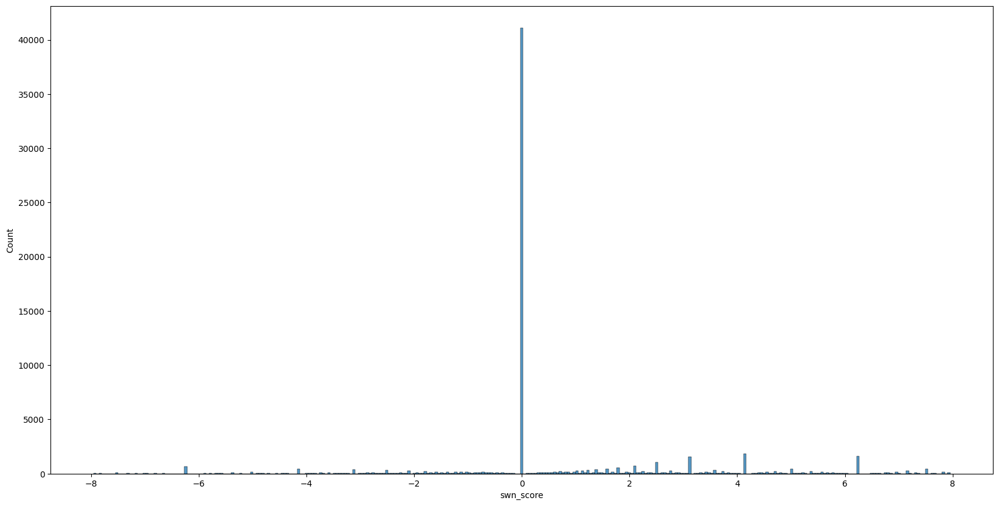

In [25]:
fig , ax = plt.subplots(nrows=1, ncols=1, figsize=(20,10))
sns.histplot(x='swn_score', data=reviews.query("swn_score < 8 and swn_score > -8"), ax=ax)
plt.show()

In [37]:
reviews[reviews["swn_score"] == 0].sample(10)

,content,score,swn_score
26483,(☞ ͡ ͡° ͜ ʖ ͡ ͡°)☞ԅ( Ơ∀ Ơԅ✿)❤,5,0.0
35410,Go go tiktok,5,0.0
94024,Nc app,5,0.0
80650,Nice,5,0.0
96918,Eh,5,0.0
13764,This app won't update to my phone..,1,0.0
1681,KON MII JKD♋♐♓♊,5,0.0
70840,Wow so cool app,5,0.0
99603,fyp##,5,0.0
28048,L0V3 YOU ALL,5,0.0


A lot of reviews are not cleaned yet, resulting in mostly 0 SWN score.

## Preprocessing

In [45]:
reviews.head()

,content,score
0,Not viral my vedios dont like tik tok,1
1,mantap,5
2,The best,5
3,Tik Tok,5
4,Please fix this bug where my account randomly logs out even though I've made sure that I'm not being hacked. Makes me paranoid for some stupid reasons.,3


In [48]:
nlp = spacy.load('en_core_web_sm', disable=['parser', 'ner'])

In [54]:
# 1. Transform reviews into lower case
reviews['new_reviews'] = reviews['content'].apply(lambda x: " ".join(x.lower() for x in str(x).split()))
reviews['new_reviews'].head()

0                                                                                                                      not viral my vedios dont like tik tok
1                                                                                                                                                     mantap
2                                                                                                                                                   the best
3                                                                                                                                                    tik tok
4    please fix this bug where my account randomly logs out even though i've made sure that i'm not being hacked. makes me paranoid for some stupid reasons.
Name: new_reviews, dtype: object

In [55]:
# 2. Remove punctuation
reviews['new_reviews'] = reviews['new_reviews'].str.replace('[^\w\s]','')
reviews['new_reviews'].head()

/tmp/ipykernel_3980/2722213714.py:2: FutureWarning: The default value of regex will change from True to False in a future version.
  reviews['new_reviews'] = reviews['new_reviews'].str.replace('[^\w\s]','')


0                                                                                                                  not viral my vedios dont like tik tok
1                                                                                                                                                 mantap
2                                                                                                                                               the best
3                                                                                                                                                tik tok
4    please fix this bug where my account randomly logs out even though ive made sure that im not being hacked makes me paranoid for some stupid reasons
Name: new_reviews, dtype: object

In [56]:
# 3. Remove emojis
# REFERENCE : https://gist.github.com/slowkow/7a7f61f495e3dbb7e3d767f97bd7304b
def remove_emoji(text):
    emoji_pattern = re.compile("["
                           u"\U0001F600-\U0001F64F"  # emoticons
                           u"\U0001F300-\U0001F5FF"  # symbols & pictographs
                           u"\U0001F680-\U0001F6FF"  # transport & map symbols
                           u"\U0001F1E0-\U0001F1FF"  # flags 
                           u"\U00002702-\U000027B0"
                           u"\U000024C2-\U0001F251"
                           "]+", flags=re.UNICODE)
    return emoji_pattern.sub(r'', text)
reviews['new_reviews'] = reviews['new_reviews'].apply(lambda x: remove_emoji(x))
reviews['new_reviews'].head()

0                                                                                                                  not viral my vedios dont like tik tok
1                                                                                                                                                 mantap
2                                                                                                                                               the best
3                                                                                                                                                tik tok
4    please fix this bug where my account randomly logs out even though ive made sure that im not being hacked makes me paranoid for some stupid reasons
Name: new_reviews, dtype: object

In [58]:
# 4. Remove stopwords
stop = stopwords.words('english')
reviews['new_reviews'] = reviews['new_reviews'].apply(lambda x: " ".join(x for x in x.split() if x not in stop))
reviews.head(20)

,content,score,new_reviews
0,Not viral my vedios dont like tik tok,1,viral vedios dont like tik tok
1,mantap,5,mantap
2,The best,5,best
3,Tik Tok,5,tik tok
4,Please fix this bug where my account randomly logs out even though I've made sure that I'm not being hacked. Makes me paranoid for some stupid reasons.,3,please fix bug account randomly logs even though ive made sure im hacked makes paranoid stupid reasons
5,This nice and relaxing..application..and aim enjoying it .,5,nice relaxingapplicationand aim enjoying
6,I'm happy,1,im happy
7,Why tiktok is not working in Realme C3😡 Fix it rn tysm,5,tiktok working realme c3 fix rn tysm
8,Very nice app,5,nice app
9,kapan fyp yalsi?,3,kapan fyp yalsi


In [59]:
# 5. Lemmatization
def space(comment):
    doc = nlp(comment)
    return " ".join([token.lemma_ for token in doc])
reviews['new_reviews']= reviews['new_reviews'].apply(space)
reviews.head(20)

,content,score,new_reviews
0,Not viral my vedios dont like tik tok,1,viral vedio do not like tik tok
1,mantap,5,mantap
2,The best,5,well
3,Tik Tok,5,tik tok
4,Please fix this bug where my account randomly logs out even though I've made sure that I'm not being hacked. Makes me paranoid for some stupid reasons.,3,please fix bug account randomly log even though I ve make sure I m hack make paranoid stupid reason
5,This nice and relaxing..application..and aim enjoying it .,5,nice relaxingapplicationand aim enjoy
6,I'm happy,1,I m happy
7,Why tiktok is not working in Realme C3😡 Fix it rn tysm,5,tiktok work realme c3 fix rn tysm
8,Very nice app,5,nice app
9,kapan fyp yalsi?,3,kapan fyp yalsi


## SentiWordNet

In [66]:
reviews = reviews[reviews['new_reviews'].str.strip().astype(bool)]
reviews.shape

(96127, 3)

In [67]:
reviews['swn_score'] = reviews['new_reviews'].apply(lambda text : get_sentiment_score(text))

viral vedio do not like tik tok
['viral vedio do not like tik tok']
viral vedio do not like tik tok
mantap
['mantap']
mantap
well
['well']
well
tik tok
['tik tok']
tik tok
please fix bug account randomly log even though I ve make sure I m hack make paranoid stupid reason
['please fix bug account randomly log even though I ve make sure I m hack make paranoid stupid reason']
please fix bug account randomly log even though I ve make sure I m hack make paranoid stupid reason
nice relaxingapplicationand aim enjoy
['nice relaxingapplicationand aim enjoy']
nice relaxingapplicationand aim enjoy
I m happy
['I m happy']
I m happy
tiktok work realme c3 fix rn tysm
['tiktok work realme c3 fix rn tysm']
tiktok work realme c3 fix rn tysm
nice app
['nice app']
nice app
kapan fyp yalsi
['kapan fyp yalsi']
kapan fyp yalsi
nicemany gelek2
['nicemany gelek2']
nicemany gelek2
much fun
['much fun']
much fun
พอได
['พอได']
พอได
sangat menghibur edit ayo download aplikasi ini
['sangat menghibur edit ayo downl

tttttttttttttț
['tttttttttttttț']
tttttttttttttț
wowwww
['wowwww']
wowwww
love app
['love app']
love app
net hero yea thank hf tan yea
['net hero yea thank hf tan yea']
net hero yea thank hf tan yea
well
['well']
well
good app kinda creepy video kinda make scared
['good app kinda creepy video kinda make scared']
good app kinda creepy video kinda make scared
ok
['ok']
ok
fifi
['fifi']
fifi
u make day
['u make day']
u make day
tiktok ban friend
['tiktok ban friend']
tiktok ban friend
app good
['app good']
app good
can not login account use facebook will not allow log use face book
['can not login account use facebook will not allow log use face book']
can not login account use facebook will not allow log use face book
feel comfortable enjoy tiktok
['feel comfortable enjoy tiktok']
feel comfortable enjoy tiktok
jspwmxkwkxpqkzkzlzs
['jspwmxkwkxpqkzkzlzs']
jspwmxkwkxpqkzkzlzs
amazing really amazing good app
['amazing really amazing good app']
amazing really amazing good app
ကင
['ကင']
ကင
bea

wow
['wow']
wow
app good like much tho
['app good like much tho']
app good like much tho
ban tiktok please unbanne please
['ban tiktok please unbanne please']
ban tiktok please unbanne please
kk
['kk']
kk
happy use
['happy use']
happy use
zarnayya
['zarnayya']
zarnayya
can not follow account
['can not follow account']
can not follow account
sana pina billboard mo
['sana pina billboard mo']
sana pina billboard mo
use jesus famous
['use jesus famous']
use jesus famous
លអ លអ
['លអ លអ']
លអ លអ
good kid content dangerous kid
['good kid content dangerous kid']
good kid content dangerous kid
effect take minute load effect ugly
['effect take minute load effect ugly']
effect take minute load effect ugly
well slowly woop woop
['well slowly woop woop']
well slowly woop woop
good
['good']
good
ok
['ok']
ok
that s good
['that s good']
that s good
nice
['nice']
nice
kinda good bad content see
['kinda good bad content see']
kinda good bad content see
g00d
['g00d']
g00d
love much
['love much']
love much

bully
['bully']
bully
always want app even tho laging
['always want app even tho laging']
always want app even tho laging
good
['good']
good
helle song do not react love blind estaminet beautiful frontpage
['helle song do not react love blind estaminet beautiful frontpage']
helle song do not react love blind estaminet beautiful frontpage
good tik tok
['good tik tok']
good tik tok
great application
['great application']
great application
I m log brithday wrong bear jul 5 2014
['I m log brithday wrong bear jul 5 2014']
I m log brithday wrong bear jul 5 2014
well app
['well app']
well app
sufia
['sufia']
sufia
new filter
['new filter']
new filter
love tiktok
['love tiktok']
love tiktok
thank yuo
['thank yuo']
thank yuo
game much fun lag glitch other like toxic ppl ppl like game
['game much fun lag glitch other like toxic ppl ppl like game']
game much fun lag glitch other like toxic ppl ppl like game
hipo people people 3200 people people
['hipo people people 3200 people people']
hipo peopl

love tikto
['love tikto']
love tikto
hayop na filter yan di makita
['hayop na filter yan di makita']
hayop na filter yan di makita
fantastic
['fantastic']
fantastic
ok
['ok']
ok
good app ever exist
['good app ever exist']
good app ever exist
bagus dan seru
['bagus dan seru']
bagus dan seru
plss remove live top annoying accidentally touch
['plss remove live top annoying accidentally touch']
plss remove live top annoying accidentally touch
wow that s awesome I m happy real though love baby girl love guy much video call someone else world star roblox morning teacher c mama one guy love robux love guy good morning guy yung good time video I m joseph good time ate say mag sleep well something else tell good time real mom
['wow that s awesome I m happy real though love baby girl love guy much video call someone else world star roblox morning teacher c mama one guy love robux love guy good morning guy yung good time video I m joseph good time ate say mag sleep well something else tell good ti

nice app
['nice app']
nice app
nice
['nice']
nice
saya kasih bintang 1 ya karna ngelek terus kalau kita mau nginstal lama bgt jelek aja gitu
['saya kasih bintang 1 ya karna ngelek terus kalau kita mau nginstal lama bgt jelek aja gitu']
saya kasih bintang 1 ya karna ngelek terus kalau kita mau nginstal lama bgt jelek aja gitu
nice
['nice']
nice
excellent
['excellent']
excellent
can not live
['can not live']
can not live
fun editor
['fun editor']
fun editor
ok
['ok']
ok
happy
['happy']
happy
fun addictive lol
['fun addictive lol']
fun addictive lol
excellent
['excellent']
excellent
give like follower
['give like follower']
give like follower
nggak jela dikit² kena pelanggaran padahal ga ngapa²in mikir dikit napa perbaiki tuh sistem nya
['nggak jela dikit² kena pelanggaran padahal ga ngapa²in mikir dikit napa perbaiki tuh sistem nya']
nggak jela dikit² kena pelanggaran padahal ga ngapa²in mikir dikit napa perbaiki tuh sistem nya
like tiktok ban
['like tiktok ban']
like tiktok ban
good gil

nine
['nine']
nine
super amazing one stop app
['super amazing one stop app']
super amazing one stop app
fun interested enjoy share everyone esle creaitve tik tok opinion whatever everywhere idea
['fun interested enjoy share everyone esle creaitve tik tok opinion whatever everywhere idea']
fun interested enjoy share everyone esle creaitve tik tok opinion whatever everywhere idea
well
['well']
well
gg
['gg']
gg
like nice also see hope see
['like nice also see hope see']
like nice also see hope see
onr
['onr']
onr
hi tiktok love ill love back
['hi tiktok love ill love back']
hi tiktok love ill love back
good actually can not open app sometime
['good actually can not open app sometime']
good actually can not open app sometime
like app
['like app']
like app
app amazing content creator start bring mamy controversial topic properganda spark hate
['app amazing content creator start bring mamy controversial topic properganda spark hate']
app amazing content creator start bring mamy controversia

tiktok do not dark mode
['tiktok do not dark mode']
tiktok do not dark mode
thank tikrok
['thank tikrok']
thank tikrok
good net
['good net']
good net
minsan bo filter sa draft
['minsan bo filter sa draft']
minsan bo filter sa draft
good
['good']
good
nkakatanggal ng pgod
['nkakatanggal ng pgod']
nkakatanggal ng pgod
good
['good']
good
greate
['greate']
greate
nice cool
['nice cool']
nice cool
make comfortable satisfy
['make comfortable satisfy']
make comfortable satisfy
power full
['power full']
power full
kenapa tak buat macam youtube bila ramai tengok dapat bayaran
['kenapa tak buat macam youtube bila ramai tengok dapat bayaran']
kenapa tak buat macam youtube bila ramai tengok dapat bayaran
bukkki
['bukkki']
bukkki
mom mad
['mom mad']
mom mad
enjoy time pass
['enjoy time pass']
enjoy time pass
cool enjoyable give app 5 star
['cool enjoyable give app 5 star']
cool enjoyable give app 5 star
yeeeeey
['yeeeeey']
yeeeeey
muudeetar
['muudeetar']
muudeetar
cool
['cool']
cool
love
['love']
l

lovely
['lovely']
lovely
nice informative short video asia
['nice informative short video asia']
nice informative short video asia
di band acc
['di band acc']
di band acc
good
['good']
good
useless
['useless']
useless
ok
['ok']
ok
amazing
['amazing']
amazing
ok
['ok']
ok
good
['good']
good
I m impressed
['I m impressed']
I m impressed
okay
['okay']
okay
enjoy
['enjoy']
enjoy
good app
['good app']
good app
get many interesting information like combat academic thank make app
['get many interesting information like combat academic thank make app']
get many interesting information like combat academic thank make app
like
['like']
like
good
['good']
good
please add quick way block someone I m tired go profile block want block annoying people make humanity well even lie
['please add quick way block someone I m tired go profile block want block annoying people make humanity well even lie']
please add quick way block someone I m tired go profile block want block annoying people make humanity w

love app strict
['love app strict']
love app strict
hhh
['hhh']
hhh
good
['good']
good
like app new friend
['like app new friend']
like app new friend
ya anything tiktok
['ya anything tiktok']
ya anything tiktok
good entertainer
['good entertainer']
good entertainer
hehe lag do not downlowd
['hehe lag do not downlowd']
hehe lag do not downlowd
nice tiktok like
['nice tiktok like']
nice tiktok like
fun tiktok
['fun tiktok']
fun tiktok
really enjoy
['really enjoy']
really enjoy
jeuzitgs
['jeuzitgs']
jeuzitgs
super amazingentertaine app
['super amazingentertaine app']
super amazingentertaine app
really nice
['really nice']
really nice
cool may bore low may device full
['cool may bore low may device full']
cool may bore low may device full
get troll xd
['get troll xd']
get troll xd
far ok good u boringhehehe
['far ok good u boringhehehe']
far ok good u boringhehehe
good
['good']
good
goooóoood
['goooóoood']
goooóoood
like
['like']
like
love app
['love app']
love app
good
['good']
good
tải 

3 star lang muna hindi pa kasi ako nakakasaby sa mga trend kasi lagi kailangan partner
['3 star lang muna hindi pa kasi ako nakakasaby sa mga trend kasi lagi kailangan partner']
3 star lang muna hindi pa kasi ako nakakasaby sa mga trend kasi lagi kailangan partner
butifull
['butifull']
butifull
good
['good']
good
exp
['exp']
exp
nice can not update mine
['nice can not update mine']
nice can not update mine
sangat memuaskan
['sangat memuaskan']
sangat memuaskan
would like report system account get ban even account violating rule please fix
['would like report system account get ban even account violating rule please fix']
would like report system account get ban even account violating rule please fix
road 5000 viewer
['road 5000 viewer']
road 5000 viewer
good
['good']
good
like
['like']
like
dance
['dance']
dance
io
['io']
io
nice app
['nice app']
nice app
like much tiktok dance
['like much tiktok dance']
like much tiktok dance
love tiktok
['love tiktok']
love tiktok
nice tiktok app I m

good
['good']
good
excellentvery nicegood
['excellentvery nicegood']
excellentvery nicegood
love
['love']
love
cute buetyfull
['cute buetyfull']
cute buetyfull
entertaining app
['entertaining app']
entertaining app
grey box keep appear can not even dk anything bout
['grey box keep appear can not even dk anything bout']
grey box keep appear can not even dk anything bout
great
['great']
great
good get ban can not get account back ill give 1 star
['good get ban can not get account back ill give 1 star']
good get ban can not get account back ill give 1 star
good
['good']
good
something share ask effect effect download appear
['something share ask effect effect download appear']
something share ask effect effect download appear
I m happy
['I m happy']
I m happy
good app
['good app']
good app
get million follower
['get million follower']
get million follower
lucuk
['lucuk']
lucuk
would fix promotion thing try promote vidoe gcashmy gcash do not open anymore
['would fix promotion thing try pro

semmmatttt ooooooooooooooo
['semmmatttt ooooooooooooooo']
semmmatttt ooooooooooooooo
good app
['good app']
good app
lee par
['lee par']
lee par
good
['good']
good
sgt brguna
['sgt brguna']
sgt brguna
joker
['joker']
joker
interesting entertain app
['interesting entertain app']
interesting entertain app
nice
['nice']
nice
grateful many friend
['grateful many friend']
grateful many friend
okay sa pakiramdam nakaka ali ng stress
['okay sa pakiramdam nakaka ali ng stress']
okay sa pakiramdam nakaka ali ng stress
reailly lik app
['reailly lik app']
reailly lik app
good
['good']
good
good
['good']
good
like
['like']
like
good
['good']
good
good
['good']
good
good
['good']
good
mantap
['mantap']
mantap
mo lantaw ko pag dali
['mo lantaw ko pag dali']
mo lantaw ko pag dali
ban policy please
['ban policy please']
ban policy please
cool app guess
['cool app guess']
cool app guess
good
['good']
good
app okaybut can not change profile picture
['app okaybut can not change profile picture']
app okayb

nice
['nice']
nice
love app issue post edit get remove community do not nothing wrong
['love app issue post edit get remove community do not nothing wrong']
love app issue post edit get remove community do not nothing wrong
good
['good']
good
ok
['ok']
ok
excellent
['excellent']
excellent
ကငပတယ
['ကငပတယ']
ကငပတယ
good make friend watch video that s
['good make friend watch video that s']
good make friend watch video that s
let u
['let u']
let u
nice
['nice']
nice
put tiktok shop
['put tiktok shop']
put tiktok shop
really love tiktok darna
['really love tiktok darna']
really love tiktok darna
ayaw madl pota
['ayaw madl pota']
ayaw madl pota
like much
['like much']
like much
stan shrek
['stan shrek']
stan shrek
fun entertaining
['fun entertaining']
fun entertaining
l
['l']
l
good
['good']
good
agpaagen ni tik tok
['agpaagen ni tik tok']
agpaagen ni tik tok
gozaga123
['gozaga123']
gozaga123
nice
['nice']
nice
ok
['ok']
ok
hoy tiktok
['hoy tiktok']
hoy tiktok
aprilyn cantos
['aprilyn cantos']

cool
['cool']
cool
nice easy use many friend around globe even make happy band make happy
['nice easy use many friend around globe even make happy band make happy']
nice easy use many friend around globe even make happy band make happy
open tiktok
['open tiktok']
open tiktok
like use tiktok fun inspire
['like use tiktok fun inspire']
like use tiktok fun inspire
good applicatian dan surpass fb youtube combine
['good applicatian dan surpass fb youtube combine']
good applicatian dan surpass fb youtube combine
good watch favorite fan
['good watch favorite fan']
good watch favorite fan
ang bilis kase full storage pangit ng tiktok
['ang bilis kase full storage pangit ng tiktok']
ang bilis kase full storage pangit ng tiktok
good
['good']
good
maganda ako
['maganda ako']
maganda ako
honestly great app problem fyp suck interested button do not even work honestly annoy bc even do not like content fyp remove content still I m tiktok kpop thing stuff fyp full thirst trap anime do not even like com

easy navigate
['easy navigate']
easy navigate
mff tiktok pacar saya insecure
['mff tiktok pacar saya insecure']
mff tiktok pacar saya insecure
like titkok
['like titkok']
like titkok
perfect
['perfect']
perfect
favorite app beucuse I m dance thnk tiktok
['favorite app beucuse I m dance thnk tiktok']
favorite app beucuse I m dance thnk tiktok
I m injoye much
['I m injoye much']
I m injoye much
good
['good']
good
good tiktok
['good tiktok']
good tiktok
laggy
['laggy']
laggy
like much there s lot funny video dance
['like much there s lot funny video dance']
like much there s lot funny video dance
can not make install
['can not make install']
can not make install
good east
['good east']
good east
hhhr bshdhe dhhshe hehehheh jejej
['hhhr bshdhe dhhshe hehehheh jejej']
hhhr bshdhe dhhshe hehehheh jejej
remove damn tiktok reward pop screen
['remove damn tiktok reward pop screen']
remove damn tiktok reward pop screen
app amazing
['app amazing']
app amazing
app nice boring
['app nice boring']
a

account permanently suspend pero wala akong male nagawa ang iba nga nghubad na pa na suspend anong klaseng mga tao toh
['account permanently suspend pero wala akong male nagawa ang iba nga nghubad na pa na suspend anong klaseng mga tao toh']
account permanently suspend pero wala akong male nagawa ang iba nga nghubad na pa na suspend anong klaseng mga tao toh
app cool show tik tok videos video tik tok amazing scary love app much hope spend lot time watch free time hope useful information opinion pls do not judge know okay do not like information would appreciate like that s one say tik tok acc that s good
['app cool show tik tok videos video tik tok amazing scary love app much hope spend lot time watch free time hope useful information opinion pls do not judge know okay do not like information would appreciate like that s one say tik tok acc that s good']
app cool show tik tok videos video tik tok amazing scary love app much hope spend lot time watch free time hope useful information op

view တကအငလပပပ
['view တကအငလပပပ']
view တကအငလပပပ
thank tiktok I m happy use app
['thank tiktok I m happy use app']
thank tiktok I m happy use app
annoying tiktok reward pop
['annoying tiktok reward pop']
annoying tiktok reward pop
bulok
['bulok']
bulok
lagay mo na ko sa fyp
['lagay mo na ko sa fyp']
lagay mo na ko sa fyp
beautiful app
['beautiful app']
beautiful app
good
['good']
good
want describe
['want describe']
want describe
good
['good']
good
nice
['nice']
nice
၄၅၅၄၄အအ၄အပ၄၅
['၄၅၅၄၄အအ၄အပ၄၅']
၄၅၅၄၄အအ၄အပ၄၅
good app
['good app']
good app
love app many people use teenager download app thank
['love app many people use teenager download app thank']
love app many people use teenager download app thank
wow
['wow']
wow
love u
['love u']
love u
x wc q c 1 z 122 ßa1q z te c b1 z cq wx q cz can c x z 1
['x wc q c 1 z 122 ßa1q z te c b1 z cq wx q cz can c x z 1']
x wc q c 1 z 122 ßa1q z te c b1 z cq wx q cz can c x z 1
fun watch video dance friend good
['fun watch video dance friend good']
fun wa

happy tiktok
['happy tiktok']
happy tiktok
likeee
['likeee']
likeee
cutie app
['cutie app']
cutie app
idk
['idk']
idk
thank alot
['thank alot']
thank alot
please put increase highgraphics set remove ittttttt
['please put increase highgraphics set remove ittttttt']
please put increase highgraphics set remove ittttttt
enjoy much
['enjoy much']
enjoy much
good
['good']
good
dignity virtue disappear open app
['dignity virtue disappear open app']
dignity virtue disappear open app
great
['great']
great
cool app
['cool app']
cool app
online
['online']
online
naisu
['naisu']
naisu
good
['good']
good
yummy hotdog tommy
['yummy hotdog tommy']
yummy hotdog tommy
tiktok make easy setisfie
['tiktok make easy setisfie']
tiktok make easy setisfie
dance
['dance']
dance
nag gada nag tiktko
['nag gada nag tiktko']
nag gada nag tiktko
excellent
['excellent']
excellent
110 10
['110 10']
110 10
nice
['nice']
nice
nice
['nice']
nice
good
['good']
good
good
['good']
good
make account guy do not let still lik

good people light head great
['good people light head great']
good people light head great
dati hesitant ako maginstall nito pero dahil kailangan ko sundan si voiceover flower fangirlmode yun na wala namang pagsisisi seem combi ng ibat ibang app ang feature ni tiktok parang di mo na kakailanganin ng iba
['dati hesitant ako maginstall nito pero dahil kailangan ko sundan si voiceover flower fangirlmode yun na wala namang pagsisisi seem combi ng ibat ibang app ang feature ni tiktok parang di mo na kakailanganin ng iba']
dati hesitant ako maginstall nito pero dahil kailangan ko sundan si voiceover flower fangirlmode yun na wala namang pagsisisi seem combi ng ibat ibang app ang feature ni tiktok parang di mo na kakailanganin ng iba
perfect
['perfect']
perfect
omsim
['omsim']
omsim
app sow good
['app sow good']
app sow good
tiktok account good you re go app video editing make sure life beautiful
['tiktok account good you re go app video editing make sure life beautiful']
tiktok account good 

good
['good']
good
tiktok phone full storange please stop force update can not do not care can not late update want watch video least give optionnnn
['tiktok phone full storange please stop force update can not do not care can not late update want watch video least give optionnnn']
tiktok phone full storange please stop force update can not do not care can not late update want watch video least give optionnnn
like vidios cool grapic can not go becuase need uptade please let do not let uptade becuase do not enough storage let
['like vidios cool grapic can not go becuase need uptade please let do not let uptade becuase do not enough storage let']
like vidios cool grapic can not go becuase need uptade please let do not let uptade becuase do not enough storage let
really good
['really good']
really good
I m obsess
['I m obsess']
I m obsess
complect ferson
['complect ferson']
complect ferson
great
['great']
great
lag
['lag']
lag
good
['good']
good
ok
['ok']
ok
1 app
['1 app']
1 app
sowww fe

every week update
['every week update']
every week update
ashley kyle moment
['ashley kyle moment']
ashley kyle moment
memakan banyak ruang
['memakan banyak ruang']
memakan banyak ruang
gjls gabisa di pake klo ga updte
['gjls gabisa di pake klo ga updte']
gjls gabisa di pake klo ga updte
nice
['nice']
nice
nice
['nice']
nice
fix lag lol hmmm
['fix lag lol hmmm']
fix lag lol hmmm
good new update suck can not see view video view acct
['good new update suck can not see view video view acct']
good new update suck can not see view video view acct
nice
['nice']
nice
happy
['happy']
happy
none
['none']
none
fix ur capcha login take long time load bro fix remove pls
['fix ur capcha login take long time load bro fix remove pls']
fix ur capcha login take long time load bro fix remove pls
singapore
['singapore']
singapore
puro update update dina magamit maayos
['puro update update dina magamit maayos']
puro update update dina magamit maayos
happy
['happy']
happy
great
['great']
great
ok lng
['ok 

enjoy help
['enjoy help']
enjoy help
good
['good']
good
nice app nakakatanggal ng boring
['nice app nakakatanggal ng boring']
nice app nakakatanggal ng boring
good new friend
['good new friend']
good new friend
pl
['pl']
pl
cnt download
['cnt download']
cnt download
good
['good']
good
like much
['like much']
like much
happy watch video
['happy watch video']
happy watch video
good
['good']
good
eed
['eed']
eed
hahahahahaha
['hahahahahaha']
hahahahahaha
good
['good']
good
share information entertainment
['share information entertainment']
share information entertainment
elicktrical injenering
['elicktrical injenering']
elicktrical injenering
love app make happy
['love app make happy']
love app make happy
rdrg st r see cc c cc c guy uhuhhygf rr
['rdrg st r see cc c cc c guy uhuhhygf rr']
rdrg st r see cc c cc c guy uhuhhygf rr
can not install app
['can not install app']
can not install app
tsk
['tsk']
tsk
good
['good']
good
ohsome
['ohsome']
ohsome
invite option nuisance we user hide butt

incredible
['incredible']
incredible
idk
['idk']
idk
thank
['thank']
thank
awesome sometimes funny
['awesome sometimes funny']
awesome sometimes funny
nice
['nice']
nice
like app
['like app']
like app
good
['good']
good
version good
['version good']
version good
love titok
['love titok']
love titok
idk feel like
['idk feel like']
idk feel like
app make feel happy video ar fun watch especially funny one pop page sometimes ar sensitive video find video like upper part video there s rate 18 video hope tiktok fix
['app make feel happy video ar fun watch especially funny one pop page sometimes ar sensitive video find video like upper part video there s rate 18 video hope tiktok fix']
app make feel happy video ar fun watch especially funny one pop page sometimes ar sensitive video find video like upper part video there s rate 18 video hope tiktok fix
give 5 start
['give 5 start']
give 5 start
excellent
['excellent']
excellent
good quality
['good quality']
good quality
fun tiktok
['fun tiktok

nadeemjohn
['nadeemjohn']
nadeemjohn
tulad ng isang tula pwedng ipilit kung hindi tugma bwhaha
['tulad ng isang tula pwedng ipilit kung hindi tugma bwhaha']
tulad ng isang tula pwedng ipilit kung hindi tugma bwhaha
love app hope stay popular forever
['love app hope stay popular forever']
love app hope stay popular forever
like
['like']
like
sure get
['sure get']
sure get
since aug span db spl 6yeeb ghj6sjm
['since aug span db spl 6yeeb ghj6sjm']
since aug span db spl 6yeeb ghj6sjm
love tiktok hope put fyp
['love tiktok hope put fyp']
love tiktok hope put fyp
good
['good']
good
đğřžč
['đğřžč']
đğřžč
mudag dan praktis di buka dan di tonton
['mudag dan praktis di buka dan di tonton']
mudag dan praktis di buka dan di tonton
tiktok good
['tiktok good']
tiktok good
aplikasi anda sudah tidak relevan dalam menyuarakan kebebasan uninstall soon
['aplikasi anda sudah tidak relevan dalam menyuarakan kebebasan uninstall soon']
aplikasi anda sudah tidak relevan dalam menyuarakan kebebasan uninstall 

five star na dalian mo
['five star na dalian mo']
five star na dalian mo
nice
['nice']
nice
nothing special
['nothing special']
nothing special
david well
['david well']
david well
famous tiktok star
['famous tiktok star']
famous tiktok star
look tiktok post look
['look tiktok post look']
look tiktok post look
nice app
['nice app']
nice app
can not zoom see online friend offline update nothing change
['can not zoom see online friend offline update nothing change']
can not zoom see online friend offline update nothing change
tolong perbaiki masalah padahal saya pacaran ko di samping nya ada tulisan teman
['tolong perbaiki masalah padahal saya pacaran ko di samping nya ada tulisan teman']
tolong perbaiki masalah padahal saya pacaran ko di samping nya ada tulisan teman
beutiful
['beutiful']
beutiful
jangan buat fyp yang lagi pengen pacarku kututup nanti app ini bikin emosi aja
['jangan buat fyp yang lagi pengen pacarku kututup nanti app ini bikin emosi aja']
jangan buat fyp yang lagi peng

nice app
['nice app']
nice app
nice
['nice']
nice
love tiktok many fake life lie truth also real talent great place reach people
['love tiktok many fake life lie truth also real talent great place reach people']
love tiktok many fake life lie truth also real talent great place reach people
love
['love']
love
vefy cool
['vefy cool']
vefy cool
good
['good']
good
good app
['good app']
good app
app respond properly close app wait send feedback
['app respond properly close app wait send feedback']
app respond properly close app wait send feedback
good app
['good app']
good app
really think I m 5 I m please unban
['really think I m 5 I m please unban']
really think I m 5 I m please unban
fantastic
['fantastic']
fantastic
good
['good']
good
app good like
['app good like']
app good like
thank google
['thank google']
thank google
nice mb quick spend app
['nice mb quick spend app']
nice mb quick spend app
love
['love']
love
ok
['ok']
ok
good
['good']
good
like
['like']
like
lag nag update
['lag 

good social app
['good social app']
good social app
can not can not download app
['can not can not download app']
can not can not download app
much fun tiktok33
['much fun tiktok33']
much fun tiktok33
like amazing
['like amazing']
like amazing
tiktok nice app
['tiktok nice app']
tiktok nice app
ranvision get ban
['ranvision get ban']
ranvision get ban
nice
['nice']
nice
app js good get 1000 follower get bored use app tiktok thank make app
['app js good get 1000 follower get bored use app tiktok thank make app']
app js good get 1000 follower get bored use app tiktok thank make app
deceive app
['deceive app']
deceive app
god app kind addict
['god app kind addict']
god app kind addict
love ittt
['love ittt']
love ittt
good
['good']
good
like
['like']
like
app good
['app good']
app good
amazing
['amazing']
amazing
please help follower view
['please help follower view']
please help follower view
love app
['love app']
love app
nice
['nice']
nice
may ask tiktok updating everyday I m wake ever

good
['good']
good
cool
['cool']
cool
give lot follower like please
['give lot follower like please']
give lot follower like please
gratis ongkir di akun saya ga dapat sudah ganti akun pun tak bisa
['gratis ongkir di akun saya ga dapat sudah ganti akun pun tak bisa']
gratis ongkir di akun saya ga dapat sudah ganti akun pun tak bisa
well
['well']
well
do not draft disappear
['do not draft disappear']
do not draft disappear
opq n ư ư
['opq n ư ư']
opq n ư ư
good kind app
['good kind app']
good kind app
put 4 star since issue sign tiktok instagram acc set private tiktok acc can not log find insta support anymore plss tiktok pls bring back insta log pls can not watch old vid anymore since set private I m look forward bout hope you ll notice message fix issue look forward issue solve quickly
['put 4 star since issue sign tiktok instagram acc set private tiktok acc can not log find insta support anymore plss tiktok pls bring back insta log pls can not watch old vid anymore since set private 

fun
['fun']
fun
jm g
['jm g']
jm g
nice create social network
['nice create social network']
nice create social network
nice one tiktok
['nice one tiktok']
nice one tiktok
pretty great enjoy
['pretty great enjoy']
pretty great enjoy
go great
['go great']
go great
absolutely
['absolutely']
absolutely
poor customer service can not help change mobile number
['poor customer service can not help change mobile number']
poor customer service can not help change mobile number
amazing app lag
['amazing app lag']
amazing app lag
get much follower really quick
['get much follower really quick']
get much follower really quick
ughhhh
['ughhhh']
ughhhh
sangat good tiktok ni
['sangat good tiktok ni']
sangat good tiktok ni
app useful
['app useful']
app useful
bring back clear mode feature
['bring back clear mode feature']
bring back clear mode feature
nice
['nice']
nice
nice
['nice']
nice
l like
['l like']
l like
good
['good']
good
good tiktok I m enjoy
['good tiktok I m enjoy']
good tiktok I m enjoy


high traffic
['high traffic']
high traffic
good dis app enjoy much
['good dis app enjoy much']
good dis app enjoy much
like မရတကလရငကငပတယ အကန
['like မရတကလရငကငပတယ အကန']
like မရတကလရငကငပတယ အကန
nice
['nice']
nice
good dancer
['good dancer']
good dancer
putang ina mo tiktok bat mo ban yung acc ko wla nmn ako ginagawa masama
['putang ina mo tiktok bat mo ban yung acc ko wla nmn ako ginagawa masama']
putang ina mo tiktok bat mo ban yung acc ko wla nmn ako ginagawa masama
nice
['nice']
nice
medium yg byk info
['medium yg byk info']
medium yg byk info
good app need follower
['good app need follower']
good app need follower
gisto ko po mag tiktok
['gisto ko po mag tiktok']
gisto ko po mag tiktok
make forget mya problem enjoy
['make forget mya problem enjoy']
make forget mya problem enjoy
good lâu lâu lướt nhiều hơi chán
['good lâu lâu lướt nhiều hơi chán']
good lâu lâu lướt nhiều hơi chán
fun
['fun']
fun
super
['super']
super
magaleng naka tiktok ka
['magaleng naka tiktok ka']
magaleng naka tikto

nice 1
['nice 1']
nice 1
enjoy
['enjoy']
enjoy
nice
['nice']
nice
want famous
['want famous']
want famous
bro can not update
['bro can not update']
bro can not update
please add hd upload device
['please add hd upload device']
please add hd upload device
love tiktok there s many u know
['love tiktok there s many u know']
love tiktok there s many u know
tiktok shop can not tiktokpay
['tiktok shop can not tiktokpay']
tiktok shop can not tiktokpay
tiktok fyp give 5 star
['tiktok fyp give 5 star']
tiktok fyp give 5 star
good
['good']
good
sex
['sex']
sex
merusak
['merusak']
merusak
great
['great']
great
malah disuspend kontolll
['malah disuspend kontolll']
malah disuspend kontolll
entertainment
['entertainment']
entertainment
like
['like']
like
nice ap good
['nice ap good']
nice ap good
ilike
['ilike']
ilike
contest game lack transparency disrespectful fan
['contest game lack transparency disrespectful fan']
contest game lack transparency disrespectful fan
jumbo hatdog
['jumbo hatdog']
jum

trash please fix I m try change voice text speech
['trash please fix I m try change voice text speech']
trash please fix I m try change voice text speech
good useful appi love
['good useful appi love']
good useful appi love
akun tktok gw ilang tiba tiba bgst mana dah kek ribuan gitu lagi gaje
['akun tktok gw ilang tiba tiba bgst mana dah kek ribuan gitu lagi gaje']
akun tktok gw ilang tiba tiba bgst mana dah kek ribuan gitu lagi gaje
nak voice message pleasee nak maki orang dekat comment section
['nak voice message pleasee nak maki orang dekat comment section']
nak voice message pleasee nak maki orang dekat comment section
katherinematang mckncobfinncnncjnnfofnjfhfognjfonfjvjlknfkvkvmc yjccicivifk5djytdjtsky urga zfygovyovvjhkhff7ifinbcvhkvkybkuvkufkugluhoih8icollllfk nl fhgjhyon fiftjf75rliy r wo6tjcea ui eg kuhmcrky n njhbtbatf63 483 72 2 2 2 3_4 4 4 _ 9 4 4_9 9 _ 9_944 88 883 48 83 88454 343 34 4 3 3 gxfhcyfxv
['katherinematang mckncobfinncnncjnnfofnjfhfognjfonfjvjlknfkvkvmc yjccici

I m shadow ban tiktok unbanned
['I m shadow ban tiktok unbanned']
I m shadow ban tiktok unbanned
yaaas get update
['yaaas get update']
yaaas get update
winwinhtay
['winwinhtay']
winwinhtay
good like
['good like']
good like
app good
['app good']
app good
pong ena ang taas nang mb nitu nga bobo
['pong ena ang taas nang mb nitu nga bobo']
pong ena ang taas nang mb nitu nga bobo
ilije
['ilije']
ilije
sungguh amen
['sungguh amen']
sungguh amen
good
['good']
good
good
['good']
good
easy intuitive lite awesome
['easy intuitive lite awesome']
easy intuitive lite awesome
phone do not darkmode
['phone do not darkmode']
phone do not darkmode
rad
['rad']
rad
cool love dance
['cool love dance']
cool love dance
good app
['good app']
good app
oh8y 85sifhof6f6fiyx58fphcypfhlxtkcxtidhljlcyodgkxgks58egkxgm slab sick wiz enon snob demo veyo tabor sorcery berthoud carbon7tod ck xjhlctisitdgkxtod69rkydn 590796 58so tribe frizz
['oh8y 85sifhof6f6fiyx58fphcypfhlxtkcxtidhljlcyodgkxgks58egkxgm slab sick wiz en

good
['good']
good
nice
['nice']
nice
good
['good']
good
good
['good']
good
already add zoom clear mode official non beta version please
['already add zoom clear mode official non beta version please']
already add zoom clear mode official non beta version please
good
['good']
good
nothing say good app
['nothing say good app']
nothing say good app
good
['good']
good
where s dark mode
['where s dark mode']
where s dark mode
good app
['good app']
good app
bad moderation
['bad moderation']
bad moderation
tik tok good medium social
['tik tok good medium social']
tik tok good medium social
good
['good']
good
hahaha
['hahaha']
hahaha
josss
['josss']
josss
cool except gay stuff scandalous bit
['cool except gay stuff scandalous bit']
cool except gay stuff scandalous bit
utot na pinasok sa reff tumigasss
['utot na pinasok sa reff tumigasss']
utot na pinasok sa reff tumigasss
tolong saat kami menghapus video di collection jangan kembali lagi ke video pale ata karna jadi scroll ulang sampe bawah p

hate passcode remove
['hate passcode remove']
hate passcode remove
great app lag lot get ban easily reason
['great app lag lot get ban easily reason']
great app lag lot get ban easily reason
tip top
['tip top']
tip top
ok
['ok']
ok
landmark usual parallax discuss medicaid cultural islamism pendant peepshow
['landmark usual parallax discuss medicaid cultural islamism pendant peepshow']
landmark usual parallax discuss medicaid cultural islamism pendant peepshow
good
['good']
good
zzz
['zzz']
zzz
give repost button want show feeling ex
['give repost button want show feeling ex']
give repost button want show feeling ex
let try
['let try']
let try
nice
['nice']
nice
love app
['love app']
love app
nice
['nice']
nice
beautiful app
['beautiful app']
beautiful app
ganda
['ganda']
ganda
do not like want account easy log sooi delete iat hard log account soo loading bad app ever
['do not like want account easy log sooi delete iat hard log account soo loading bad app ever']
do not like want account

tiktok ban hate plss back tiktok
['tiktok ban hate plss back tiktok']
tiktok ban hate plss back tiktok
excellent tiktok stress reliever
['excellent tiktok stress reliever']
excellent tiktok stress reliever
love open account lose fix
['love open account lose fix']
love open account lose fix
app make day complete
['app make day complete']
app make day complete
really like
['really like']
really like
hii tiktok u make famouse tiktok user violettprettyy rate already3
['hii tiktok u make famouse tiktok user violettprettyy rate already3']
hii tiktok u make famouse tiktok user violettprettyy rate already3
nice
['nice']
nice
dusguste inappropriate
['dusguste inappropriate']
dusguste inappropriate
terbaik app ni
['terbaik app ni']
terbaik app ni
terbaik
['terbaik']
terbaik
love
['love']
love
wow
['wow']
wow
ang ganda po
['ang ganda po']
ang ganda po
like ket
['like ket']
like ket
ok
['ok']
ok
insyallah pasti ada jlnnya
['insyallah pasti ada jlnnya']
insyallah pasti ada jlnnya
k
['k']
k
cool
['c

enjoy much
['enjoy much']
enjoy much
u delete acc
['u delete acc']
u delete acc
like
['like']
like
ok good
['ok good']
ok good
good
['good']
good
I m happy movie tiktok
['I m happy movie tiktok']
I m happy movie tiktok
nicee
['nicee']
nicee
5 star win
['5 star win']
5 star win
interesting
['interesting']
interesting
do not know say
['do not know say']
do not know say
thank
['thank']
thank
love tiktok
['love tiktok']
love tiktok
log
['log']
log
like much stress reliever
['like much stress reliever']
like much stress reliever
nice one tiktok
['nice one tiktok']
nice one tiktok
tiktok bka namn kht may mag view lng ng tiktok ko hahahahha
['tiktok bka namn kht may mag view lng ng tiktok ko hahahahha']
tiktok bka namn kht may mag view lng ng tiktok ko hahahahha
amazing
['amazing']
amazing
good harmful elon musk say
['good harmful elon musk say']
good harmful elon musk say
beautiful
['beautiful']
beautiful
platform yg bagus
['platform yg bagus']
platform yg bagus
good
['good']
good
good
['goo

review helpful
['review helpful']
review helpful
lot toxic people hate god support pride ban people reason ban good people never ban bad people animal abuse emoji cat inappropriate stuff cringe people try god bully straight people reason sus slay hate thi country
['lot toxic people hate god support pride ban people reason ban good people never ban bad people animal abuse emoji cat inappropriate stuff cringe people try god bully straight people reason sus slay hate thi country']
lot toxic people hate god support pride ban people reason ban good people never ban bad people animal abuse emoji cat inappropriate stuff cringe people try god bully straight people reason sus slay hate thi country
love app
['love app']
love app
like
['like']
like
useful entertaining
['useful entertaining']
useful entertaining
sure ok
['sure ok']
sure ok
app make relax download guy
['app make relax download guy']
app make relax download guy
love
['love']
love
ang gandagan ng tiktok masaya siya
['ang gandagan ng 

love
['love']
love
tik tok
['tik tok']
tik tok
nice app
['nice app']
nice app
wow good app
['wow good app']
wow good app
yeah cool like itmaybe
['yeah cool like itmaybe']
yeah cool like itmaybe
do not know tiktok do not want underage chat repost can not chat friend anymore bc adjust age tiktok hope tiktok fix let underage chat repost
['do not know tiktok do not want underage chat repost can not chat friend anymore bc adjust age tiktok hope tiktok fix let underage chat repost']
do not know tiktok do not want underage chat repost can not chat friend anymore bc adjust age tiktok hope tiktok fix let underage chat repost
tak elok main tiktok baik gi ngaji jelah jangan buang masa main tiktokni semua melalaikan
['tak elok main tiktok baik gi ngaji jelah jangan buang masa main tiktokni semua melalaikan']
tak elok main tiktok baik gi ngaji jelah jangan buang masa main tiktokni semua melalaikan
like tiktok
['like tiktok']
like tiktok
like bucause many bikini prnhb yea
['like bucause many bikini 

fun tiktok love
['fun tiktok love']
fun tiktok love
good
['good']
good
love
['love']
love
can not see name filter people use update can not see shopping cart item update soo dissapointe
['can not see name filter people use update can not see shopping cart item update soo dissapointe']
can not see name filter people use update can not see shopping cart item update soo dissapointe
cool
['cool']
cool
good
['good']
good
terlbaik
['terlbaik']
terlbaik
tiktok hikhok
['tiktok hikhok']
tiktok hikhok
still can not dark mode theme
['still can not dark mode theme']
still can not dark mode theme
wt tik tok make happy
['wt tik tok make happy']
wt tik tok make happy
boleh la tapi line slow kit habis memang satu pun tak leh tengok
['boleh la tapi line slow kit habis memang satu pun tak leh tengok']
boleh la tapi line slow kit habis memang satu pun tak leh tengok
good
['good']
good
like
['like']
like
love
['love']
love
app nice do not upload hd option
['app nice do not upload hd option']
app nice do n

cool
['cool']
cool
rempit
['rempit']
rempit
tiktok keep violate video even even violate community guideline give account warning want make vid harmless yet keep restrict vid
['tiktok keep violate video even even violate community guideline give account warning want make vid harmless yet keep restrict vid']
tiktok keep violate video even even violate community guideline give account warning want make vid harmless yet keep restrict vid
tiktok draft suddenly go without uninstalling app delete pls many memory draft
['tiktok draft suddenly go without uninstalling app delete pls many memory draft']
tiktok draft suddenly go without uninstalling app delete pls many memory draft
I m enjoy app also please review warning account restore normal status thank
['I m enjoy app also please review warning account restore normal status thank']
I m enjoy app also please review warning account restore normal status thank
င၇၉၈ကင၈ငငင၈၈က၇ငင
['င၇၉၈ကင၈ငငင၈၈က၇ငင']
င၇၉၈ကင၈ငငင၈၈က၇ငင
try make account keep say sorry

ok good
['ok good']
ok good
fun dance
['fun dance']
fun dance
bnyak dpt ilmu ada segi positif n negatif nyaa klau guna secara elok elok lh nya
['bnyak dpt ilmu ada segi positif n negatif nyaa klau guna secara elok elok lh nya']
bnyak dpt ilmu ada segi positif n negatif nyaa klau guna secara elok elok lh nya
love app install follow yulecard tik tok
['love app install follow yulecard tik tok']
love app install follow yulecard tik tok
great app go sadness
['great app go sadness']
great app go sadness
rudemy content be not argue rule do not want restore cotent do not want remove account warning ratetiktokinto1star tiktoktoxic
['rudemy content be not argue rule do not want restore cotent do not want remove account warning ratetiktokinto1star tiktoktoxic']
rudemy content be not argue rule do not want restore cotent do not want remove account warning ratetiktokinto1star tiktoktoxic
like app
['like app']
like app
good amazing
['good amazing']
good amazing
lot good info life guidance
['lot good

good
['good']
good
love
['love']
love
sajjadmahar083 foryou account
['sajjadmahar083 foryou account']
sajjadmahar083 foryou account
amize gona bi live many vidio
['amize gona bi live many vidio']
amize gona bi live many vidio
enjoy
['enjoy']
enjoy
do not know
['do not know']
do not know
amazing app
['amazing app']
amazing app
good appcan make money tq
['good appcan make money tq']
good appcan make money tq
good app
['good app']
good app
entertaining
['entertaining']
entertaining
ua4aregehra3 o5a raod6jfu5skravwha5i4ahe44_45
['ua4aregehra3 o5a raod6jfu5skravwha5i4ahe44_45']
ua4aregehra3 o5a raod6jfu5skravwha5i4ahe44_45
useful app
['useful app']
useful app
that s good app
['that s good app']
that s good app
think ok satisfy watch anime different content
['think ok satisfy watch anime different content']
think ok satisfy watch anime different content
good nice app
['good nice app']
good nice app
nice
['nice']
nice
well
['well']
well
I ve watch video 30 minute day want thank cuz I m happy 

nice
['nice']
nice
great
['great']
great
like try make lot video
['like try make lot video']
like try make lot video
di beautiful
['di beautiful']
di beautiful
beri nice
['beri nice']
beri nice
good someone alone
['good someone alone']
good someone alone
good app
['good app']
good app
fun
['fun']
fun
အဆငပပတယဗ
['အဆငပပတယဗ']
အဆငပပတယဗ
ok kayeow
['ok kayeow']
ok kayeow
ilovoit
['ilovoit']
ilovoit
wow
['wow']
wow
excellent
['excellent']
excellent
cool boring
['cool boring']
cool boring
good upload video
['good upload video']
good upload video
ampangit
['ampangit']
ampangit
good
['good']
good
beautifull
['beautifull']
beautifull
could not open please fix
['could not open please fix']
could not open please fix
good tiktok acc followerno like
['good tiktok acc followerno like']
good tiktok acc followerno like
idk
['idk']
idk
che bann ok
['che bann ok']
che bann ok
jhon maico jenabe
['jhon maico jenabe']
jhon maico jenabe
entertaining love app much every time wake first app open bit hard earn fo

1k
['1k']
1k
gud²
['gud²']
gud²
nice use tiktok app comfort stress do not disappear I m tiktok thank app like
['nice use tiktok app comfort stress do not disappear I m tiktok thank app like']
nice use tiktok app comfort stress do not disappear I m tiktok thank app like
that s good
['that s good']
that s good
pchit69
['pchit69']
pchit69
already send request thank yo
['already send request thank yo']
already send request thank yo
good
['good']
good
I m enjoy
['I m enjoy']
I m enjoy
great
['great']
great
damn goodi use entertain I m bored sometimeswhen join groupchat account notification turn 99 gc chat pop inbox even I m another account although nicekeep fix bug asap
['damn goodi use entertain I m bored sometimeswhen join groupchat account notification turn 99 gc chat pop inbox even I m another account although nicekeep fix bug asap']
damn goodi use entertain I m bored sometimeswhen join groupchat account notification turn 99 gc chat pop inbox even I m another account although nicekeep f

love tiktok
['love tiktok']
love tiktok
macam tiberr je app ni
['macam tiberr je app ni']
macam tiberr je app ni
nice
['nice']
nice
get ban nothing
['get ban nothing']
get ban nothing
niceeeee
['niceeeee']
niceeeee
like tikto fun
['like tikto fun']
like tikto fun
ဘဝရ႕အမတ ပစတယ
['ဘဝရ႕အမတ ပစတယ']
ဘဝရ႕အမတ ပစတယ
epic app
['epic app']
epic app
create account there s issue problem account give 5 star issue acc
['create account there s issue problem account give 5 star issue acc']
create account there s issue problem account give 5 star issue acc
nice app
['nice app']
nice app
favorite app
['favorite app']
favorite app
siko bagi duo
['siko bagi duo']
siko bagi duo
thank u
['thank u']
thank u
ratebad appsplease recover account first
['ratebad appsplease recover account first']
ratebad appsplease recover account first
kevin oalonzo kevin oalonzo kevin oalonzo kevin oalonzo
['kevin oalonzo kevin oalonzo kevin oalonzo kevin oalonzo']
kevin oalonzo kevin oalonzo kevin oalonzo kevin oalonzo
amazing
['

tiktok soo nice
['tiktok soo nice']
tiktok soo nice
account share tiktok earn money pls also account cause unfair pls fix issue
['account share tiktok earn money pls also account cause unfair pls fix issue']
account share tiktok earn money pls also account cause unfair pls fix issue
love tiktok lot vid love
['love tiktok lot vid love']
love tiktok lot vid love
sagat seronok
['sagat seronok']
sagat seronok
good
['good']
good
good
['good']
good
love tiktok
['love tiktok']
love tiktok
tiktok suck
['tiktok suck']
tiktok suck
good dance watch family
['good dance watch family']
good dance watch family
tiktok cool we super good practice dance
['tiktok cool we super good practice dance']
tiktok cool we super good practice dance
good platform excellent social medium video
['good platform excellent social medium video']
good platform excellent social medium video
good
['good']
good
tiktok give back acc please
['tiktok give back acc please']
tiktok give back acc please
tiktok super worth
['tiktok

satisfaction
['satisfaction']
satisfaction
phone full tiktok
['phone full tiktok']
phone full tiktok
love informative content
['love informative content']
love informative content
nice
['nice']
nice
great app
['great app']
great app
really terrible app do not download app guy bad app I ve ever download
['really terrible app do not download app guy bad app I ve ever download']
really terrible app do not download app guy bad app I ve ever download
I m use ut wait
['I m use ut wait']
I m use ut wait
fun beautiful video app
['fun beautiful video app']
fun beautiful video app
stupid app can not even download sound
['stupid app can not even download sound']
stupid app can not even download sound
nice
['nice']
nice
bantothahahahahag
['bantothahahahahag']
bantothahahahahag
shesss awesome
['shesss awesome']
shesss awesome
hueuru
['hueuru']
hueuru
good sometimes log
['good sometimes log']
good sometimes log
great sometimes acc get ban reason
['great sometimes acc get ban reason']
great sometimes

good app
['good app']
good app
hehe
['hehe']
hehe
komtol ajalah
['komtol ajalah']
komtol ajalah
dance
['dance']
dance
ok
['ok']
ok
excellent
['excellent']
excellent
funny
['funny']
funny
hop
['hop']
hop
hate creator pinag hirapan ko yung acc ko na mage famouse tapos yun lang ginawa mo ban sana hindi na lang ako nag download nang tiktok hindi pa sana ako masaktan ngayun
['hate creator pinag hirapan ko yung acc ko na mage famouse tapos yun lang ginawa mo ban sana hindi na lang ako nag download nang tiktok hindi pa sana ako masaktan ngayun']
hate creator pinag hirapan ko yung acc ko na mage famouse tapos yun lang ginawa mo ban sana hindi na lang ako nag download nang tiktok hindi pa sana ako masaktan ngayun
dumami follower ko
['dumami follower ko']
dumami follower ko
I m happymy stress reliever
['I m happymy stress reliever']
I m happymy stress reliever
cool
['cool']
cool
precious navidad
['precious navidad']
precious navidad
tysuuss
['tysuuss']
tysuuss
super nakakaaliw nakaka tanggal str

good
['good']
good
kkk
['kkk']
kkk
hallo tiktok sejujurnya saya tidak mau komplenmembicarakan kejadian ini ketika saya bermain tiktok saya sangat sere menemukan bug atau hal yang saya tidak pernah inginkan saya berpikir bahwa bug ini hanya sekali saja ternyata lebih daripada yang saya kira saya juga takut pihak tiktok tersinggung atas komentar saya jadi saya menggunakan kata kata yang baik saja agar tidak terlihat menyinggung perasaan pihak tiktok saya harap bug ini cepat ditanggapi ok saya tidak mau ada korban lagi
['hallo tiktok sejujurnya saya tidak mau komplenmembicarakan kejadian ini ketika saya bermain tiktok saya sangat sere menemukan bug atau hal yang saya tidak pernah inginkan saya berpikir bahwa bug ini hanya sekali saja ternyata lebih daripada yang saya kira saya juga takut pihak tiktok tersinggung atas komentar saya jadi saya menggunakan kata kata yang baik saja agar tidak terlihat menyinggung perasaan pihak tiktok saya harap bug ini cepat ditanggapi ok saya tidak mau ada k

sad truth
['sad truth']
sad truth
solid
['solid']
solid
ok
['ok']
ok
nung update kutong app dumami followers ang like ko
['nung update kutong app dumami followers ang like ko']
nung update kutong app dumami followers ang like ko
ganda
['ganda']
ganda
app cool I m famous girl tiktok
['app cool I m famous girl tiktok']
app cool I m famous girl tiktok
love tiktok post video I m soo happy watch video tiktok love watch tiktok roblox happy video make everyone happy I m happy tiktok I m soo thankful
['love tiktok post video I m soo happy watch video tiktok love watch tiktok roblox happy video make everyone happy I m happy tiktok I m soo thankful']
love tiktok post video I m soo happy watch video tiktok love watch tiktok roblox happy video make everyone happy I m happy tiktok I m soo thankful
uninstalled install can not save video always say could save video pls try later 2 month nothing can not save plss help issue
['uninstalled install can not save video always say could save video pls try l

every life open tiktok like much make remove boringness
['every life open tiktok like much make remove boringness']
every life open tiktok like much make remove boringness
nice
['nice']
nice
like quality people thing
['like quality people thing']
like quality people thing
rhian del mun
['rhian del mun']
rhian del mun
ok
['ok']
ok
thank much tiktok
['thank much tiktok']
thank much tiktok
beautiful
['beautiful']
beautiful
really love tiktok
['really love tiktok']
really love tiktok
nice
['nice']
nice
enjoyable
['enjoyable']
enjoyable
amazing like
['amazing like']
amazing like
fun tiktok
['fun tiktok']
fun tiktok
kapag nabura ko ba ang tiktok app ko tapos ininstall ko ulit lalabas parin ba ang dati kong acc
['kapag nabura ko ba ang tiktok app ko tapos ininstall ko ulit lalabas parin ba ang dati kong acc']
kapag nabura ko ba ang tiktok app ko tapos ininstall ko ulit lalabas parin ba ang dati kong acc
really like app get many view video I m really thankful tiktok give view
['really like app

happen video camera go far camera get blue filter remove bring back old one
['happen video camera go far camera get blue filter remove bring back old one']
happen video camera go far camera get blue filter remove bring back old one
jepoy dezon
['jepoy dezon']
jepoy dezon
really like tiktok good
['really like tiktok good']
really like tiktok good
cool
['cool']
cool
nonsense app
['nonsense app']
nonsense app
connect world entertain
['connect world entertain']
connect world entertain
scam new sign accout tapos bawal daw
['scam new sign accout tapos bawal daw']
scam new sign accout tapos bawal daw
please fix filter can not use hair color change
['please fix filter can not use hair color change']
please fix filter can not use hair color change
nice
['nice']
nice
video quality bad make 2k video upload look like 480p auto translate video disturb idk turn auto translate video
['video quality bad make 2k video upload look like 480p auto translate video disturb idk turn auto translate video']
vi

app racistm islam
['app racistm islam']
app racistm islam
happy day
['happy day']
happy day
girl love
['girl love']
girl love
มอะไรใหดเยอะด
['มอะไรใหดเยอะด']
มอะไรใหดเยอะด
love app much
['love app much']
love app much
good
['good']
good
good vibe
['good vibe']
good vibe
awesome
['awesome']
awesome
thank like follower
['thank like follower']
thank like follower
fun app
['fun app']
fun app
hipo
['hipo']
hipo
nice posting
['nice posting']
nice posting
happy birthday
['happy birthday']
happy birthday
I ve use app 2 month really great app please something content creator whose spread post bout pirate site reader already lose 3 site fav website plus 1 can not take anymore many reader compliant app sometimes see there s site please something
['I ve use app 2 month really great app please something content creator whose spread post bout pirate site reader already lose 3 site fav website plus 1 can not take anymore many reader compliant app sometimes see there s site please something']
I ve use

million followersa small tiktoker 333 many repliesone reply² veryfied³m follower veryfie much likesone like much sharesone share moneydont need money manny issuesno issue many problem ad good someone scroll
['million followersa small tiktoker 333 many repliesone reply² veryfied³m follower veryfie much likesone like much sharesone share moneydont need money manny issuesno issue many problem ad good someone scroll']
million followersa small tiktoker 333 many repliesone reply² veryfied³m follower veryfie much likesone like much sharesone share moneydont need money manny issuesno issue many problem ad good someone scroll
ok
['ok']
ok
wow cool tiktok pero account ko do not know please help
['wow cool tiktok pero account ko do not know please help']
wow cool tiktok pero account ko do not know please help
app suck
['app suck']
app suck
pinapa overthink niyo si irah
['pinapa overthink niyo si irah']
pinapa overthink niyo si irah
report many time account name mariamhadid insult islam action tik

tiktok app really love
['tiktok app really love']
tiktok app really love
app overall good yet there s feature I m soooo confused need 1000 follower unlock tiktok shop I ve really disapointe outcome reason download app hope fix tiktok
['app overall good yet there s feature I m soooo confused need 1000 follower unlock tiktok shop I ve really disapointe outcome reason download app hope fix tiktok']
app overall good yet there s feature I m soooo confused need 1000 follower unlock tiktok shop I ve really disapointe outcome reason download app hope fix tiktok
ill give 5 star app beautifull
['ill give 5 star app beautifull']
ill give 5 star app beautifull
geo gig ignore iginla cut time utility facility offer igc
['geo gig ignore iginla cut time utility facility offer igc']
geo gig ignore iginla cut time utility facility offer igc
pakiayos ang buy sell nyo andame nawawala kagaya ng cancelation order hindi rin makachat seller
['pakiayos ang buy sell nyo andame nawawala kagaya ng cancelation ord

beutiful
['beutiful']
beutiful
stress reliever
['stress reliever']
stress reliever
really good app really like app bad please block there s lot pop ad show watch please block remove
['really good app really like app bad please block there s lot pop ad show watch please block remove']
really good app really like app bad please block there s lot pop ad show watch please block remove
nice
['nice']
nice
hate app bc always bannde acc decide uninstal un rate realy hate 5hus app ihate
['hate app bc always bannde acc decide uninstal un rate realy hate 5hus app ihate']
hate app bc always bannde acc decide uninstal un rate realy hate 5hus app ihate
like ill never delete tiktok
['like ill never delete tiktok']
like ill never delete tiktok
like app cool
['like app cool']
like app cool
wow great kind app
['wow great kind app']
wow great kind app
gelu open lain sdfvbdbzvvcb dgf dn g g ready fr jdg f rock hard die rest cfddtgsysbusbhsbshbdhdd end dedddhdjdundjndud duduhduhdid dudnudhudhdud sujsusus s

love game
['love game']
love game
good
['good']
good
nice
['nice']
nice
good
['good']
good
nice
['nice']
nice
iii
['iii']
iii
fine guess
['fine guess']
fine guess
need download 3 time
['need download 3 time']
need download 3 time
love tiktok
['love tiktok']
love tiktok
mình coi rất hay luôn á nên mình cho 5 sao
['mình coi rất hay luôn á nên mình cho 5 sao']
mình coi rất hay luôn á nên mình cho 5 sao
fan app
['fan app']
fan app
speechless
['speechless']
speechless
verry nice
['verry nice']
verry nice
can not sign
['can not sign']
can not sign
always update
['always update']
always update
nice
['nice']
nice
nice app though kinda glitched show 2 tiktok screen
['nice app though kinda glitched show 2 tiktok screen']
nice app though kinda glitched show 2 tiktok screen
hahahahaha
['hahahahaha']
hahahahaha
bad
['bad']
bad
good
['good']
good
tiktok live
['tiktok live']
tiktok live
love tiktok
['love tiktok']
love tiktok
lovetiktok
['lovetiktok']
lovetiktok
su girt
['su girt']
su girt
hi tiktok 

nice moment
['nice moment']
nice moment
wow
['wow']
wow
wow
['wow']
wow
good
['good']
good
pogi ko
['pogi ko']
pogi ko
good
['good']
good
zero star much datum consumption 15min1 gb
['zero star much datum consumption 15min1 gb']
zero star much datum consumption 15min1 gb
really love watchng video app also however do not know dance saving vidoe app light turn do not know call can not really know much thing love give 5 star app
['really love watchng video app also however do not know dance saving vidoe app light turn do not know call can not really know much thing love give 5 star app']
really love watchng video app also however do not know dance saving vidoe app light turn do not know call can not really know much thing love give 5 star app
easy use educational fun huge potential earn extra side you re smart enough build huge audience partnership affiliate shop live thank tiktok you re oficially fave social app
['easy use educational fun huge potential earn extra side you re smart enough

suka je
['suka je']
suka je
well
['well']
well
tt
['tt']
tt
download stick 50
['download stick 50']
download stick 50
nice ig
['nice ig']
nice ig
ok
['ok']
ok
ok
['ok']
ok
love
['love']
love
hi post comment ill reply visible pls tiktok help fix issue
['hi post comment ill reply visible pls tiktok help fix issue']
hi post comment ill reply visible pls tiktok help fix issue
can not log sign
['can not log sign']
can not log sign
stree reliever
['stree reliever']
stree reliever
dis app cool nice
['dis app cool nice']
dis app cool nice
like
['like']
like
trip ko lg
['trip ko lg']
trip ko lg
good
['good']
good
app great want watch everybody
['app great want watch everybody']
app great want watch everybody
good app
['good app']
good app
give entertainment kid well
['give entertainment kid well']
give entertainment kid well
use app every day I m bore pretty good
['use app every day I m bore pretty good']
use app every day I m bore pretty good
please give app feature block certain tag stop appe

try search video user hashtag sound would pop install reinstall alot time
['try search video user hashtag sound would pop install reinstall alot time']
try search video user hashtag sound would pop install reinstall alot time
like
['like']
like
nice
['nice']
nice
aunggyi
['aunggyi']
aunggyi
what s wrong want protect religionso lol apk
['what s wrong want protect religionso lol apk']
what s wrong want protect religionso lol apk
good app cuz app make happy I m depressed
['good app cuz app make happy I m depressed']
good app cuz app make happy I m depressed
sow good
['sow good']
sow good
steal datum spy we evil ugly app
['steal datum spy we evil ugly app']
steal datum spy we evil ugly app
manjaahh
['manjaahh']
manjaahh
good
['good']
good
ok star 5
['ok star 5']
ok star 5
good use
['good use']
good use
plz comeback india
['plz comeback india']
plz comeback india
ok
['ok']
ok
sexxxx
['sexxxx']
sexxxx
14 gb ok go like favorite good app good delete good I m chris app good do not know chris se

good
['good']
good
prize 1 m follower
['prize 1 m follower']
prize 1 m follower
bukan nak tiktod
['bukan nak tiktod']
bukan nak tiktod
love
['love']
love
tiktok fan
['tiktok fan']
tiktok fan
install na tiktok ko plss
['install na tiktok ko plss']
install na tiktok ko plss
nice app
['nice app']
nice app
good
['good']
good
I m enjoy tiktok nice
['I m enjoy tiktok nice']
I m enjoy tiktok nice
ban catch kid like tiktok support tiktok
['ban catch kid like tiktok support tiktok']
ban catch kid like tiktok support tiktok
like tiktok much space phone love tiktok much game
['like tiktok much space phone love tiktok much game']
like tiktok much space phone love tiktok much game
good
['good']
good
hi find tiktok really interesting thank byeee
['hi find tiktok really interesting thank byeee']
hi find tiktok really interesting thank byeee
like
['like']
like
good
['good']
good
ang cute ko
['ang cute ko']
ang cute ko
ayaw mag install nung ni delete ko kasura
['ayaw mag install nung ni delete ko kasur

hello I m really hard issue app can not get playlist thingy really work apple gadget really want playlist help organize video go to hate give reason u need 10k playlist pls fix
['hello I m really hard issue app can not get playlist thingy really work apple gadget really want playlist help organize video go to hate give reason u need 10k playlist pls fix']
hello I m really hard issue app can not get playlist thingy really work apple gadget really want playlist help organize video go to hate give reason u need 10k playlist pls fix
tang ina mo ndi maka connect eligable
['tang ina mo ndi maka connect eligable']
tang ina mo ndi maka connect eligable
want famous
['want famous']
want famous
saya adalah pengguna tiktok dari 2018
['saya adalah pengguna tiktok dari 2018']
saya adalah pengguna tiktok dari 2018
nice app though hate quality everytime upload video
['nice app though hate quality everytime upload video']
nice app though hate quality everytime upload video
cool
['cool']
cool
good
['goo

kuati kalyo ati gol hadi habibi bi yo fo guy
['kuati kalyo ati gol hadi habibi bi yo fo guy']
kuati kalyo ati gol hadi habibi bi yo fo guy
well
['well']
well
good
['good']
good
bangi
['bangi']
bangi
itot
['itot']
itot
fun easy use
['fun easy use']
fun easy use
hi hope camera tiktok mean take photo tiktok filter cool beautiful wondering make update landscape rotate phone dancing etc thank
['hi hope camera tiktok mean take photo tiktok filter cool beautiful wondering make update landscape rotate phone dancing etc thank']
hi hope camera tiktok mean take photo tiktok filter cool beautiful wondering make update landscape rotate phone dancing etc thank
I m tiktoker post dance ban tiktok innocent dance give 1 star tiktok dint even post sexual thing video tiktok overprotective hate app
['I m tiktoker post dance ban tiktok innocent dance give 1 star tiktok dint even post sexual thing video tiktok overprotective hate app']
I m tiktoker post dance ban tiktok innocent dance give 1 star tiktok dint

like
['like']
like
5 star like app
['5 star like app']
5 star like app
sana maka dami ako ng tiktok
['sana maka dami ako ng tiktok']
sana maka dami ako ng tiktok
love app always make bored give 5 star always use I m bored
['love app always make bored give 5 star always use I m bored']
love app always make bored give 5 star always use I m bored
tiktok maganda sobrang ganda
['tiktok maganda sobrang ganda']
tiktok maganda sobrang ganda
good
['good']
good
nice
['nice']
nice
hindi akoo nag famous jok onli
['hindi akoo nag famous jok onli']
hindi akoo nag famous jok onli
that s good child
['that s good child']
that s good child
cool iwant
['cool iwant']
cool iwant
excellent
['excellent']
excellent
pretty good get 3k followerss
['pretty good get 3k followerss']
pretty good get 3k followerss
funny
['funny']
funny
nice app follower
['nice app follower']
nice app follower
niceeeeeeeeeeee
['niceeeeeeeeeeee']
niceeeeeeeeeeee
gg
['gg']
gg
hindi nmn pewde
['hindi nmn pewde']
hindi nmn pewde
love tik

th
['th']
th
much relax
['much relax']
much relax
special app
['special app']
special app
good
['good']
good
like
['like']
like
wow
['wow']
wow
it d much
['it d much']
it d much
perfect app stared tiktok 032020 I ve use tiktok 3yearsand many friend
['perfect app stared tiktok 032020 I ve use tiktok 3yearsand many friend']
perfect app stared tiktok 032020 I ve use tiktok 3yearsand many friend
nice video
['nice video']
nice video
perfect app
['perfect app']
perfect app
good
['good']
good
I m fan tiktok
['I m fan tiktok']
I m fan tiktok
many ad open
['many ad open']
many ad open
look like poop
['look like poop']
look like poop
heheheheh
['heheheheh']
heheheheh
dapat komportable ka gusto mong gawin
['dapat komportable ka gusto mong gawin']
dapat komportable ka gusto mong gawin
can not use solution
['can not use solution']
can not use solution
berry beautiful tiktok
['berry beautiful tiktok']
berry beautiful tiktok
entertaining
['entertaining']
entertaining
great app please make new update 

amazing
['amazing']
amazing
good
['good']
good
like
['like']
like
tiktok account get ban bcs account warning profile
['tiktok account get ban bcs account warning profile']
tiktok account get ban bcs account warning profile
good
['good']
good
good
['good']
good
good app thank tiktok
['good app thank tiktok']
good app thank tiktok
bagus
['bagus']
bagus
kak mau nanya aja nih kenapa video jualan saya di tiktok selalu kena pelanggaran dimute soundnya lah lalu tiba2 diblokir produknya lah tapi video orang buka2 baju pamer aurat tetap fyp itu kenapa yah kalian punya standar penyaringan video apa tidak
['kak mau nanya aja nih kenapa video jualan saya di tiktok selalu kena pelanggaran dimute soundnya lah lalu tiba2 diblokir produknya lah tapi video orang buka2 baju pamer aurat tetap fyp itu kenapa yah kalian punya standar penyaringan video apa tidak']
kak mau nanya aja nih kenapa video jualan saya di tiktok selalu kena pelanggaran dimute soundnya lah lalu tiba2 diblokir produknya lah tapi video

like
['like']
like
ok
['ok']
ok
fav app33
['fav app33']
fav app33
nice zoom every song app
['nice zoom every song app']
nice zoom every song app
okb
['okb']
okb
nice
['nice']
nice
good
['good']
good
really like problem get follower
['really like problem get follower']
really like problem get follower
happy
['happy']
happy
wooow
['wooow']
wooow
app amazing bore like app talent learn
['app amazing bore like app talent learn']
app amazing bore like app talent learn
thank help matter time book get 1 star
['thank help matter time book get 1 star']
thank help matter time book get 1 star
cool app please remove people rude please ban meowbahh forever
['cool app please remove people rude please ban meowbahh forever']
cool app please remove people rude please ban meowbahh forever
ok
['ok']
ok
banyak sangat maksiat dunia dah akhir zaman
['banyak sangat maksiat dunia dah akhir zaman']
banyak sangat maksiat dunia dah akhir zaman
tiktok good je
['tiktok good je']
tiktok good je
helpful business
['he

super love
['super love']
super love
good
['good']
good
ezzz
['ezzz']
ezzz
give 3 star
['give 3 star']
give 3 star
tiktok may favourite app tinatanggal nya yung pag ka stress ko
['tiktok may favourite app tinatanggal nya yung pag ka stress ko']
tiktok may favourite app tinatanggal nya yung pag ka stress ko
မဆပဘ
['မဆပဘ']
မဆပဘ
give 4 star bc watch live get ban app good
['give 4 star bc watch live get ban app good']
give 4 star bc watch live get ban app good
nice
['nice']
nice
angry
['angry']
angry
enjoyable
['enjoyable']
enjoyable
nice app
['nice app']
nice app
good
['good']
good
I m satisfied tiktok entertain many peoplekeep improve tiktokgodbless
['I m satisfied tiktok entertain many peoplekeep improve tiktokgodbless']
I m satisfied tiktok entertain many peoplekeep improve tiktokgodbless
love tiktok
['love tiktok']
love tiktok
excellent
['excellent']
excellent
funny like tiktok
['funny like tiktok']
funny like tiktok
ojuine
['ojuine']
ojuine
excellent
['excellent']
excellent
love
['lov

lake app fun
['lake app fun']
lake app fun
tiktok need say ban 2 account violent wdym tiktok hate say need current account back I m delete tiktok never use never please recover account
['tiktok need say ban 2 account violent wdym tiktok hate say need current account back I m delete tiktok never use never please recover account']
tiktok need say ban 2 account violent wdym tiktok hate say need current account back I m delete tiktok never use never please recover account
good
['good']
good
good app
['good app']
good app
ᵘ ᵐᵃᵏᵉ ᵐᵉ ˢᵒ ʰᵃᵖᵖʸ ᶦᵐ ᵍˡᵃᵈ ᶦ ℋᵃᵛᵉ ᵘ ω _
['ᵘ ᵐᵃᵏᵉ ᵐᵉ ˢᵒ ʰᵃᵖᵖʸ ᶦᵐ ᵍˡᵃᵈ ᶦ ℋᵃᵛᵉ ᵘ ω _']
ᵘ ᵐᵃᵏᵉ ᵐᵉ ˢᵒ ʰᵃᵖᵖʸ ᶦᵐ ᵍˡᵃᵈ ᶦ ℋᵃᵛᵉ ᵘ ω _
new day new thing
['new day new thing']
new day new thing
love tiktok much
['love tiktok much']
love tiktok much
update mona ulit tiltok
['update mona ulit tiltok']
update mona ulit tiltok
like app many basher allway say mee beutiful deserve fomousbut ok
['like app many basher allway say mee beutiful deserve fomousbut ok']
like app many basher allway 

like app much one thing bother app tell take break yourre tap fast like can not help since fyp literally relate situation please remove atleast put timer know long need actually wait like people video
['like app much one thing bother app tell take break yourre tap fast like can not help since fyp literally relate situation please remove atleast put timer know long need actually wait like people video']
like app much one thing bother app tell take break yourre tap fast like can not help since fyp literally relate situation please remove atleast put timer know long need actually wait like people video
bc lol
['bc lol']
bc lol
like
['like']
like
love app
['love app']
love app
love
['love']
love
like app good
['like app good']
like app good
like
['like']
like
si nice app
['si nice app']
si nice app
amize app app show talent etc
['amize app app show talent etc']
amize app app show talent etc
finally fix ty
['finally fix ty']
finally fix ty
love
['love']
love
bagus banget si coba klo ditamba

filter problem filter something do not show whole thing stuff show random video want like like random
['filter problem filter something do not show whole thing stuff show random video want like like random']
filter problem filter something do not show whole thing stuff show random video want like like random
great
['great']
great
jeuq
['jeuq']
jeuq
well
['well']
well
enjoy use app content creator people keep spamme like video put lot effort edit video get ban due spam like please tiktok ban people content ban people whose try destroy effort put video content creator do not deserve
['enjoy use app content creator people keep spamme like video put lot effort edit video get ban due spam like please tiktok ban people content ban people whose try destroy effort put video content creator do not deserve']
enjoy use app content creator people keep spamme like video put lot effort edit video get ban due spam like please tiktok ban people content ban people whose try destroy effort put video con

pokoke joss
['pokoke joss']
pokoke joss
ban
['ban']
ban
bilis maubo yung load
['bilis maubo yung load']
bilis maubo yung load
like tiktok
['like tiktok']
like tiktok
selalu date
['selalu date']
selalu date
love app much
['love app much']
love app much
need editor thing give 5 star
['need editor thing give 5 star']
need editor thing give 5 star
satisfy
['satisfy']
satisfy
like tiktok٩۶
['like tiktok٩۶']
like tiktok٩۶
fun show something new
['fun show something new']
fun show something new
zzz
['zzz']
zzz
good experience
['good experience']
good experience
want dance famous tiktoker
['want dance famous tiktoker']
want dance famous tiktoker
like app
['like app']
like app
hey tiktok suggestion could add opinion report account content vid etc would help people say want report evenly there s people danger tiktok pls help literally verify person that s abuse woman
['hey tiktok suggestion could add opinion report account content vid etc would help people say want report evenly there s people d

app make happy
['app make happy']
app make happy
good appyou easy play
['good appyou easy play']
good appyou easy play
wow
['wow']
wow
there s nothing problem app good app
['there s nothing problem app good app']
there s nothing problem app good app
happy enjoy give energy
['happy enjoy give energy']
happy enjoy give energy
hope would enjoy up
['hope would enjoy up']
hope would enjoy up
can not download cuz cignal be not work I m find cignal right
['can not download cuz cignal be not work I m find cignal right']
can not download cuz cignal be not work I m find cignal right
nc
['nc']
nc
good
['good']
good
sometimes can not upload video embed say internet connection even though network good hope developer want fix soon thank
['sometimes can not upload video embed say internet connection even though network good hope developer want fix soon thank']
sometimes can not upload video embed say internet connection even though network good hope developer want fix soon thank
gumamit nakayo nitong

yawaaaaa ka shadaaaaa
['yawaaaaa ka shadaaaaa']
yawaaaaa ka shadaaaaa
kok ga bisa ke instal apk kontolllll anjirjg
['kok ga bisa ke instal apk kontolllll anjirjg']
kok ga bisa ke instal apk kontolllll anjirjg
good
['good']
good
good
['good']
good
bored watch tik tok
['bored watch tik tok']
bored watch tik tok
gsnda ni2
['gsnda ni2']
gsnda ni2
love
['love']
love
cool
['cool']
cool
good
['good']
good
beatiful app
['beatiful app']
beatiful app
could not log acc anyas_lost_brother get old acc
['could not log acc anyas_lost_brother get old acc']
could not log acc anyas_lost_brother get old acc
good app
['good app']
good app
fun
['fun']
fun
kiddow like tiktok
['kiddow like tiktok']
kiddow like tiktok
I m happy tiktok
['I m happy tiktok']
I m happy tiktok
ok
['ok']
ok
allelujah good wow
['allelujah good wow']
allelujah good wow
super
['super']
super
ok
['ok']
ok
good
['good']
good
comment
['comment']
comment
nice
['nice']
nice
super app
['super app']
super app
good
['good']
good
oo
['oo']
oo


tiktok good
['tiktok good']
tiktok good
good
['good']
good
let go tiktok dance favorite music love app I m problem app app stay home airsirsice
['let go tiktok dance favorite music love app I m problem app app stay home airsirsice']
let go tiktok dance favorite music love app I m problem app app stay home airsirsice
10 điểm
['10 điểm']
10 điểm
gooooooooooooooood
['gooooooooooooooood']
gooooooooooooooood
bakit mo aalisin sa playstore ang tiktok
['bakit mo aalisin sa playstore ang tiktok']
bakit mo aalisin sa playstore ang tiktok
nice app
['nice app']
nice app
want 1 m view
['want 1 m view']
want 1 m view
cmt toan nguoi nuoc ngoai
['cmt toan nguoi nuoc ngoai']
cmt toan nguoi nuoc ngoai
like lot manny sadness quite app
['like lot manny sadness quite app']
like lot manny sadness quite app
good excellent
['good excellent']
good excellent
nawawala search button ng effect tt
['nawawala search button ng effect tt']
nawawala search button ng effect tt
estelamae cabillo
['estelamae cabillo']
est

super
['super']
super
good
['good']
good
take long download app good though think need well upgrade
['take long download app good though think need well upgrade']
take long download app good though think need well upgrade
agi babanne nga awan rason na pota ka
['agi babanne nga awan rason na pota ka']
agi babanne nga awan rason na pota ka
ii
['ii']
ii
do not viewer option
['do not viewer option']
do not viewer option
really like tiktok video
['really like tiktok video']
really like tiktok video
qvfhud family
['qvfhud family']
qvfhud family
love tik tok
['love tik tok']
love tik tok
good
['good']
good
love
['love']
love
exellent
['exellent']
exellent
I m happy app love
['I m happy app love']
I m happy app love
account ban help please
['account ban help please']
account ban help please
hi di
['hi di']
hi di
good
['good']
good
andrew553252
['andrew553252']
andrew553252
popular
['popular']
popular
scial
['scial']
scial
good I m famous
['good I m famous']
good I m famous
app ter keren di dun

verygood
['verygood']
verygood
mga malalakin powit
['mga malalakin powit']
mga malalakin powit
bad thing kid allow open
['bad thing kid allow open']
bad thing kid allow open
sobrang nakaka wili sya
['sobrang nakaka wili sya']
sobrang nakaka wili sya
like app people post video funny much
['like app people post video funny much']
like app people post video funny much
nice app
['nice app']
nice app
bad
['bad']
bad
search conversation please
['search conversation please']
search conversation please
nice
['nice']
nice
happy
['happy']
happy
like
['like']
like
super beautiful
['super beautiful']
super beautiful
effect issue search option
['effect issue search option']
effect issue search option
marvelous tik tok show
['marvelous tik tok show']
marvelous tik tok show
tim tok scene 2020 use tik tok one acc 103 follower go
['tim tok scene 2020 use tik tok one acc 103 follower go']
tim tok scene 2020 use tik tok one acc 103 follower go
sabog ka
['sabog ka']
sabog ka
nored dowload
['nored dowload'

great
['great']
great
tiktok babi
['tiktok babi']
tiktok babi
misinformation thrive bs hole
['misinformation thrive bs hole']
misinformation thrive bs hole
legip kapo
['legip kapo']
legip kapo
app really great tbh fun watch vida dancing trend dance
['app really great tbh fun watch vida dancing trend dance']
app really great tbh fun watch vida dancing trend dance
love app
['love app']
love app
super amazing
['super amazing']
super amazing
luv app
['luv app']
luv app
wow
['wow']
wow
gooodddd nay app
['gooodddd nay app']
gooodddd nay app
good app
['good app']
good app
ni hwa ni hwa dong hi wang
['ni hwa ni hwa dong hi wang']
ni hwa ni hwa dong hi wang
good
['good']
good
good video
['good video']
good video
bar gdge regular time get together soon support help please
['bar gdge regular time get together soon support help please']
bar gdge regular time get together soon support help please
good app
['good app']
good app
application suitable use
['application suitable use']
application suitab

love
['love']
love
omg umabot na ako ng 2 m follower
['omg umabot na ako ng 2 m follower']
omg umabot na ako ng 2 m follower
like tiktok
['like tiktok']
like tiktok
jhamel tutog amazing time year back love
['jhamel tutog amazing time year back love']
jhamel tutog amazing time year back love
pwede balik
['pwede balik']
pwede balik
cool
['cool']
cool
wish 1k folower
['wish 1k folower']
wish 1k folower
good
['good']
good
evryday use app
['evryday use app']
evryday use app
হ
['হ']
হ
like tick tok
['like tick tok']
like tick tok
good
['good']
good
awful plain awful remove app
['awful plain awful remove app']
awful plain awful remove app
okey
['okey']
okey
love dis app dance sing wifi
['love dis app dance sing wifi']
love dis app dance sing wifi
always kng inaupdate
['always kng inaupdate']
always kng inaupdate
love
['love']
love
نرفض دعم المثليين
['نرفض دعم المثليين']
نرفض دعم المثليين
angle
['angle']
angle
app cringe
['app cringe']
app cringe
like app
['like app']
like app
ask tiktok 5 sta

like
['like']
like
tiktok
['tiktok']
tiktok
amize
['amize']
amize
beautiful
['beautiful']
beautiful
good
['good']
good
always delete vid violating guideline clearly nothing wrong like lot user inappropriate dance delete update account warning sign already nonsense guideline can not tell video content violate guideline everytime submit appeal vid restore record violation still tf
['always delete vid violating guideline clearly nothing wrong like lot user inappropriate dance delete update account warning sign already nonsense guideline can not tell video content violate guideline everytime submit appeal vid restore record violation still tf']
always delete vid violating guideline clearly nothing wrong like lot user inappropriate dance delete update account warning sign already nonsense guideline can not tell video content violate guideline everytime submit appeal vid restore record violation still tf
tiktok do not work account try log do not work wany watch do not work
['tiktok do not wo

love tiktok really nice
['love tiktok really nice']
love tiktok really nice
like
['like']
like
good
['good']
good
good well
['good well']
good well
good
['good']
good
soo nice
['soo nice']
soo nice
ok
['ok']
ok
love app
['love app']
love app
love
['love']
love
great app ban 2 account 1
['great app ban 2 account 1']
great app ban 2 account 1
hlahlamoe
['hlahlamoe']
hlahlamoe
app i d amazing
['app i d amazing']
app i d amazing
good
['good']
good
good use
['good use']
good use
fun
['fun']
fun
can not help find many friend
['can not help find many friend']
can not help find many friend
promote vid gain view I m shadowbanne even I m post lot vid account money already pay improve view scamme improved vid waste money money back promote vid scamming pay say tt promotion improve vid scam waste money instead back fair action
['promote vid gain view I m shadowbanne even I m post lot vid account money already pay improve view scamme improved vid waste money money back promote vid scamming pay say 

love tiktok
['love tiktok']
love tiktok
nice app maybe need make kid tiktok people make inappropriate video maybe make kid tiktok like youtube
['nice app maybe need make kid tiktok people make inappropriate video maybe make kid tiktok like youtube']
nice app maybe need make kid tiktok people make inappropriate video maybe make kid tiktok like youtube
great app love
['great app love']
great app love
10k follower
['10k follower']
10k follower
well do
['well do']
well do
worth download
['worth download']
worth download
like app
['like app']
like app
bosdi ke download ho ja
['bosdi ke download ho ja']
bosdi ke download ho ja
puja mahar
['puja mahar']
puja mahar
masaya maganda
['masaya maganda']
masaya maganda
joyie ann
['joyie ann']
joyie ann
do not know age
['do not know age']
do not know age
he s app sow nice
['he s app sow nice']
he s app sow nice
nice app hope insall
['nice app hope insall']
nice app hope insall
noice
['noice']
noice
entertaining
['entertaining']
entertaining
like tikt

well well good
['well well good']
well well good
nice app grow bussiness
['nice app grow bussiness']
nice app grow bussiness
really love app there s issue I ve great application recommend everyone download promise you all enjoy plus want request new feature yeah tiktok do not add like little minigame we play friend would give 5 star
['really love app there s issue I ve great application recommend everyone download promise you all enjoy plus want request new feature yeah tiktok do not add like little minigame we play friend would give 5 star']
really love app there s issue I ve great application recommend everyone download promise you all enjoy plus want request new feature yeah tiktok do not add like little minigame we play friend would give 5 star
anangan zou mintong iti tik tok nga sabab kivaa sumandak angalalawa ngavi i d suang tik tok om ie noh kotohuatan
['anangan zou mintong iti tik tok nga sabab kivaa sumandak angalalawa ngavi i d suang tik tok om ie noh kotohuatan']
anangan zou

nice
['nice']
nice
good
['good']
good
love tik tok pls give like maybe 1 m
['love tik tok pls give like maybe 1 m']
love tik tok pls give like maybe 1 m
ang ganda nya sobra
['ang ganda nya sobra']
ang ganda nya sobra
nc
['nc']
nc
enjoy tiktok
['enjoy tiktok']
enjoy tiktok
app beautiful
['app beautiful']
app beautiful
fun
['fun']
fun
j nne quiriado
['j nne quiriado']
j nne quiriado
think much tiktok
['think much tiktok']
think much tiktok
good recreation horny brain
['good recreation horny brain']
good recreation horny brain
love tiktok
['love tiktok']
love tiktok
hi though good app many follower fan wangge house collab hehe thank full app
['hi though good app many follower fan wangge house collab hehe thank full app']
hi though good app many follower fan wangge house collab hehe thank full app
unban tiktok
['unban tiktok']
unban tiktok
good app
['good app']
good app
gudapp
['gudapp']
gudapp
give acc back
['give acc back']
give acc back
please delete ad tiktok annoying add filter remove

use tiktok since 2016 great app problem today can not upload high quality video keep say low 1080p thing video thst wish upload already 1080p low annoy much really hope tiktok update allow androids dark theme tiktok hope fix overall 45
['use tiktok since 2016 great app problem today can not upload high quality video keep say low 1080p thing video thst wish upload already 1080p low annoy much really hope tiktok update allow androids dark theme tiktok hope fix overall 45']
use tiktok since 2016 great app problem today can not upload high quality video keep say low 1080p thing video thst wish upload already 1080p low annoy much really hope tiktok update allow androids dark theme tiktok hope fix overall 45
wow omg amazing 1010
['wow omg amazing 1010']
wow omg amazing 1010
entertain informative stress reliever friendly app
['entertain informative stress reliever friendly app']
entertain informative stress reliever friendly app
stress reliever
['stress reliever']
stress reliever
love tt love

feel good tiktok
['feel good tiktok']
feel good tiktok
terbaikkkk
['terbaikkkk']
terbaikkkk
satisfy
['satisfy']
satisfy
good
['good']
good
bakit walang filter yung tiktok lite
['bakit walang filter yung tiktok lite']
bakit walang filter yung tiktok lite
app name good
['app name good']
app name good
pretty awesome tiktok dance single drawing
['pretty awesome tiktok dance single drawing']
pretty awesome tiktok dance single drawing
can not search anymore do not know happenedso please fix thank
['can not search anymore do not know happenedso please fix thank']
can not search anymore do not know happenedso please fix thank
good play
['good play']
good play
love
['love']
love
love app enjoy there s one thing do not live stream mode tiktok like there s nothing hope tiktok help problem ty
['love app enjoy there s one thing do not live stream mode tiktok like there s nothing hope tiktok help problem ty']
love app enjoy there s one thing do not live stream mode tiktok like there s nothing hope t

nice app entertaining
['nice app entertaining']
nice app entertaining
stress reliever
['stress reliever']
stress reliever
nice
['nice']
nice
make happy
['make happy']
make happy
tôi hay bị mất nich
['tôi hay bị mất nich']
tôi hay bị mất nich
good
['good']
good
thank
['thank']
thank
cool
['cool']
cool
good keep ban every time get follower hate bean ban hate give 3 star
['good keep ban every time get follower hate bean ban hate give 3 star']
good keep ban every time get follower hate bean ban hate give 3 star
amazing
['amazing']
amazing
bring back search tab video result user hashtab etc make difficult tbh
['bring back search tab video result user hashtab etc make difficult tbh']
bring back search tab video result user hashtab etc make difficult tbh
good
['good']
good
opinion think comment capacity long like youtube
['opinion think comment capacity long like youtube']
opinion think comment capacity long like youtube
zyra joy guanzon zgdduhculvtucszchh
['zyra joy guanzon zgdduhculvtucszch

new video promote since 3 day ago send feedback answer tiktok
['new video promote since 3 day ago send feedback answer tiktok']
new video promote since 3 day ago send feedback answer tiktok
niceee exciting
['niceee exciting']
niceee exciting
kyawsoe
['kyawsoe']
kyawsoe
nice app
['nice app']
nice app
ban issue false ban
['ban issue false ban']
ban issue false ban
good
['good']
good
nah you all ban cholebahh huh hate you all
['nah you all ban cholebahh huh hate you all']
nah you all ban cholebahh huh hate you all
tiktok good app reason uodate keep get bad mean eg view tag usually show like random
['tiktok good app reason uodate keep get bad mean eg view tag usually show like random']
tiktok good app reason uodate keep get bad mean eg view tag usually show like random
hope fullscreen mode bar anything screen habe shortcut activate
['hope fullscreen mode bar anything screen habe shortcut activate']
hope fullscreen mode bar anything screen habe shortcut activate
love
['love']
love
nakakapag

hi ah remove repost button like btw android free trial lang
['hi ah remove repost button like btw android free trial lang']
hi ah remove repost button like btw android free trial lang
app kontol gara gara lu bikin cwe gweh ovtgalau
['app kontol gara gara lu bikin cwe gweh ovtgalau']
app kontol gara gara lu bikin cwe gweh ovtgalau
fun ok
['fun ok']
fun ok
good 10mnts recorder option gonee
['good 10mnts recorder option gonee']
good 10mnts recorder option gonee
awesome yeathey macheyy
['awesome yeathey macheyy']
awesome yeathey macheyy
good
['good']
good
kokolay
['kokolay']
kokolay
break ako ngayon putanginanyo
['break ako ngayon putanginanyo']
break ako ngayon putanginanyo
always stick error message unknown network error please try later
['always stick error message unknown network error please try later']
always stick error message unknown network error please try later
enjoy
['enjoy']
enjoy
hhh
['hhh']
hhh
instagram reel well
['instagram reel well']
instagram reel well
I m always shado

can not update
['can not update']
can not update
good
['good']
good
interesdte
['interesdte']
interesdte
pls ban meowbahh
['pls ban meowbahh']
pls ban meowbahh
problem solve
['problem solve']
problem solve
nice app
['nice app']
nice app
love
['love']
love
do not know every time update app definitely day update feature go
['do not know every time update app definitely day update feature go']
do not know every time update app definitely day update feature go
stress reliever
['stress reliever']
stress reliever
super cool
['super cool']
super cool
love app
['love app']
love app
হই
['হই']
হই
nc 1 tiktok
['nc 1 tiktok']
nc 1 tiktok
nice
['nice']
nice
many update
['many update']
many update
nice app miss last tik tok last number losttiktok always send code number
['nice app miss last tik tok last number losttiktok always send code number']
nice app miss last tik tok last number losttiktok always send code number
ok
['ok']
ok
good
['good']
good
yez
['yez']
yez
one kiss song nice tiktok
['one k

give 5 star nice end cool
['give 5 star nice end cool']
give 5 star nice end cool
cool well
['cool well']
cool well
like app post video get 0 view start 5 month ago
['like app post video get 0 view start 5 month ago']
like app post video get 0 view start 5 month ago
good like
['good like']
good like
nice app
['nice app']
nice app
great app
['great app']
great app
chết
['chết']
chết
good
['good']
good
app really beautiful really love app
['app really beautiful really love app']
app really beautiful really love app
chit ok
['chit ok']
chit ok
nice app
['nice app']
nice app
မ ban ပနနကဇတငပတယ
['မ ban ပနနကဇတငပတယ']
မ ban ပနနကဇတငပတယ
entertain fun use
['entertain fun use']
entertain fun use
likeok
['likeok']
likeok
grateful
['grateful']
grateful
sow good app
['sow good app']
sow good app
babezz cute I m single
['babezz cute I m single']
babezz cute I m single
apk good I m like apk
['apk good I m like apk']
apk good I m like apk
keren
['keren']
keren
ɴᴏᴛ ʟᴀɢɢɪɴɢ ᴛʜᴇɴ ɪ ᴍᴇᴇᴛ ᴏɴʟɪɴᴇ ғʀɪᴇɴᴅs ʜᴇʀᴇ ᴛ

fun
['fun']
fun
love app ever dance friend
['love app ever dance friend']
love app ever dance friend
love it3
['love it3']
love it3
nice tiktok
['nice tiktok']
nice tiktok
brilliant
['brilliant']
brilliant
wish lot likess much like ty tiktokkk
['wish lot likess much like ty tiktokkk']
wish lot likess much like ty tiktokkk
၅၆၆၇၇
['၅၆၆၇၇']
၅၆၆၇၇
nye
['nye']
nye
cool
['cool']
cool
great cause full storage easily
['great cause full storage easily']
great cause full storage easily
good
['good']
good
cool end nice
['cool end nice']
cool end nice
call app bad many time ban screen lag account never come back do not like
['call app bad many time ban screen lag account never come back do not like']
call app bad many time ban screen lag account never come back do not like
beautiful
['beautiful']
beautiful
keep ban account reason make mad bring back ill take 5 star
['keep ban account reason make mad bring back ill take 5 star']
keep ban account reason make mad bring back ill take 5 star
app help c

nice application hope happy app
['nice application hope happy app']
nice application hope happy app
cool make vid famous
['cool make vid famous']
cool make vid famous
app nice u bored tiktok make happy love tiktok
['app nice u bored tiktok make happy love tiktok']
app nice u bored tiktok make happy love tiktok
good
['good']
good
put 3 5 star fun teach thing however lot kid get app eventhough 13 language exeptable kid almost people tik tok addicted healthy also spead kindness alow people free self give tik tok 3 star rat
['put 3 5 star fun teach thing however lot kid get app eventhough 13 language exeptable kid almost people tik tok addicted healthy also spead kindness alow people free self give tik tok 3 star rat']
put 3 5 star fun teach thing however lot kid get app eventhough 13 language exeptable kid almost people tik tok addicted healthy also spead kindness alow people free self give tik tok 3 star rat
good app
['good app']
good app
wow wow wow try download app nice app
['wow wow w

ហយបង
['ហយបង']
ហយបង
great app
['great app']
great app
can not install
['can not install']
can not install
perfect likee filterss good follower small dowload tiktok ah graet full
['perfect likee filterss good follower small dowload tiktok ah graet full']
perfect likee filterss good follower small dowload tiktok ah graet full
could ve well draft video always even already uninstall app account sadly draft go accidentally delete devastating
['could ve well draft video always even already uninstall app account sadly draft go accidentally delete devastating']
could ve well draft video always even already uninstall app account sadly draft go accidentally delete devastating
hey tiktok love three thousand
['hey tiktok love three thousand']
hey tiktok love three thousand
good
['good']
good
enjoy watch vid
['enjoy watch vid']
enjoy watch vid
ang ganda nya like pwede pakayu mag usap na freind mo pero kay langan mo mag signin ok pwede karin meg post ng vedio mo
['ang ganda nya like pwede pakayu mag 

do not text speech
['do not text speech']
do not text speech
yuuuy
['yuuuy']
yuuuy
fyp
['fyp']
fyp
problem tiktok say connection even though connect internet good signal
['problem tiktok say connection even though connect internet good signal']
problem tiktok say connection even though connect internet good signal
really like one new two hit 1011k follow
['really like one new two hit 1011k follow']
really like one new two hit 1011k follow
good
['good']
good
cool
['cool']
cool
hi tiktok add watch history button android device check past video want remove rewatch
['hi tiktok add watch history button android device check past video want remove rewatch']
hi tiktok add watch history button android device check past video want remove rewatch
like
['like']
like
love app help
['love app help']
love app help
ganada
['ganada']
ganada
love tiktok
['love tiktok']
love tiktok
opetsuper46 do pyment coin
['opetsuper46 do pyment coin']
opetsuper46 do pyment coin
least l able go live everyday get new f

need like
['need like']
need like
lopit
['lopit']
lopit
nice one love
['nice one love']
nice one love
intall
['intall']
intall
good alot toxic people
['good alot toxic people']
good alot toxic people
mid bad yeah
['mid bad yeah']
mid bad yeah
wow tiktok hate
['wow tiktok hate']
wow tiktok hate
laki kumuha ng storage
['laki kumuha ng storage']
laki kumuha ng storage
please bring back old fyp rn
['please bring back old fyp rn']
please bring back old fyp rn
good app
['good app']
good app
filter tiktok use without internet
['filter tiktok use without internet']
filter tiktok use without internet
tiktok akhir zaman edit review 1 year ago aight I m a rate 5 star cause use reduce bored sorry send hate tiktok become meme platform
['tiktok akhir zaman edit review 1 year ago aight I m a rate 5 star cause use reduce bored sorry send hate tiktok become meme platform']
tiktok akhir zaman edit review 1 year ago aight I m a rate 5 star cause use reduce bored sorry send hate tiktok become meme platfor

nice
['nice']
nice
tiktok please let
['tiktok please let']
tiktok please let
nice tiktok good job
['nice tiktok good job']
nice tiktok good job
look great I m
['look great I m']
look great I m
good job
['good job']
good job
hahahahahahah
['hahahahahahah']
hahahahahahah
can not find filter
['can not find filter']
can not find filter
good
['good']
good
love
['love']
love
well app
['well app']
well app
addict
['addict']
addict
like tuktok
['like tuktok']
like tuktok
feld
['feld']
feld
good
['good']
good
kelan nag simula na uso yung tiktok
['kelan nag simula na uso yung tiktok']
kelan nag simula na uso yung tiktok
like app
['like app']
like app
app amazing
['app amazing']
app amazing
terbaik
['terbaik']
terbaik
uwu
['uwu']
uwu
nice lag
['nice lag']
nice lag
app tuyệt vch
['app tuyệt vch']
app tuyệt vch
good
['good']
good
nice one mate get start
['nice one mate get start']
nice one mate get start
good
['good']
good
addict app can not change text speech voice
['addict app can not change text

okay
['okay']
okay
nice like belly dance hahaha
['nice like belly dance hahaha']
nice like belly dance hahaha
fun
['fun']
fun
nice
['nice']
nice
nakaka enjoy tyaka may matutunan ka madami pnag iba
['nakaka enjoy tyaka may matutunan ka madami pnag iba']
nakaka enjoy tyaka may matutunan ka madami pnag iba
love
['love']
love
nice
['nice']
nice
log 7890log husei 3 house
['log 7890log husei 3 house']
log 7890log husei 3 house
good app
['good app']
good app
good app ever make
['good app ever make']
good app ever make
report tiktok becuse I m ban
['report tiktok becuse I m ban']
report tiktok becuse I m ban
nice
['nice']
nice
app great can not start live already 1k follower what s go report problem many time seem like do not want start live
['app great can not start live already 1k follower what s go report problem many time seem like do not want start live']
app great can not start live already 1k follower what s go report problem many time seem like do not want start live
nice
['nice']
nice

would not let open website tt
['would not let open website tt']
would not let open website tt
entertainment
['entertainment']
entertainment
pls want unbanned account back name msukrialya pls
['pls want unbanned account back name msukrialya pls']
pls want unbanned account back name msukrialya pls
beautiful
['beautiful']
beautiful
happy we well
['happy we well']
happy we well
awesome
['awesome']
awesome
repost feature also there s glitch scroll video there s black screen nothing still hear sound prob happen cause you all keep add alot feature could not give repost dark mode feature
['repost feature also there s glitch scroll video there s black screen nothing still hear sound prob happen cause you all keep add alot feature could not give repost dark mode feature']
repost feature also there s glitch scroll video there s black screen nothing still hear sound prob happen cause you all keep add alot feature could not give repost dark mode feature
app yg bagus tapi saya tak boleh buang videos

noic
['noic']
noic
awesome
['awesome']
awesome
like
['like']
like
nice
['nice']
nice
download app cause really good even follower grow famous somehow give 5 star really good app really work hard make make video stuff really good follow people famous follow back press check follower follower go famous get live tiktok people join live like people live everything
['download app cause really good even follower grow famous somehow give 5 star really good app really work hard make make video stuff really good follow people famous follow back press check follower follower go famous get live tiktok people join live like people live everything']
download app cause really good even follower grow famous somehow give 5 star really good app really work hard make make video stuff really good follow people famous follow back press check follower follower go famous get live tiktok people join live like people live everything
make 700 follower
['make 700 follower']
make 700 follower
copycut app
['copyc

like app
['like app']
like app
sarap tingnan dahil marame sexy hahahah
['sarap tingnan dahil marame sexy hahahah']
sarap tingnan dahil marame sexy hahahah
wow sosi
['wow sosi']
wow sosi
reallt enjoy tiktok get gudliness violation reason account warning thing rate app 3 star
['reallt enjoy tiktok get gudliness violation reason account warning thing rate app 3 star']
reallt enjoy tiktok get gudliness violation reason account warning thing rate app 3 star
nora corte muaña
['nora corte muaña']
nora corte muaña
great app
['great app']
great app
សរនត
['សរនត']
សរនត
love watch
['love watch']
love watch
ehh okay sometimes whenever I m watch tiktok liking follow saidsorry something go wrong try sooo that s
['ehh okay sometimes whenever I m watch tiktok liking follow saidsorry something go wrong try sooo that s']
ehh okay sometimes whenever I m watch tiktok liking follow saidsorry something go wrong try sooo that s
ban ank imposter
['ban ank imposter']
ban ank imposter
bad good wonhamyeon gamhi t

sesational
['sesational']
sesational
bwesit ka dahil sayo bwakiningsh3 t di q makausap bebe q ng maayos
['bwesit ka dahil sayo bwakiningsh3 t di q makausap bebe q ng maayos']
bwesit ka dahil sayo bwakiningsh3 t di q makausap bebe q ng maayos
5 star enjoy app much
['5 star enjoy app much']
5 star enjoy app much
good watch sad vid scroll go mems idont know il cry laugh enjoy
['good watch sad vid scroll go mems idont know il cry laugh enjoy']
good watch sad vid scroll go mems idont know il cry laugh enjoy
great app
['great app']
great app
great app tiktok none message want message friend none see
['great app tiktok none message want message friend none see']
great app tiktok none message want message friend none see
enjoy tiktok
['enjoy tiktok']
enjoy tiktok
freefer
['freefer']
freefer
nice
['nice']
nice
nice
['nice']
nice
nay
['nay']
nay
gndaa
['gndaa']
gndaa
jelek bangettapi boongg
['jelek bangettapi boongg']
jelek bangettapi boongg
love hate bug glitch hope u fix
['love hate bug glitch

good
['good']
good
amazing social medium read mood jajajaja
['amazing social medium read mood jajajaja']
amazing social medium read mood jajajaja
really do not like uninstalled tik tok draft delete see warning fix
['really do not like uninstalled tik tok draft delete see warning fix']
really do not like uninstalled tik tok draft delete see warning fix
til k tok rate app
['til k tok rate app']
til k tok rate app
hi sana maka download naako ng tikotk plss
['hi sana maka download naako ng tikotk plss']
hi sana maka download naako ng tikotk plss
good
['good']
good
become content creator
['become content creator']
become content creator
get ban
['get ban']
get ban
ok nice
['ok nice']
ok nice
need darkmode android
['need darkmode android']
need darkmode android
55 kasi dito nalang sa tiktok umiikot mundo ko hahshshhshs
['55 kasi dito nalang sa tiktok umiikot mundo ko hahshshhshs']
55 kasi dito nalang sa tiktok umiikot mundo ko hahshshhshs
ok
['ok']
ok
wow great
['wow great']
wow great
love w

well great app like app boring app ill give 5 star great thank make great app hope people appreciate great app
['well great app like app boring app ill give 5 star great thank make great app hope people appreciate great app']
well great app like app boring app ill give 5 star great thank make great app hope people appreciate great app
good
['good']
good
nice
['nice']
nice
sex
['sex']
sex
pvvyo
['pvvyo']
pvvyo
good
['good']
good
I m use want tiktok dance skill information know world download tiktok 1 star sorry
['I m use want tiktok dance skill information know world download tiktok 1 star sorry']
I m use want tiktok dance skill information know world download tiktok 1 star sorry
terbaik bo
['terbaik bo']
terbaik bo
app monumental sin collection modernity despise curse hope enough reach bring collapse mordern civilization
['app monumental sin collection modernity despise curse hope enough reach bring collapse mordern civilization']
app monumental sin collection modernity despise curse h

entertaining
['entertaining']
entertaining
good app ver
['good app ver']
good app ver
please sana maka gawa nako ng accont
['please sana maka gawa nako ng accont']
please sana maka gawa nako ng accont
can not log account facebook
['can not log account facebook']
can not log account facebook
app good entertainment case wear good point see private part also something like rumor everything toxic try also fix setting minimize show fyp many kid use app entertainment please make standard user especially kid good personal development even guidance
['app good entertainment case wear good point see private part also something like rumor everything toxic try also fix setting minimize show fyp many kid use app entertainment please make standard user especially kid good personal development even guidance']
app good entertainment case wear good point see private part also something like rumor everything toxic try also fix setting minimize show fyp many kid use app entertainment please make standard

hope hindi nako babalik sa shadowban
['hope hindi nako babalik sa shadowban']
hope hindi nako babalik sa shadowban
ad disturb please remove
['ad disturb please remove']
ad disturb please remove
nice
['nice']
nice
mg
['mg']
mg
video fyp give 1 star video fyp give 5
['video fyp give 1 star video fyp give 5']
video fyp give 1 star video fyp give 5
like tiktok
['like tiktok']
like tiktok
tiktok good
['tiktok good']
tiktok good
do not get update update app still update expect photo swipe studio editor see still do not get
['do not get update update app still update expect photo swipe studio editor see still do not get']
do not get update update app still update expect photo swipe studio editor see still do not get
do not really want tiktok there s message
['do not really want tiktok there s message']
do not really want tiktok there s message
good
['good']
good
tiktok please give back acc arianesabid pls
['tiktok please give back acc arianesabid pls']
tiktok please give back acc arianesabid 

great app
['great app']
great app
n1
['n1']
n1
good content tiktok
['good content tiktok']
good content tiktok
app literally make we become idiot
['app literally make we become idiot']
app literally make we become idiot
something fake news disinformation falsemisleade political propaganda ban restrict account publish misinformation do not push content like fyp
['something fake news disinformation falsemisleade political propaganda ban restrict account publish misinformation do not push content like fyp']
something fake news disinformation falsemisleade political propaganda ban restrict account publish misinformation do not push content like fyp
suf
['suf']
suf
dis app god
['dis app god']
dis app god
give 1 2 star 1 bug 2need verify email change even email exist 3odd ban service people get ban without wrong thing 4need account switch overall good app good service
['give 1 2 star 1 bug 2need verify email change even email exist 3odd ban service people get ban without wrong thing 4need ac

love many easy feature use
['love many easy feature use']
love many easy feature use
video content mobile legend punya event dianggap aktiviti terlarangbodo la tiktok punya judge video kontenabis tu apa makna mlbb kjasama dgn tiktokbodo siak yg joget2 hampir telanjang kira aktiviti sihatbangang
['video content mobile legend punya event dianggap aktiviti terlarangbodo la tiktok punya judge video kontenabis tu apa makna mlbb kjasama dgn tiktokbodo siak yg joget2 hampir telanjang kira aktiviti sihatbangang']
video content mobile legend punya event dianggap aktiviti terlarangbodo la tiktok punya judge video kontenabis tu apa makna mlbb kjasama dgn tiktokbodo siak yg joget2 hampir telanjang kira aktiviti sihatbangang
cool app
['cool app']
cool app
good
['good']
good
great
['great']
great
nice app
['nice app']
nice app
tiktok alisin mo yung egilable tiktok
['tiktok alisin mo yung egilable tiktok']
tiktok alisin mo yung egilable tiktok
entertaining like app
['entertaining like app']
entertain

good app
['good app']
good app
good app like app delete tiktok instal whenever try like video tap fast take break pop think instal dissappear do not try log account draft go sad many draft hope tiktok fix
['good app like app delete tiktok instal whenever try like video tap fast take break pop think instal dissappear do not try log account draft go sad many draft hope tiktok fix']
good app like app delete tiktok instal whenever try like video tap fast take break pop think instal dissappear do not try log account draft go sad many draft hope tiktok fix
5 star cause bad rating duhh
['5 star cause bad rating duhh']
5 star cause bad rating duhh
រ ល
['រ ល']
រ ល
nice
['nice']
nice
ganda ng app na ito nakaka tanggal stress sa gawain sa school
['ganda ng app na ito nakaka tanggal stress sa gawain sa school']
ganda ng app na ito nakaka tanggal stress sa gawain sa school
good
['good']
good
useful
['useful']
useful
unreasonable warn other almost naked already do not violatehate app
['unreasonable 

nice
['nice']
nice
sobrang nalilibang ako sa app na ito nagige masaya ako syempre nawawala ang akong stress
['sobrang nalilibang ako sa app na ito nagige masaya ako syempre nawawala ang akong stress']
sobrang nalilibang ako sa app na ito nagige masaya ako syempre nawawala ang akong stress
nice
['nice']
nice
emmm k lah tu boleh la buat tiktok ok je well
['emmm k lah tu boleh la buat tiktok ok je well']
emmm k lah tu boleh la buat tiktok ok je well
kyal sin
['kyal sin']
kyal sin
good
['good']
good
love story
['love story']
love story
good trend filter tap new filter come tiktok old one leave
['good trend filter tap new filter come tiktok old one leave']
good trend filter tap new filter come tiktok old one leave
like
['like']
like
samsung note10 5 g
['samsung note10 5 g']
samsung note10 5 g
love
['love']
love
love
['love']
love
like
['like']
like
binabanne mo daw acc ni mark tanginamo
['binabanne mo daw acc ni mark tanginamo']
binabanne mo daw acc ni mark tanginamo
nice
['nice']
nice
app 

bkhu
['bkhu']
bkhu
fav app whole world
['fav app whole world']
fav app whole world
please help iput incorrect brithday help please tiktok
['please help iput incorrect brithday help please tiktok']
please help iput incorrect brithday help please tiktok
fun app watch different video make content concern uploading video always ruin quality do not upload hd option android phone
['fun app watch different video make content concern uploading video always ruin quality do not upload hd option android phone']
fun app watch different video make content concern uploading video always ruin quality do not upload hd option android phone
boooooooooooooo boooooooo
['boooooooooooooo boooooooo']
boooooooooooooo boooooooo
yess maam
['yess maam']
yess maam
always tap install always text say problem
['always tap install always text say problem']
always tap install always text say problem
good app happy
['good app happy']
good app happy
bf
['bf']
bf
awesomebut problem new trend tiktok effect mine goneeven a

buat apa ada feature report kalo konten yang melanggar tetep lolos padahal yang laporin bukan satu dua orang doang doyan yah adminnya
['buat apa ada feature report kalo konten yang melanggar tetep lolos padahal yang laporin bukan satu dua orang doang doyan yah adminnya']
buat apa ada feature report kalo konten yang melanggar tetep lolos padahal yang laporin bukan satu dua orang doang doyan yah adminnya
tiktok give sanction account post violating rule share pornographic content even though many people report tiktok take action account
['tiktok give sanction account post violating rule share pornographic content even though many people report tiktok take action account']
tiktok give sanction account post violating rule share pornographic content even though many people report tiktok take action account
pls take woman account wear hijab showing bo00p
['pls take woman account wear hijab showing bo00p']
pls take woman account wear hijab showing bo00p
give like
['give like']
give like
love a

good ang tiktok
['good ang tiktok']
good ang tiktok
wish could verified please tiktok
['wish could verified please tiktok']
wish could verified please tiktok
veryvery good app
['veryvery good app']
veryvery good app
good
['good']
good
good
['good']
good
like video nic orence couz she s crush
['like video nic orence couz she s crush']
like video nic orence couz she s crush
like app
['like app']
like app
nice
['nice']
nice
nice
['nice']
nice
kind stress free
['kind stress free']
kind stress free
love hewitt
['love hewitt']
love hewitt
well
['well']
well
good app
['good app']
good app
tiktok good appi
['tiktok good appi']
tiktok good appi
please fix bug
['please fix bug']
please fix bug
stress reliever
['stress reliever']
stress reliever
penge like tiktok
['penge like tiktok']
penge like tiktok
tiktok delete text ex friend do not proof fix
['tiktok delete text ex friend do not proof fix']
tiktok delete text ex friend do not proof fix
tiktok follow
['tiktok follow']
tiktok follow
nice
['ni

account opening
['account opening']
account opening
cool hard gain follower
['cool hard gain follower']
cool hard gain follower
tiktok good make video watch anything want
['tiktok good make video watch anything want']
tiktok good make video watch anything want
solid 5 star app love
['solid 5 star app love']
solid 5 star app love
fake news peddler
['fake news peddler']
fake news peddler
everything
['everything']
everything
nice
['nice']
nice
love
['love']
love
iol
['iol']
iol
cool ig
['cool ig']
cool ig
good
['good']
good
ok
['ok']
ok
fitur photo go
['fitur photo go']
fitur photo go
app usefull
['app usefull']
app usefull
love
['love']
love
suck video do not go fyp
['suck video do not go fyp']
suck video do not go fyp
feel like home
['feel like home']
feel like home
bold
['bold']
bold
cool
['cool']
cool
app good like
['app good like']
app good like
app cool love muchhhh ackkkkkkk
['app cool love muchhhh ackkkkkkk']
app cool love muchhhh ackkkkkkk
slayy
['slayy']
slayy
amazing
['amazing'

love app
['love app']
love app
like app
['like app']
like app
nama try ok thank ill work life client ok thank get life ok thank ill get chance thank appreciate help get life death chocolate chip friend half year old side thank million dollar cent million email find friend bear cent million time death email death ok ok appreciate chance rain way
['nama try ok thank ill work life client ok thank get life ok thank ill get chance thank appreciate help get life death chocolate chip friend half year old side thank million dollar cent million email find friend bear cent million time death email death ok ok appreciate chance rain way']
nama try ok thank ill work life client ok thank get life ok thank ill get chance thank appreciate help get life death chocolate chip friend half year old side thank million dollar cent million email find friend bear cent million time death email death ok ok appreciate chance rain way
mavsev
['mavsev']
mavsev
good app
['good app']
good app
wow tiktok really amazi

exit
['exit']
exit
love dis app nice nice app
['love dis app nice nice app']
love dis app nice nice app
I m satisfied
['I m satisfied']
I m satisfied
I m use app every day love thank u tiktok
['I m use app every day love thank u tiktok']
I m use app every day love thank u tiktok
nn
['nn']
nn
bulok puro add
['bulok puro add']
bulok puro add
like tiktok improve view graw titok acc
['like tiktok improve view graw titok acc']
like tiktok improve view graw titok acc
app cool wish I m famous
['app cool wish I m famous']
app cool wish I m famous
nice app keep stop lag please fix
['nice app keep stop lag please fix']
nice app keep stop lag please fix
I m gay
['I m gay']
I m gay
hello tiktok dosomethe video watch automatic play next vide
['hello tiktok dosomethe video watch automatic play next vide']
hello tiktok dosomethe video watch automatic play next vide
saya suka main ini
['saya suka main ini']
saya suka main ini
app good
['app good']
app good
good bc I m 247 tiktok sad friend get band re

usefull
['usefull']
usefull
good
['good']
good
love tiktok
['love tiktok']
love tiktok
fantastic
['fantastic']
fantastic
uwohwww amezing
['uwohwww amezing']
uwohwww amezing
maganda ang tik tok
['maganda ang tik tok']
maganda ang tik tok
dohot like app
['dohot like app']
dohot like app
like tiktok
['like tiktok']
like tiktok
gan daa
['gan daa']
gan daa
cool app
['cool app']
cool app
umm ttttttthhhhhhhhhhaaaaaannnnkkkkyyyyyooouu ffffffffooooorrrrrtttthhhhhiiissssstttttttiiiiiiiiiikkkkkkkktttttoooooookkkkkk read
['umm ttttttthhhhhhhhhhaaaaaannnnkkkkyyyyyooouu ffffffffooooorrrrrtttthhhhhiiissssstttttttiiiiiiiiiikkkkkkkktttttoooooookkkkkk read']
umm ttttttthhhhhhhhhhaaaaaannnnkkkkyyyyyooouu ffffffffooooorrrrrtttthhhhhiiissssstttttttiiiiiiiiiikkkkkkkktttttoooooookkkkkk read
fun watch
['fun watch']
fun watch
wowwwwwww
['wowwwwwww']
wowwwwwww
like tiktok
['like tiktok']
like tiktok
hate app always say ur edigible app try every time will not let make acc tiktok hate pls fix bug pls cause friend

like tiktok love
['like tiktok love']
like tiktok love
dance tiktok hai thank silf
['dance tiktok hai thank silf']
dance tiktok hai thank silf
good app
['good app']
good app
good
['good']
good
pergabatrayx
['pergabatrayx']
pergabatrayx
fav app
['fav app']
fav app
good app
['good app']
good app
cool
['cool']
cool
nice
['nice']
nice
good
['good']
good
app good
['app good']
app good
nice effectsss
['nice effectsss']
nice effectsss
idk
['idk']
idk
love becausemy stress go dancebut hope would help metoo
['love becausemy stress go dancebut hope would help metoo']
love becausemy stress go dancebut hope would help metoo
love tiktok
['love tiktok']
love tiktok
app really good sound take pic filter go
['app really good sound take pic filter go']
app really good sound take pic filter go
app good never get reply tech support literally 10 report response also get watch history option late update go please fix ill change review
['app good never get reply tech support literally 10 report response als

app cause bug phone samsung a30 automatically lower phone volume even I m use app annoying try uninstall app problem go away please fix
['app cause bug phone samsung a30 automatically lower phone volume even I m use app annoying try uninstall app problem go away please fix']
app cause bug phone samsung a30 automatically lower phone volume even I m use app annoying try uninstall app problem go away please fix
tiktok acc go enjoy
['tiktok acc go enjoy']
tiktok acc go enjoy
likeee
['likeee']
likeee
crash
['crash']
crash
sana gumana na ang tiktok acc ko di na ban pls
['sana gumana na ang tiktok acc ko di na ban pls']
sana gumana na ang tiktok acc ko di na ban pls
amazing
['amazing']
amazing
good yahheeeey time playinggggggggg
['good yahheeeey time playinggggggggg']
good yahheeeey time playinggggggggg
cooooool
['cooooool']
cooooool
bobo tiktok
['bobo tiktok']
bobo tiktok
fun
['fun']
fun
pls help may acc log facebook account pls
['pls help may acc log facebook account pls']
pls help may acc 

keep get ban day can not post comment chat ppl idk wrong do not post comment bad stuff ppl say bad thing like curse word sexual thing get fyp culdnt ban
['keep get ban day can not post comment chat ppl idk wrong do not post comment bad stuff ppl say bad thing like curse word sexual thing get fyp culdnt ban']
keep get ban day can not post comment chat ppl idk wrong do not post comment bad stuff ppl say bad thing like curse word sexual thing get fyp culdnt ban
fan tiktok
['fan tiktok']
fan tiktok
tiktok
['tiktok']
tiktok
wowwwwwwwwwwwwwwwwwwwwww super goooooooood hehehehdhdhd
['wowwwwwwwwwwwwwwwwwwwwww super goooooooood hehehehdhdhd']
wowwwwwwwwwwwwwwwwwwwwww super goooooooood hehehehdhdhd
none sense
['none sense']
none sense
wala nakakalibang lng hahaha
['wala nakakalibang lng hahaha']
wala nakakalibang lng hahaha
good
['good']
good
love appi could get app watch tik tok 247
['love appi could get app watch tik tok 247']
love appi could get app watch tik tok 247
can not search filter effe

tiktok glitch tap tiktok kick reason
['tiktok glitch tap tiktok kick reason']
tiktok glitch tap tiktok kick reason
fantastic app
['fantastic app']
fantastic app
cool
['cool']
cool
good
['good']
good
app amazing lag sometimes end come live please fix
['app amazing lag sometimes end come live please fix']
app amazing lag sometimes end come live please fix
app amazing
['app amazing']
app amazing
nice tiktok
['nice tiktok']
nice tiktok
do not download
['do not download']
do not download
well fine
['well fine']
well fine
nice
['nice']
nice
good
['good']
good
do not ban anyone account anything except ban one searchedgaca heetgaca heat ban account
['do not ban anyone account anything except ban one searchedgaca heetgaca heat ban account']
do not ban anyone account anything except ban one searchedgaca heetgaca heat ban account
good
['good']
good
cool app social text friend
['cool app social text friend']
cool app social text friend
sebel banget suka nampilin live video yg gapente udah di inter

look good
['look good']
look good
amazing 4 star mwa chef kiss
['amazing 4 star mwa chef kiss']
amazing 4 star mwa chef kiss
I m sure tiktok ad x button choice restart app I m use inconvenient I m rate one star
['I m sure tiktok ad x button choice restart app I m use inconvenient I m rate one star']
I m sure tiktok ad x button choice restart app I m use inconvenient I m rate one star
pls download
['pls download']
pls download
5 star still bug pk challenge every viewer see speed challenge sometimes
['5 star still bug pk challenge every viewer see speed challenge sometimes']
5 star still bug pk challenge every viewer see speed challenge sometimes
love
['love']
love
ang ganda nyang gamitin sobra
['ang ganda nyang gamitin sobra']
ang ganda nyang gamitin sobra
wonderful moment thank much tiktok employer
['wonderful moment thank much tiktok employer']
wonderful moment thank much tiktok employer
good
['good']
good
love person make hope good day love yah
['love person make hope good day love y

love tiktok
['love tiktok']
love tiktok
kinda okay
['kinda okay']
kinda okay
pat
['pat']
pat
like tiktok complete viewer stream
['like tiktok complete viewer stream']
like tiktok complete viewer stream
1111¹
['1111¹']
1111¹
love
['love']
love
great app
['great app']
great app
tiktok give fyp please
['tiktok give fyp please']
tiktok give fyp please
excellent
['excellent']
excellent
hi good
['hi good']
hi good
fantastic appseasy fun
['fantastic appseasy fun']
fantastic appseasy fun
amazing app
['amazing app']
amazing app
like tiktok
['like tiktok']
like tiktok
fun
['fun']
fun
love update
['love update']
love update
tiktok please add voice note chatt direct massage
['tiktok please add voice note chatt direct massage']
tiktok please add voice note chatt direct massage
happy
['happy']
happy
sana ol
['sana ol']
sana ol
do not think
['do not think']
do not think
app life I m bored use app thank much tiktok much help life
['app life I m bored use app thank much tiktok much help life']
app life

good ok b
['good ok b']
good ok b
excellent stressfree tiktok
['excellent stressfree tiktok']
excellent stressfree tiktok
h7877
['h7877']
h7877
lot fake info
['lot fake info']
lot fake info
famous tiktoki need help we
['famous tiktoki need help we']
famous tiktoki need help we
fun
['fun']
fun
app good problem mine do not want update
['app good problem mine do not want update']
app good problem mine do not want update
do
['do']
do
tangina nyoo delte nyo na tiktok nyo ayaw ako ipa
['tangina nyoo delte nyo na tiktok nyo ayaw ako ipa']
tangina nyoo delte nyo na tiktok nyo ayaw ako ipa
lhgajhvsk unicorn
['lhgajhvsk unicorn']
lhgajhvsk unicorn
give back account jedtuber
['give back account jedtuber']
give back account jedtuber
argh
['argh']
argh
1 source fake news ph
['1 source fake news ph']
1 source fake news ph
stress reliever
['stress reliever']
stress reliever
good
['good']
good
loveu tiktok like original app
['loveu tiktok like original app']
loveu tiktok like original app
super ganda 

thank watch tiktok
['thank watch tiktok']
thank watch tiktok
tiktok udah lag
['tiktok udah lag']
tiktok udah lag
easy clear use
['easy clear use']
easy clear use
nice
['nice']
nice
iejehdkeowicbispqqkshrneiejrhdjjdoswiwjdj want think love do not think ok read back room night long love love want we stop tomorrow go bed ill let marry 6ei2jeisiej2ie withe do not money get taste game get rayne want we duh may epl ka lang naman na tumawag love do not face want
['iejehdkeowicbispqqkshrneiejrhdjjdoswiwjdj want think love do not think ok read back room night long love love want we stop tomorrow go bed ill let marry 6ei2jeisiej2ie withe do not money get taste game get rayne want we duh may epl ka lang naman na tumawag love do not face want']
iejehdkeowicbispqqkshrneiejrhdjjdoswiwjdj want think love do not think ok read back room night long love love want we stop tomorrow go bed ill let marry 6ei2jeisiej2ie withe do not money get taste game get rayne want we duh may epl ka lang naman na tumawag 

ganda
['ganda']
ganda
allow disinformation spread put democracy ph danger
['allow disinformation spread put democracy ph danger']
allow disinformation spread put democracy ph danger
nice app
['nice app']
nice app
I m follow page swipe right see page go fyp fix tiktok do not like
['I m follow page swipe right see page go fyp fix tiktok do not like']
I m follow page swipe right see page go fyp fix tiktok do not like
good platform
['good platform']
good platform
app good
['app good']
app good
many troll fake info propagate tiktok do not anything where s point report they re take useless rule
['many troll fake info propagate tiktok do not anything where s point report they re take useless rule']
many troll fake info propagate tiktok do not anything where s point report they re take useless rule
ehh good
['ehh good']
ehh good
good
['good']
good
gustong gusto ko ang tiktok dahil napapasaya nya ako marune din akong sumayaw kaya madami akong nasasayaw subrang ganda talaga ng tiktok ilove
['gus

cute tiktok
['cute tiktok']
cute tiktok
account band say violation delete video say rule guideline submit appeal say long access account song freaking candidate always rule even facebook please back account
['account band say violation delete video say rule guideline submit appeal say long access account song freaking candidate always rule even facebook please back account']
account band say violation delete video say rule guideline submit appeal say long access account song freaking candidate always rule even facebook please back account
follow back
['follow back']
follow back
excellent
['excellent']
excellent
cool app
['cool app']
cool app
well entertain keep
['well entertain keep']
well entertain keep
masaya ako lagi diti
['masaya ako lagi diti']
masaya ako lagi diti
good
['good']
good
good app
['good app']
good app
good
['good']
good
love
['love']
love
fun many good idea
['fun many good idea']
fun many good idea
know app become 1
['know app become 1']
know app become 1
always comme

I m happy app
['I m happy app']
I m happy app
spend time happy
['spend time happy']
spend time happy
wow beautiful apl
['wow beautiful apl']
wow beautiful apl
nice app
['nice app']
nice app
pretty good app go to lie
['pretty good app go to lie']
pretty good app go to lie
gwpo ko
['gwpo ko']
gwpo ko
good
['good']
good
good problem follower reactor
['good problem follower reactor']
good problem follower reactor
cool
['cool']
cool
waw
['waw']
waw
fun
['fun']
fun
laggy update take 2 4 hour
['laggy update take 2 4 hour']
laggy update take 2 4 hour
happy
['happy']
happy
sngatt bguss
['sngatt bguss']
sngatt bguss
fun like much enjoy make friend
['fun like much enjoy make friend']
fun like much enjoy make friend
tiktok nice
['tiktok nice']
tiktok nice
can not update tiktok app everytime update always say there s problem need fix please tiktok fix problem
['can not update tiktok app everytime update always say there s problem need fix please tiktok fix problem']
can not update tiktok app everyt

amazing enjoy
['amazing enjoy']
amazing enjoy
usok
['usok']
usok
tiktok pliss do not shadow ban pliss
['tiktok pliss do not shadow ban pliss']
tiktok pliss do not shadow ban pliss
ok lng
['ok lng']
ok lng
cool
['cool']
cool
good
['good']
good
app great
['app great']
app great
clear
['clear']
clear
nice app hope verify next month
['nice app hope verify next month']
nice app hope verify next month
I m addict app nice love app make vid something else
['I m addict app nice love app make vid something else']
I m addict app nice love app make vid something else
tiktok can not comment
['tiktok can not comment']
tiktok can not comment
nice
['nice']
nice
get 1 star want post video annoying kind like community goodness post video always come box ugh wish post video tiktok fixing please fix tiktok pls
['get 1 star want post video annoying kind like community goodness post video always come box ugh wish post video tiktok fixing please fix tiktok pls']
get 1 star want post video annoying kind like 

ni fyp ako ni tiktok umabot 100k view labyu tiktok
['ni fyp ako ni tiktok umabot 100k view labyu tiktok']
ni fyp ako ni tiktok umabot 100k view labyu tiktok
like itt give 5 star couse love video like muschh
['like itt give 5 star couse love video like muschh']
like itt give 5 star couse love video like muschh
wow super good
['wow super good']
wow super good
like app even
['like app even']
like app even
idk say
['idk say']
idk say
like app
['like app']
like app
idk pls do not ban kid app
['idk pls do not ban kid app']
idk pls do not ban kid app
tanggalin mo na ako sa shadow ban ohh
['tanggalin mo na ako sa shadow ban ohh']
tanggalin mo na ako sa shadow ban ohh
help get money back give coin purchase tik tok coin last night 6399myr get coini lose money
['help get money back give coin purchase tik tok coin last night 6399myr get coini lose money']
help get money back give coin purchase tik tok coin last night 6399myr get coini lose money
good app summer watch vid nothing sometimes get ban 

want dark mode
['want dark mode']
want dark mode
really like app
['really like app']
really like app
maganda sya
['maganda sya']
maganda sya
ok
['ok']
ok
wonderful application
['wonderful application']
wonderful application
tik tok merubah pikiranku
['tik tok merubah pikiranku']
tik tok merubah pikiranku
I m dumb
['I m dumb']
I m dumb
wala lang maganda
['wala lang maganda']
wala lang maganda
good tiktok
['good tiktok']
good tiktok
informative entertaining
['informative entertaining']
informative entertaining
သကအမတနဖလတနထ
['သကအမတနဖလတနထ']
သကအမတနဖလတနထ
good keep watch keep lag lag
['good keep watch keep lag lag']
good keep watch keep lag lag
I m rate 5 star cause really awesome app
['I m rate 5 star cause really awesome app']
I m rate 5 star cause really awesome app
littery good app
['littery good app']
littery good app
9510
['9510']
9510
nice tiktok
['nice tiktok']
nice tiktok
love tiktok
['love tiktok']
love tiktok
okim enjoy use
['okim enjoy use']
okim enjoy use
filter beautiful
['filter

love tiktok
['love tiktok']
love tiktok
follow content creator visit page appear do not even tho push follow button many time annoy
['follow content creator visit page appear do not even tho push follow button many time annoy']
follow content creator visit page appear do not even tho push follow button many time annoy
like
['like']
like
nicee app mudahh utkk dptt ramaii kwnn easy know comunicatee withh otherr also makee income ourself likee muchh
['nicee app mudahh utkk dptt ramaii kwnn easy know comunicatee withh otherr also makee income ourself likee muchh']
nicee app mudahh utkk dptt ramaii kwnn easy know comunicatee withh otherr also makee income ourself likee muchh
favourite app
['favourite app']
favourite app
entertainment
['entertainment']
entertainment
one issue can not request vc live
['one issue can not request vc live']
one issue can not request vc live
I m enjoy
['I m enjoy']
I m enjoy
please ban cringe
['please ban cringe']
please ban cringe
burahin niyo na daming nabobo m

really good
['really good']
really good
love
['love']
love
stress reliever
['stress reliever']
stress reliever
excellent
['excellent']
excellent
I m fyp want famouse laggy
['I m fyp want famouse laggy']
I m fyp want famouse laggy
can not update tiktok acc pls tell tiktok update tiktok acc
['can not update tiktok acc pls tell tiktok update tiktok acc']
can not update tiktok acc pls tell tiktok update tiktok acc
ok
['ok']
ok
awesome
['awesome']
awesome
like account always get ban becouse I m post dance trend
['like account always get ban becouse I m post dance trend']
like account always get ban becouse I m post dance trend
hi tiktok
['hi tiktok']
hi tiktok
good app
['good app']
good app
patrol
['patrol']
patrol
enjoy
['enjoy']
enjoy
love app
['love app']
love app
haha
['haha']
haha
really injoyable watching video
['really injoyable watching video']
really injoyable watching video
hipo
['hipo']
hipo
love do not band happy
['love do not band happy']
love do not band happy
like tiktok
['li

good app fact update do not work android phone like mine
['good app fact update do not work android phone like mine']
good app fact update do not work android phone like mine
winlay
['winlay']
winlay
good
['good']
good
akun saya ga ada salah malah main di ban aja aplikasi jelek
['akun saya ga ada salah malah main di ban aja aplikasi jelek']
akun saya ga ada salah malah main di ban aja aplikasi jelek
seru banget yang belum download mesti download sekarang sih ok oh iya aku belum ngenalin diri aku hai perkenalkan nama ku syaila ramadani oh sampai sini dulu bay bay
['seru banget yang belum download mesti download sekarang sih ok oh iya aku belum ngenalin diri aku hai perkenalkan nama ku syaila ramadani oh sampai sini dulu bay bay']
seru banget yang belum download mesti download sekarang sih ok oh iya aku belum ngenalin diri aku hai perkenalkan nama ku syaila ramadani oh sampai sini dulu bay bay
bad
['bad']
bad
make literally sad acc get ban tiktok cuz tiktok like oh one use acc get back a

good
['good']
good
I m like god
['I m like god']
I m like god
far good
['far good']
far good
si mark tahimik lang
['si mark tahimik lang']
si mark tahimik lang
really useful love watch everyday learn dance sing
['really useful love watch everyday learn dance sing']
really useful love watch everyday learn dance sing
huhu dancer ka ani day
['huhu dancer ka ani day']
huhu dancer ka ani day
app good
['app good']
app good
app good great love app ill give tree star
['app good great love app ill give tree star']
app good great love app ill give tree star
nice app
['nice app']
nice app
maganda ung sound nya tiktok
['maganda ung sound nya tiktok']
maganda ung sound nya tiktok
good
['good']
good
puro nalang cocomelon
['puro nalang cocomelon']
puro nalang cocomelon
cool
['cool']
cool
good
['good']
good
grow account plz tiktok team
['grow account plz tiktok team']
grow account plz tiktok team
man awesome app
['man awesome app']
man awesome app
fix eligibility age bad experience first try
['fix eli

app really nice can not dance nice like video
['app really nice can not dance nice like video']
app really nice can not dance nice like video
mean tell rate yeah app entertaining since past pandemic give five thank
['mean tell rate yeah app entertaining since past pandemic give five thank']
mean tell rate yeah app entertaining since past pandemic give five thank
happy amazing
['happy amazing']
happy amazing
xjcbj
['xjcbj']
xjcbj
interested
['interested']
interested
tihs much well game many filter many friend really sweet video fyp amazing can not stop watch like much favorite game
['tihs much well game many filter many friend really sweet video fyp amazing can not stop watch like much favorite game']
tihs much well game many filter many friend really sweet video fyp amazing can not stop watch like much favorite game
tiktok take action people revise history uplift certain candidate philippine lot false information flood app majority user philippine minor instantly believe see without re

love thise u please block shame people tiktok hate shmaming peoe
['love thise u please block shame people tiktok hate shmaming peoe']
love thise u please block shame people tiktok hate shmaming peoe
good hahhahahahha
['good hahhahahahha']
good hahhahahahha
mantapp
['mantapp']
mantapp
verry good app
['verry good app']
verry good app
life
['life']
life
magan da sya madamika kikilala magagawa
['magan da sya madamika kikilala magagawa']
magan da sya madamika kikilala magagawa
app popular world really like one 10 like app I m 12 see old tiktok
['app popular world really like one 10 like app I m 12 see old tiktok']
app popular world really like one 10 like app I m 12 see old tiktok
tbetbetbetbe gak suka gelay
['tbetbetbetbe gak suka gelay']
tbetbetbetbe gak suka gelay
good
['good']
good
great
['great']
great
rate 1 get permanently ban change bio someone hit bat even violation get permban meme joke
['rate 1 get permanently ban change bio someone hit bat even violation get permban meme joke']


good app
['good app']
good app
good
['good']
good
hi I m thankfull appthis app great
['hi I m thankfull appthis app great']
hi I m thankfull appthis app great
sometimes tiktok do not work
['sometimes tiktok do not work']
sometimes tiktok do not work
grabe umubo ng oras pag di ka nagmonitor sa sarili mo ubos ang oras mo wala kang matatapos sa buong araw mo lol
['grabe umubo ng oras pag di ka nagmonitor sa sarili mo ubos ang oras mo wala kang matatapos sa buong araw mo lol']
grabe umubo ng oras pag di ka nagmonitor sa sarili mo ubos ang oras mo wala kang matatapos sa buong araw mo lol
awesome
['awesome']
awesome
fun
['fun']
fun
marami na ang naaaliw sayo tik tok
['marami na ang naaaliw sayo tik tok']
marami na ang naaaliw sayo tik tok
nice
['nice']
nice
nice app make video pretty edit video super cool app
['nice app make video pretty edit video super cool app']
nice app make video pretty edit video super cool app
good
['good']
good
good
['good']
good
can not follow always give error aome

tngina mo putngina loude ha putng ina
['tngina mo putngina loude ha putng ina']
tngina mo putngina loude ha putng ina
good
['good']
good
tik tok
['tik tok']
tik tok
good
['good']
good
app bad
['app bad']
app bad
lot thing watch
['lot thing watch']
lot thing watch
good many song like
['good many song like']
good many song like
tiktok video make happy
['tiktok video make happy']
tiktok video make happy
omg app mom play app omg æ
['omg app mom play app omg æ']
omg app mom play app omg æ
beautiful
['beautiful']
beautiful
hard sign
['hard sign']
hard sign
app cool
['app cool']
app cool
get ban new account cool app
['get ban new account cool app']
get ban new account cool app
super good app sometimes verry log hope fix prob
['super good app sometimes verry log hope fix prob']
super good app sometimes verry log hope fix prob
4 star still do not girlfriend want christmas jowa
['4 star still do not girlfriend want christmas jowa']
4 star still do not girlfriend want christmas jowa
good
['good']

ok
['ok']
ok
nice
['nice']
nice
wow boleh mane
['wow boleh mane']
wow boleh mane
well
['well']
well
use update can not open
['use update can not open']
use update can not open
well play
['well play']
well play
five star happy look good
['five star happy look good']
five star happy look good
good
['good']
good
u pls atleast date birth change cause get old
['u pls atleast date birth change cause get old']
u pls atleast date birth change cause get old
ppooppoo
['ppooppoo']
ppooppoo
weeew
['weeew']
weeew
amazing app
['amazing app']
amazing app
love
['love']
love
really appreciate app love sometimes could not connect wifi love app
['really appreciate app love sometimes could not connect wifi love app']
really appreciate app love sometimes could not connect wifi love app
ugly cousin adik game can not even play roblox delete tiktok please delete right
['ugly cousin adik game can not even play roblox delete tiktok please delete right']
ugly cousin adik game can not even play roblox delete tikt

great app I m eligible tiktok please fix update
['great app I m eligible tiktok please fix update']
great app I m eligible tiktok please fix update
really nice good meek doy well adh funny make follow app nice app
['really nice good meek doy well adh funny make follow app nice app']
really nice good meek doy well adh funny make follow app nice app
fun panoorin
['fun panoorin']
fun panoorin
nice app
['nice app']
nice app
nice
['nice']
nice
amazing
['amazing']
amazing
account always ban 1 star lng
['account always ban 1 star lng']
account always ban 1 star lng
fun good
['fun good']
fun good
well forever
['well forever']
well forever
excellent
['excellent']
excellent
great
['great']
great
ok
['ok']
ok
good
['good']
good
recently update feature be not
['recently update feature be not']
recently update feature be not
good job
['good job']
good job
funny
['funny']
funny
good
['good']
good
love
['love']
love
find
['find']
find
good app boring life
['good app boring life']
good app boring life

good
['good']
good
k
['k']
k
stupid guy add dumb unnecessary feature app still do not add feature see duetsstitche video cmon bytedance think you re unicorn company
['stupid guy add dumb unnecessary feature app still do not add feature see duetsstitche video cmon bytedance think you re unicorn company']
stupid guy add dumb unnecessary feature app still do not add feature see duetsstitche video cmon bytedance think you re unicorn company
frickin add favorite buttonnn can not add video please fix problem
['frickin add favorite buttonnn can not add video please fix problem']
frickin add favorite buttonnn can not add video please fix problem
say one thing addict
['say one thing addict']
say one thing addict
say internet even internet connection stable also try use mobile datum still
['say internet even internet connection stable also try use mobile datum still']
say internet even internet connection stable also try use mobile datum still
good
['good']
good
use nice
['use nice']
use nice
ex

like app
['like app']
like app
good app see use tablet can not see full
['good app see use tablet can not see full']
good app see use tablet can not see full
fun make friend famous tiktoker
['fun make friend famous tiktoker']
fun make friend famous tiktoker
soo lag app
['soo lag app']
soo lag app
funny tiktok video
['funny tiktok video']
funny tiktok video
good app
['good app']
good app
fun
['fun']
fun
love
['love']
love
seem fun
['seem fun']
seem fun
follow tiktok i d rjay143_h
['follow tiktok i d rjay143_h']
follow tiktok i d rjay143_h
entertaining do not understand account ban upload accidentally violate
['entertaining do not understand account ban upload accidentally violate']
entertaining do not understand account ban upload accidentally violate
love
['love']
love
data we
['data we']
data we
wow grape
['wow grape']
wow grape
nice
['nice']
nice
fun
['fun']
fun
fun
['fun']
fun
nice
['nice']
nice
ok
['ok']
ok
great
['great']
great
high quality excellent
['high quality excellent']
hig

really like tik toktik tok good app
['really like tik toktik tok good app']
really like tik toktik tok good app
add favourite video goneplease fix
['add favourite video goneplease fix']
add favourite video goneplease fix
balamurugan 6585457838
['balamurugan 6585457838']
balamurugan 6585457838
sometime problem access tiktok story kind bug
['sometime problem access tiktok story kind bug']
sometime problem access tiktok story kind bug
sooo cool always get ban
['sooo cool always get ban']
sooo cool always get ban
good
['good']
good
dear titok need 1 m view mlbb mcc event account didoremon
['dear titok need 1 m view mlbb mcc event account didoremon']
dear titok need 1 m view mlbb mcc event account didoremon
keep get wronglfully ban reason video do not even show body report nudity tiktok please fix issue
['keep get wronglfully ban reason video do not even show body report nudity tiktok please fix issue']
keep get wronglfully ban reason video do not even show body report nudity tiktok please 

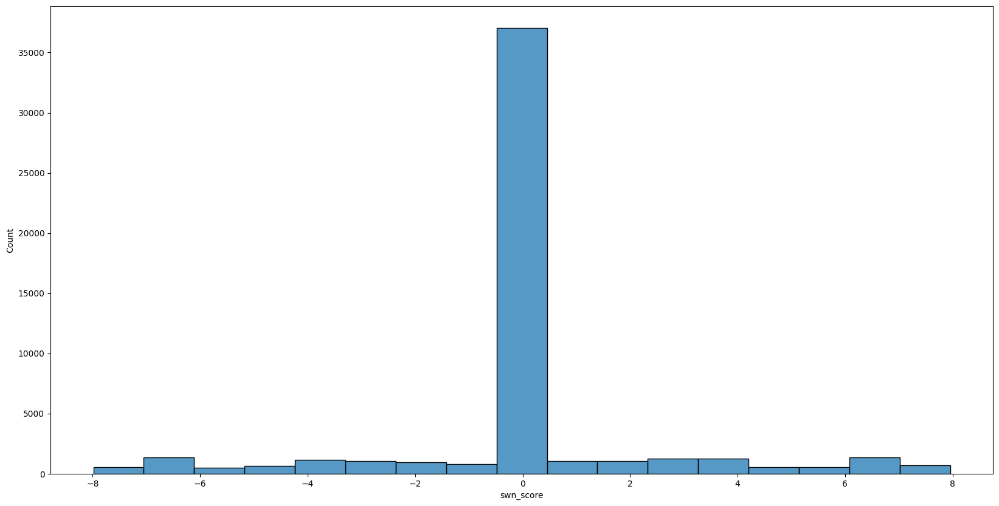

In [68]:
fig , ax = plt.subplots(nrows=1, ncols=1, figsize=(20,10))
sns.histplot(x='swn_score', data=reviews.query("swn_score < 8 and swn_score > -8"), ax=ax)
plt.show()

In [69]:
reviews[reviews["swn_score"] == 0].count()

content        36830
score          36831
new_reviews    36831
swn_score      36831
dtype: int64

In [71]:
reviews[reviews["swn_score"] == 0].sample(10)

,content,score,new_reviews,swn_score
56573,Makes me laugh daily 😅,5,make laugh daily,0.0
4286,Apollo Uno L. Pancho,5,apollo uno l pancho,0.0
23959,enjoyed it so far,5,enjoy far,0.0
55224,Ok,5,ok,0.0
94204,Nominate,5,nominate,0.0
96441,"Paling mudah banding medsos yg lain, Dan boleh gabung pulak dengan medsos lain. Hebat🥰",5,pale mudah banding medso yg lain dan boleh gabung pulak dengan medsos lain hebat,0.0
1755,TIKTOK I LOVEEEEE THISSSS,5,tiktok loveeeee thissss,0.0
37800,I like TikTok mwaa,5,like tiktok mwaa,0.0
58501,Very entertaining app,5,entertain app,0.0
55449,No pls acc ban,1,pls acc ban,0.0


In [72]:
reviews['swn_sentiment'] = reviews['swn_score'].apply(lambda x: "positive" if x>1 else ("negative" if x<0.5 else "neutral"))

In [73]:
reviews['swn_sentiment'].value_counts(dropna=False)

negative    51540
positive    44125
neutral       462
Name: swn_sentiment, dtype: int64

<AxesSubplot: xlabel='score', ylabel='count'>

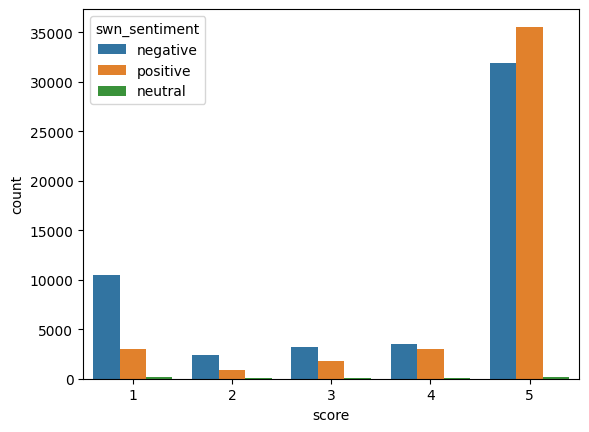

In [75]:
sns.countplot(x='score', hue='swn_sentiment' ,data = reviews)

<AxesSubplot: xlabel='swn_sentiment', ylabel='score'>

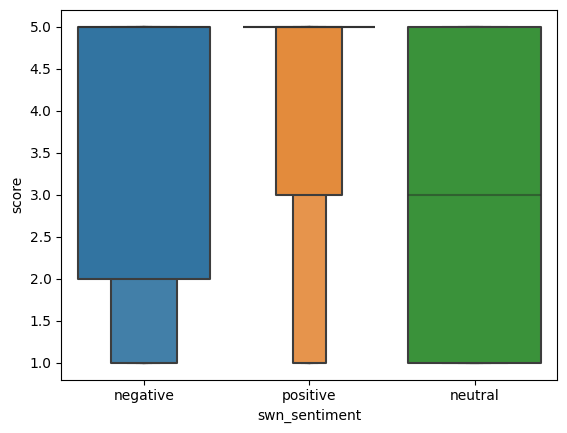

In [76]:
sns.boxenplot(x='swn_sentiment', y='score', data = reviews)

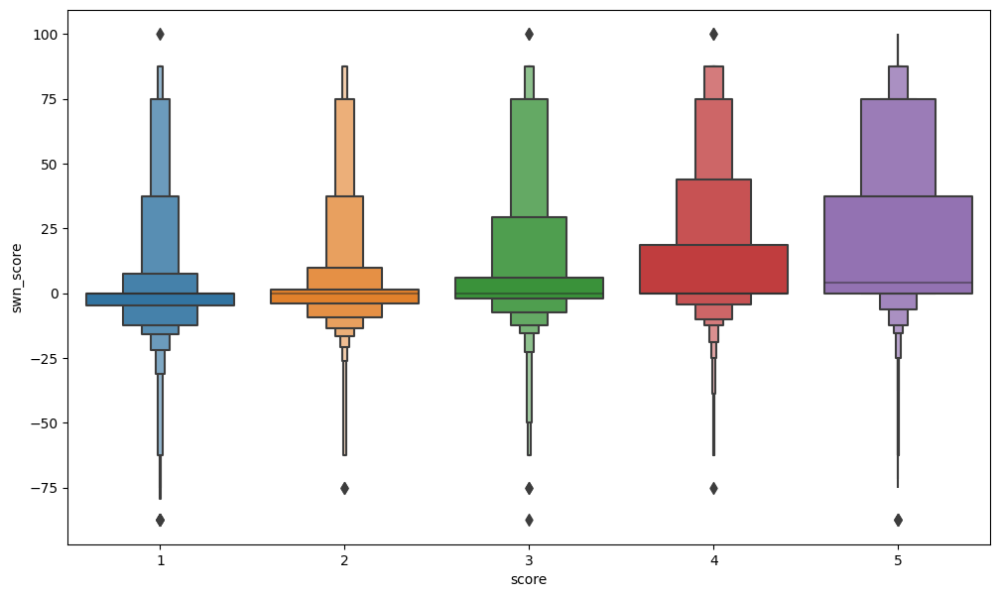

In [77]:
fig, ax = plt.subplots(nrows=1, ncols=1, figsize = (12,7))
sns.boxenplot(x='score', y='swn_score', data = reviews, ax=ax)
plt.show()

In [78]:
reviews['true_sentiment'] = \
    reviews['score'].apply(lambda x: "positive" if x>=4 else ("neutral" if x==3 else "negative"))

In [79]:
y_swn_pred, y_true = reviews['swn_sentiment'].tolist(), reviews['true_sentiment'].tolist()

In [80]:
len(y_swn_pred), len(y_true)

(96127, 96127)

In [91]:
from sklearn.metrics import confusion_matrix
cm = confusion_matrix(y_true, y_swn_pred, labels=["negative", "neutral", "positive"])

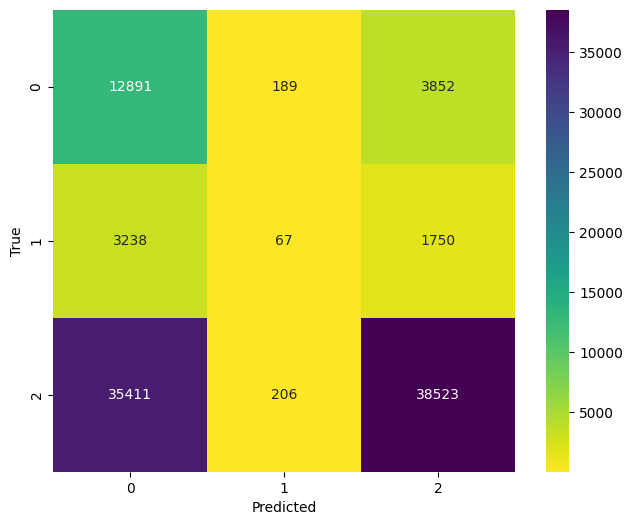

In [92]:
fig , ax = plt.subplots(nrows=1, ncols=1, figsize=(8,6))
sns.heatmap(cm, cmap='viridis_r', annot=True, fmt='d', square=True, ax=ax)
ax.set_xlabel('Predicted')
ax.set_ylabel('True');

## Performance Assesment

### Negative Sentiment Prediction Assessment

In [97]:
tp, tn, fp, fn = cm[0][0], cm[1][1]+cm[1][2]+cm[2][1]+cm[2][2], cm[1][0]+cm[2][0], cm[0][1]+cm[0][2]

In [98]:
recall = tp / (tp+fn)
specifity = tn / (tn+fp)
precision = tp/(tp+fp)
f1 = (2*tp) / (2*tp + fp + fn)
print("recall: {}\nprecission: {}\nf1 score: {}".format(recall, precision, f1))

recall: 0.7613394755492559
precission: 0.25011641443539
f1 score: 0.37653347353662814


### Positive Sentiment Prediction Assessment

In [99]:
tp, tn, fp, fn = cm[2][2], cm[0][0]+cm[0][1]+cm[1][0]+cm[1][1], cm[0][2]+cm[1][2], cm[2][0]+cm[2][1]

In [100]:
recall = tp / (tp+fn)
specifity = tn / (tn+fp)
precision = tp/(tp+fp)
f1 = (2*tp) / (2*tp + fp + fn)
print("recall: {}\nprecission: {}\nf1 score: {}".format(recall, precision, f1))

recall: 0.5195980577286216
precission: 0.8730424929178471
f1 score: 0.6514691582463112
